In [1]:
%load_ext watermark
%watermark -v -m  -u -n -p pandas,sbmtm,topicpy -a Filippo_Valle -g -r -b -w

2023-09-19 09:06:58.228585: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-19 09:06:58.469427: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-09-19 09:06:58.470561: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-19 09:07:00.537625: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Author: Filippo_Valle

Last updated: Tue Sep 19 2023

Python implementation: CPython
Python version       : 3.9.7
IPython version      : 8.12.0

pandas : 1.5.3
sbmtm  : not installed
topicpy: 0.2.0

Compiler    : GCC 9.4.0
OS          : Linux
Release     : 6.2.0-32-generic
Machine     : x86_64
Processor   : x86_64
CPU cores   : 12
Architecture: 64bit

Git hash: 7003b2da833bb7f3e15d3cccc834949f2c67af50

Git repo: git@github.com:BioPhys-Turin/topic-modeling-proteomics.git

Git branch: main

Watermark: 2.3.1



In [1]:
import pandas as pd

In [2]:
with open("sample_metadata.txt") as file:
    samples = file.read()

In [3]:
df_files = pd.DataFrame(data = [line.split(" ") for line in samples.replace("SHH SHH", "SHH_SHH").replace("SHH CHL", "SHH_CHL").replace("/ ", "/").split("\n")[1:-1]], columns=samples.split("\n")[0].split(" ")).set_index("SampleID")
df_files.to_csv("files.dat")

In [4]:
df = pd.read_csv("tab_cleaned_pep_MB_spectraunaut.txt", sep="\t", index_col=0).fillna(0).astype(int)
df.to_csv("mainTable.csv")
df.head()

,MB170,MB349,MB233,MB051,MB064,MB317,MB085,MB032,MB316,MB381,...,MB157,MB099,MB332,MB123,MB114,MB262,MB328,MB124,MB028,MB212
GeneID,,,,,,,,,,,,,,,,,,,,,
A1BG,18,19,17,19,19,18,17,19,17,19,...,19,19,19,0,19,19,19,17,16,15
A1CF,0,1,1,0,0,0,0,1,0,1,...,0,0,0,0,0,0,0,2,0,1
A2M,97,96,98,110,108,101,83,106,101,110,...,95,94,96,0,98,110,82,99,102,102
AAAS,22,25,21,13,20,21,20,23,17,25,...,23,20,23,0,23,15,23,23,23,20
AACS,3,4,9,20,7,2,6,11,5,8,...,12,22,7,0,6,1,2,15,5,13


In [5]:
import sys, os
sys.path.append("/home/jovyan/work/phd/hSBM_Topicmodel/")

In [6]:
from sbmtm import sbmtm


(ipykernel_launcher.py:161546): dbind-WARNING **: 12:47:21.181: Couldn't connect to accessibility bus: Failed to connect to socket /run/user/1000/at-spi/bus_0: No such file or directory


In [7]:
model = sbmtm()

In [8]:
model.make_graph_from_BoW_df(df=df)

In [9]:
model.fit()

/opt/conda/lib/python3.9/site-packages/graph_tool/inference/blockmodel.py:390: UserWarning: unrecognized keyword arguments: ['overlap']
  warnings.warn("unrecognized keyword arguments: " +


In [ ]:
#os.mkdir("topsbm")
os.chdir("topsbm")
model.save_data()
os.chdir("../")

In [12]:
from topicpy.hsbmpy import *

2023-05-02 12:49:44.609352: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-02 12:49:45.124242: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-05-02 12:49:45.124264: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-05-02 12:49:46.188858: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-

In [13]:
directory="/home/jovyan/work/phd/proteomics/"
algorithm = "topsbm"
labels = df_files.columns
L=3

/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:806: UserWarning: you are shuffling a 'Series' object which is not a subclass of 'Sequence'; `shuffle` is not guaranteed to behave correctly. E.g., non-numpy array/tensor objects with view semantics may contain duplicates after shuffling.
  df_files_shuffled.apply(lambda x: np.random.shuffle(x), 0)


True DKFZ_subgroup 10


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


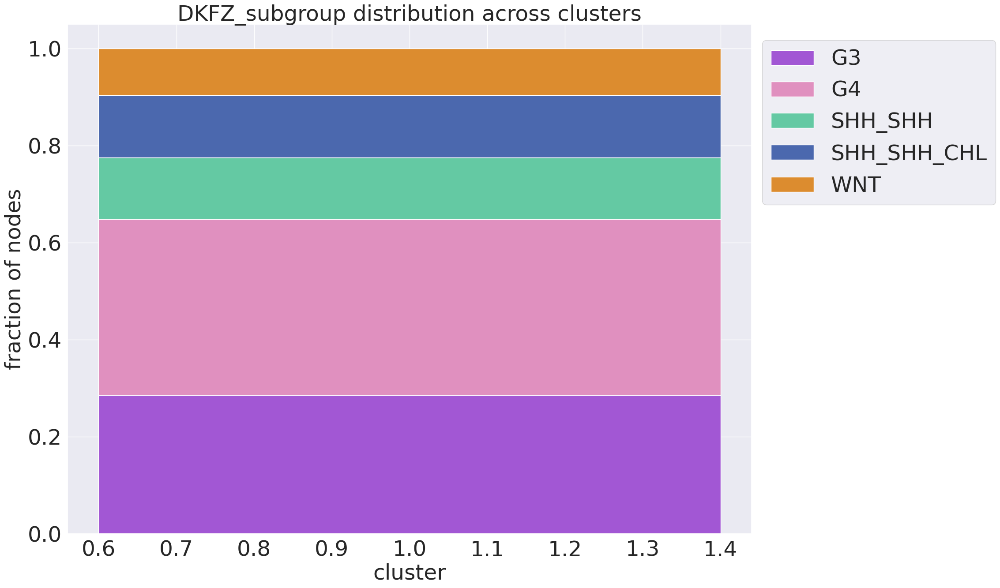

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


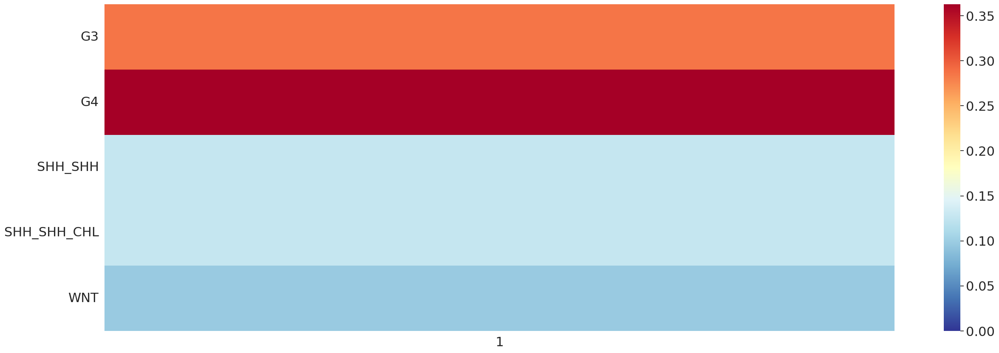

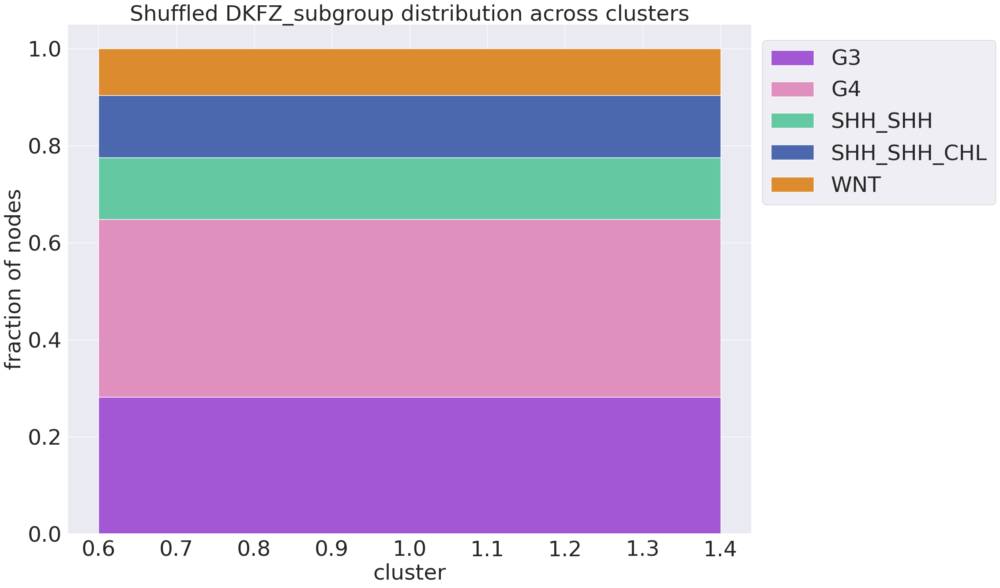

True DKFZ_subgroup 9


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


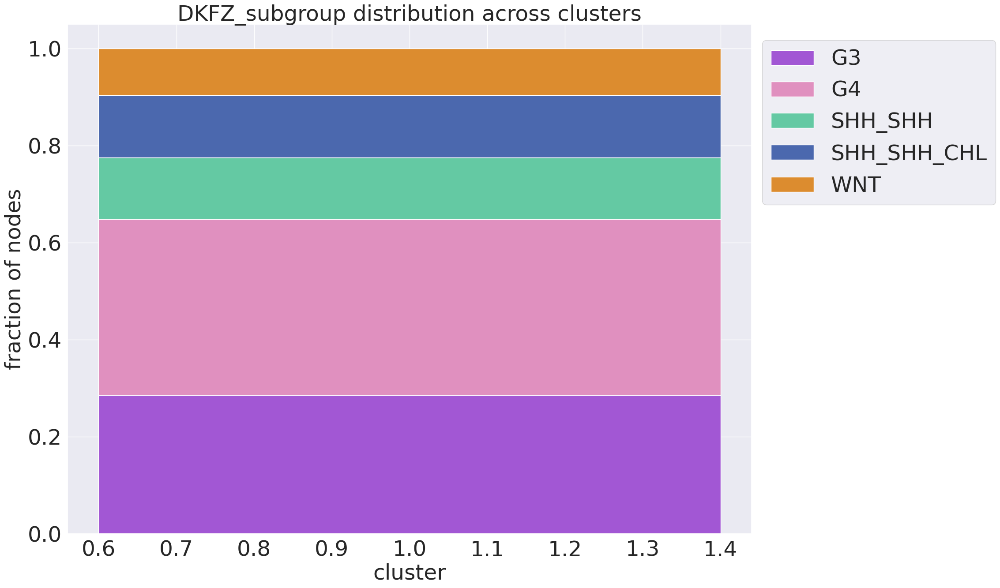

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


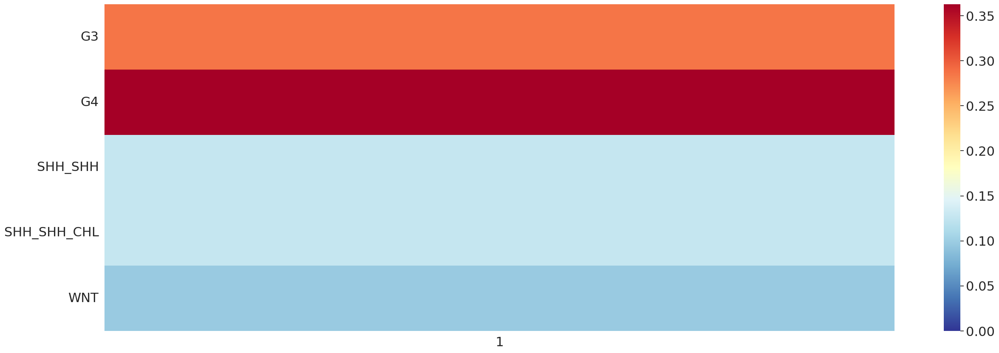

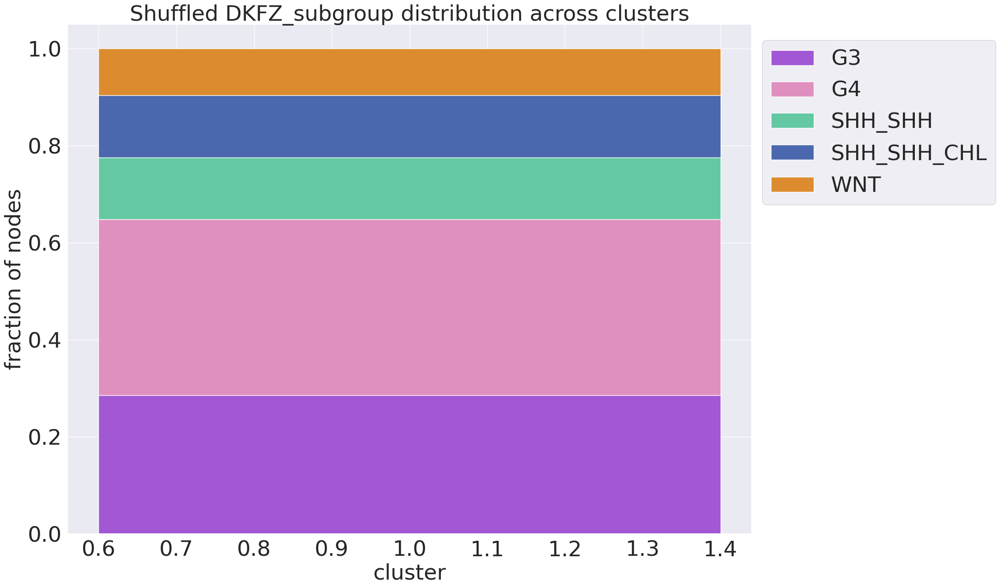

True DKFZ_subgroup 8


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


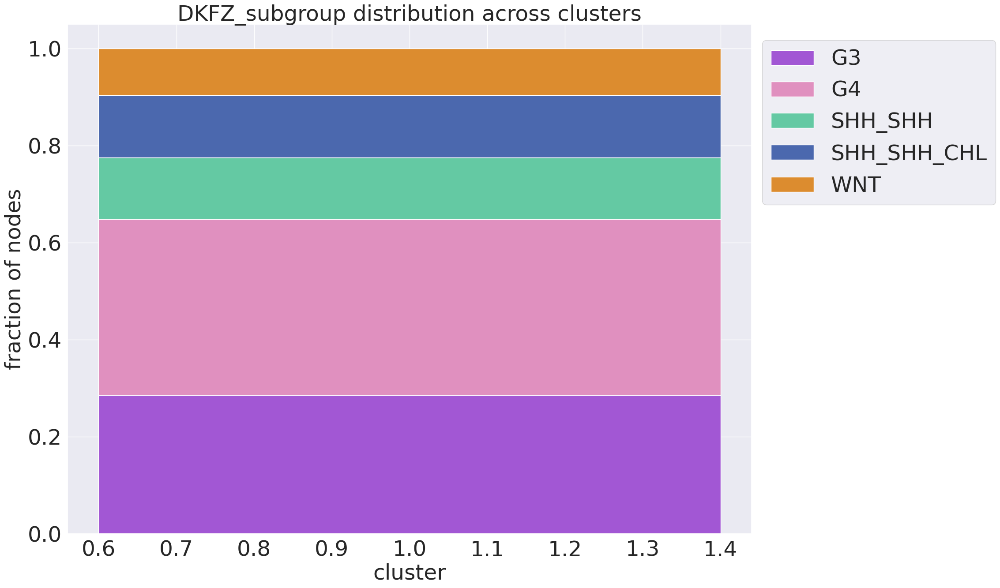

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


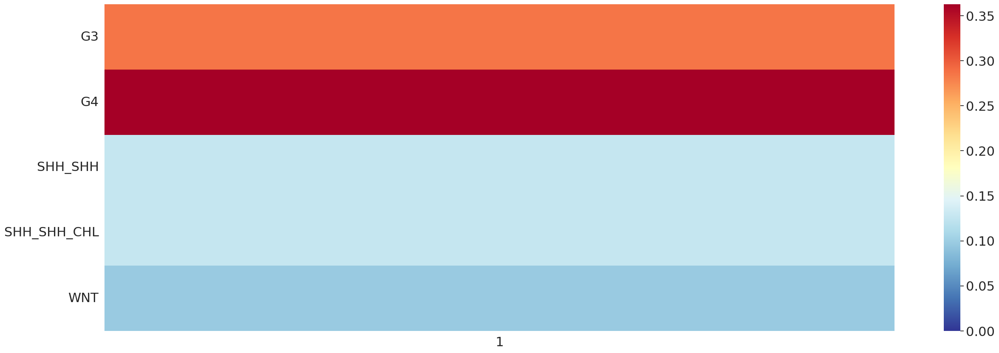

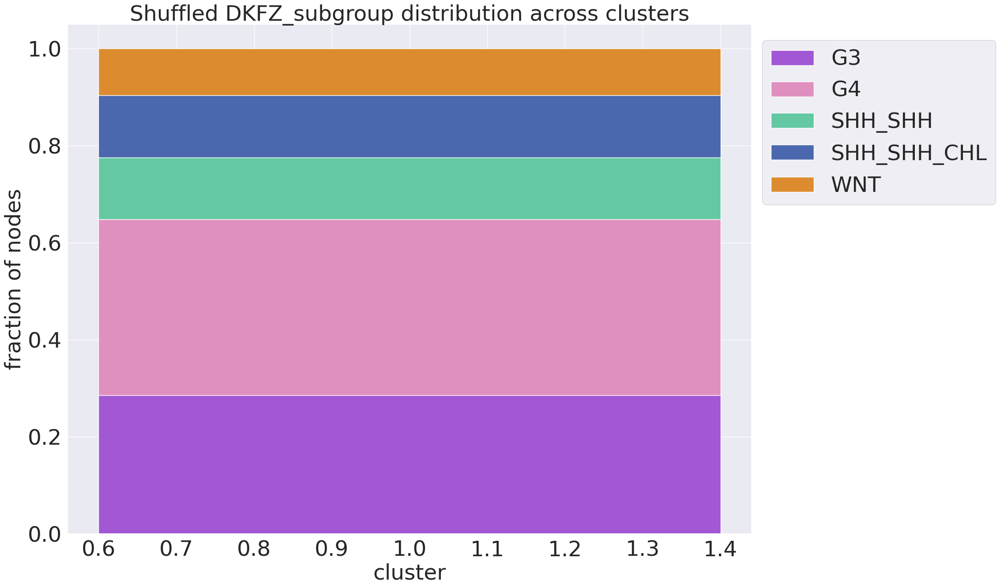

True DKFZ_subgroup 7


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


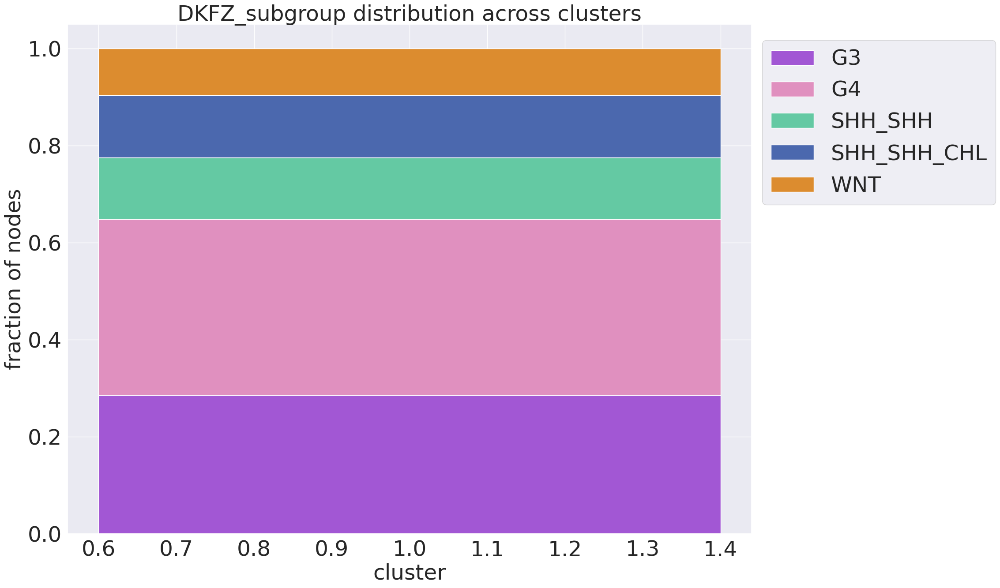

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


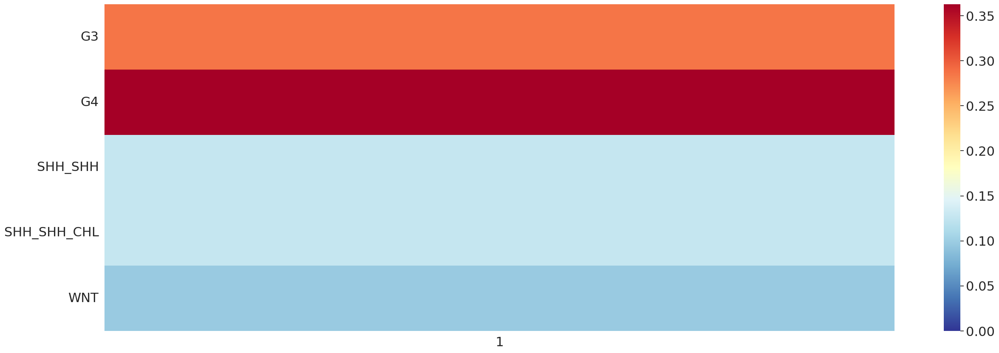

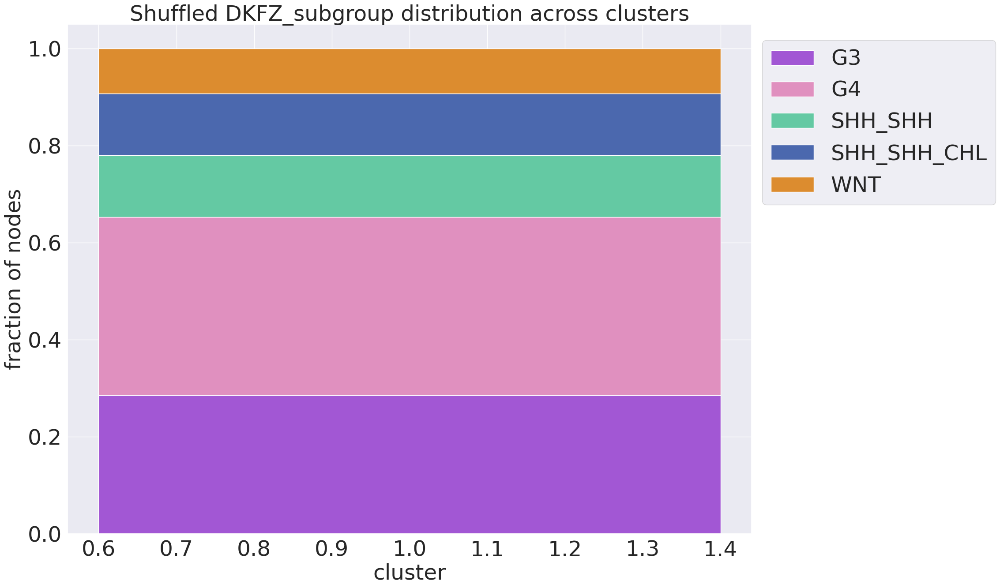

True DKFZ_subgroup 6


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


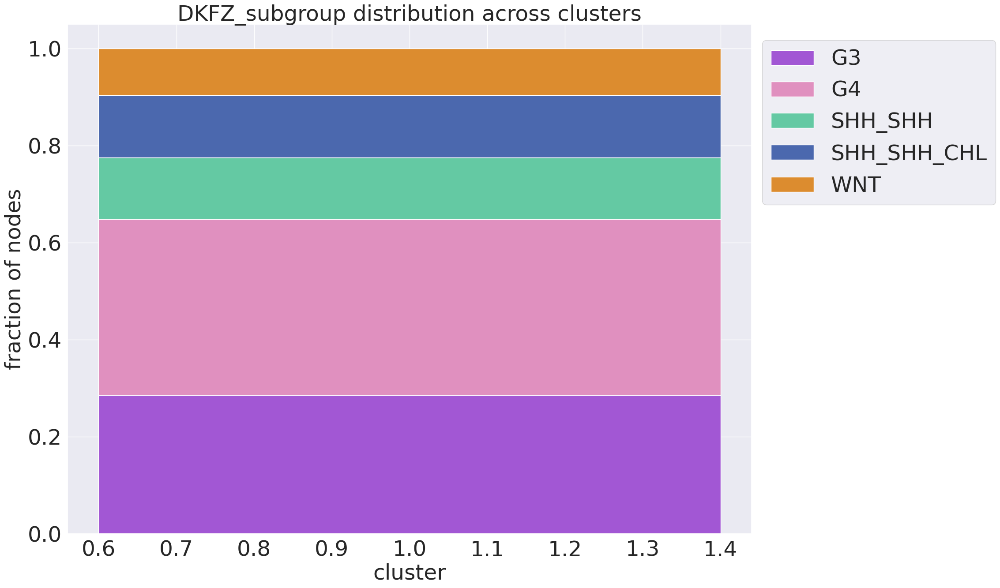

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


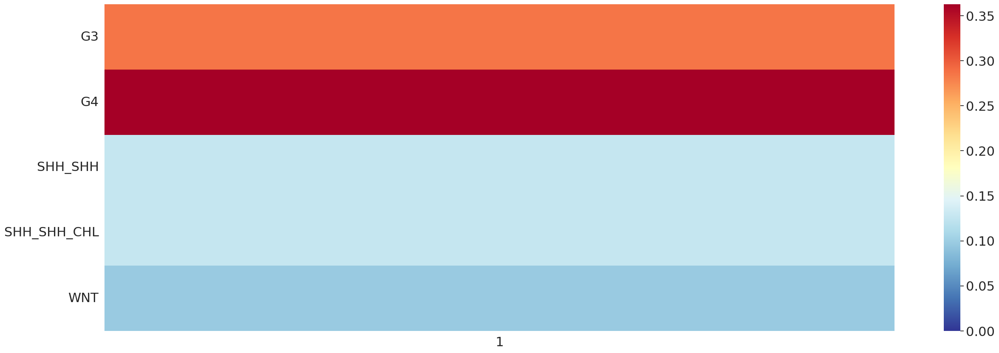

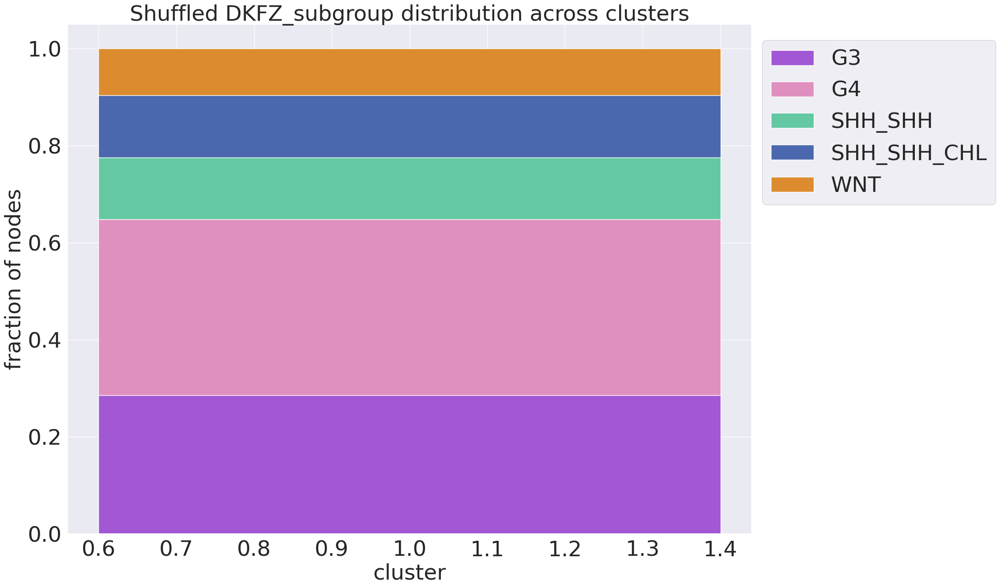

True DKFZ_subgroup 5


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


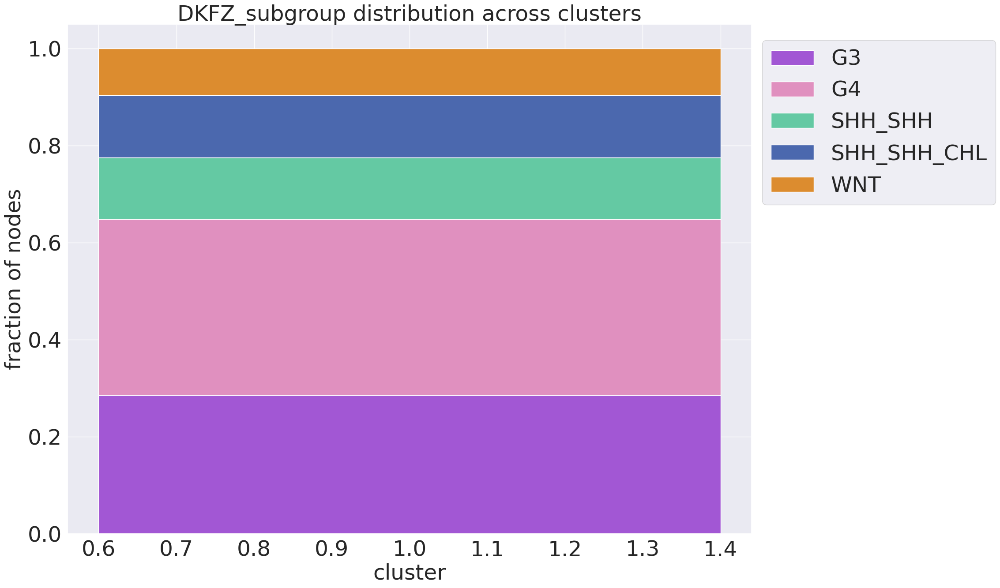

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


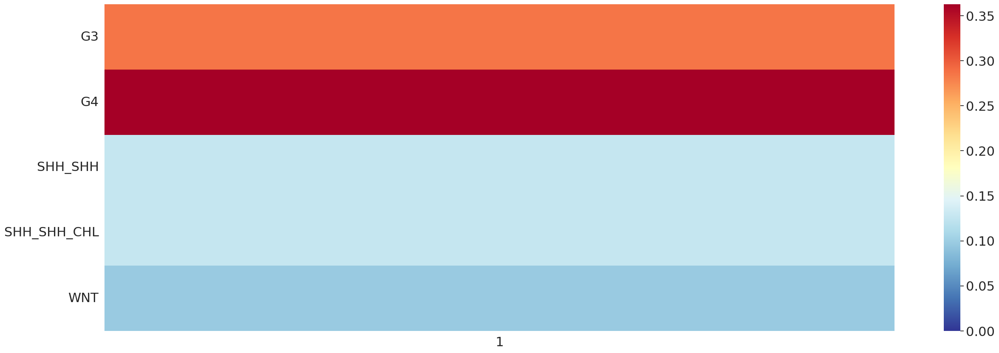

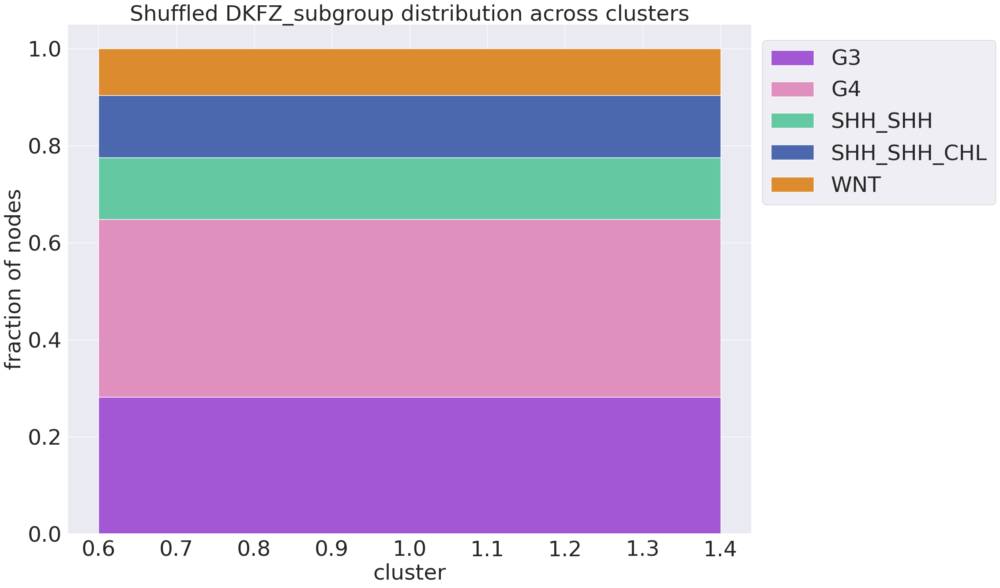

True DKFZ_subgroup 4


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


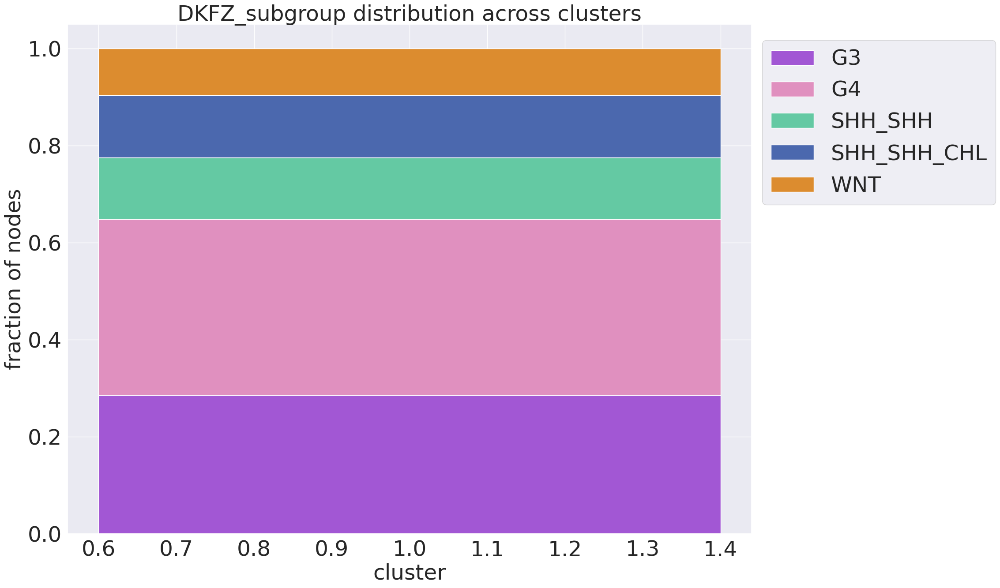

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


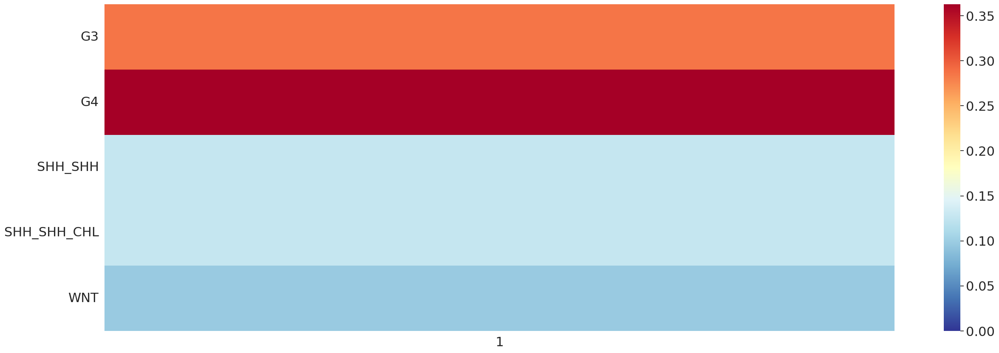

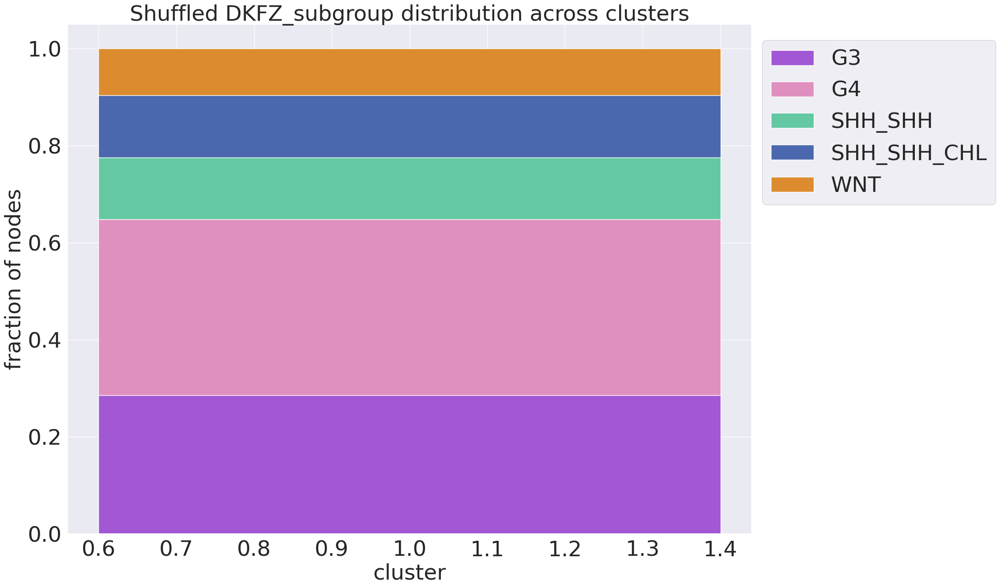

True DKFZ_subgroup 3


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


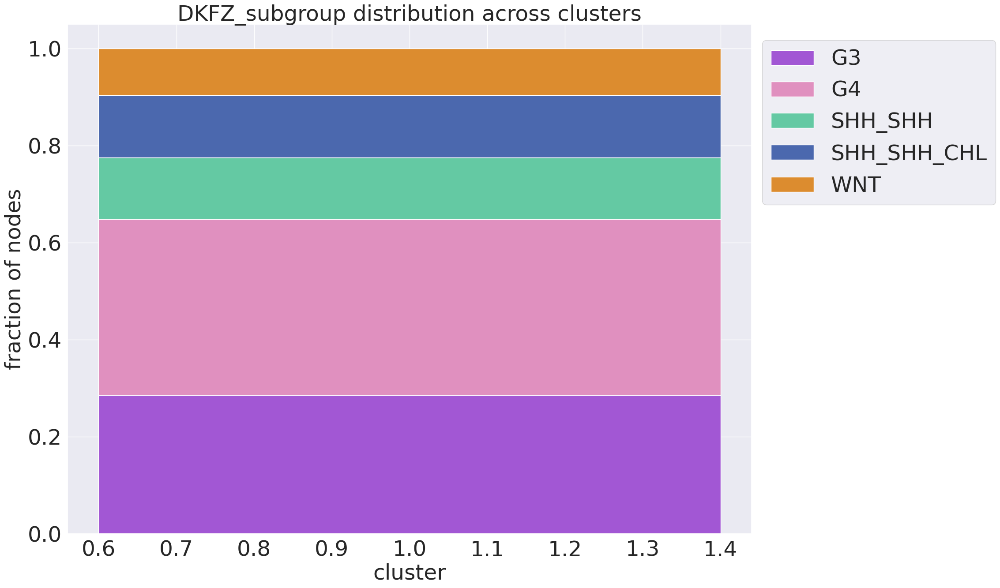

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


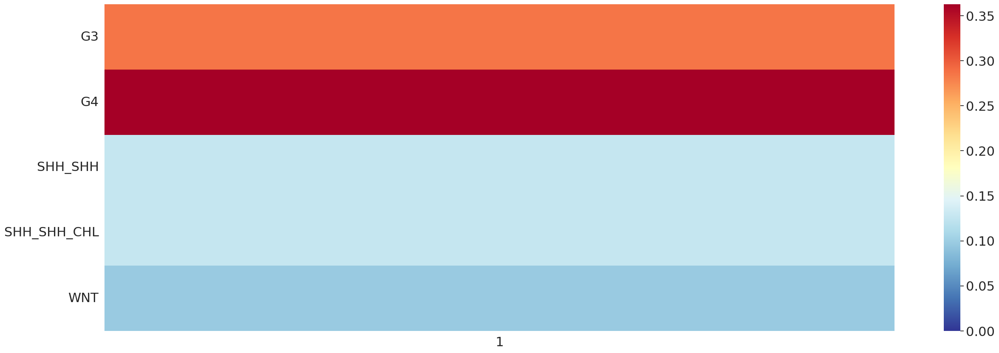

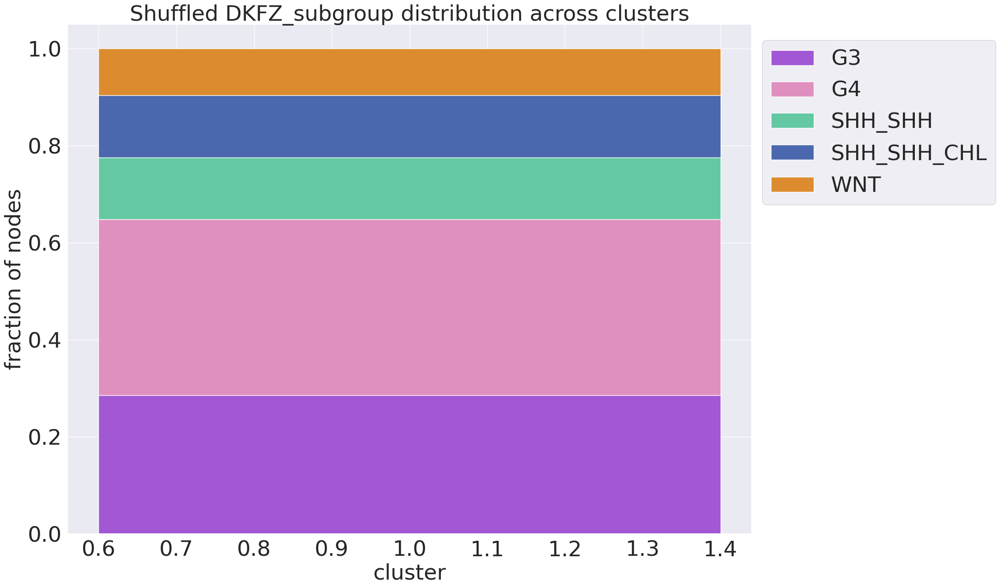

True DKFZ_subgroup 2


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


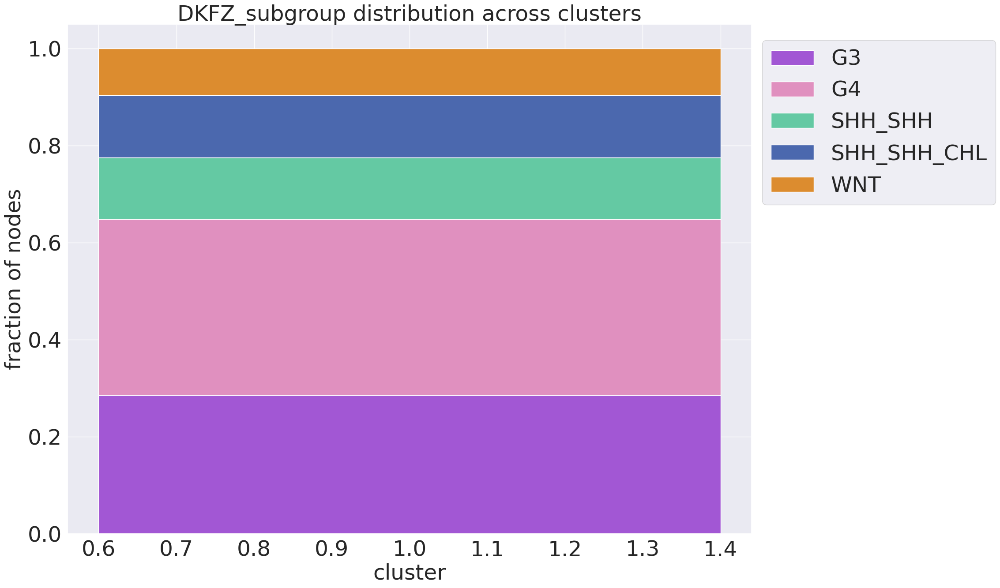

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


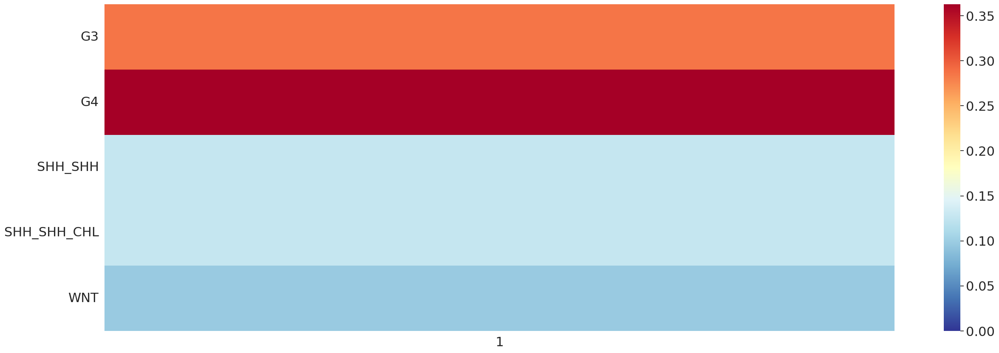

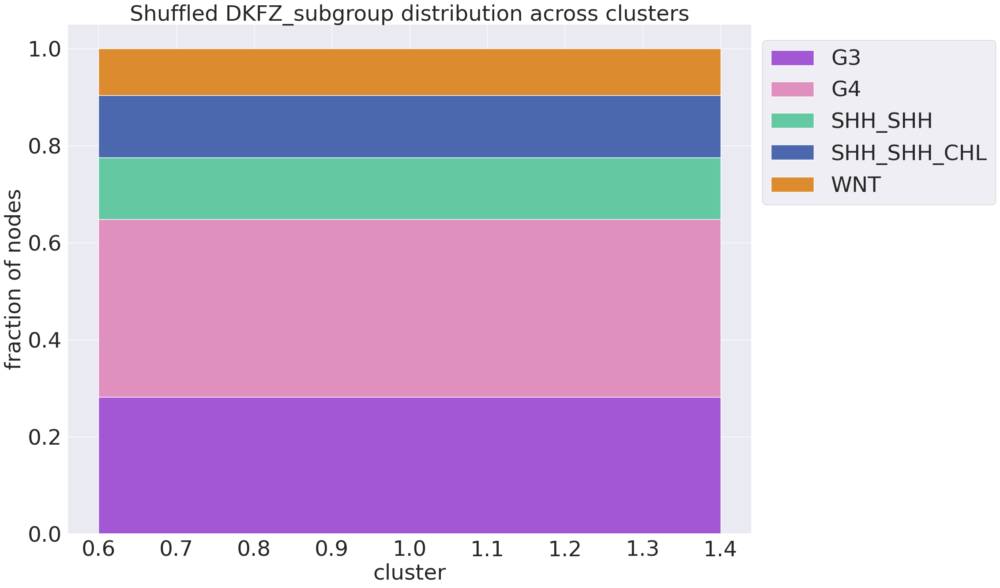

True DKFZ_subgroup 1


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


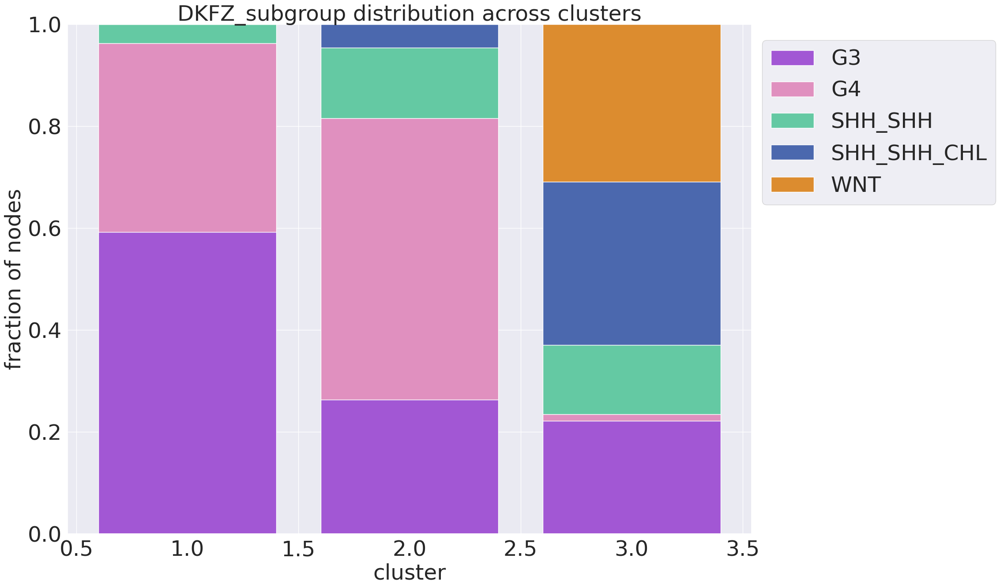

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


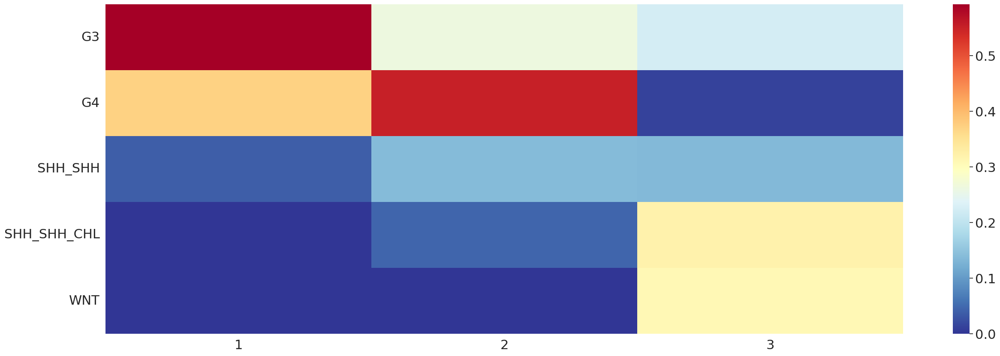

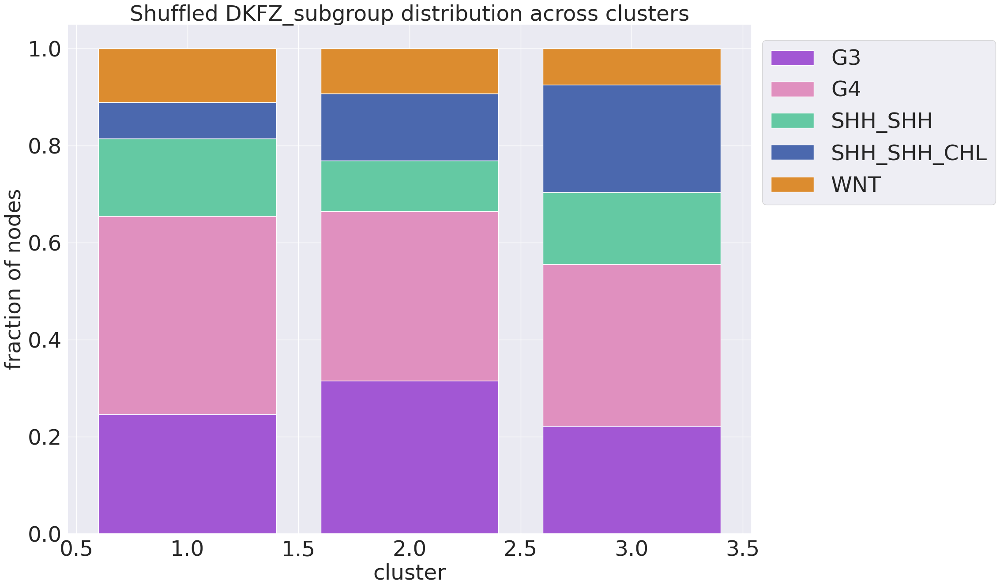

True DKFZ_subgroup 0


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


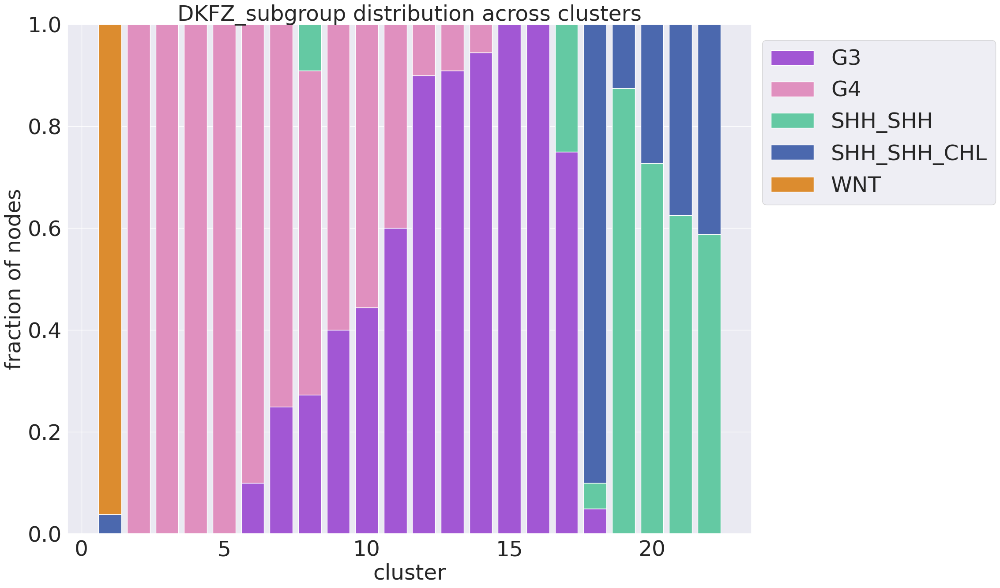

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


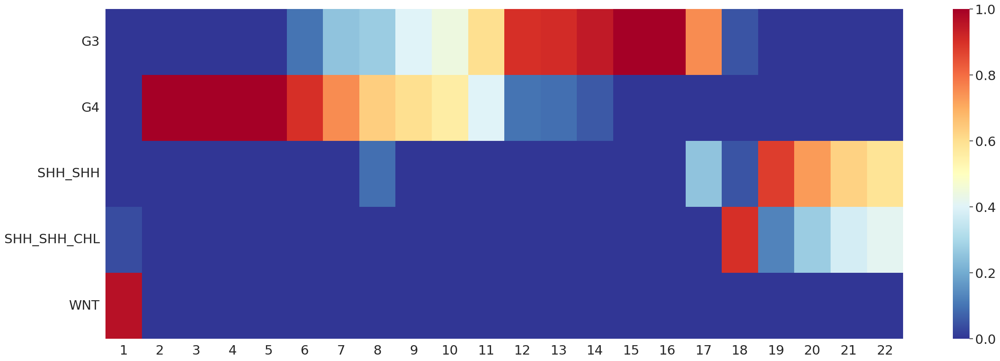

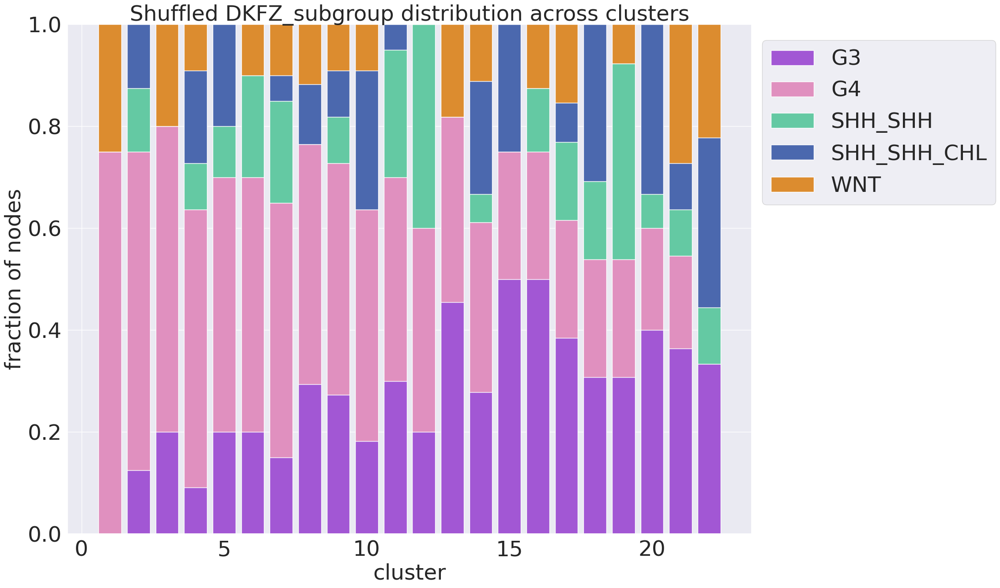

True DKFZ_subtype 10


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


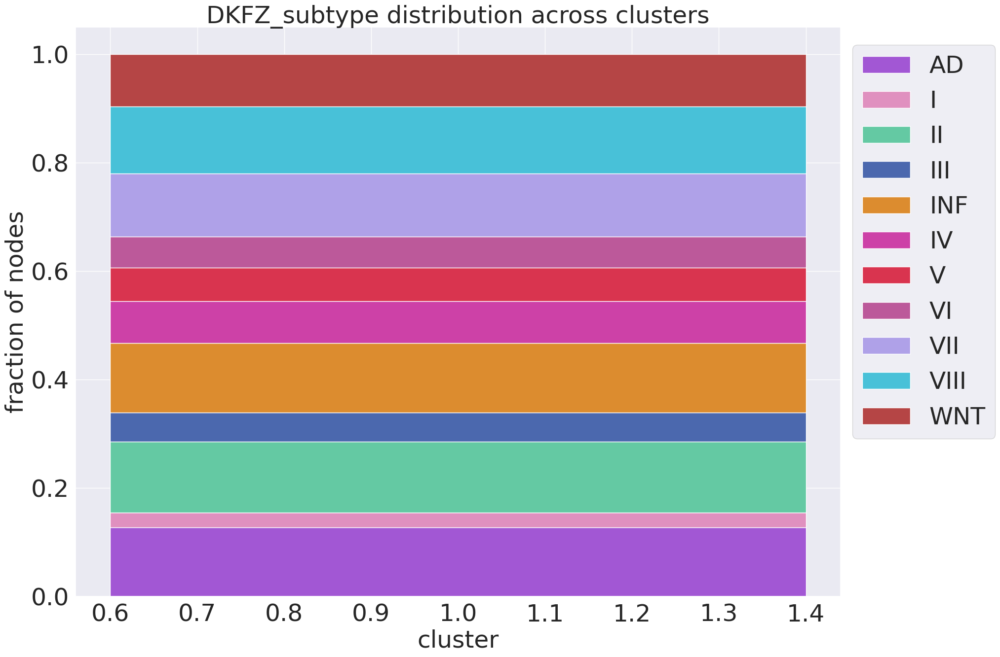

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


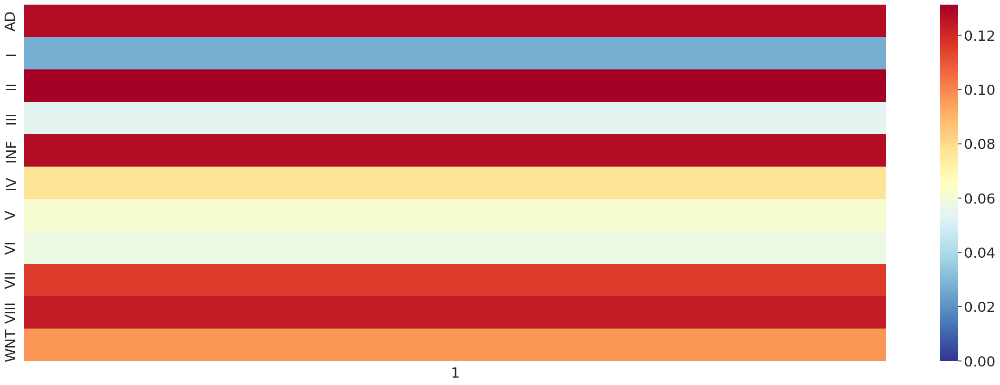

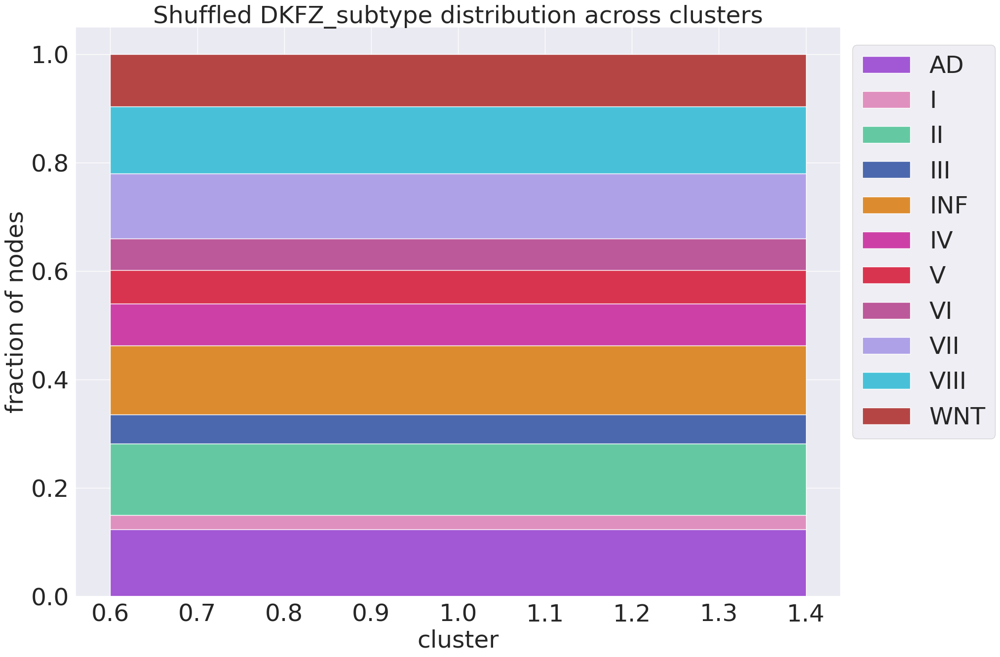

True DKFZ_subtype 9


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


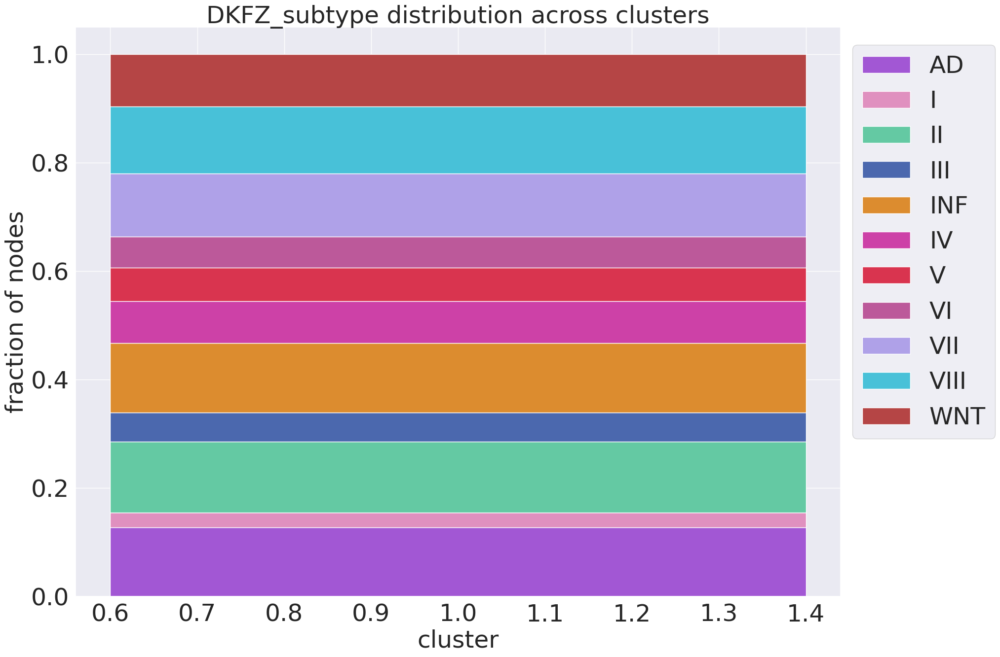

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


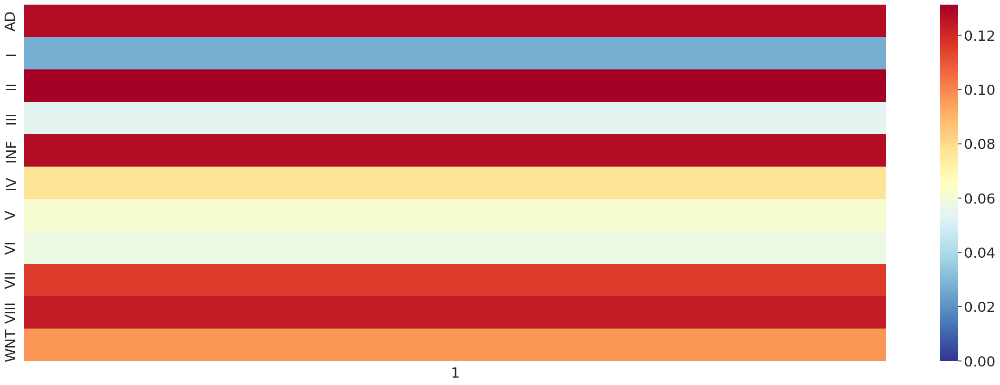

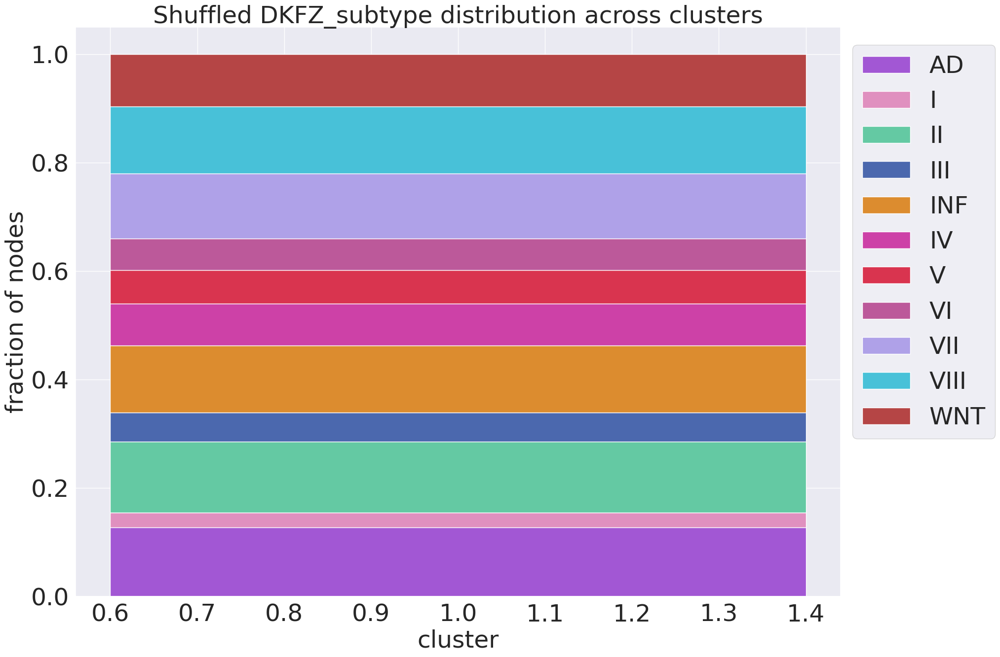

True DKFZ_subtype 8


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


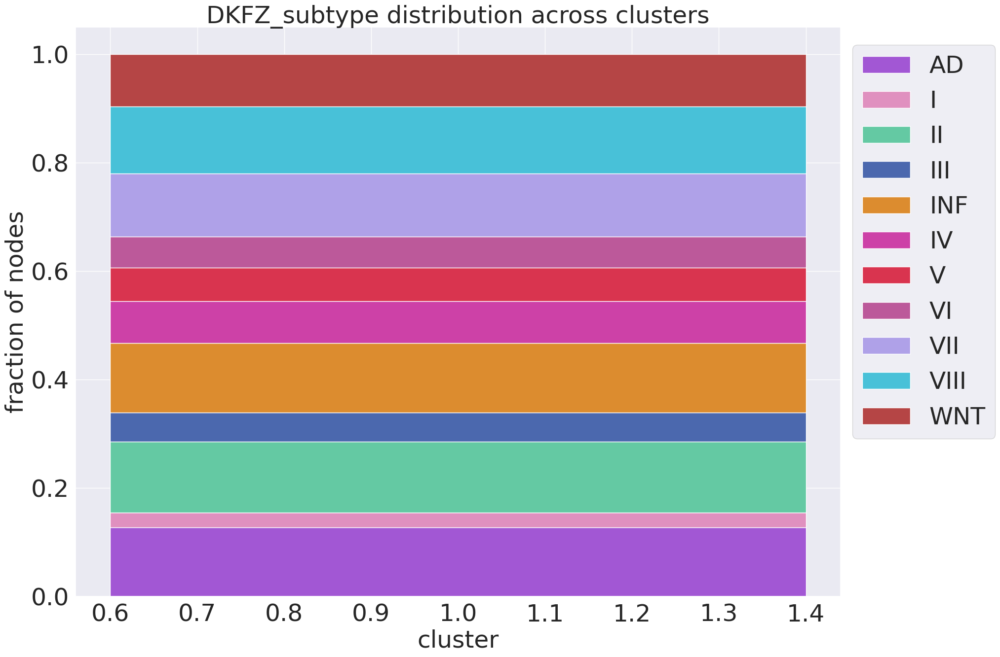

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


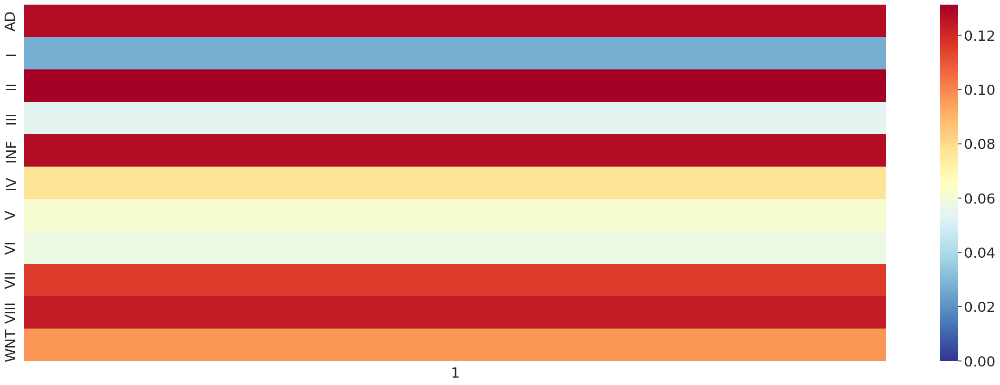

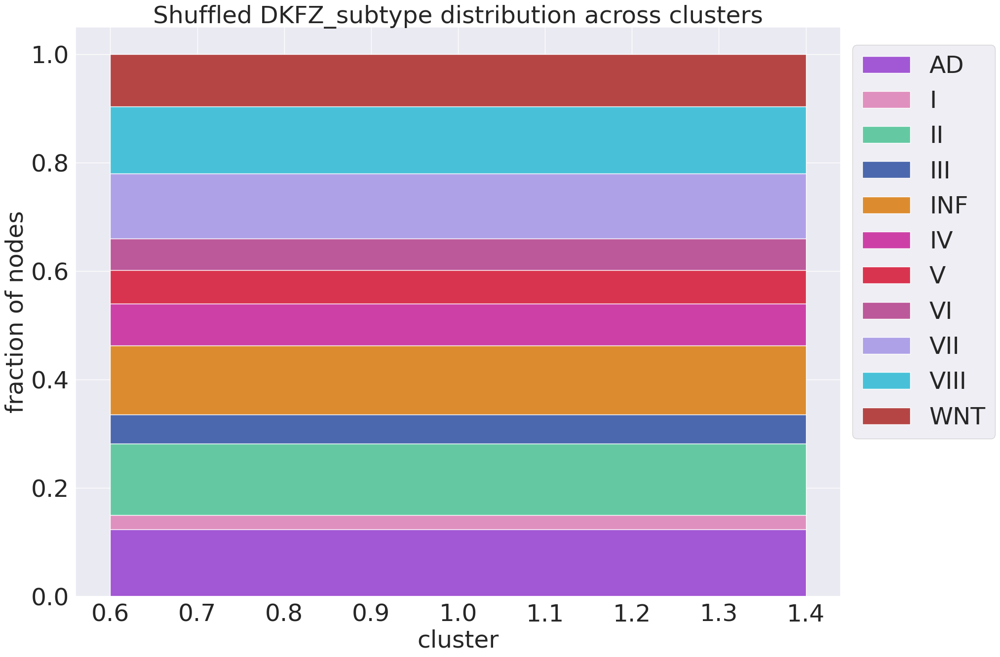

True DKFZ_subtype 7


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


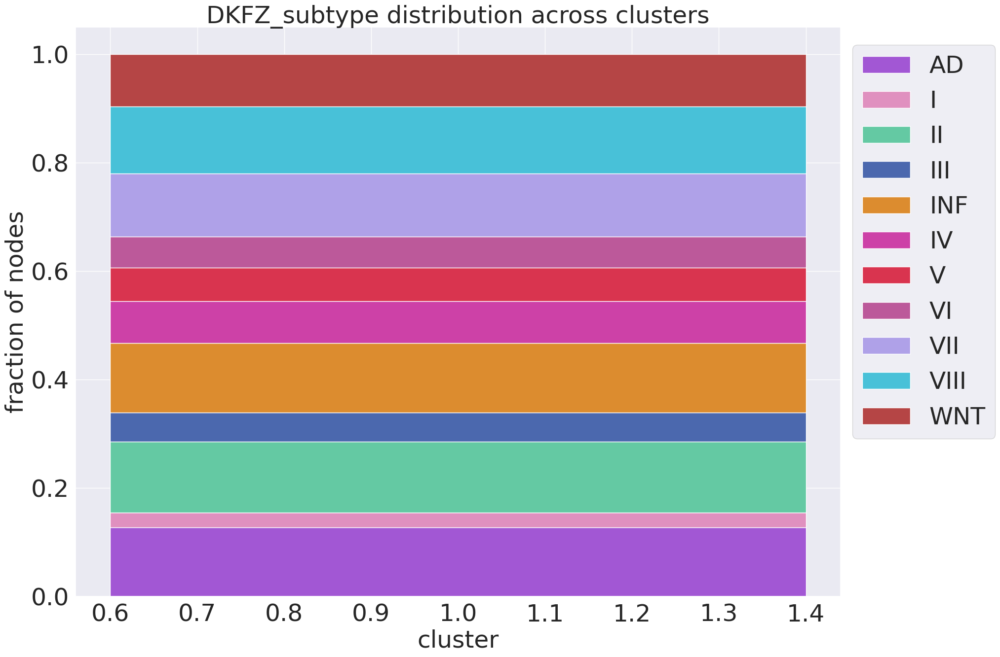

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


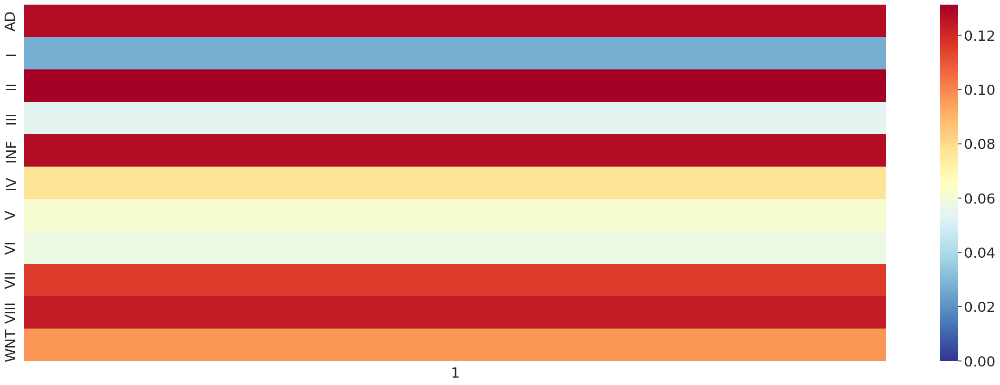

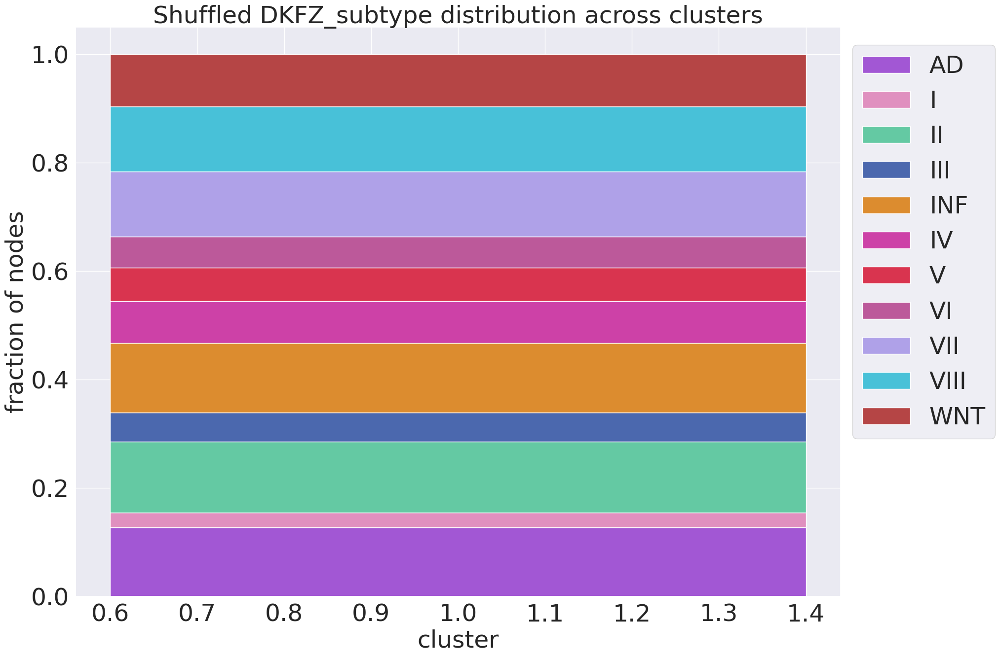

True DKFZ_subtype 6


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


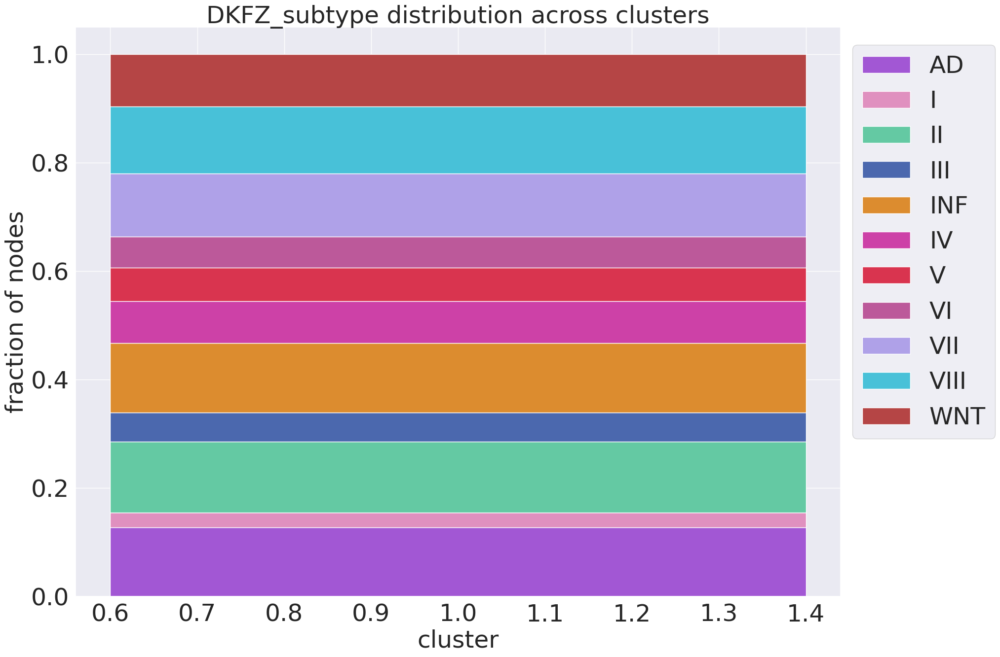

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


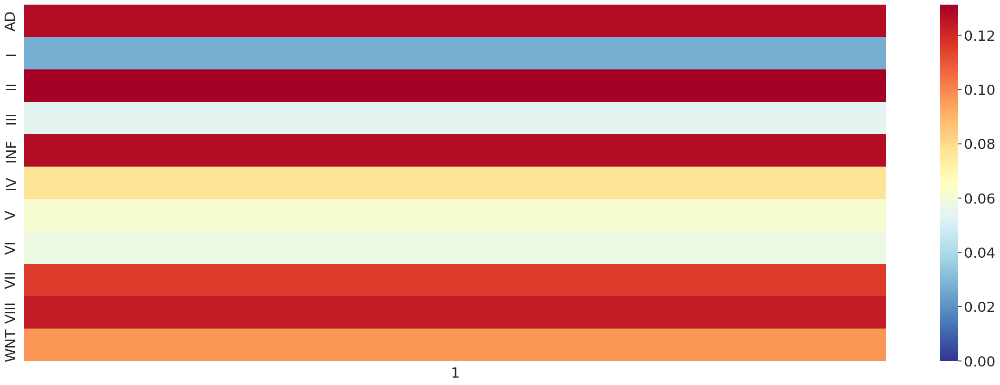

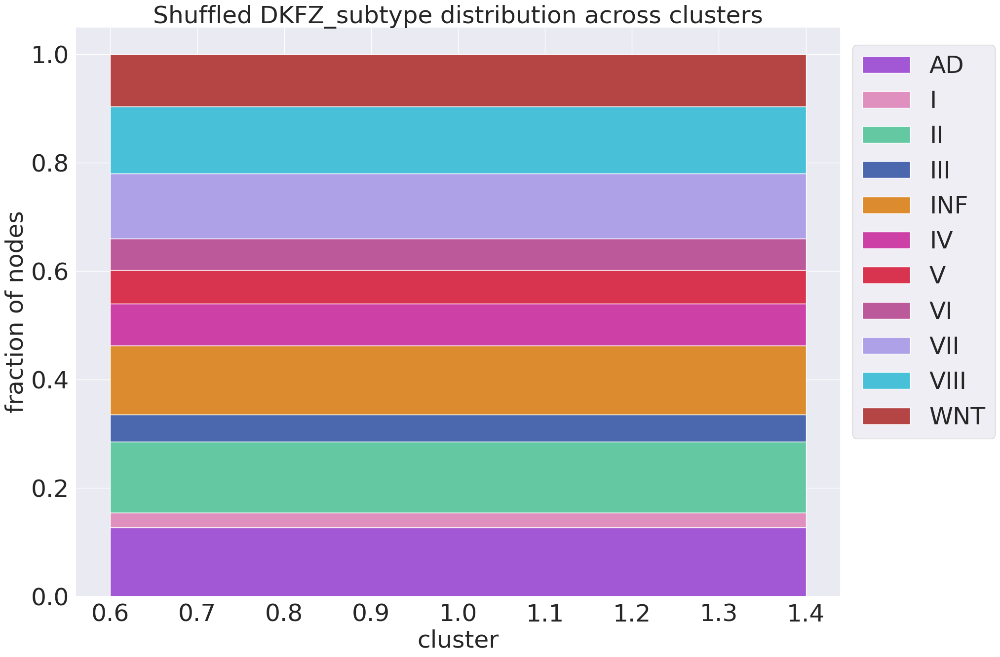

True DKFZ_subtype 5


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


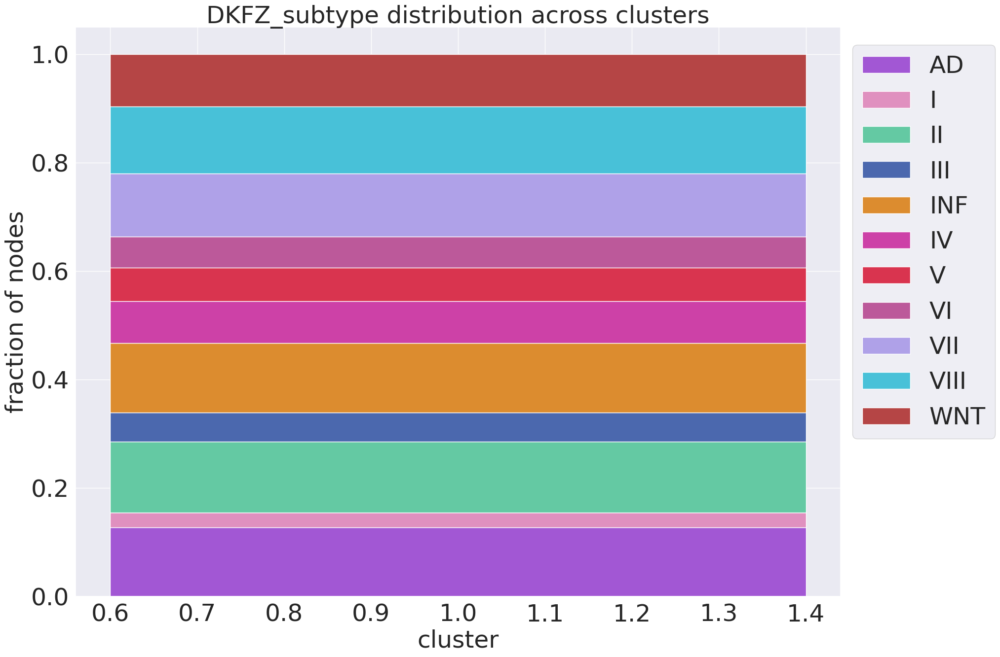

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


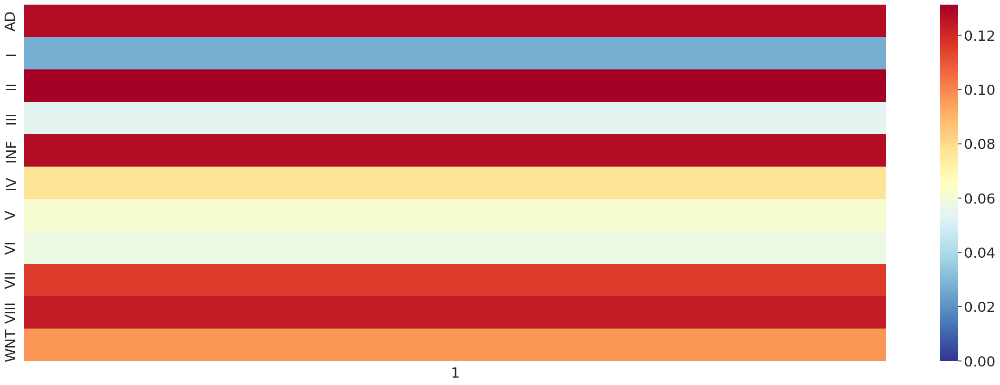

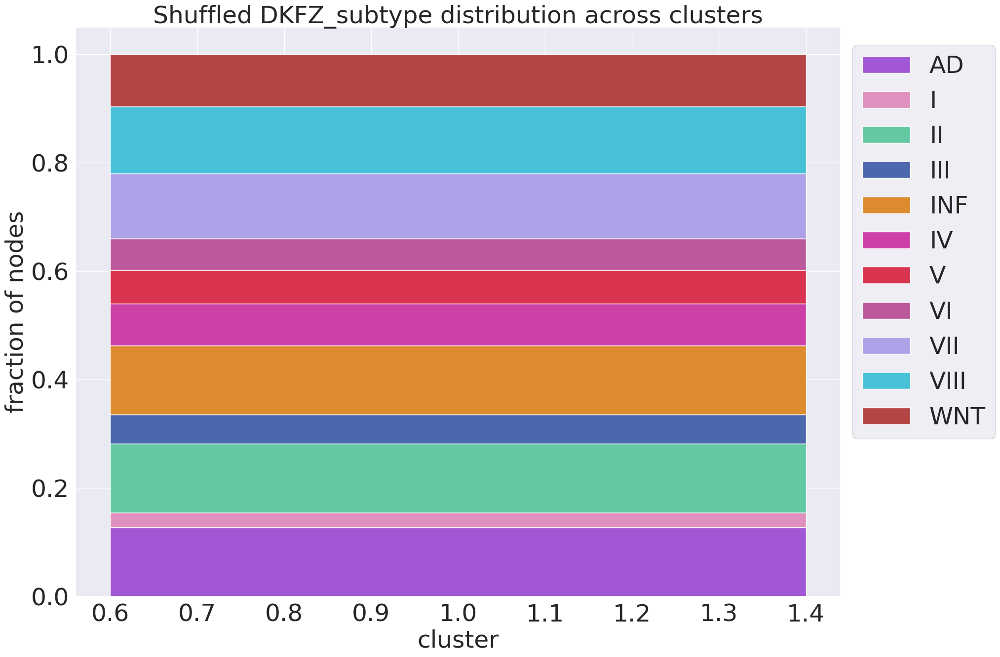

True DKFZ_subtype 4


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


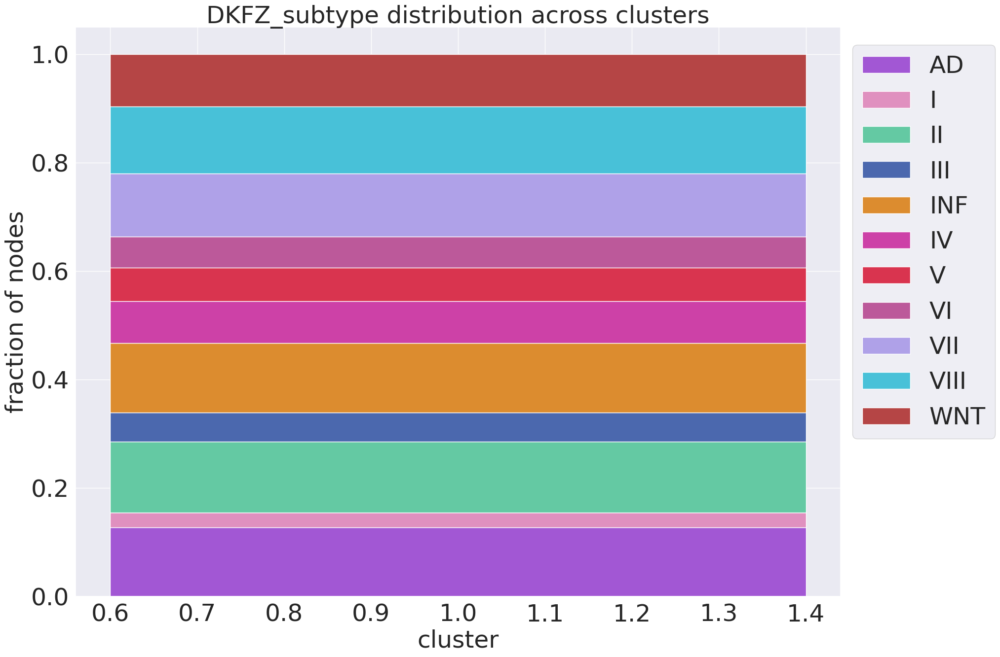

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


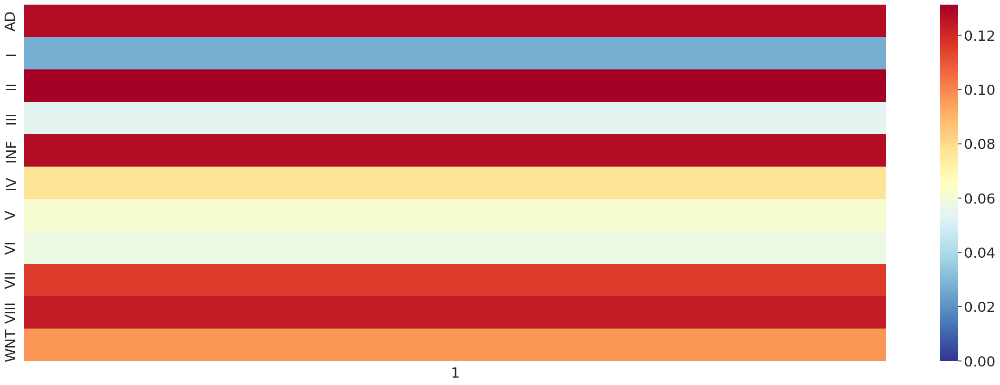

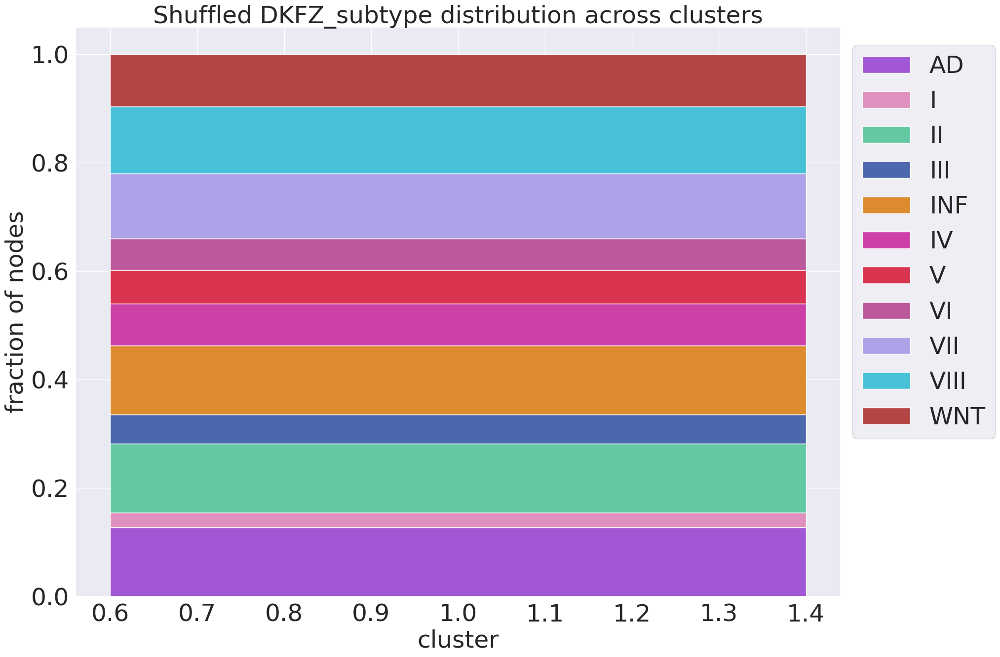

True DKFZ_subtype 3


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


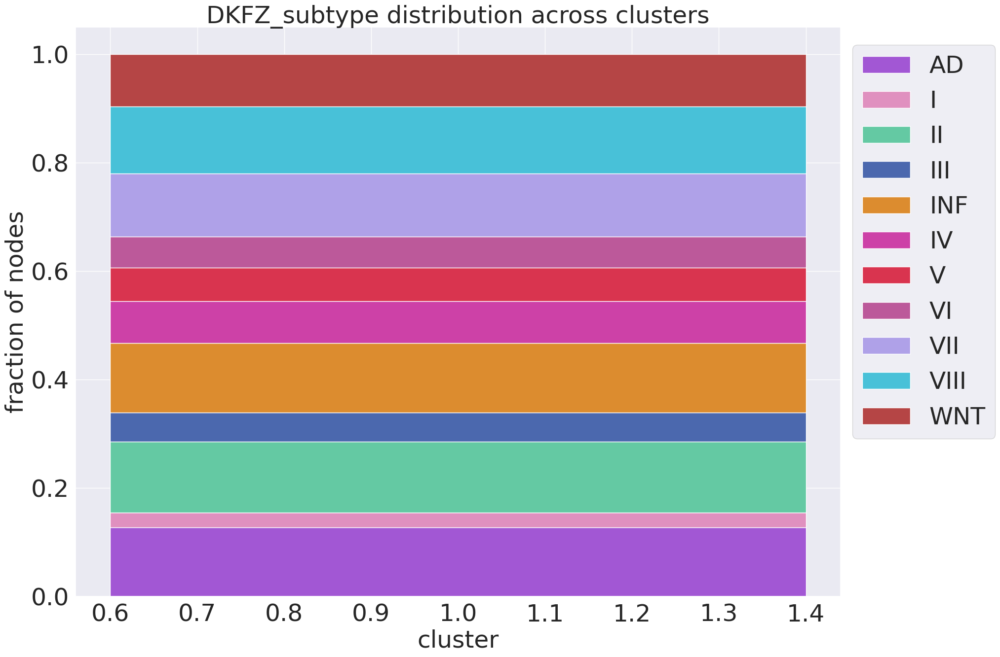

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


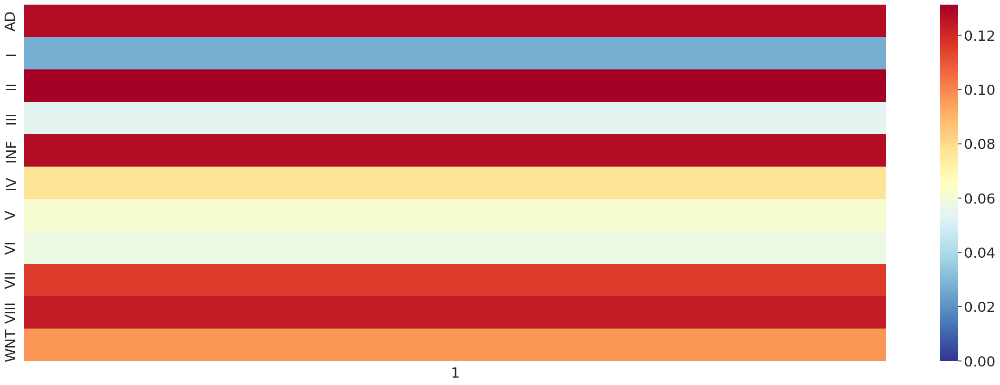

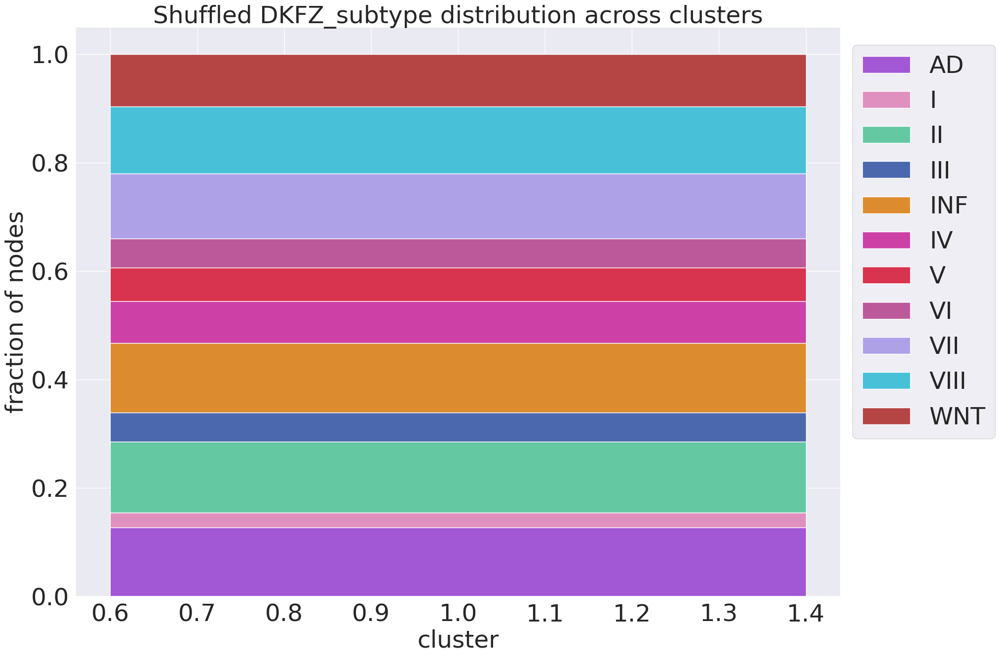

True DKFZ_subtype 2


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


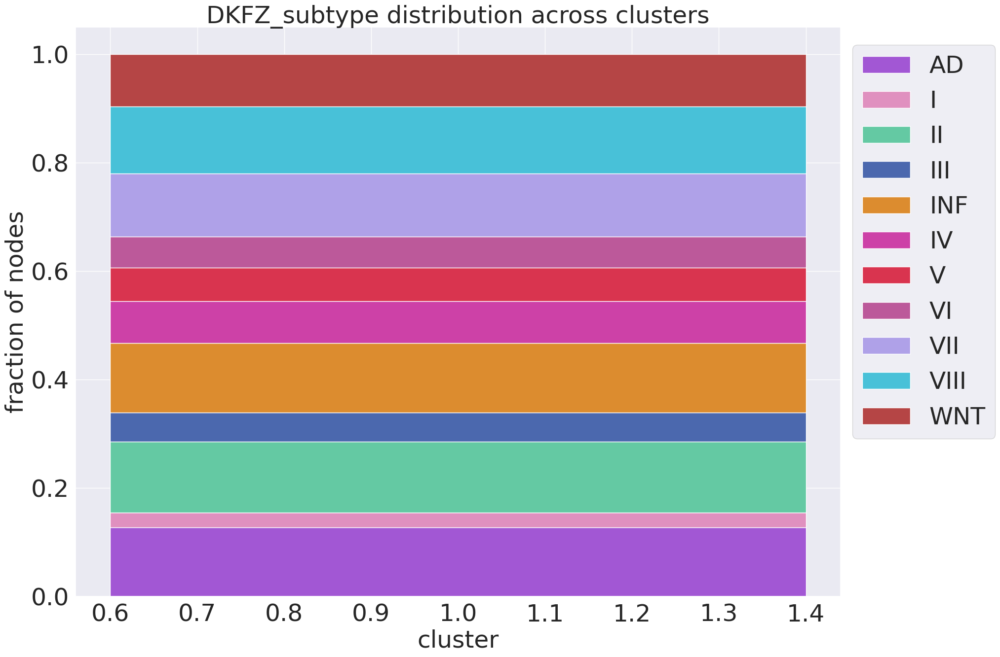

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


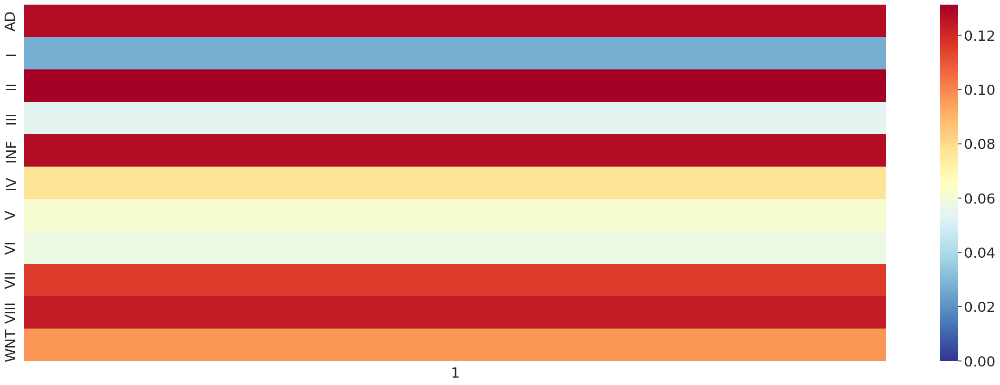

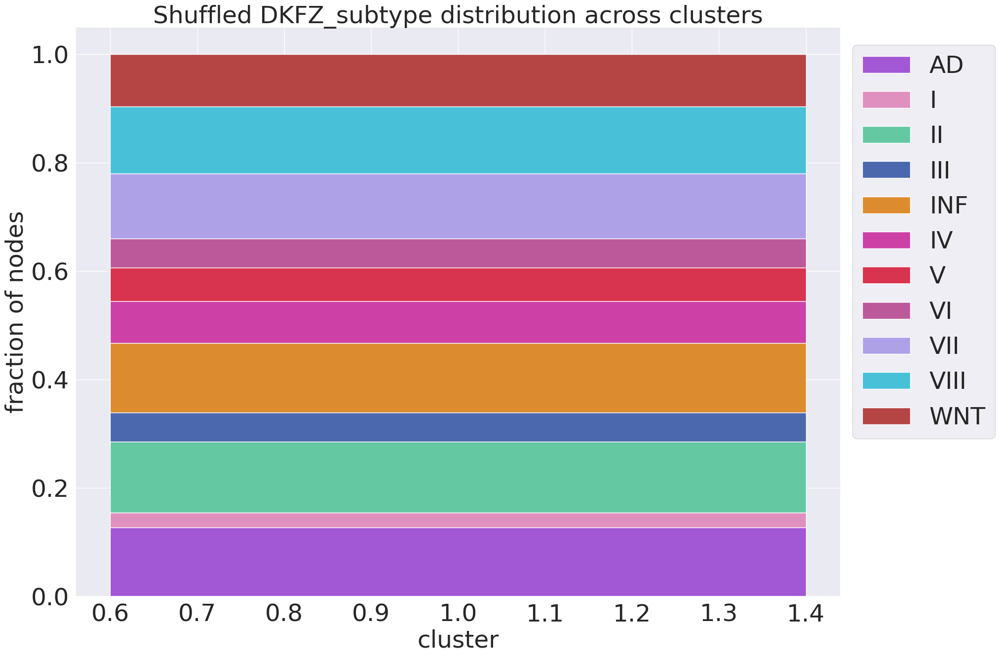

True DKFZ_subtype 1


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


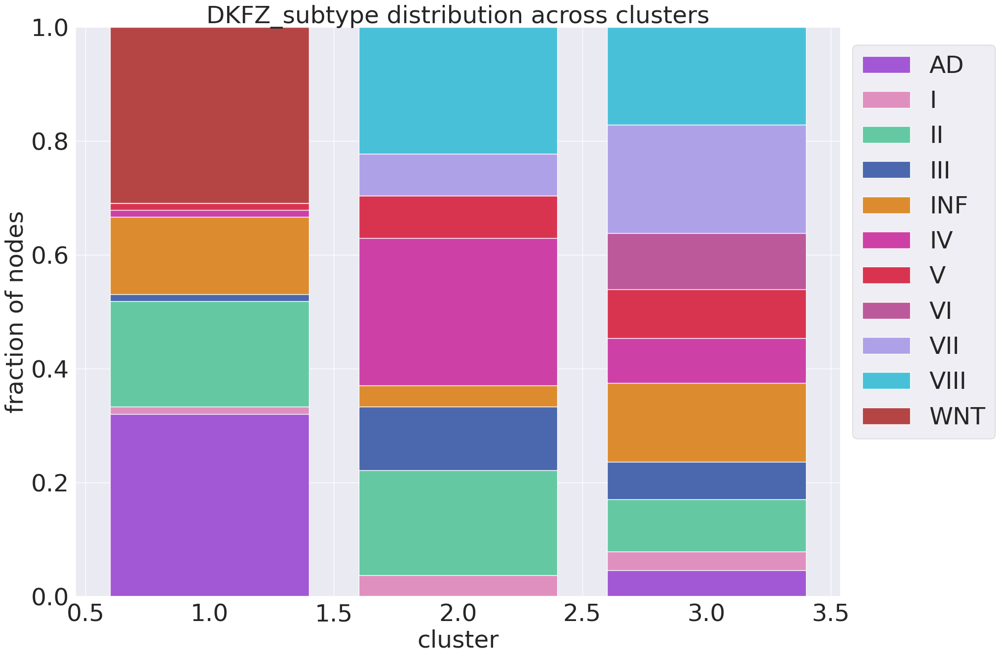

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


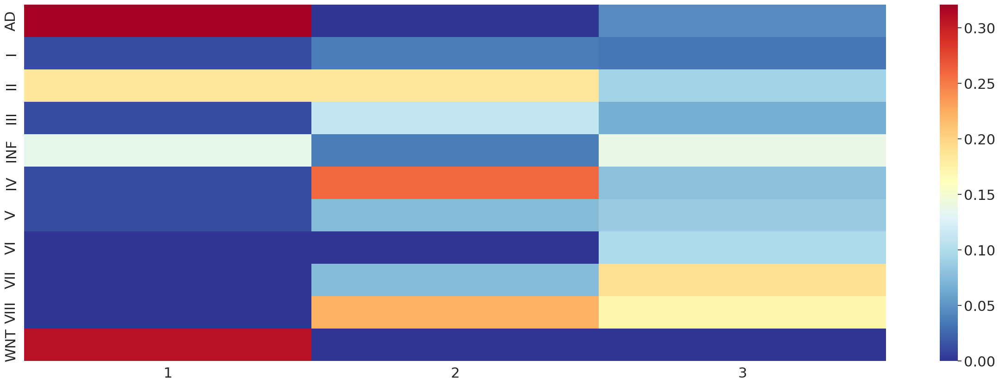

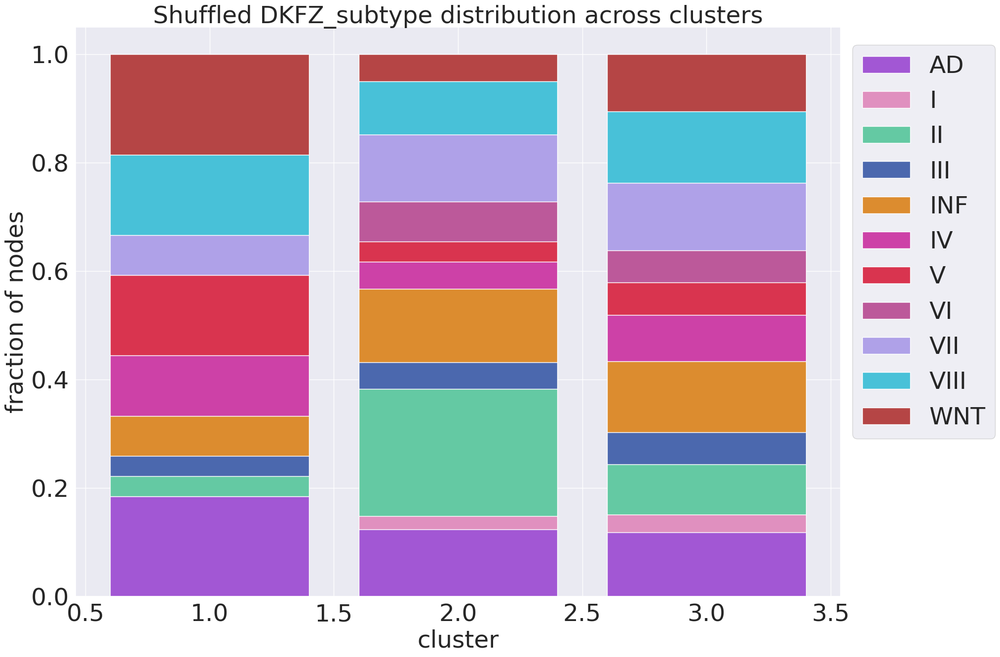

True DKFZ_subtype 0


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


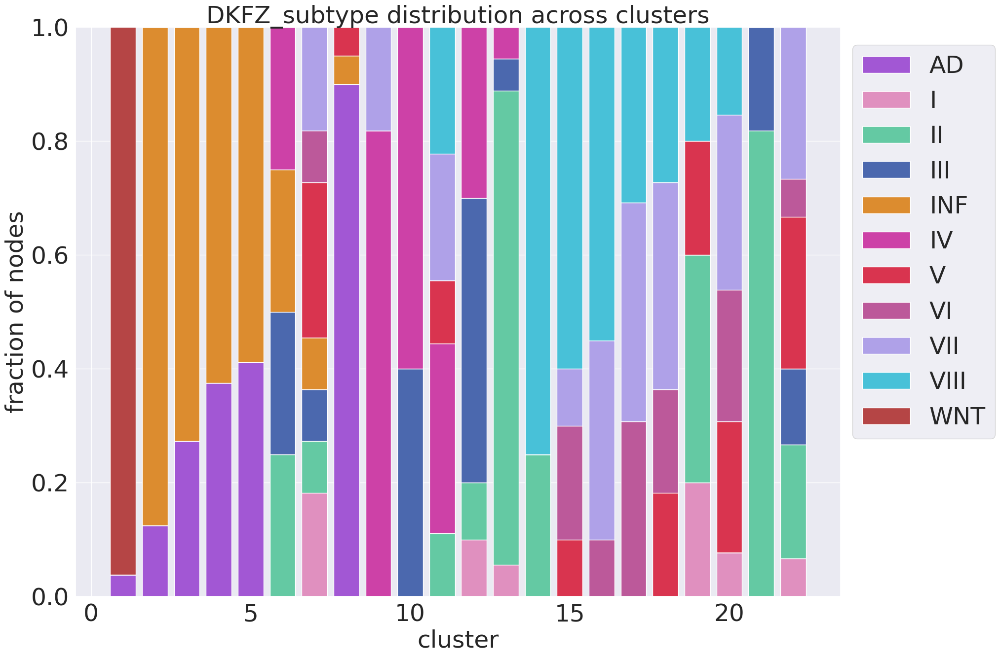

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


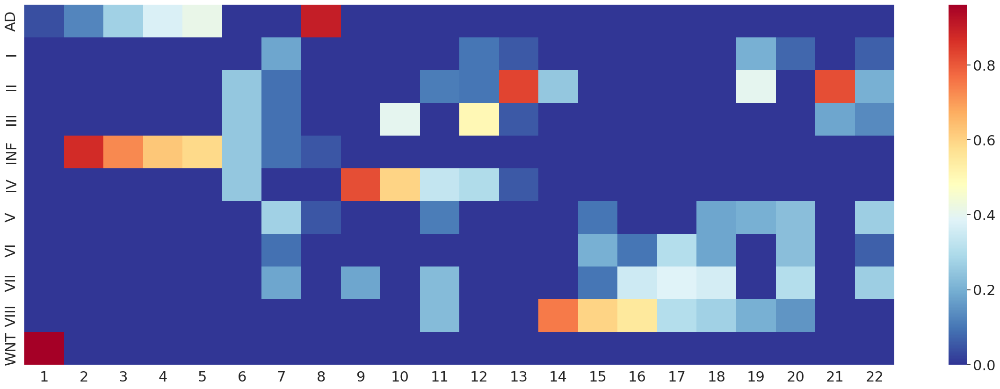

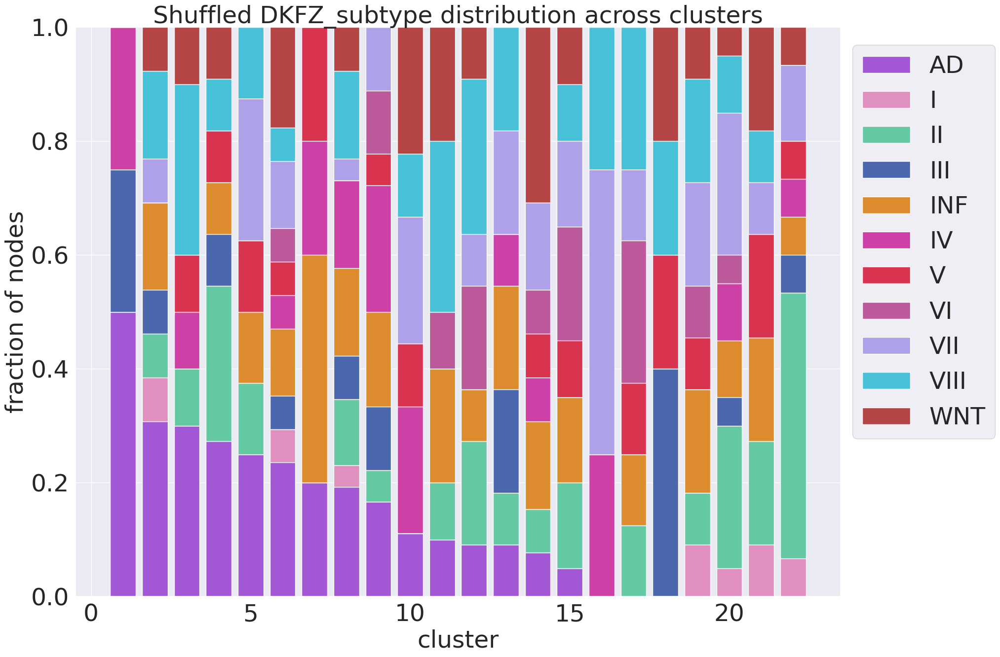

True Proteome_subgroup 10


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


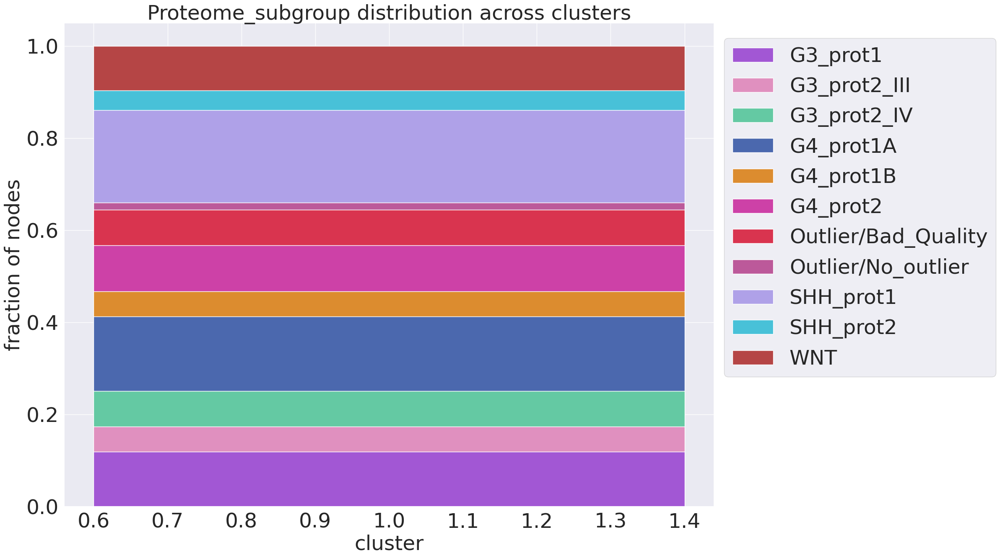

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


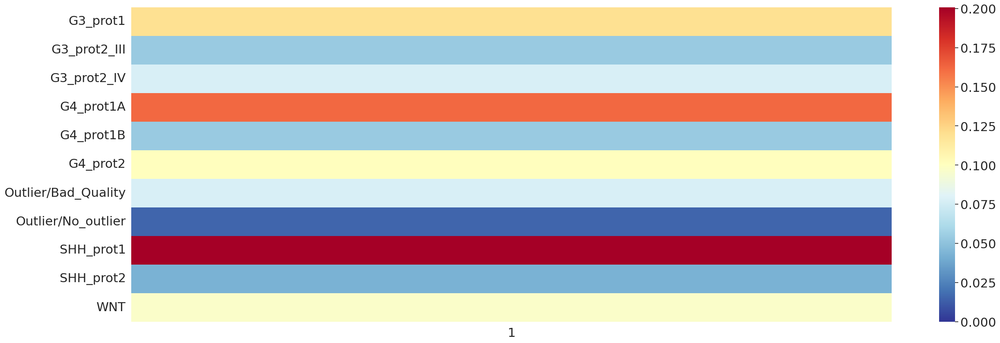

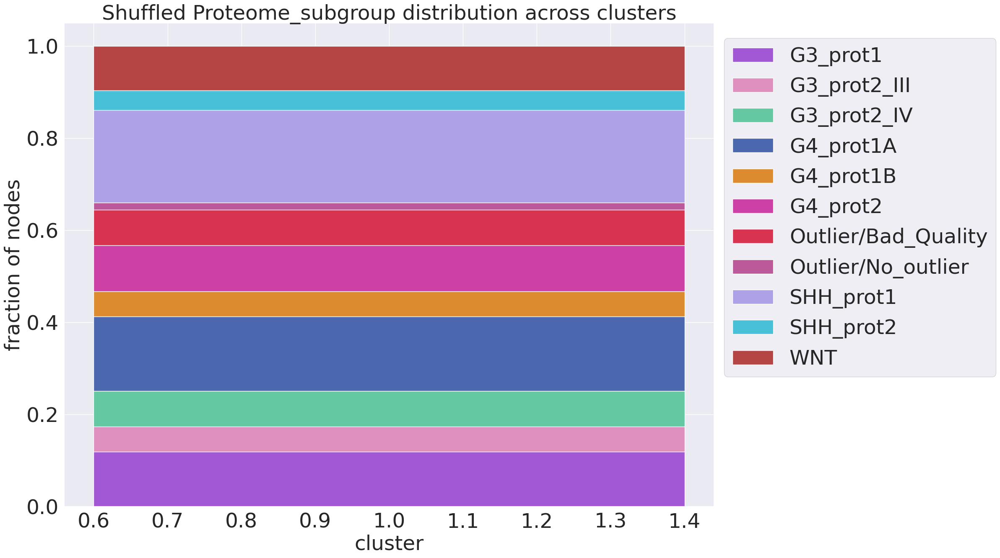

True Proteome_subgroup 9


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


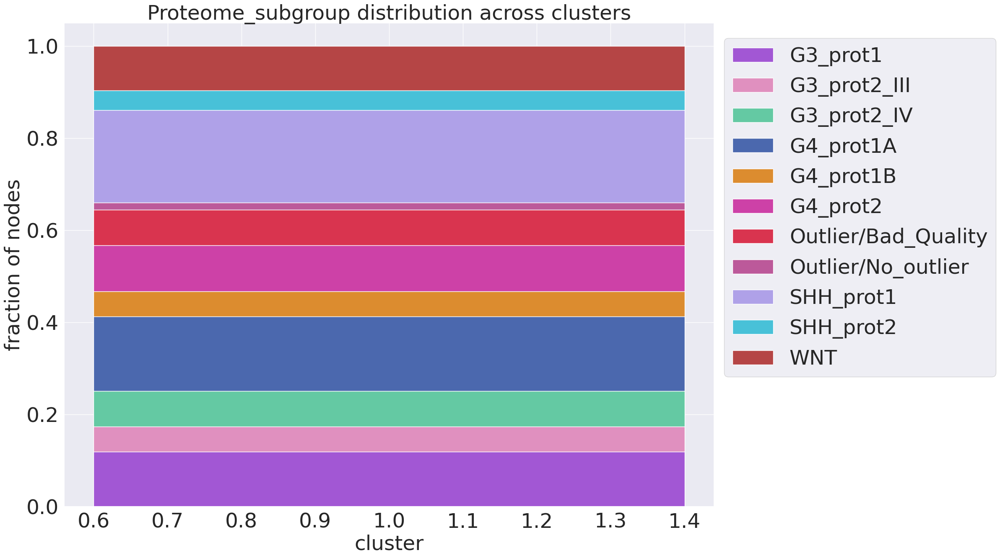

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


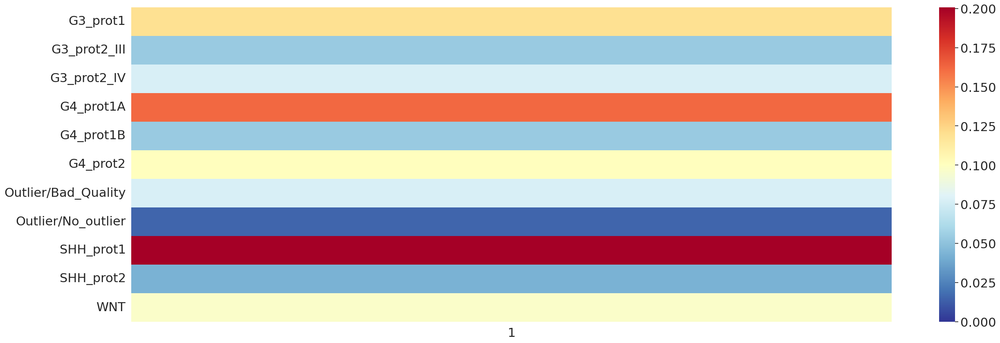

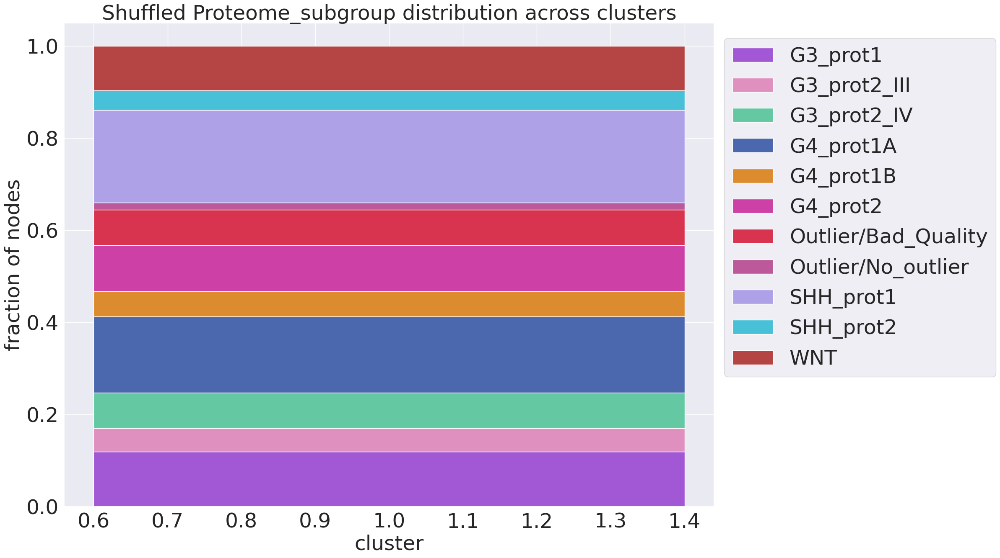

True Proteome_subgroup 8


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


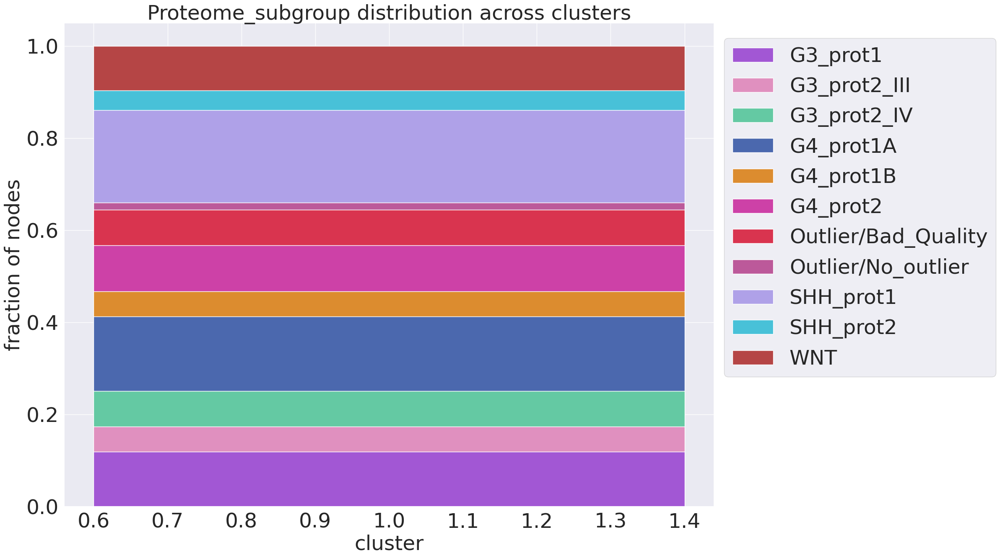

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


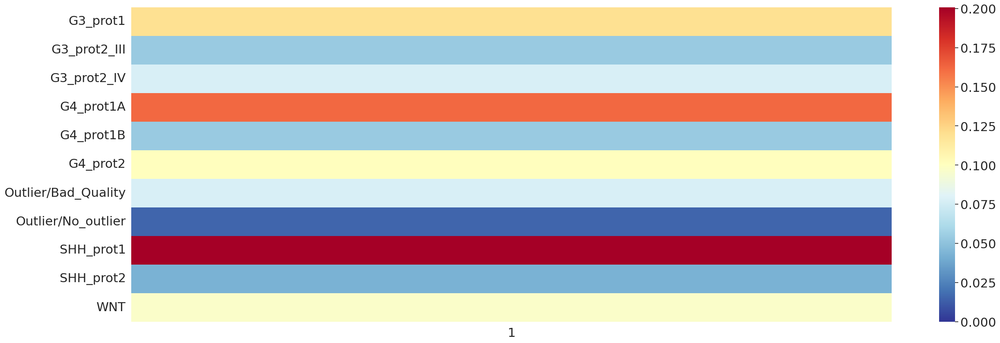

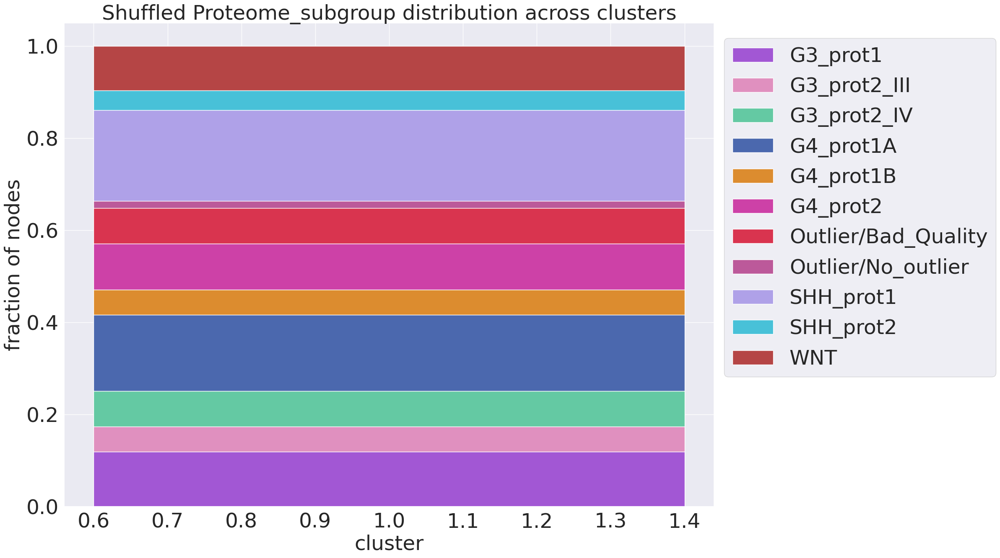

True Proteome_subgroup 7


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


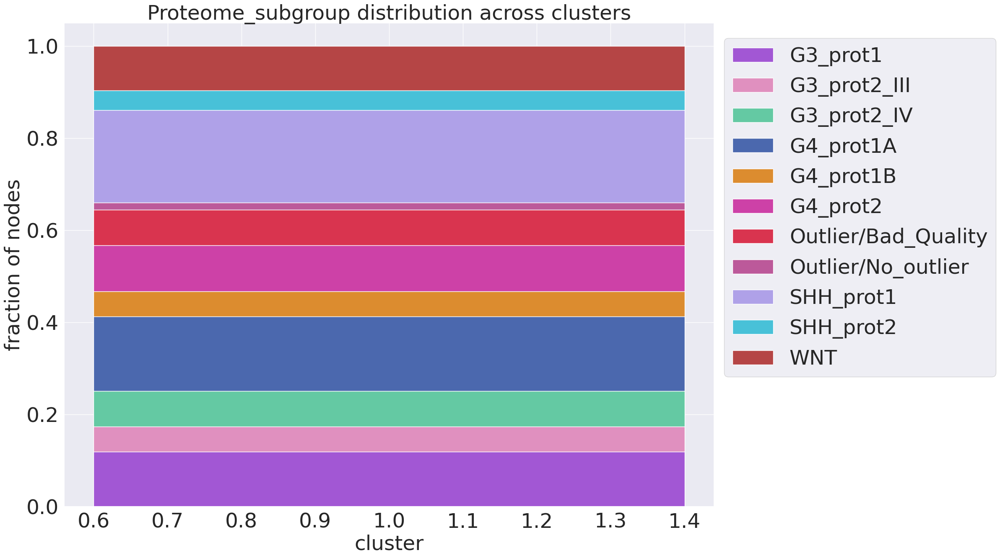

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


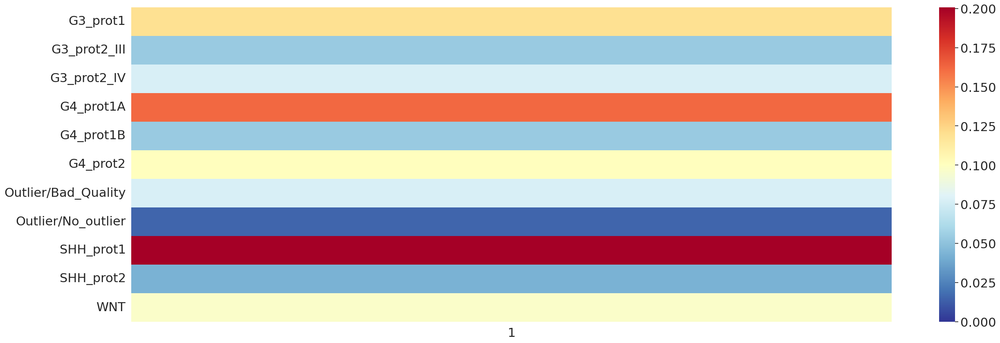

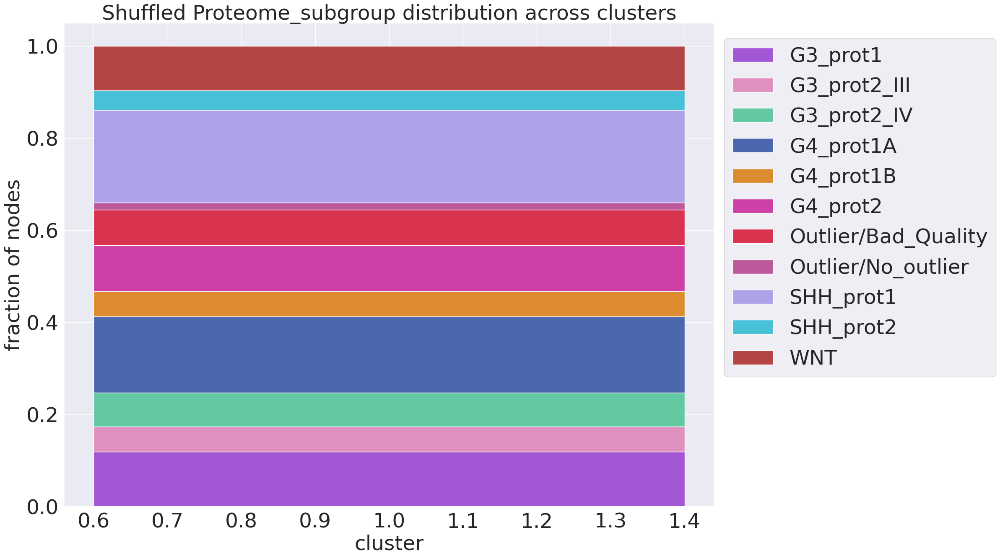

True Proteome_subgroup 6


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


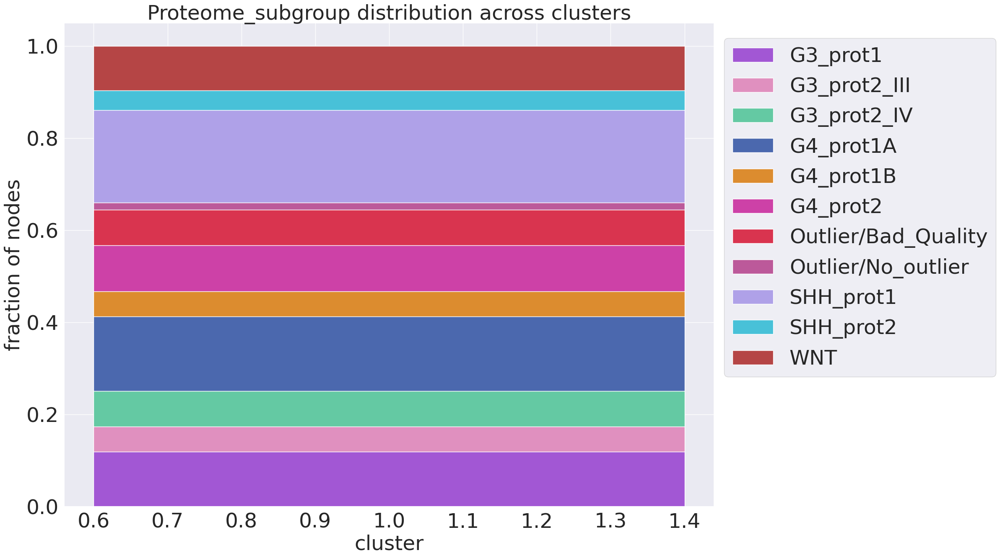

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


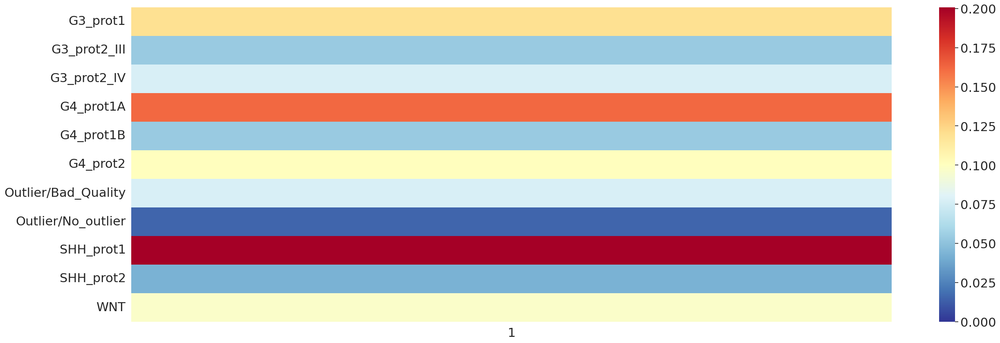

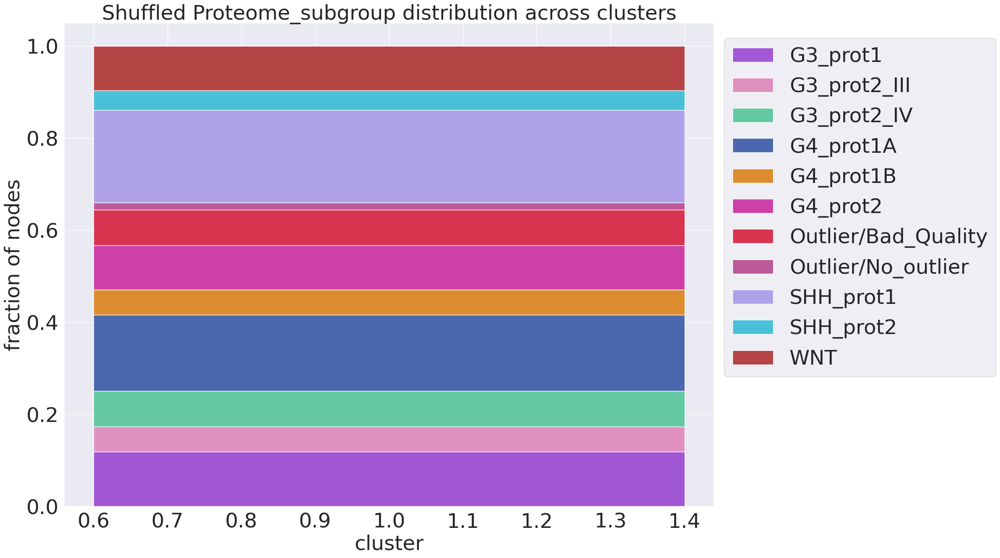

True Proteome_subgroup 5


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


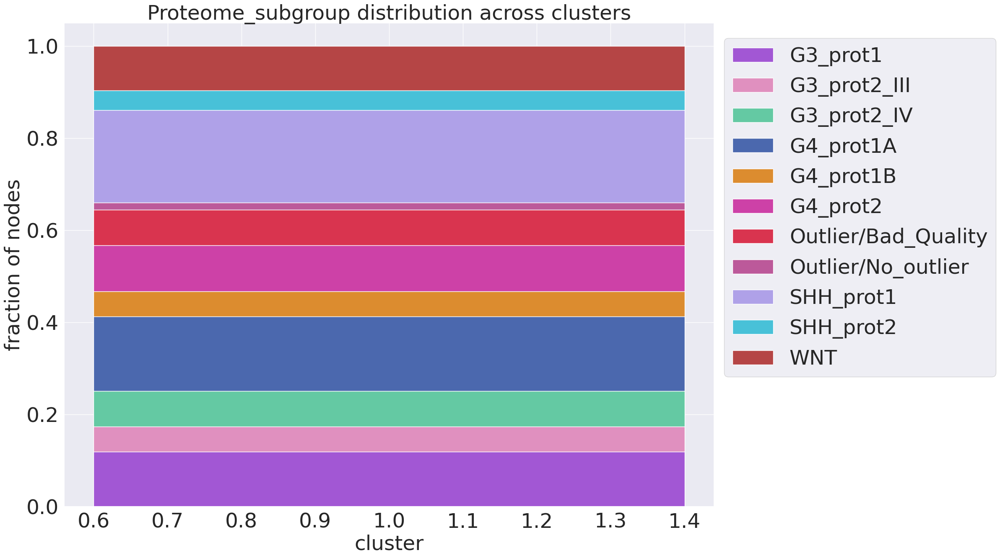

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


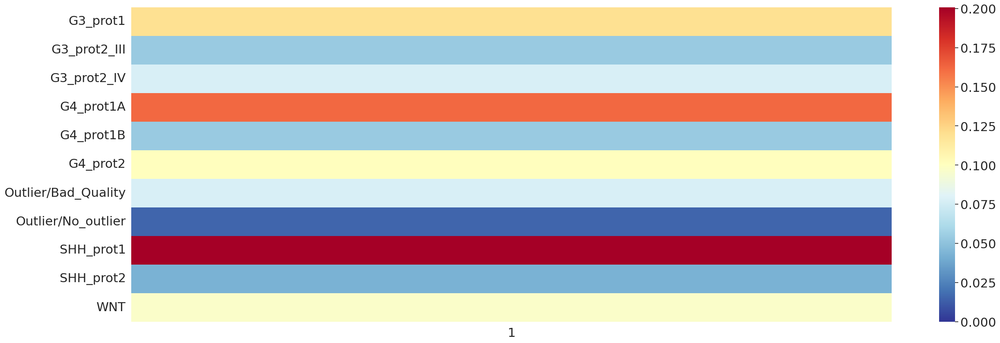

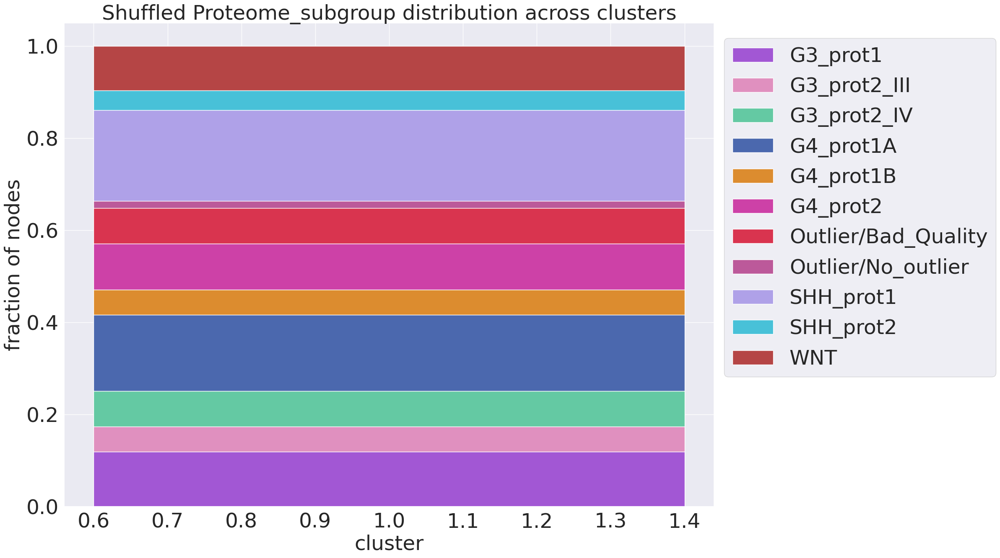

True Proteome_subgroup 4


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


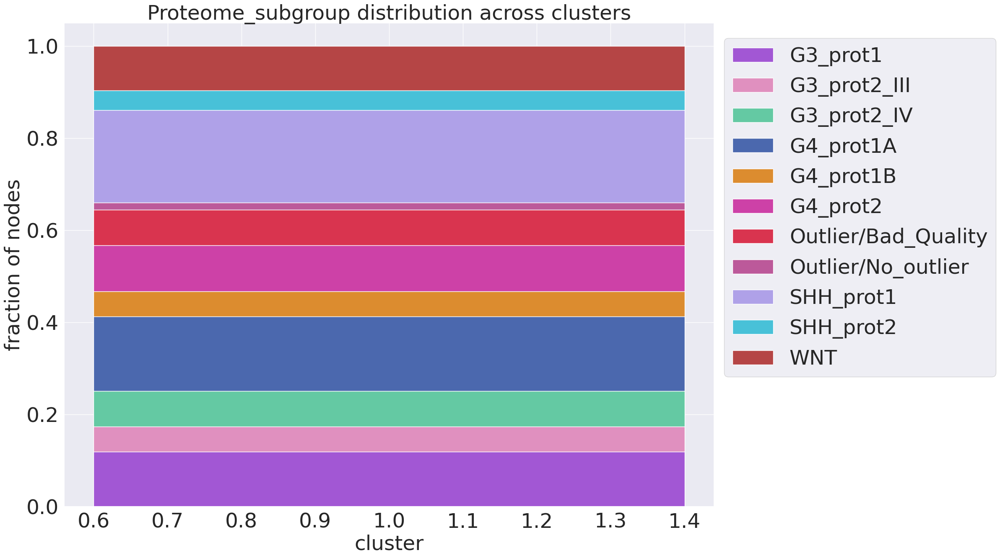

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


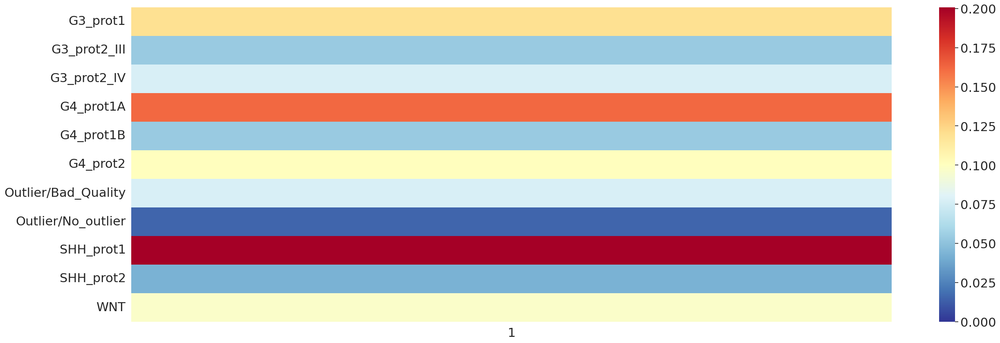

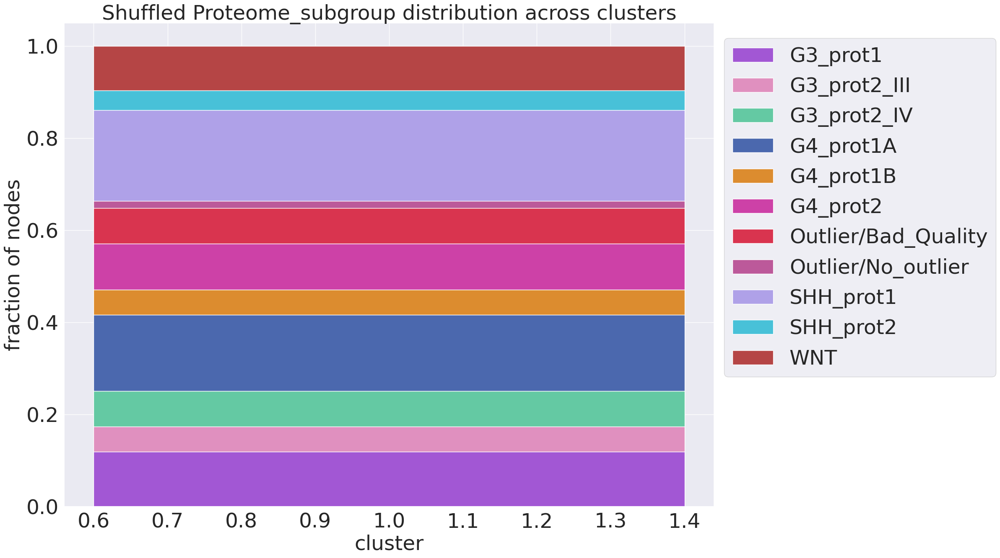

True Proteome_subgroup 3


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


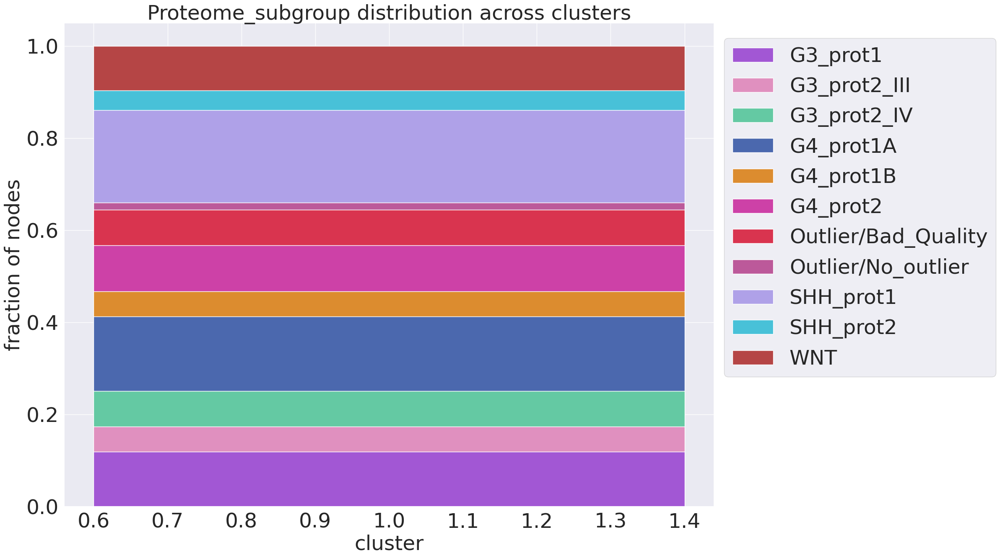

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


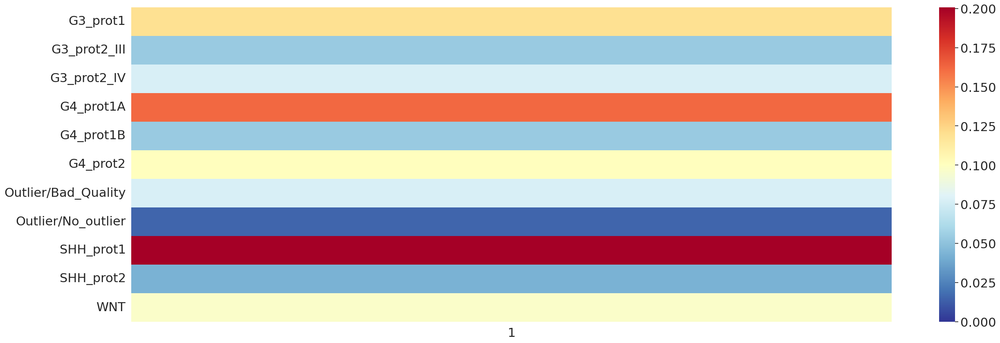

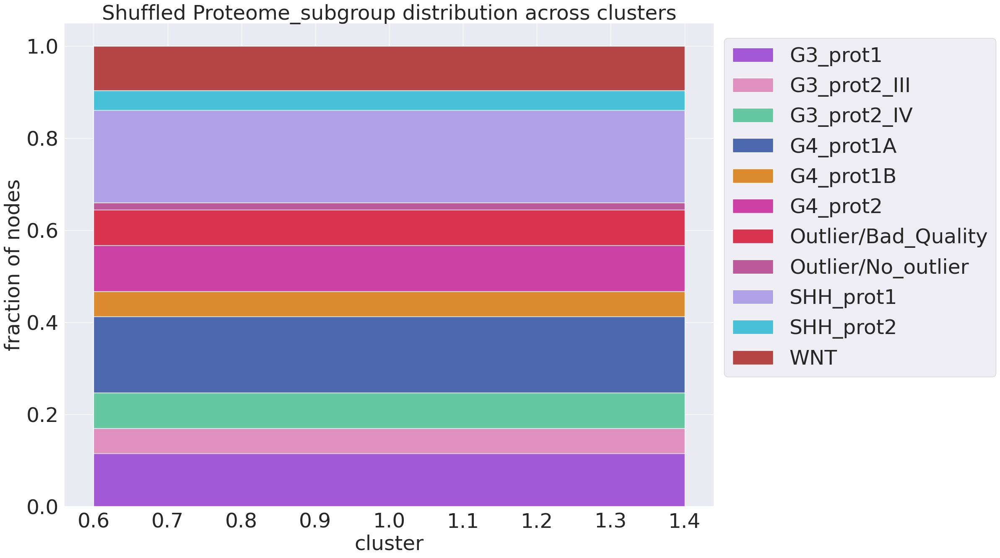

True Proteome_subgroup 2


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


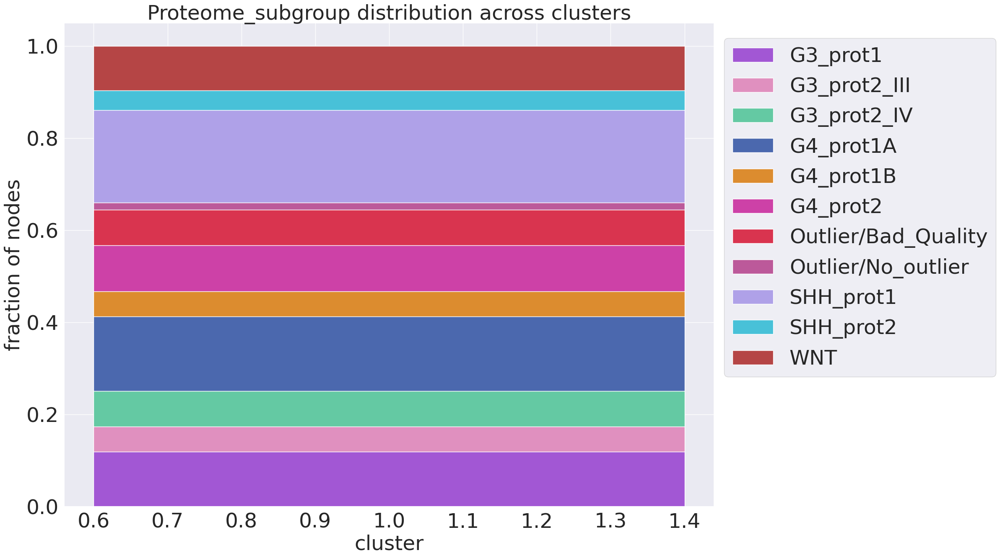

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


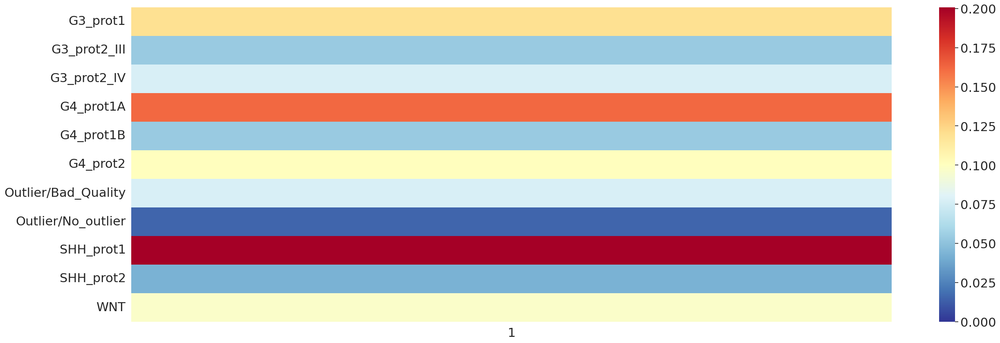

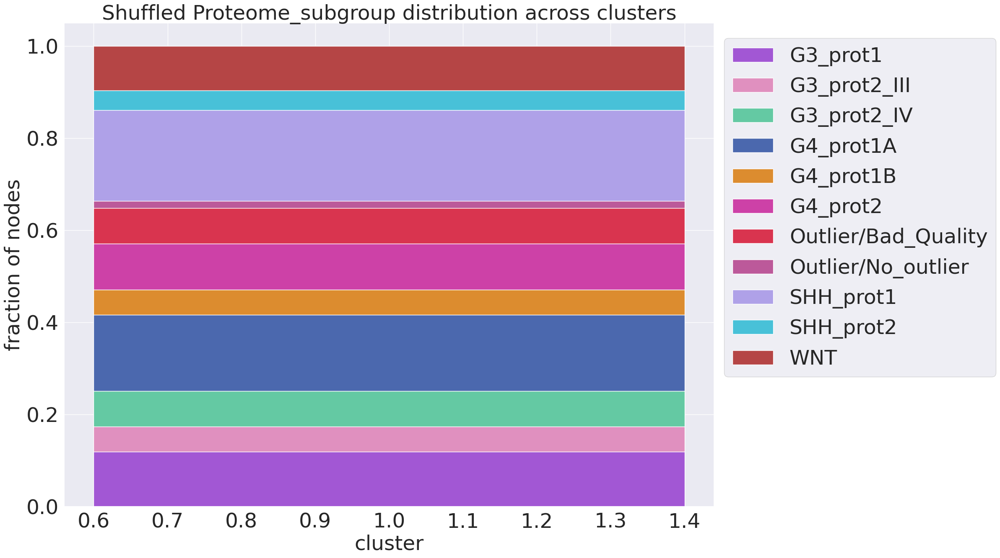

True Proteome_subgroup 1


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


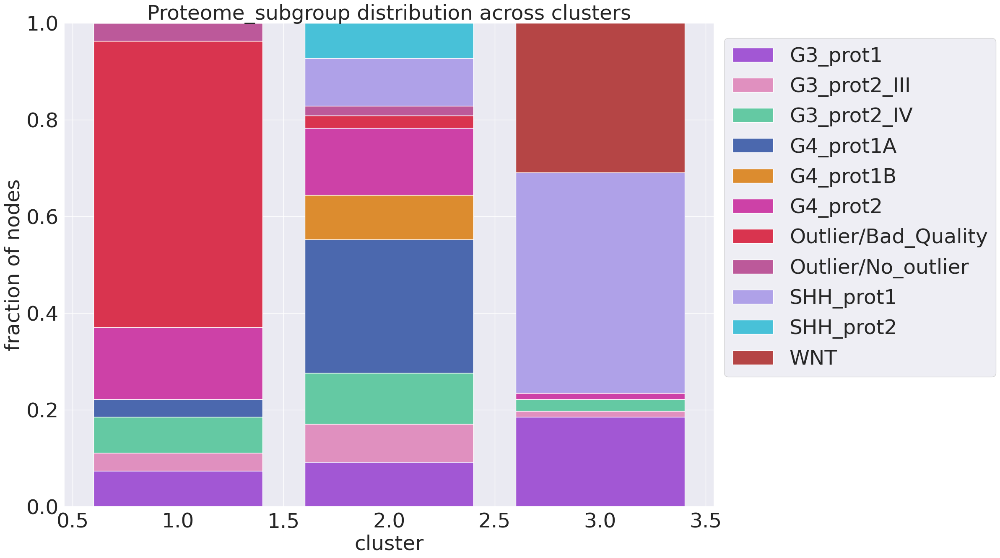

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


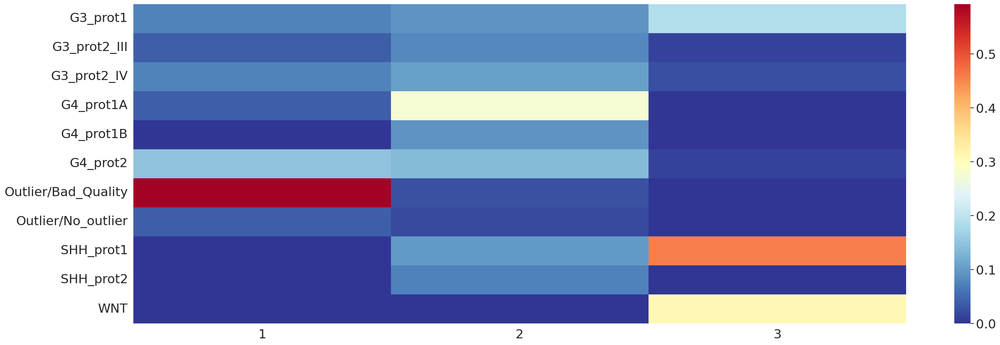

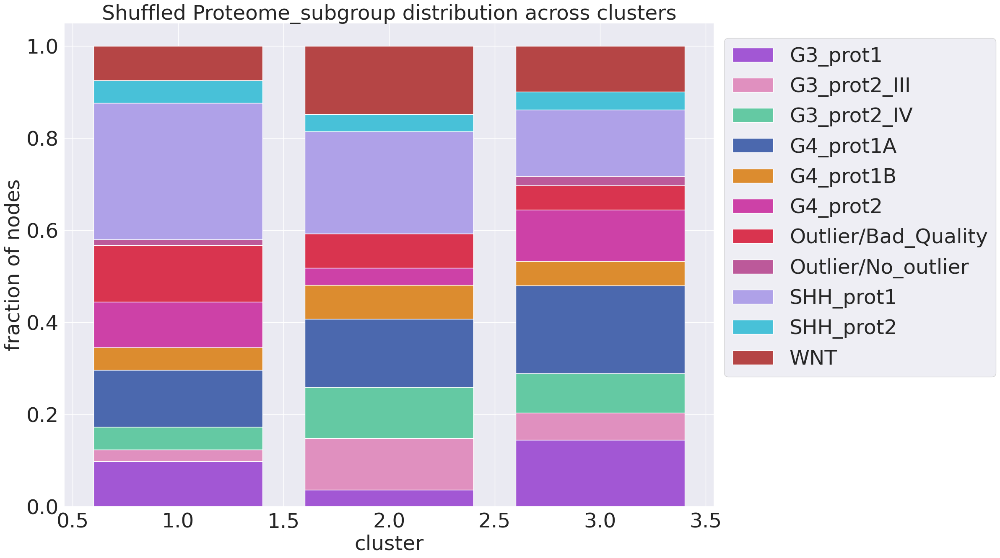

True Proteome_subgroup 0


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


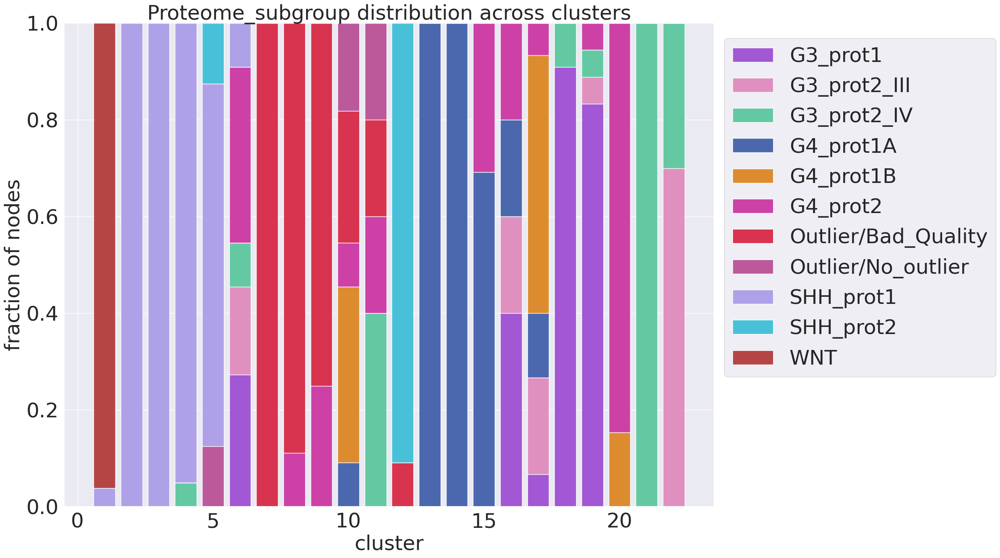

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


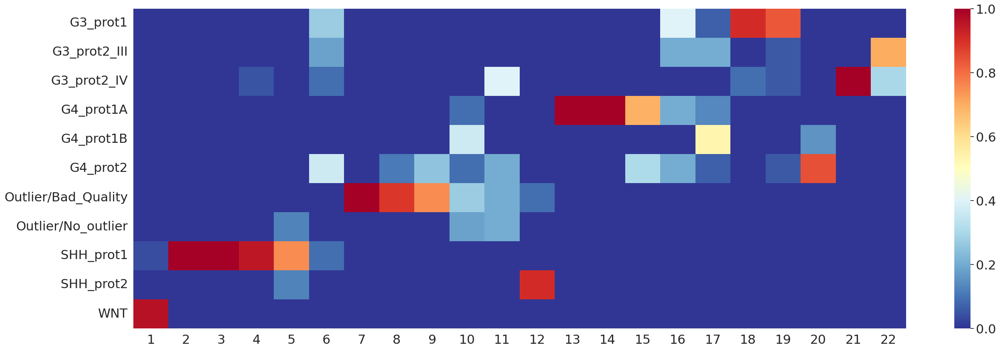

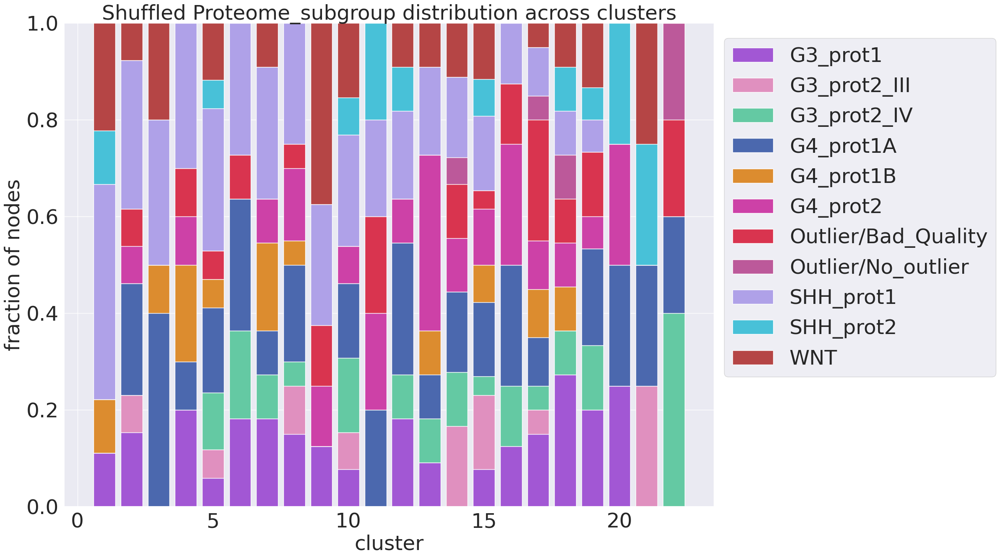

False DKFZ_subgroup 10


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


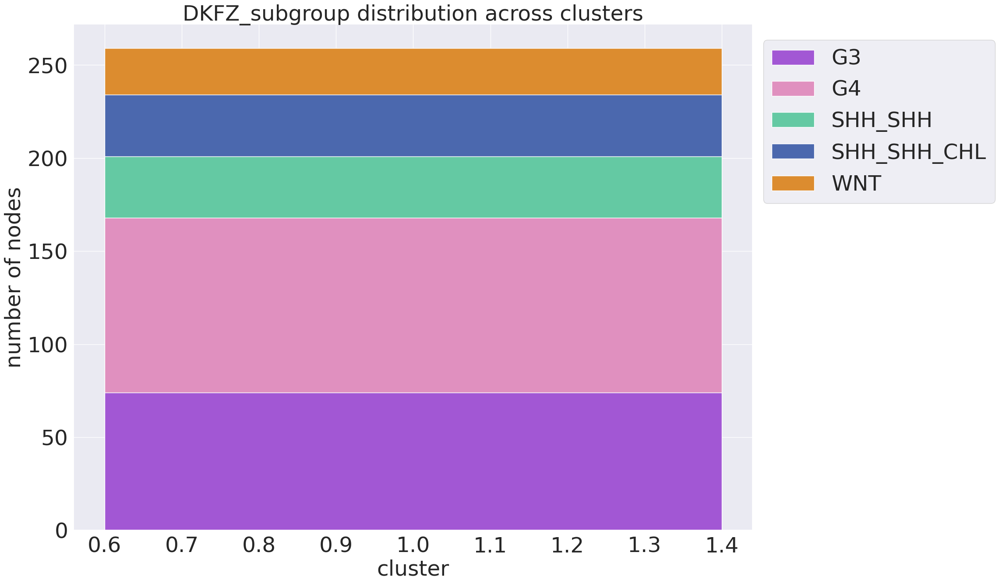

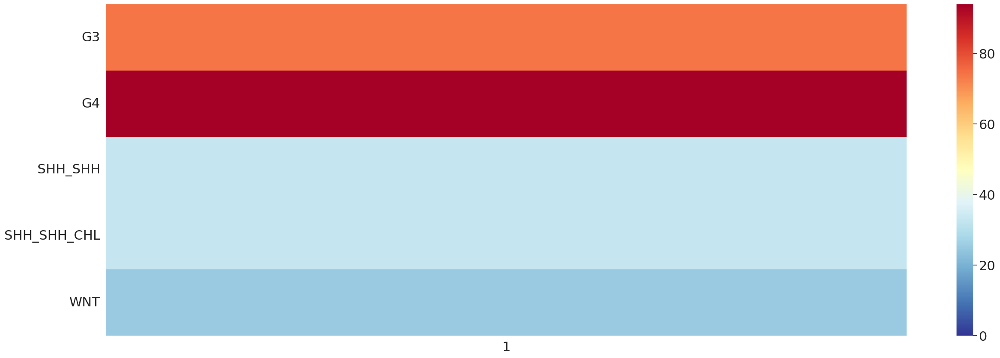

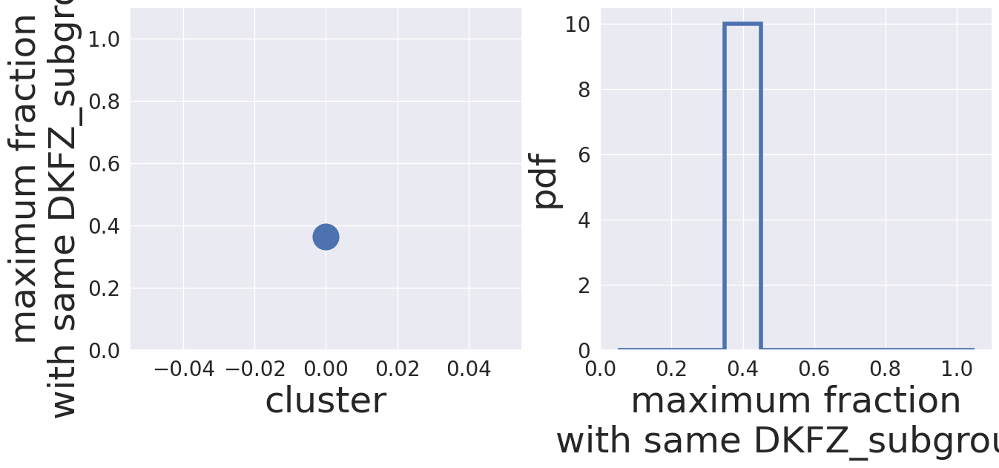

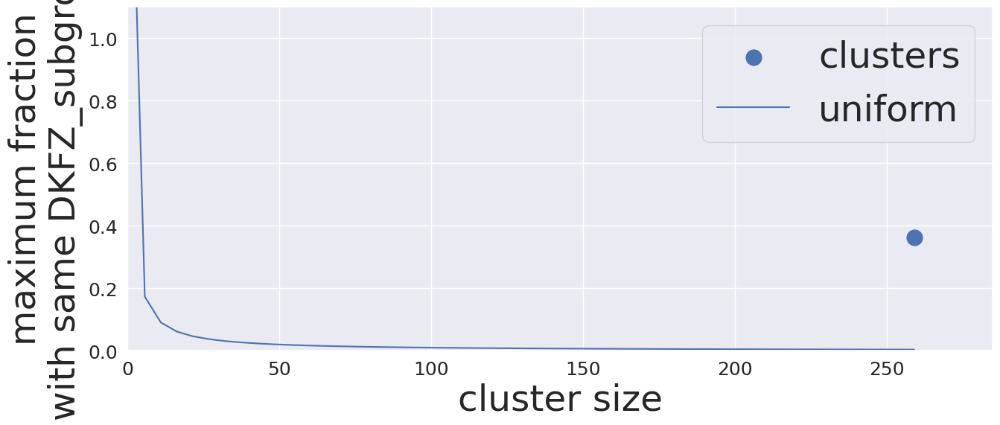

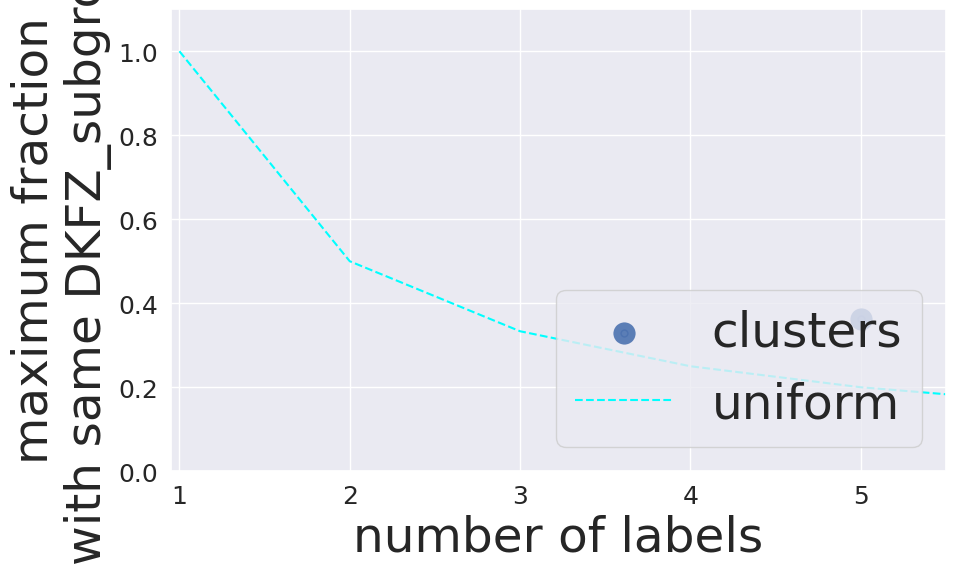

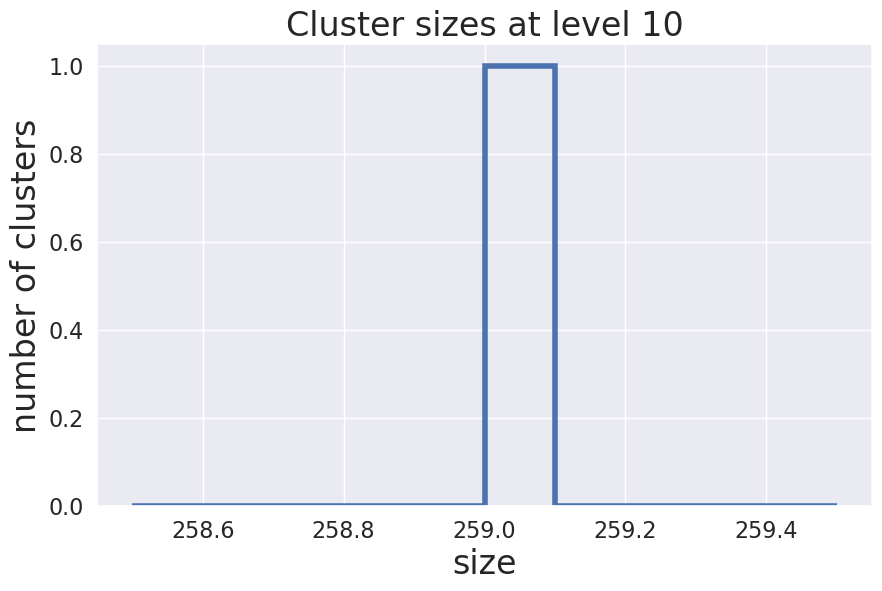

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


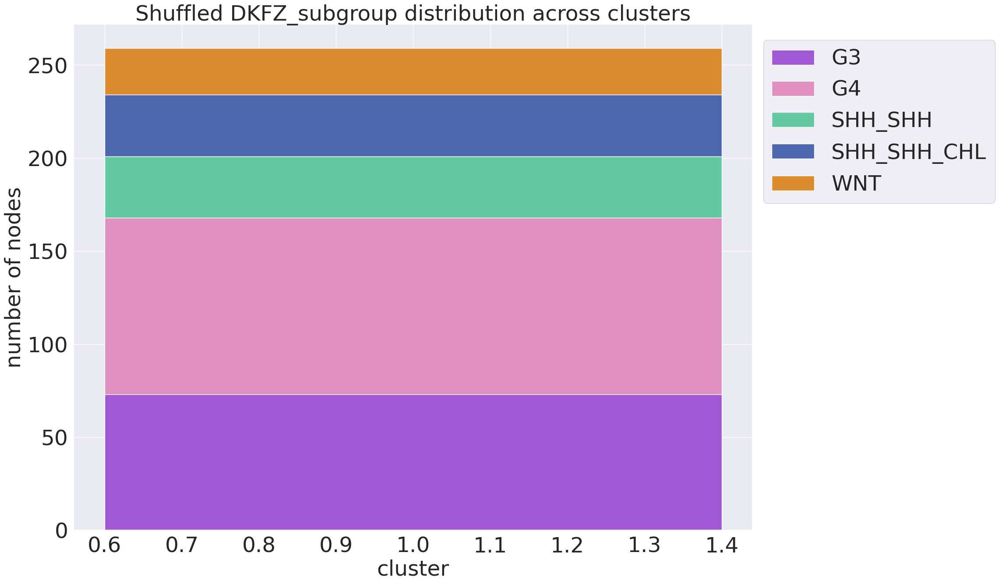

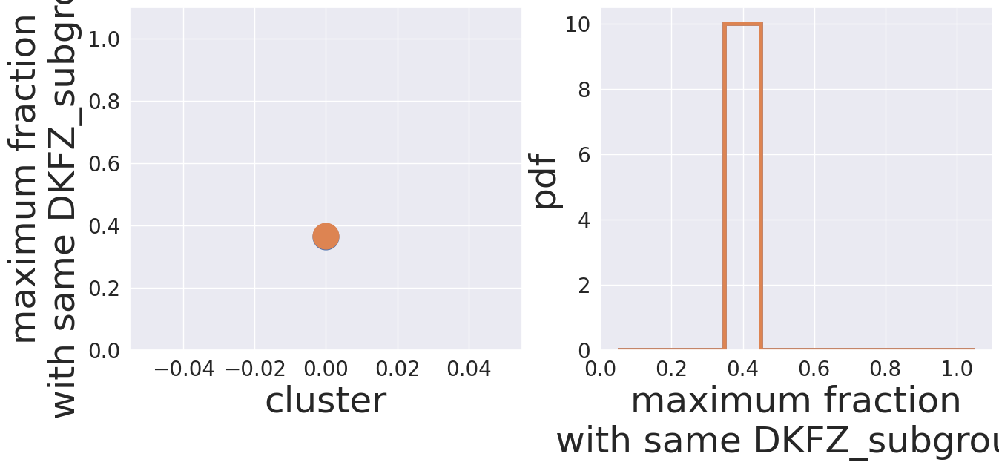

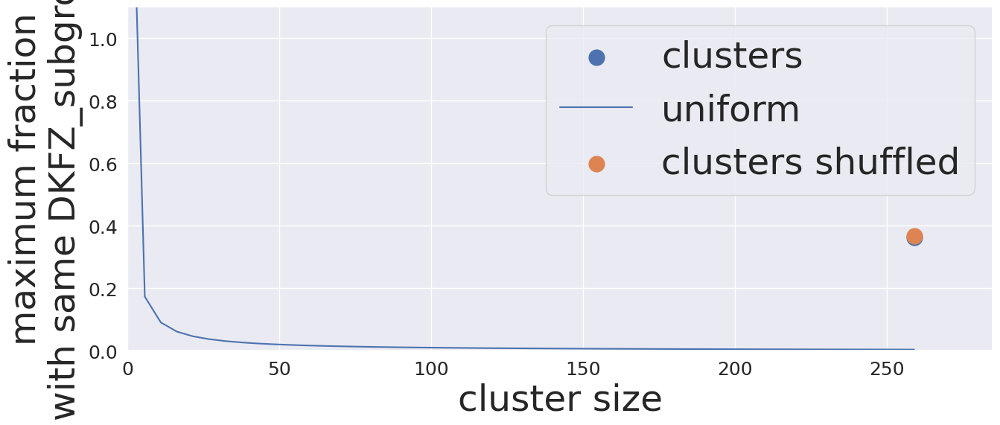

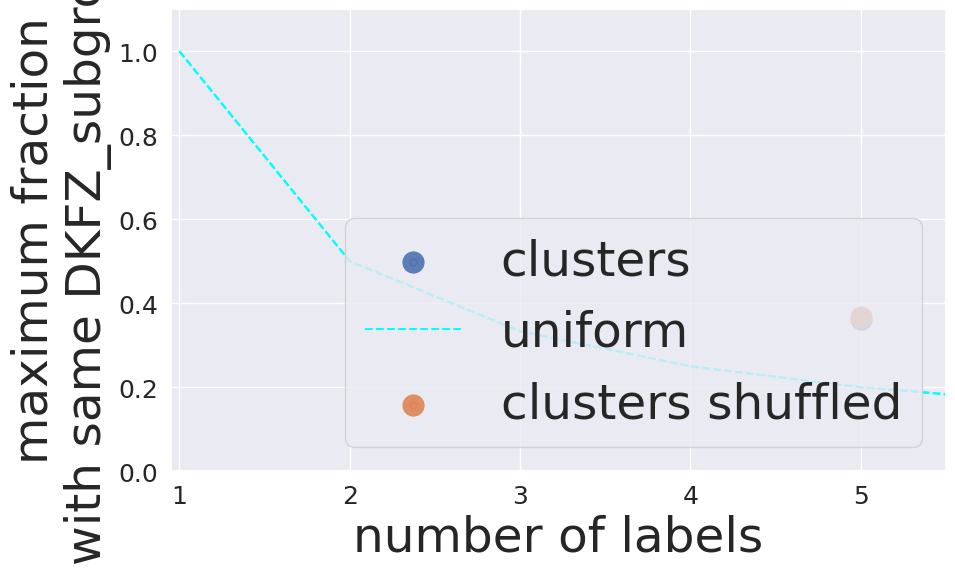

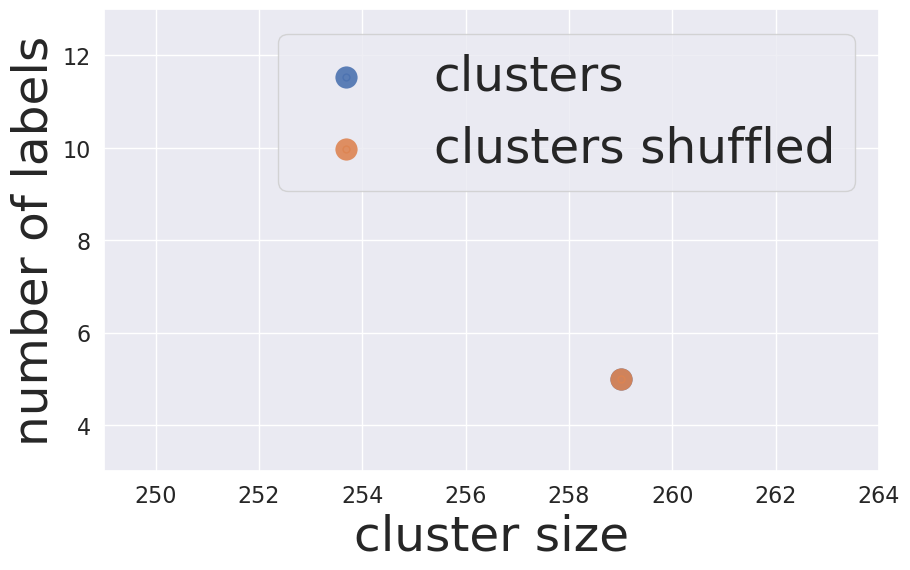

False DKFZ_subgroup 9


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


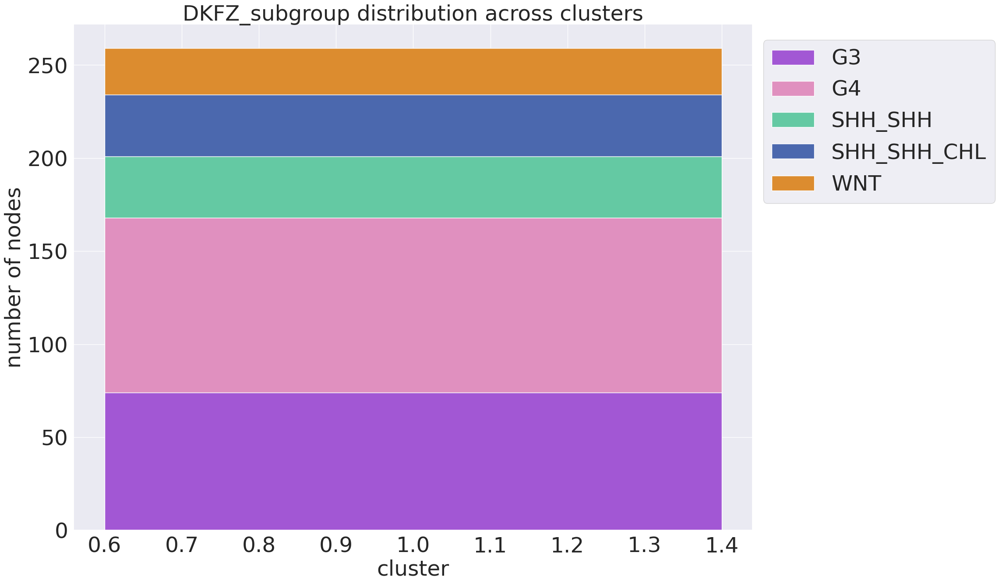

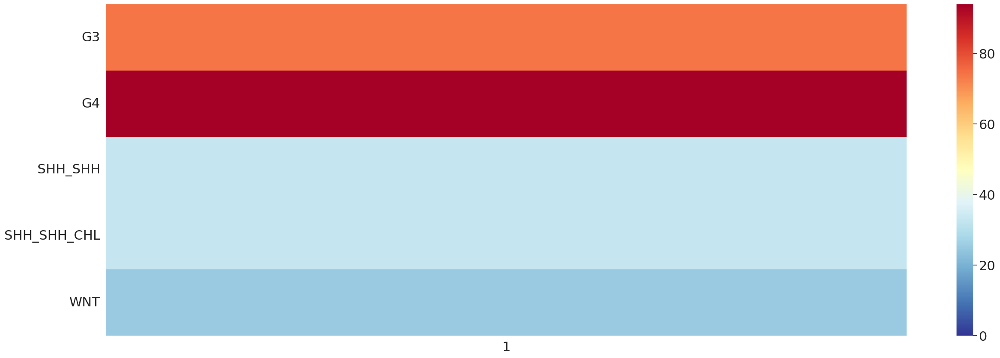

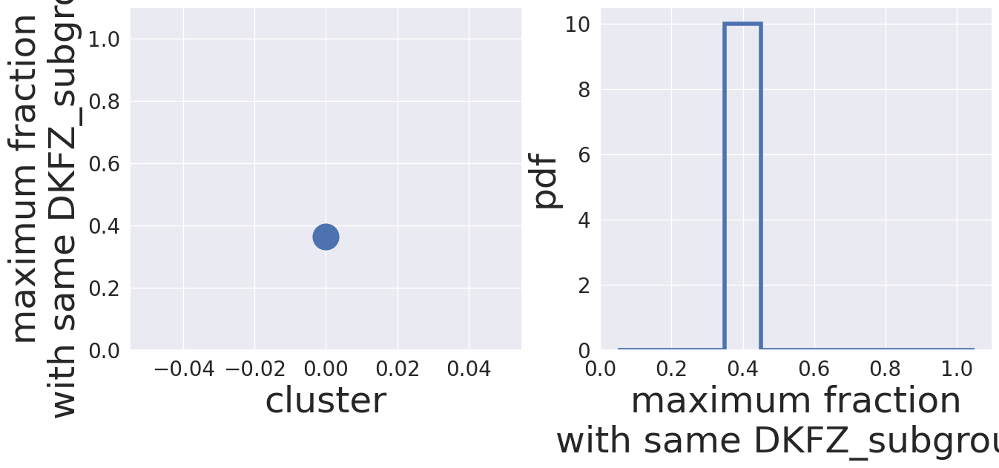

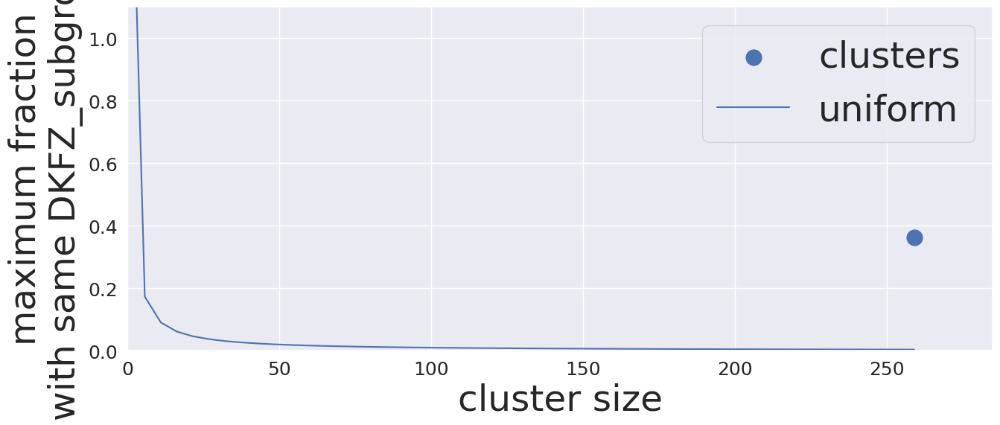

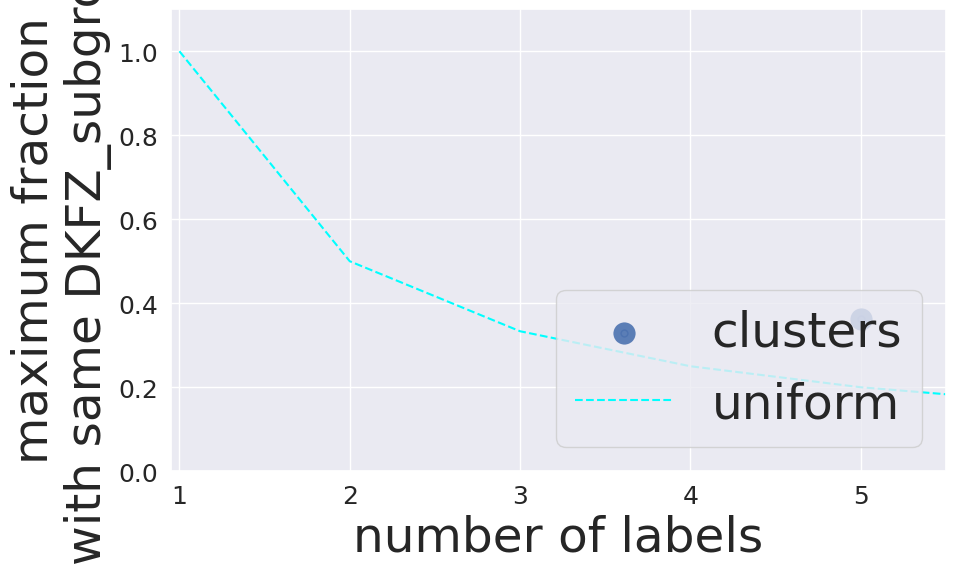

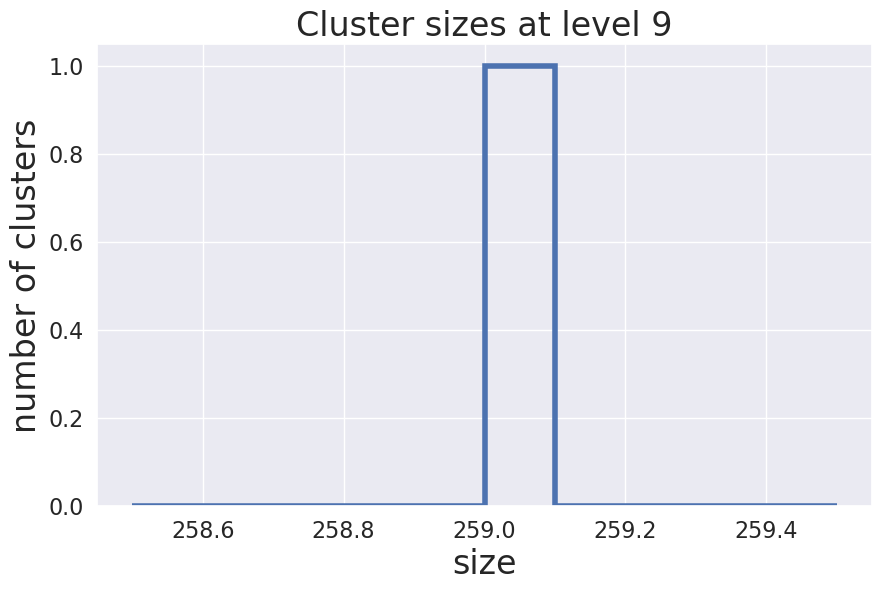

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


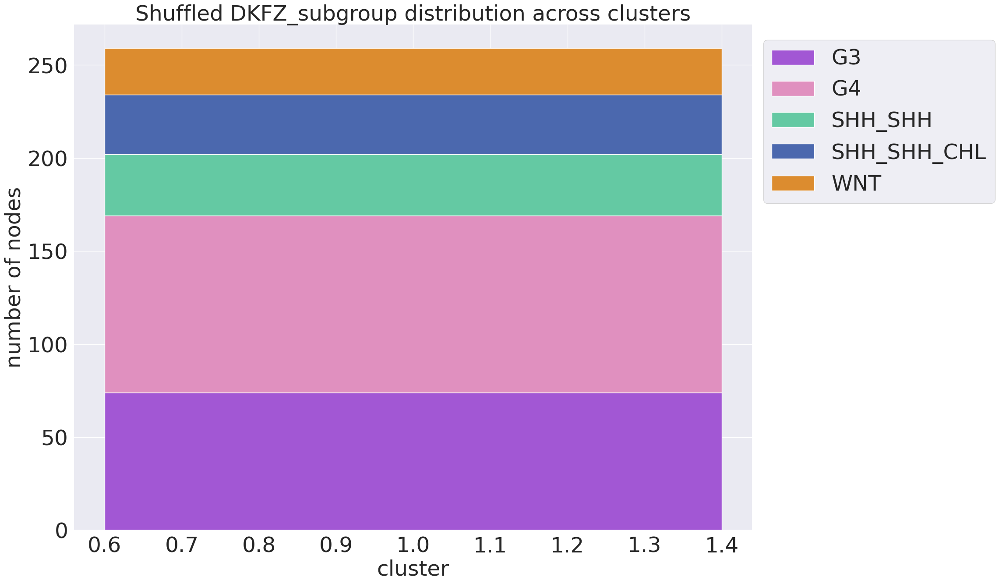

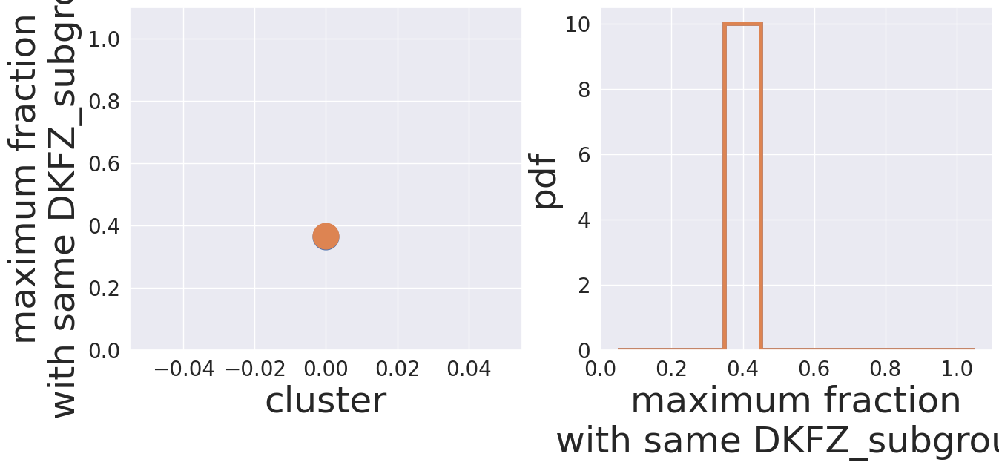

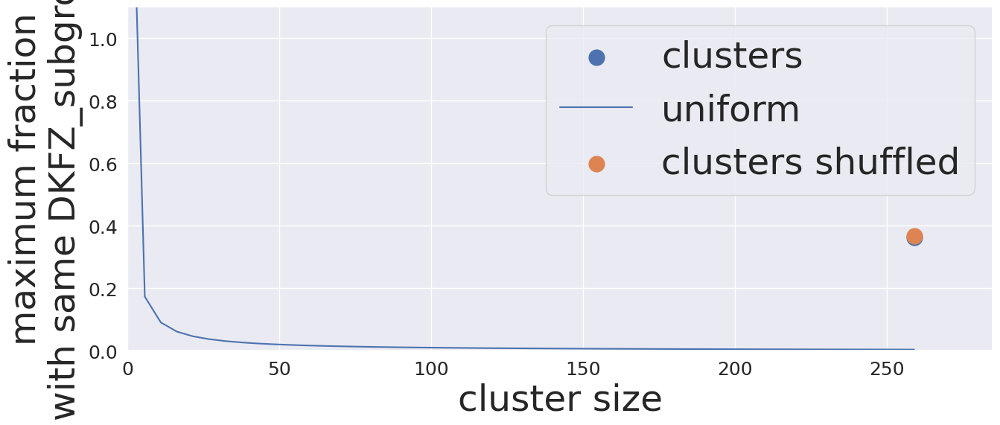

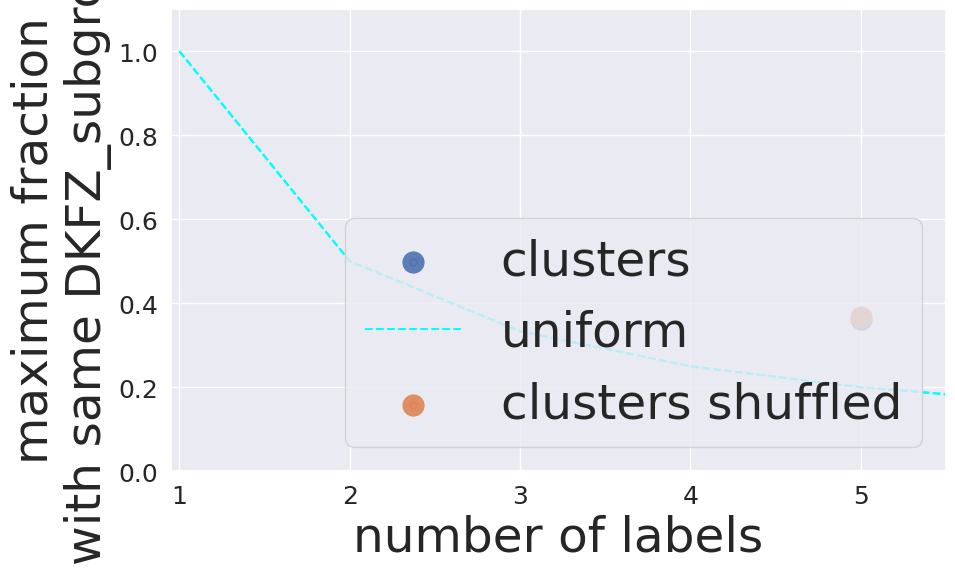

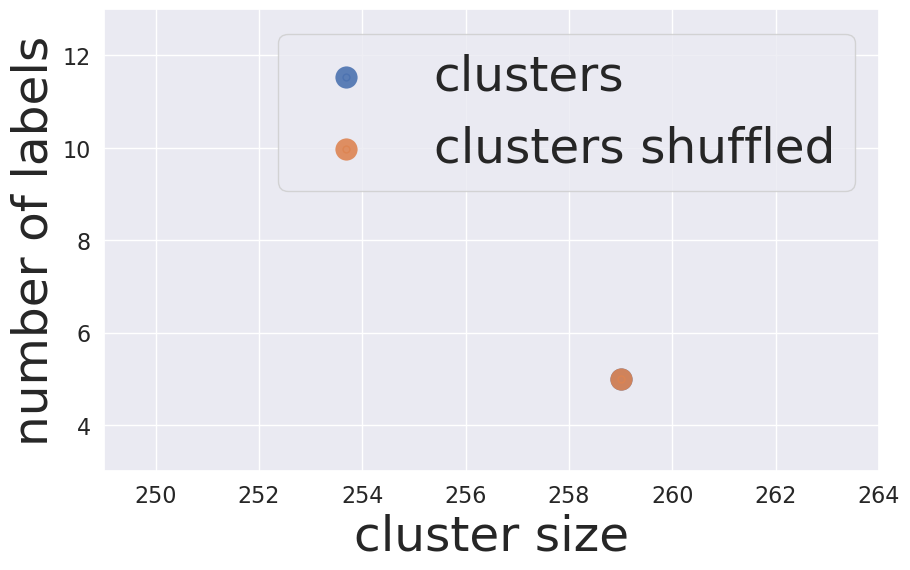

False DKFZ_subgroup 8


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


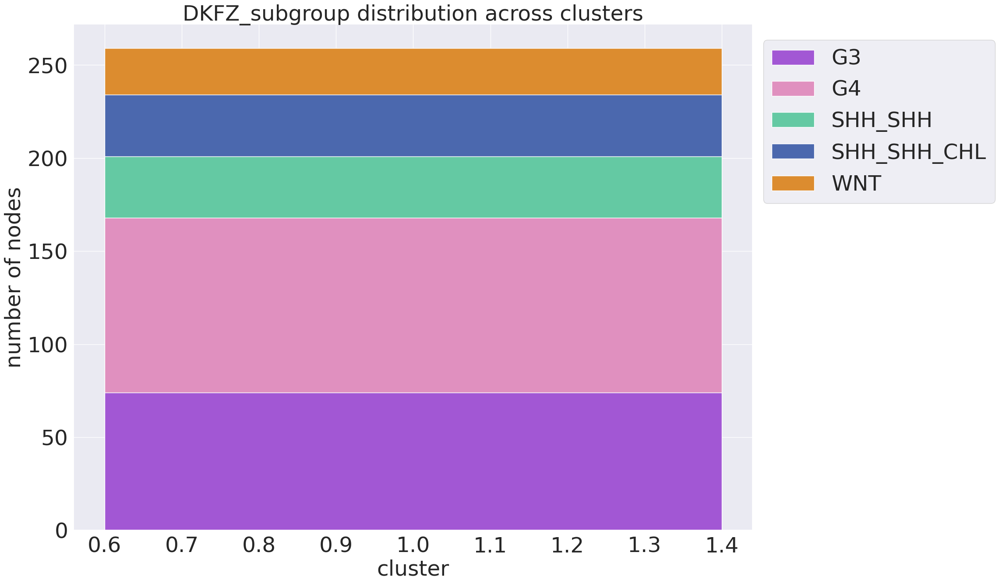

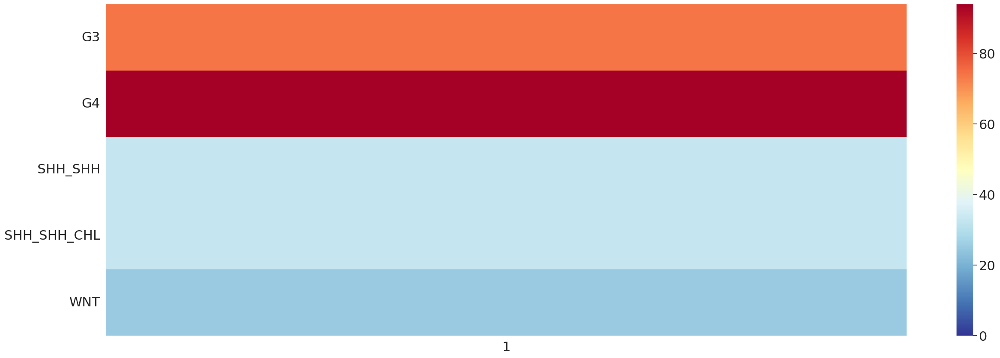

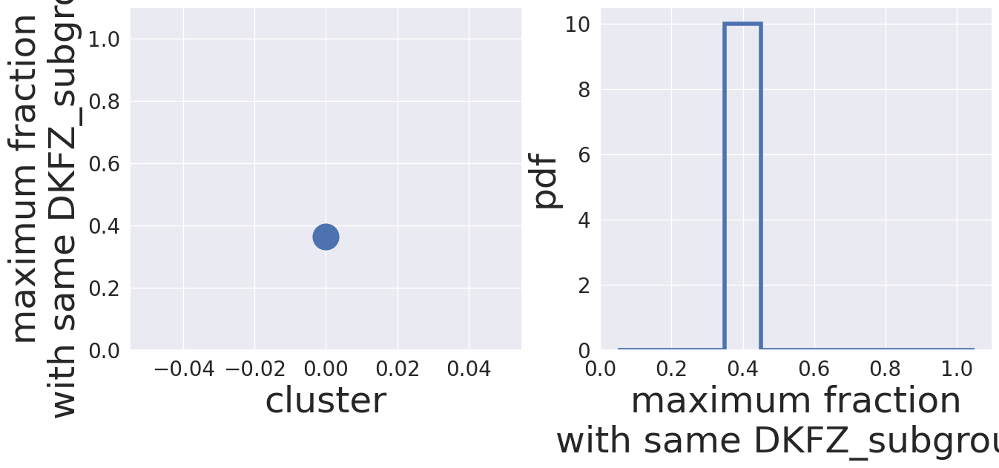

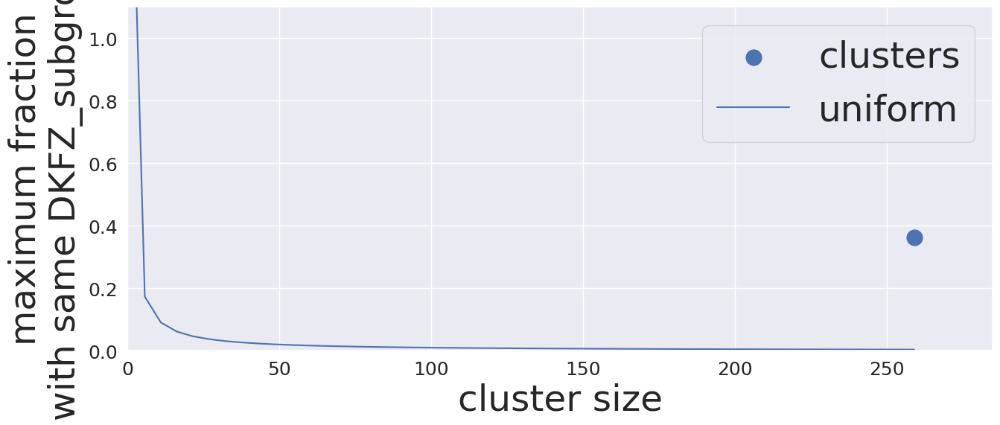

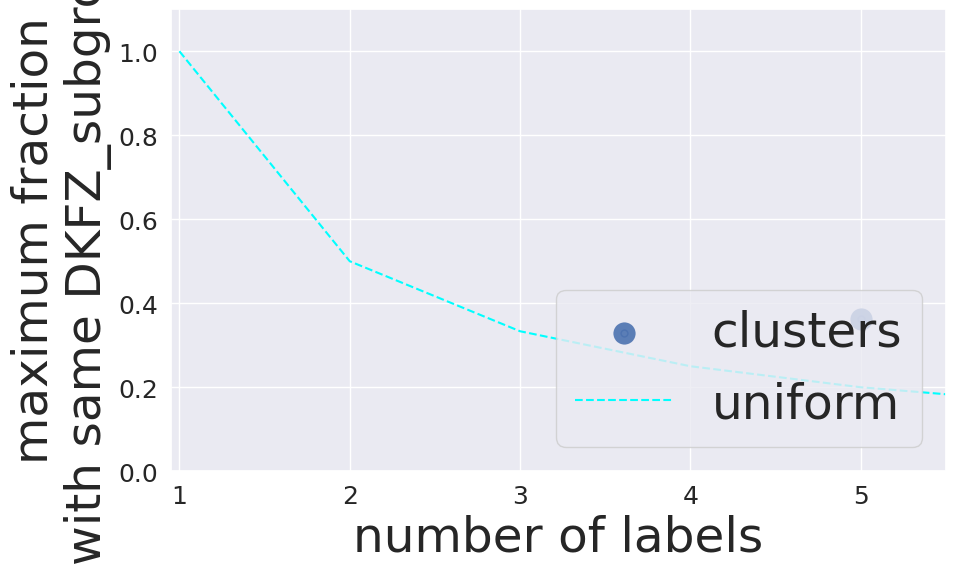

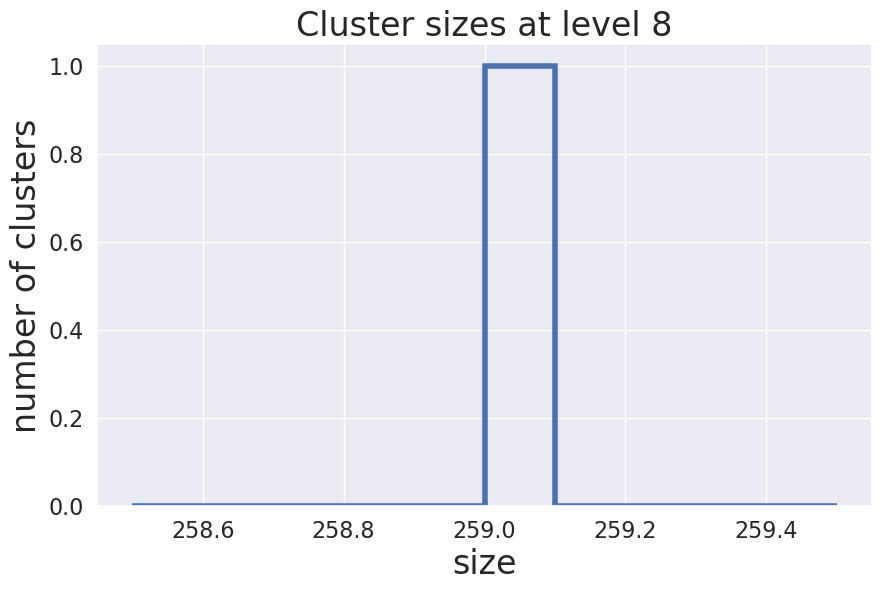

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


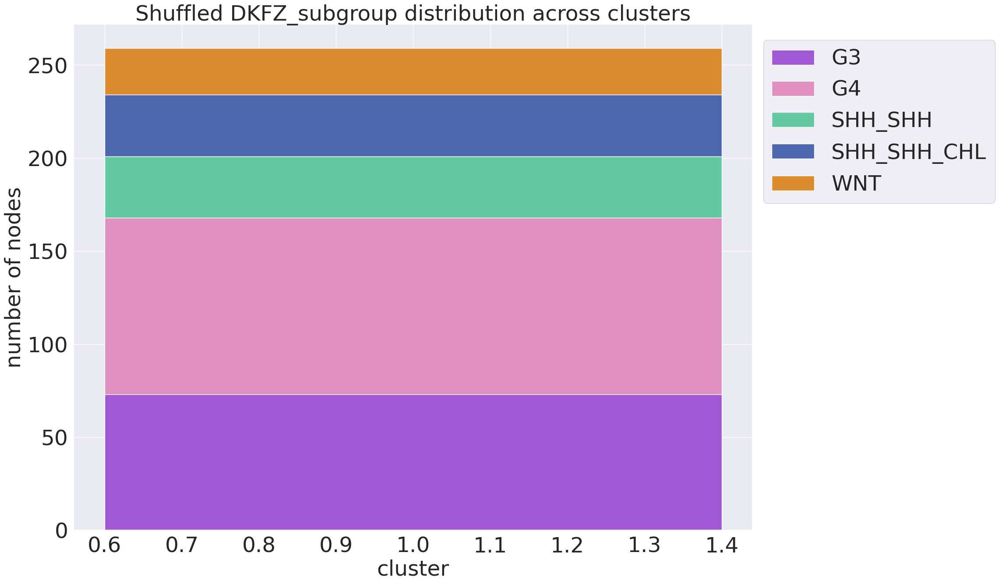

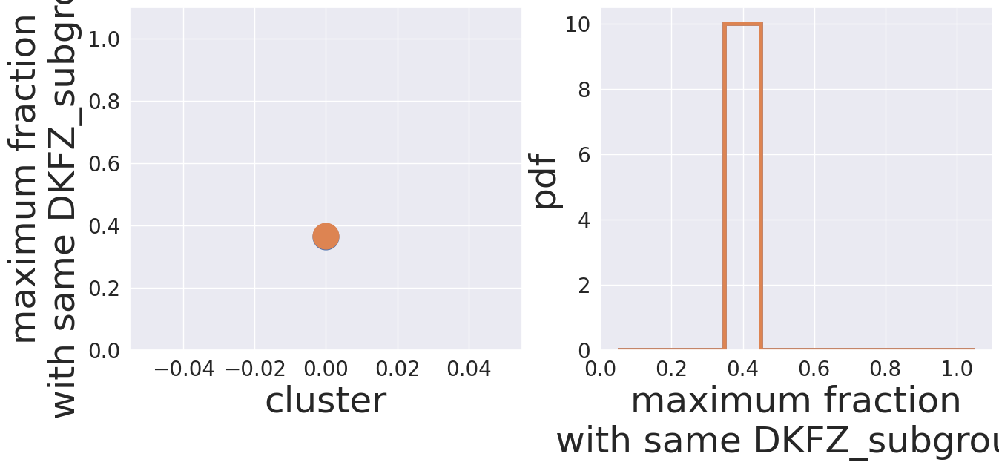

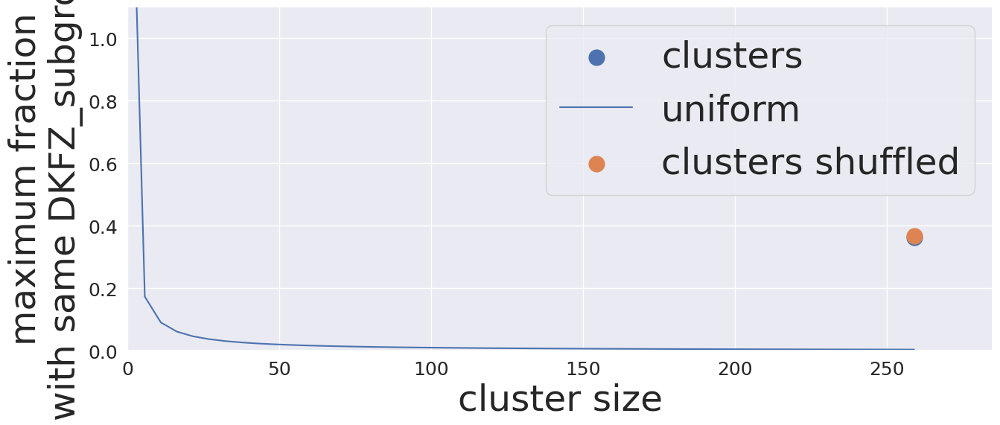

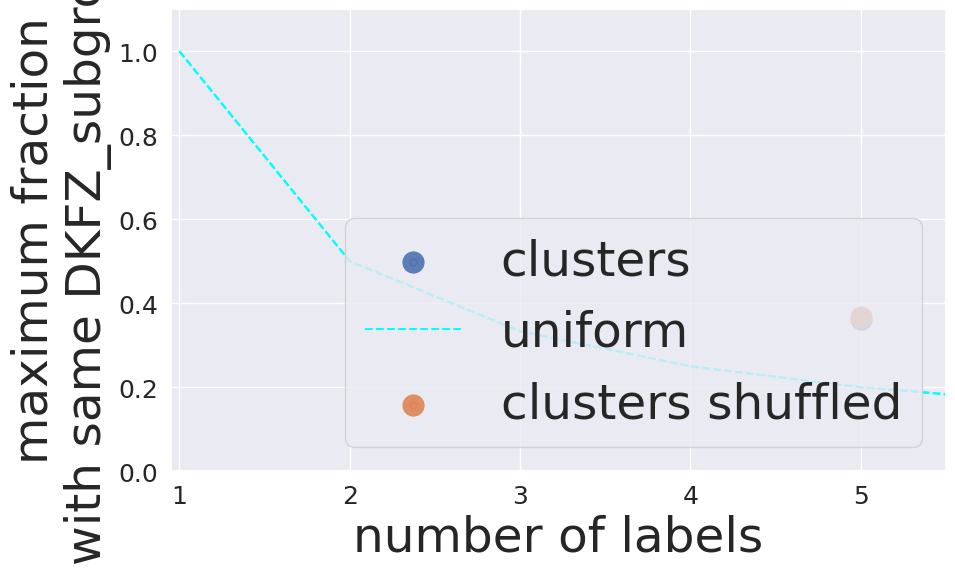

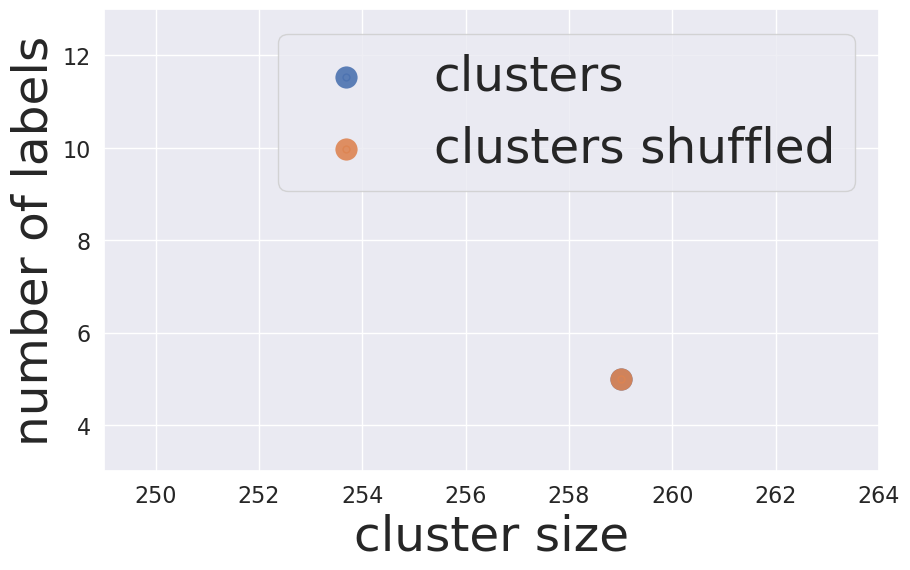

False DKFZ_subgroup 7


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


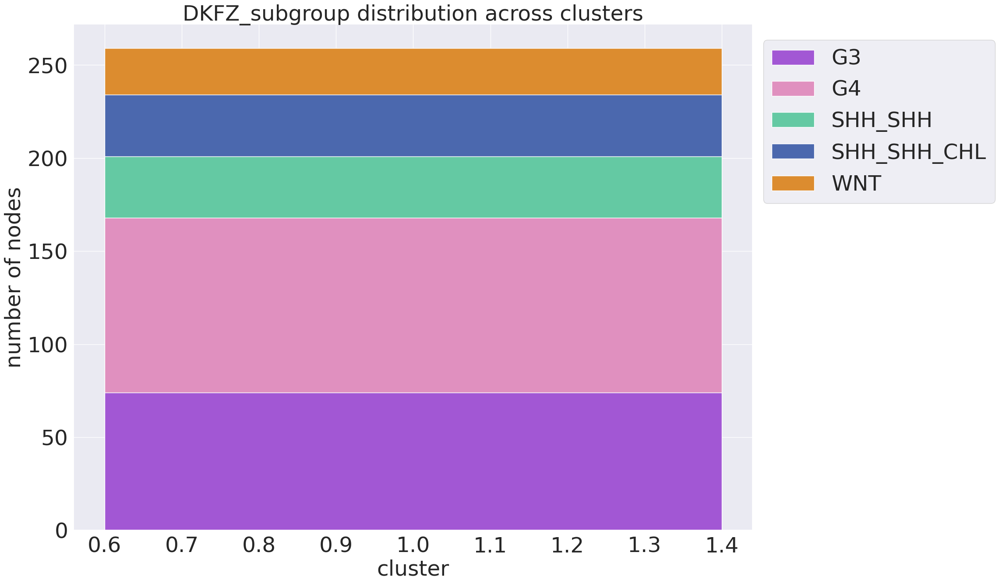

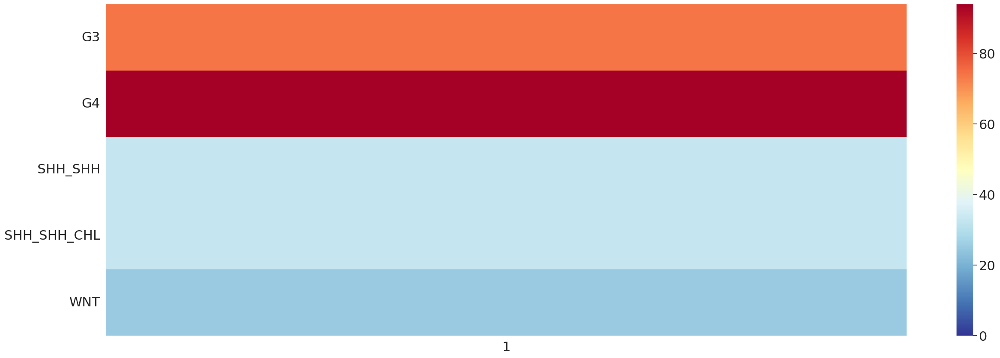

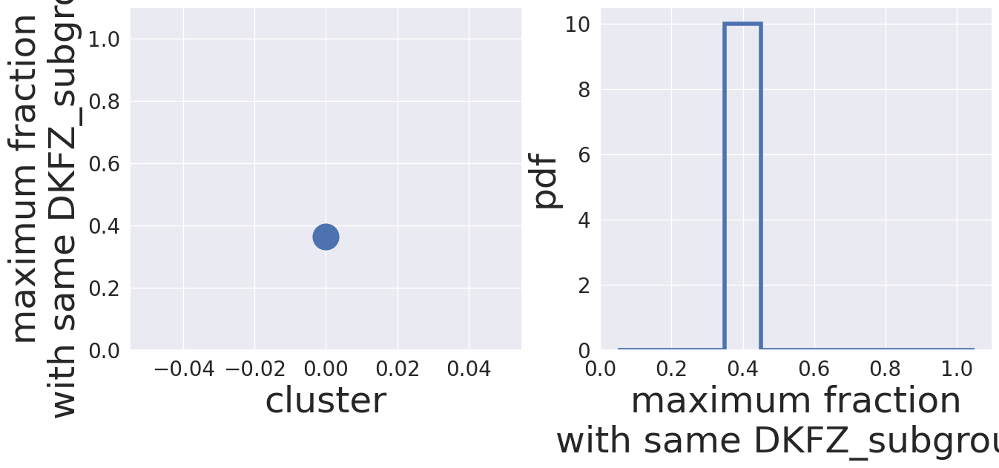

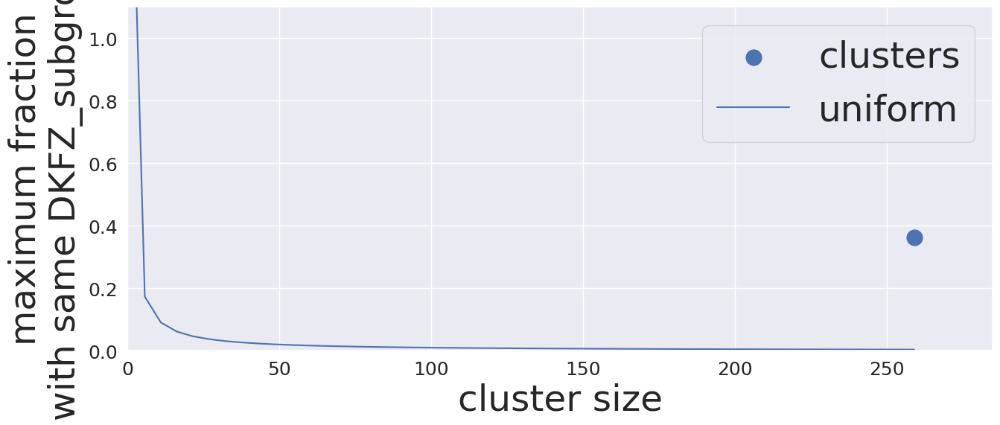

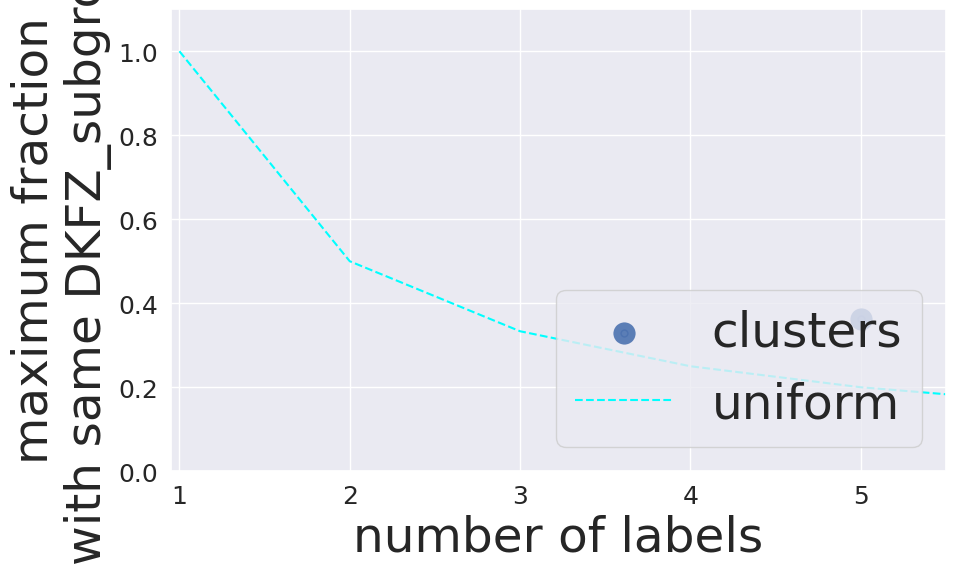

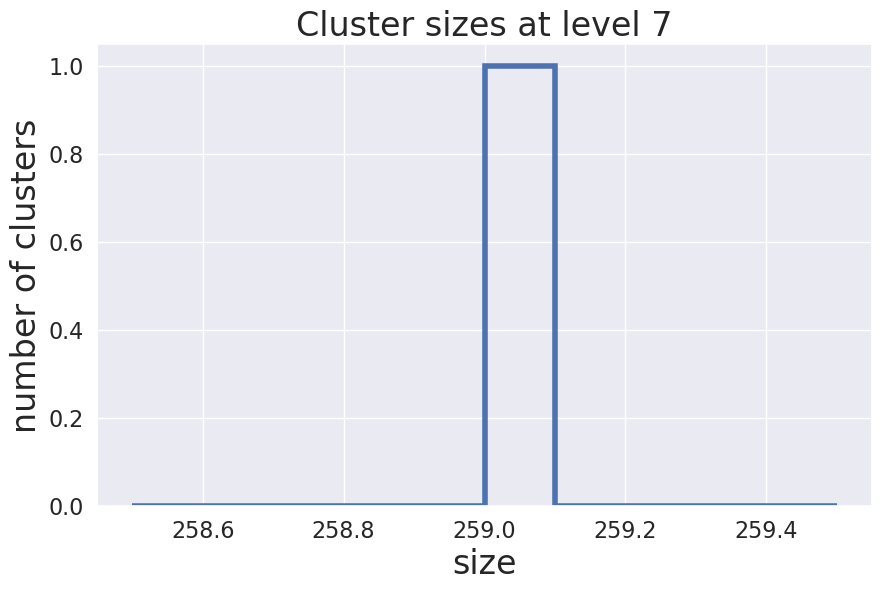

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


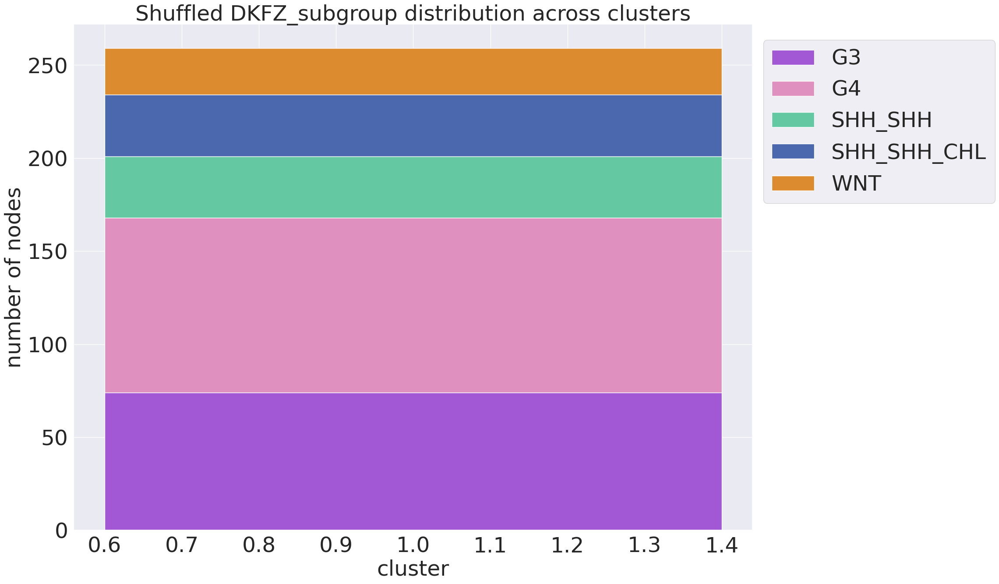

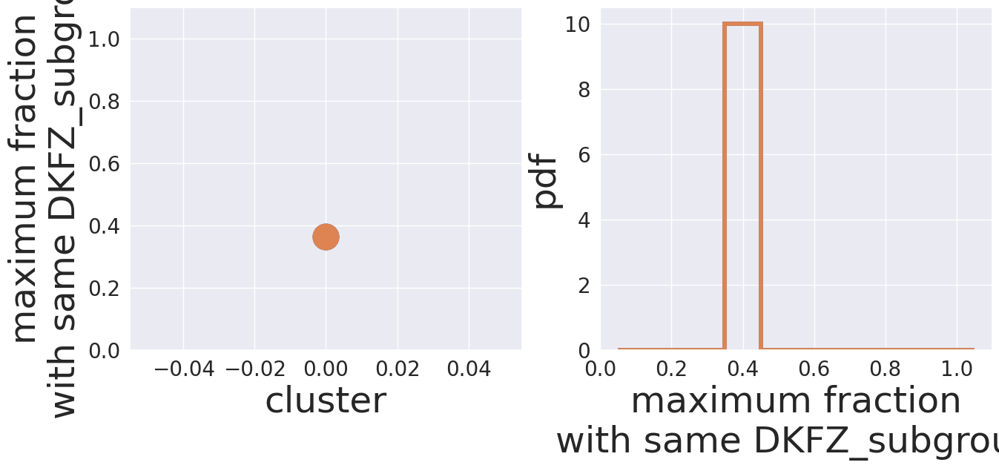

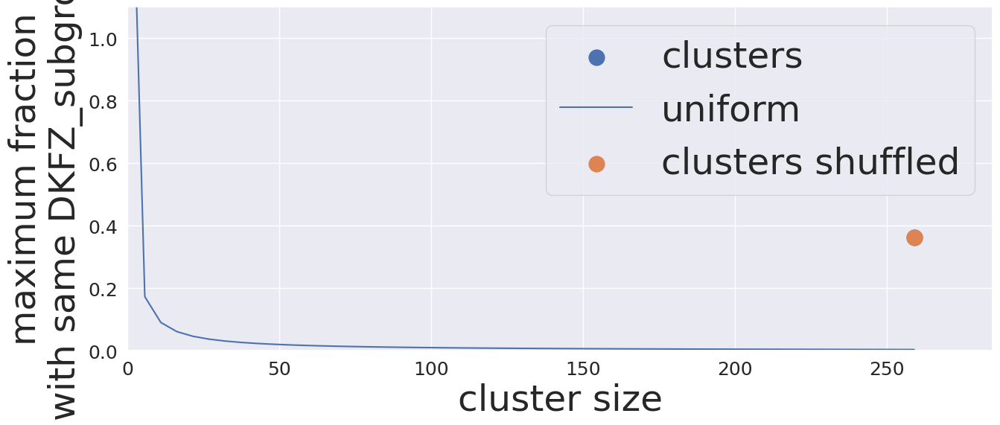

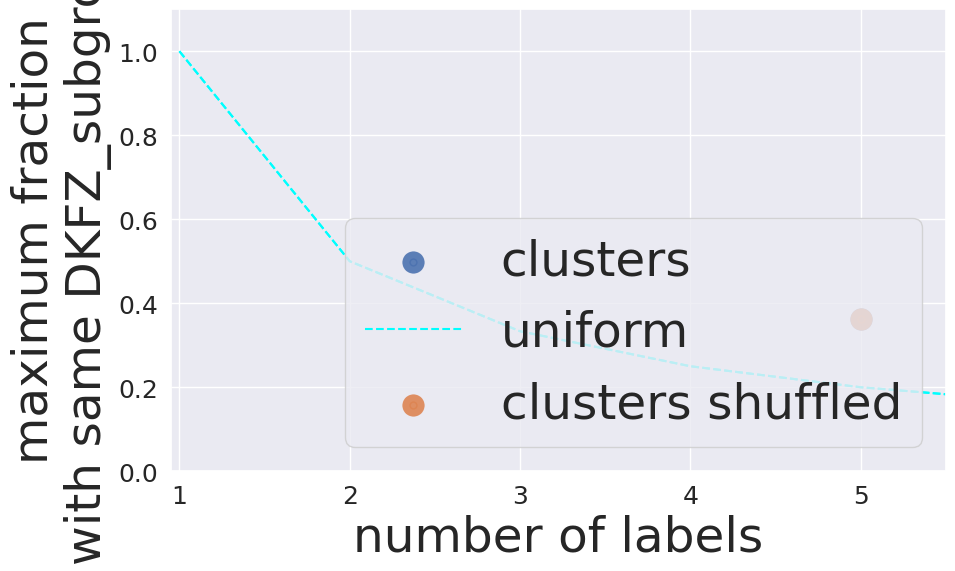

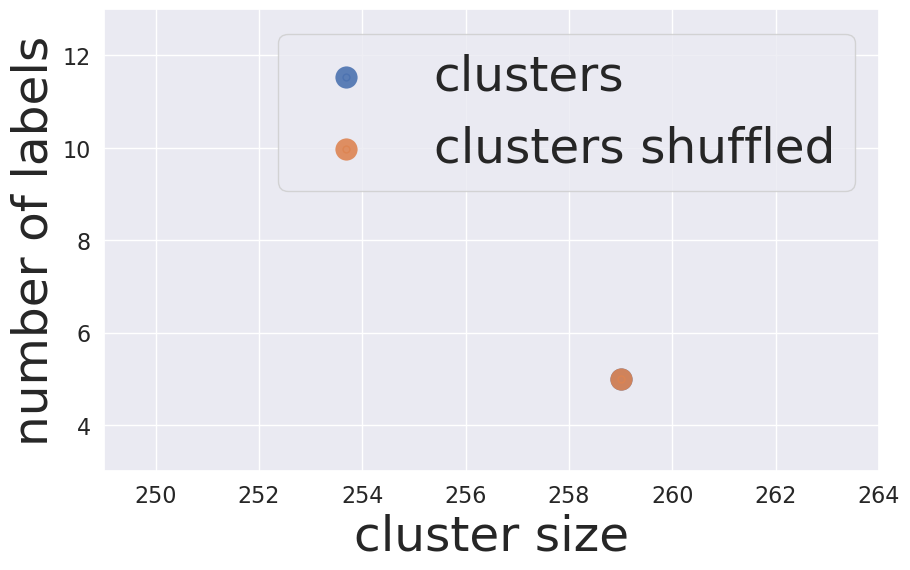

False DKFZ_subgroup 6


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


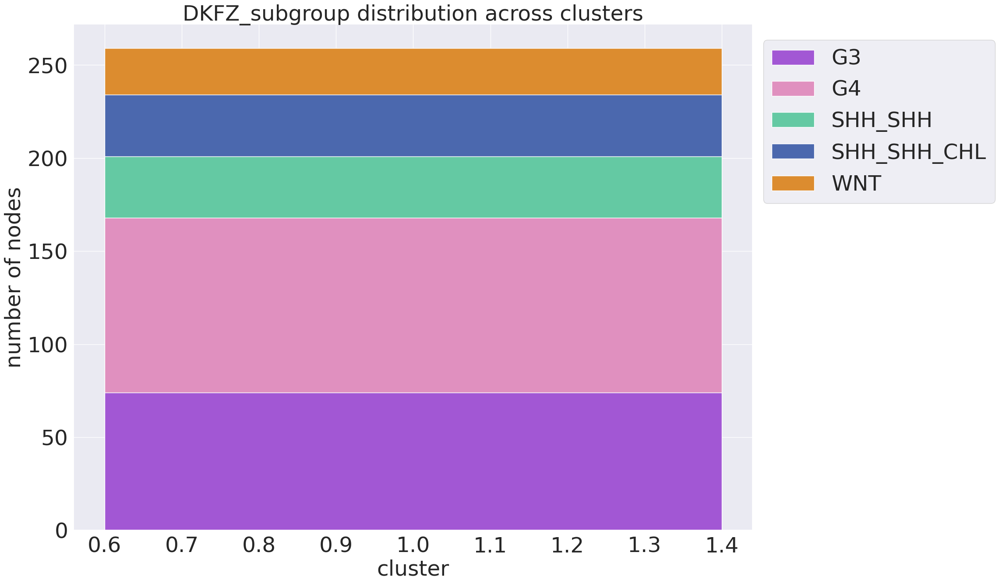

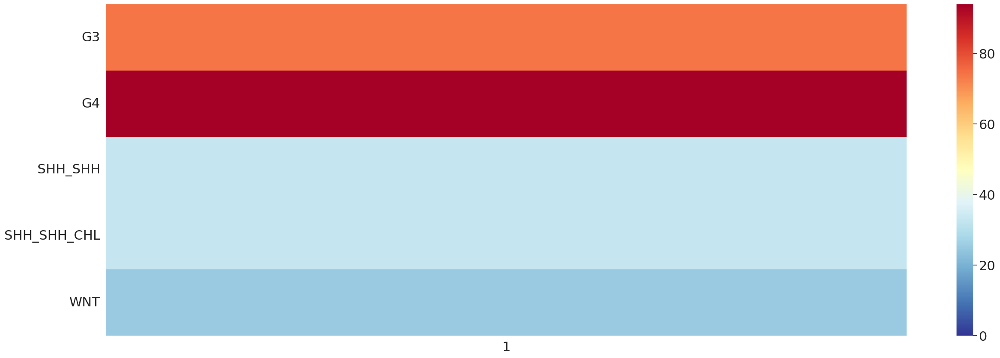

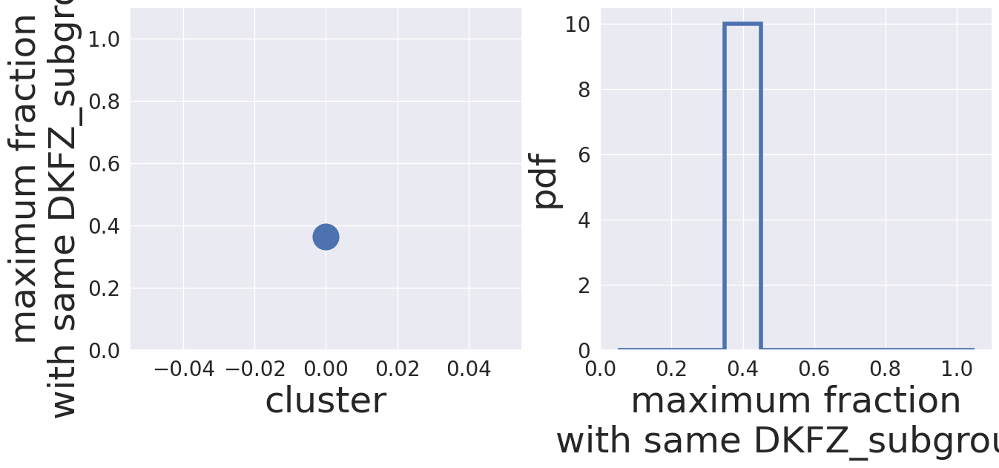

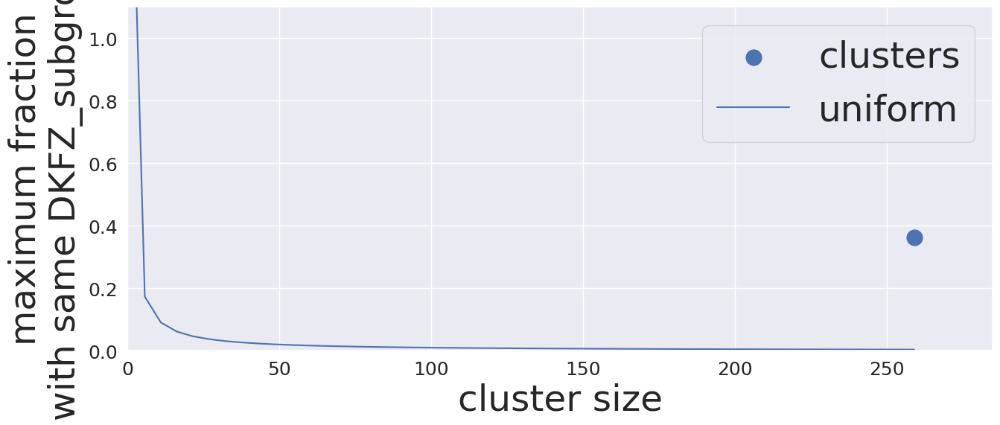

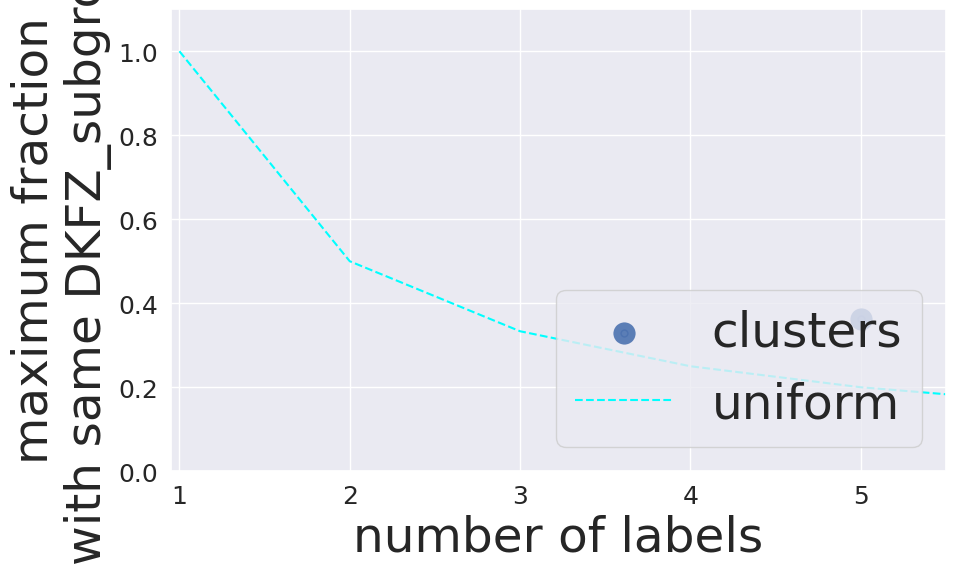

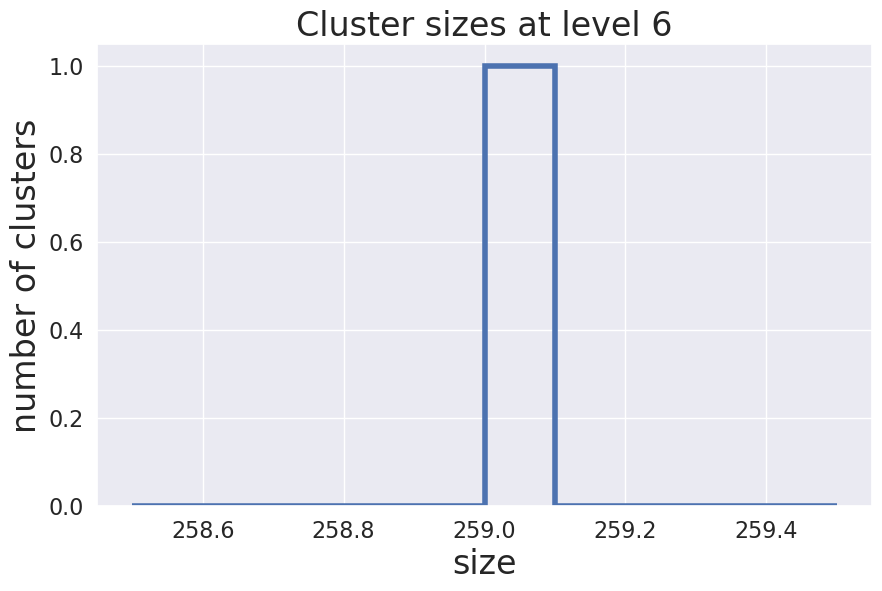

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


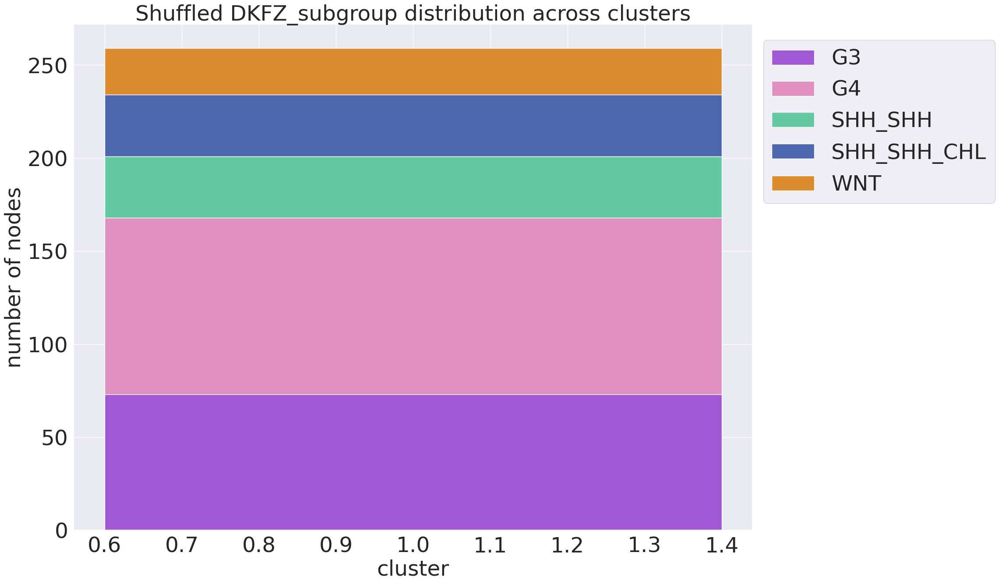

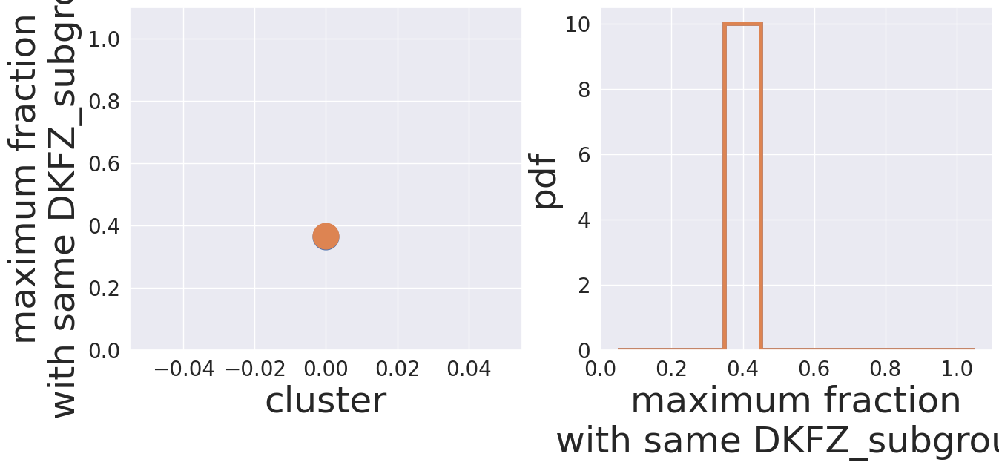

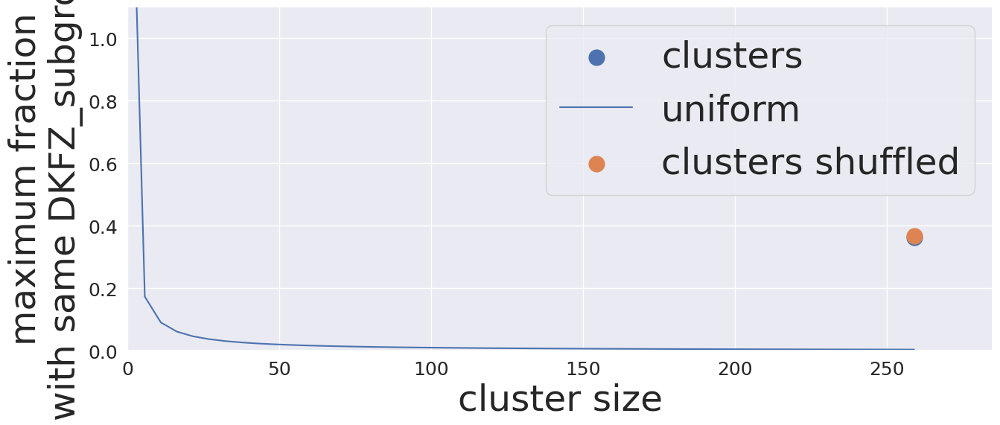

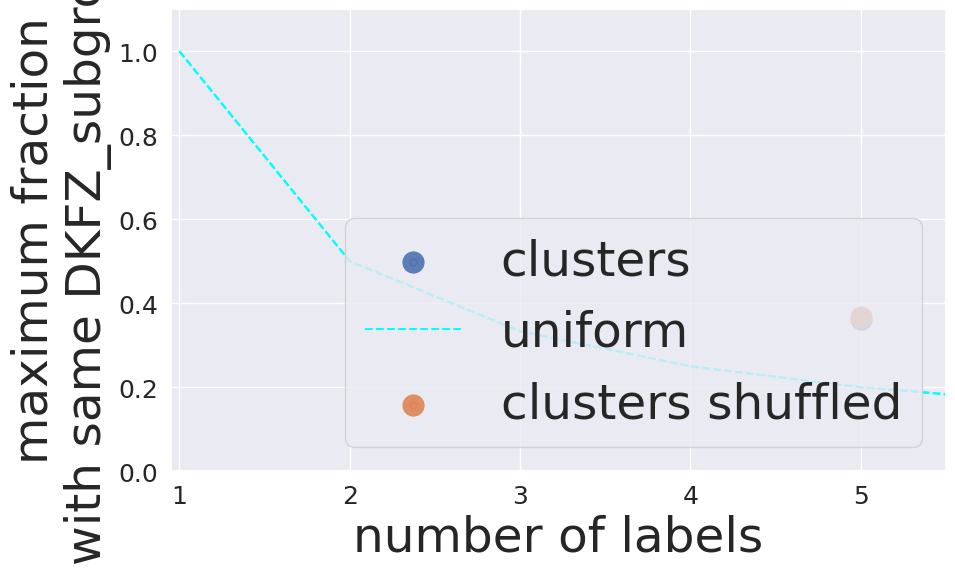

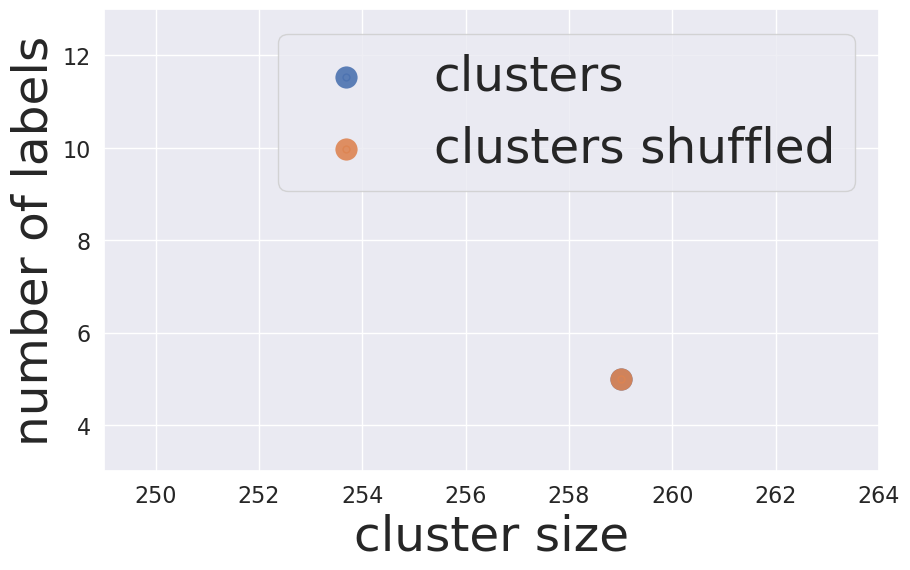

False DKFZ_subgroup 5


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


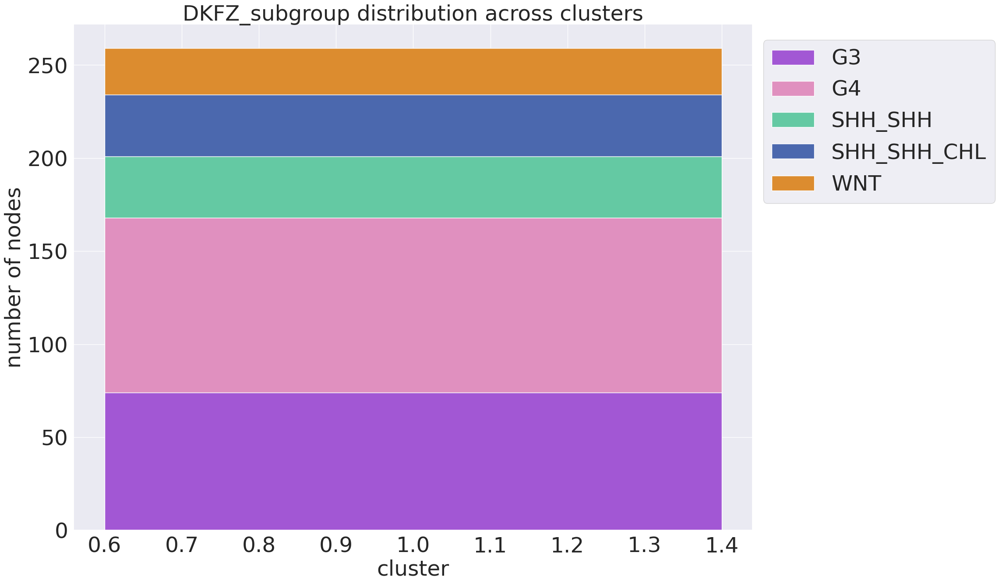

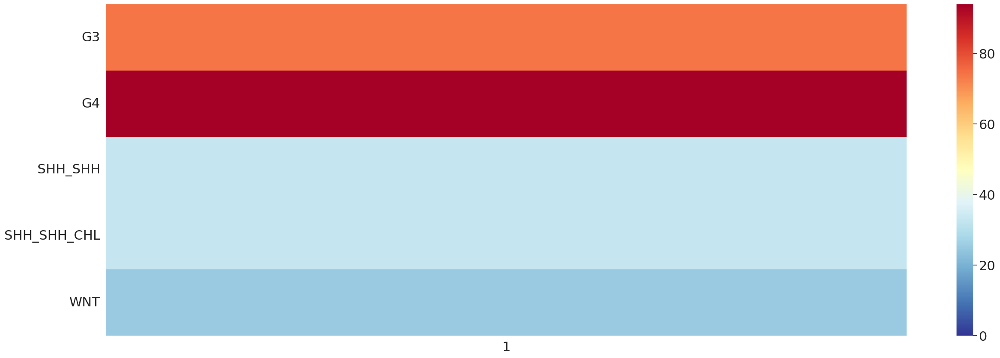

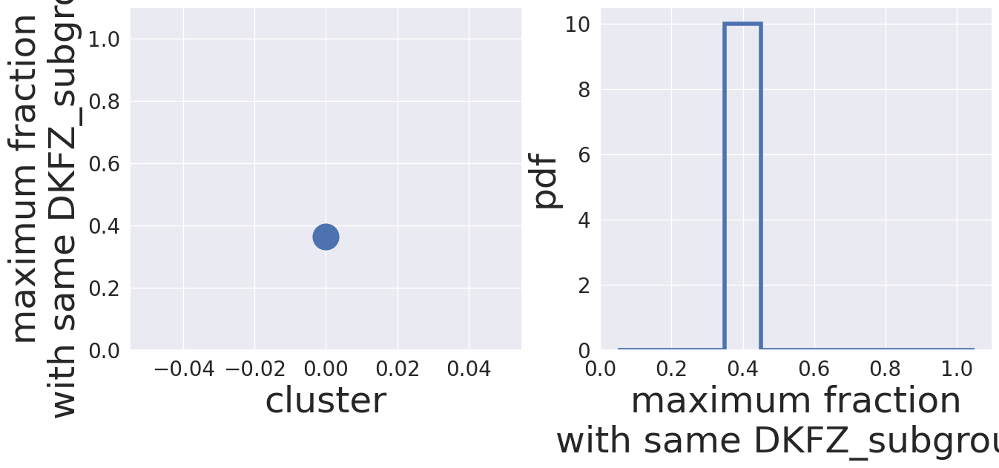

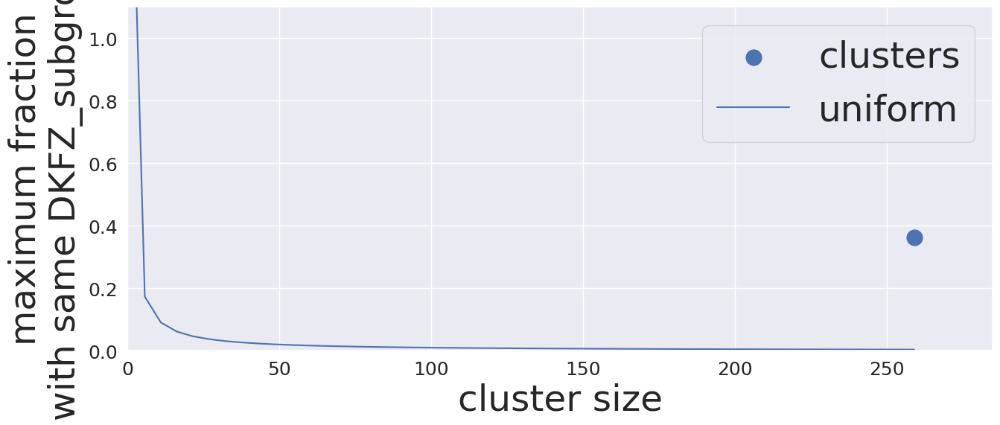

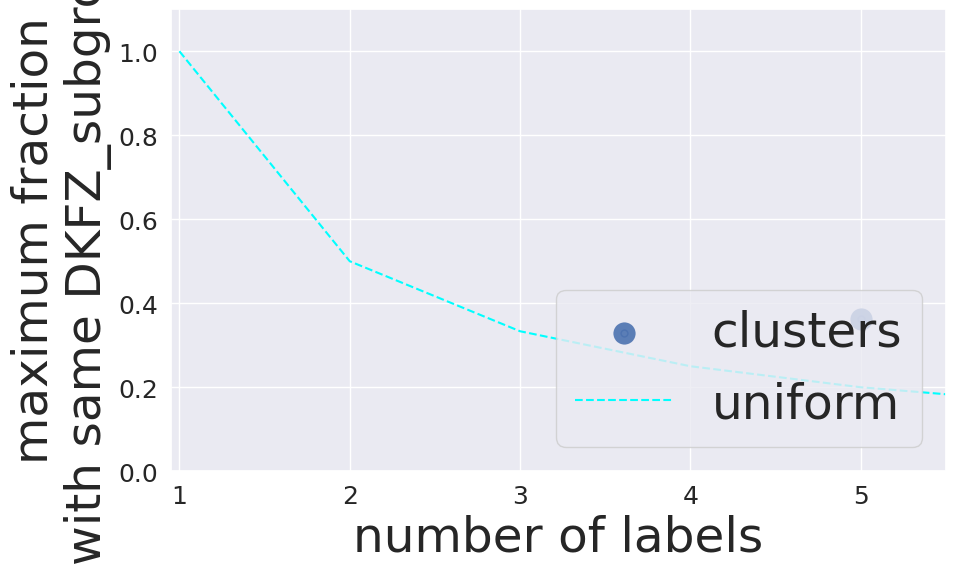

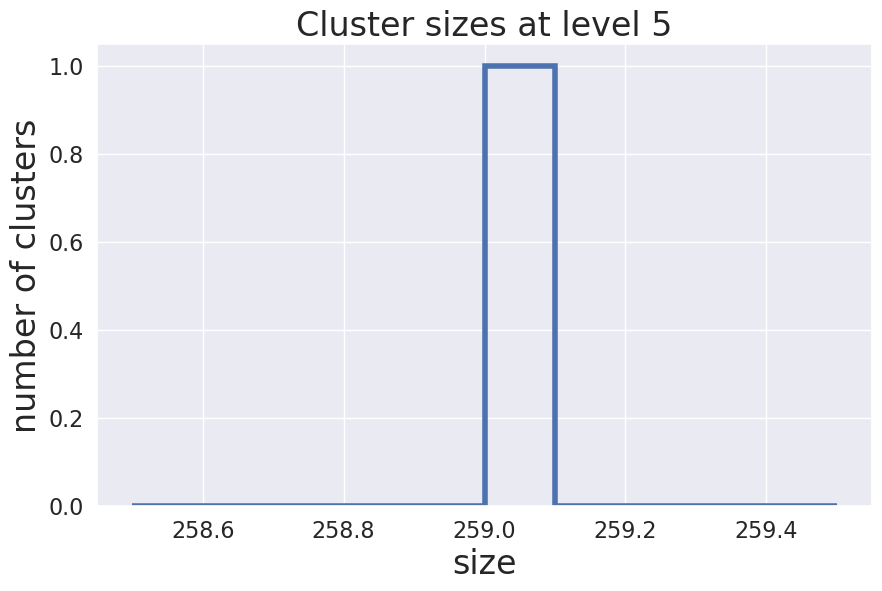

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


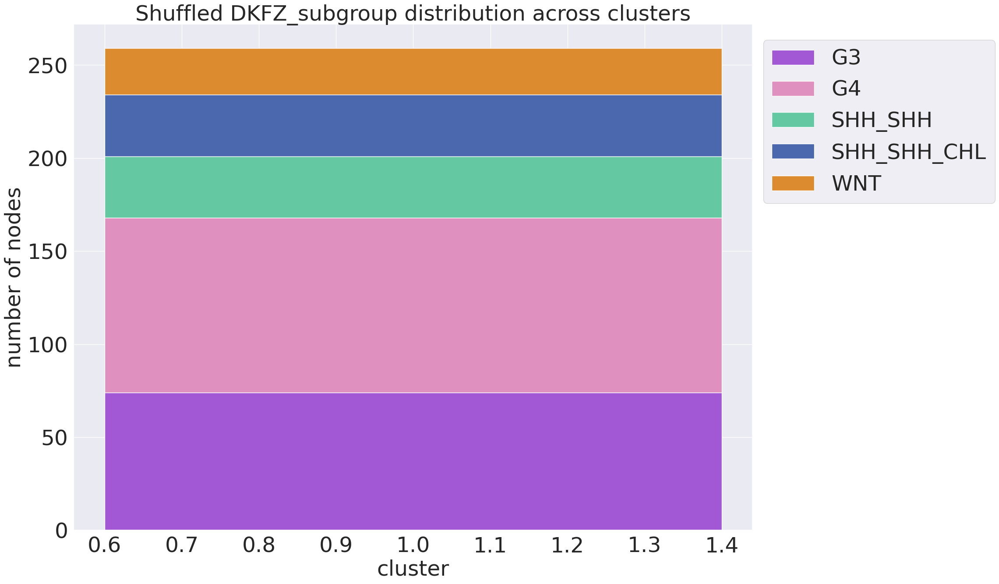

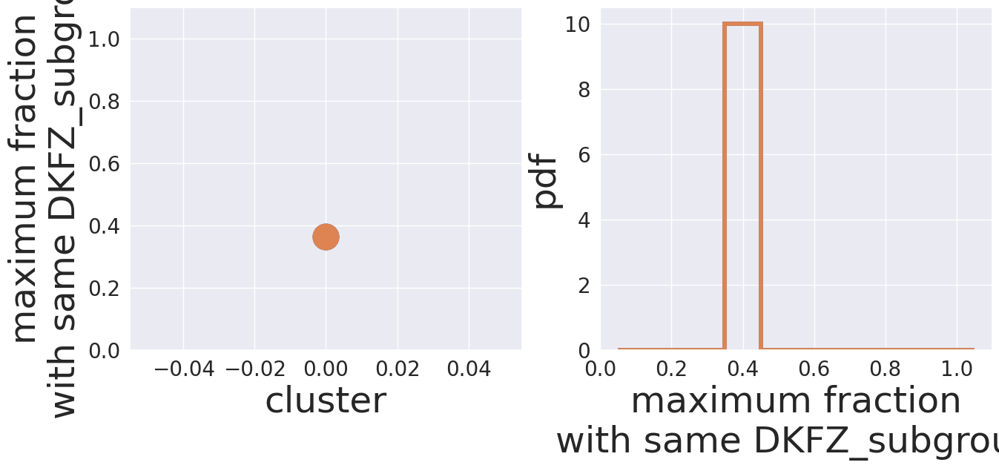

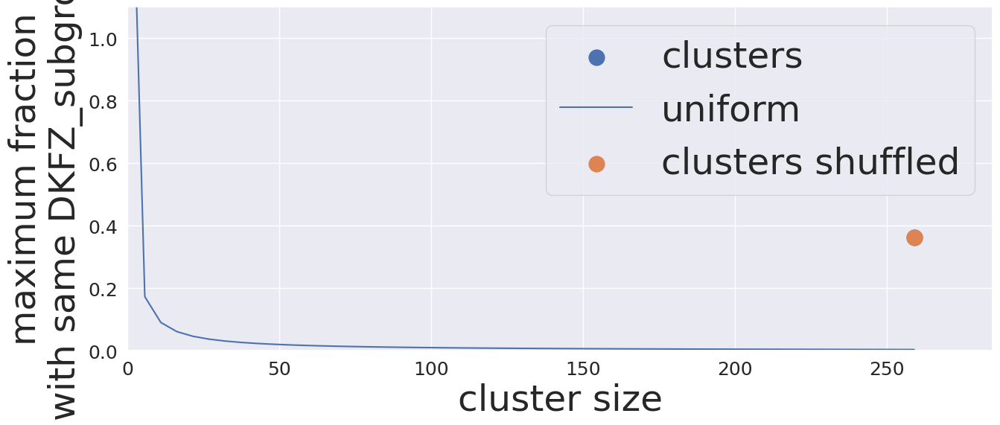

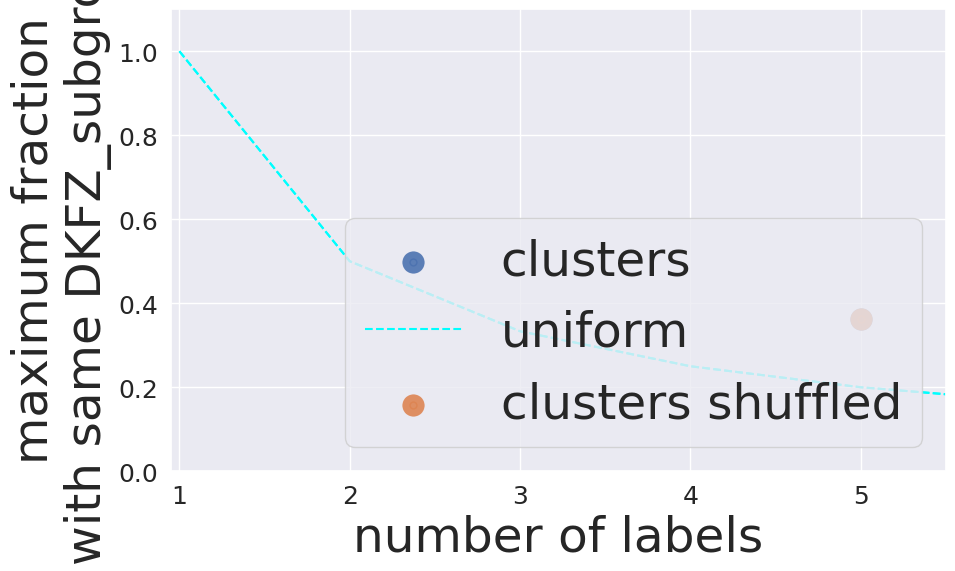

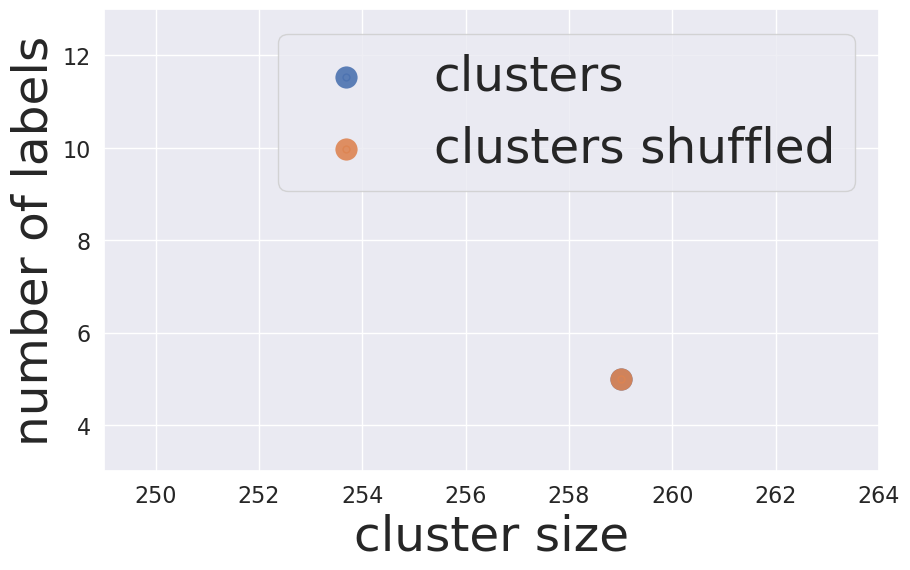

False DKFZ_subgroup 4


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


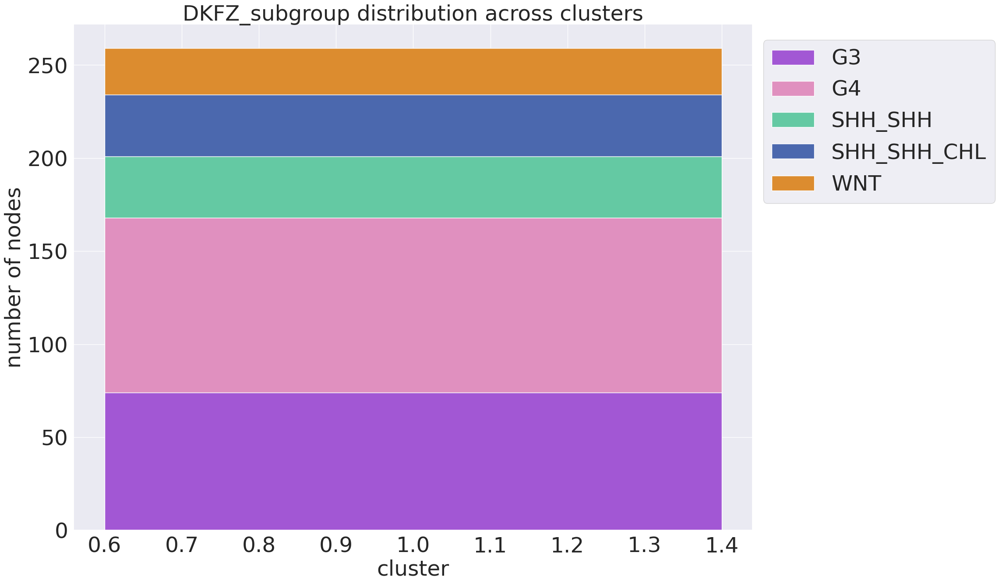

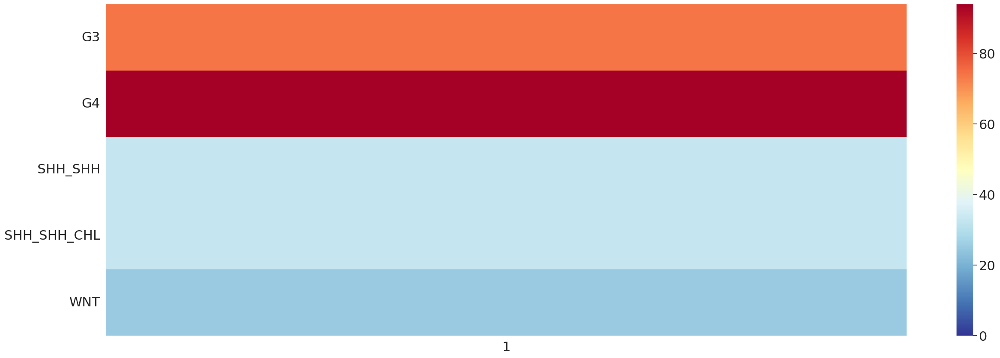

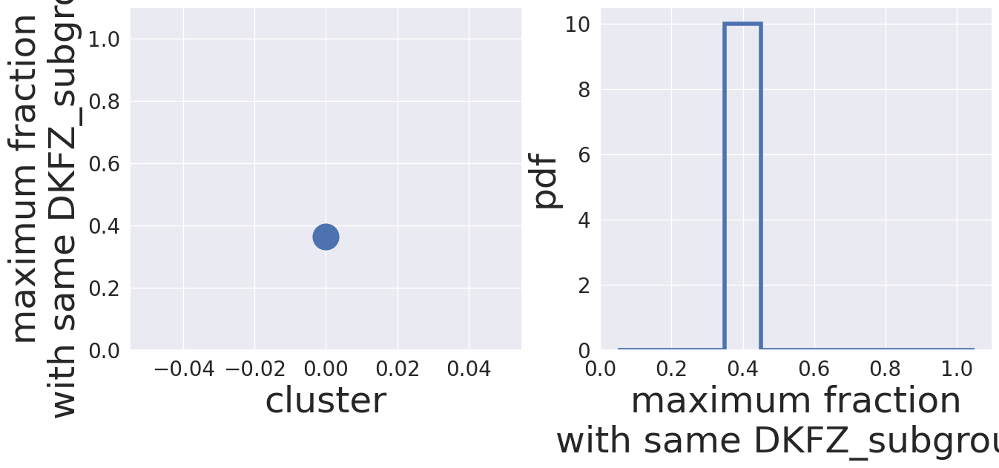

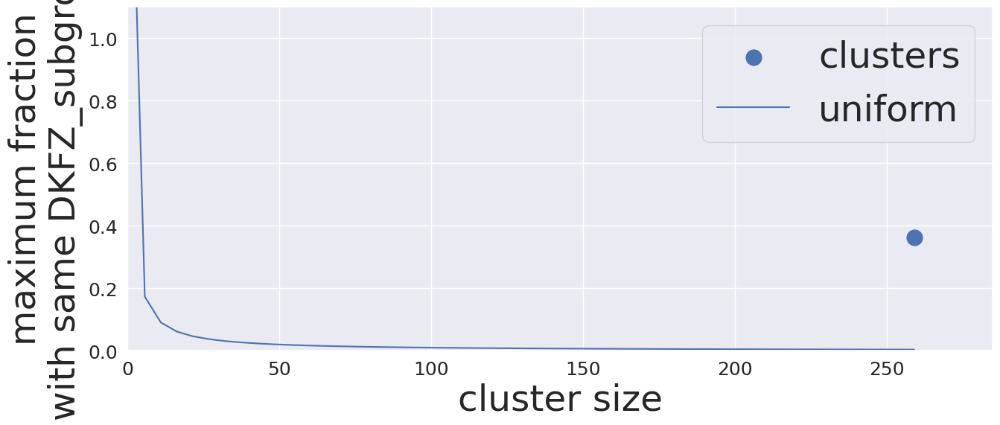

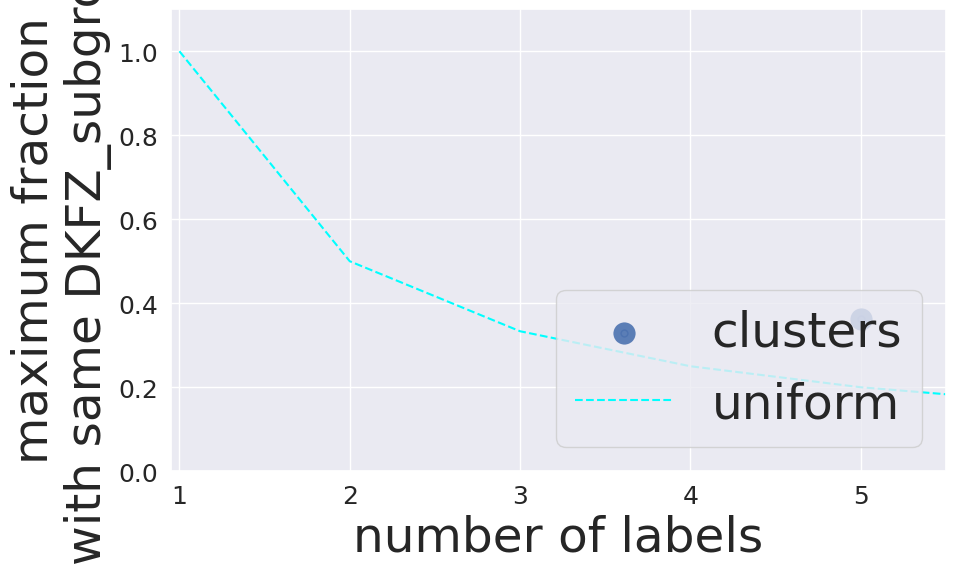

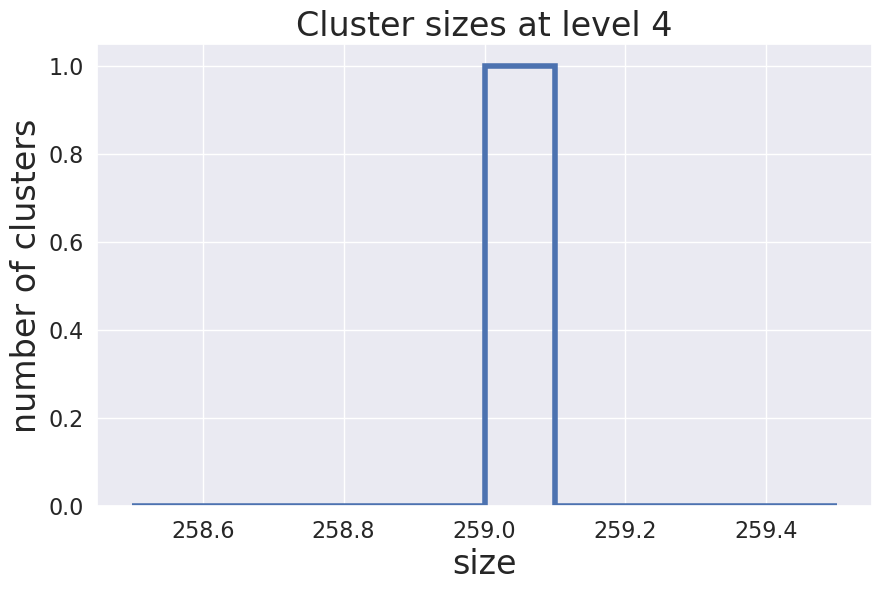

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


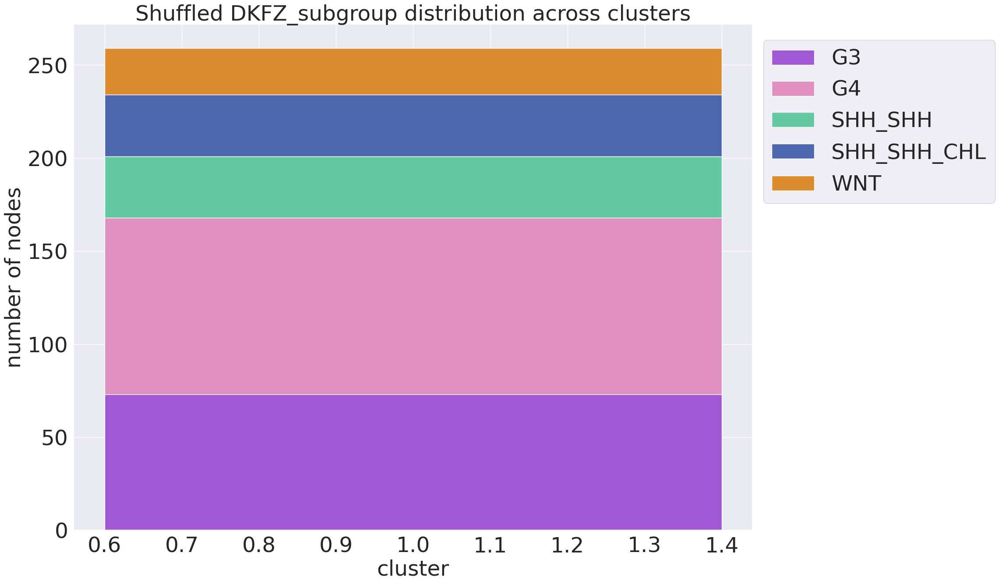

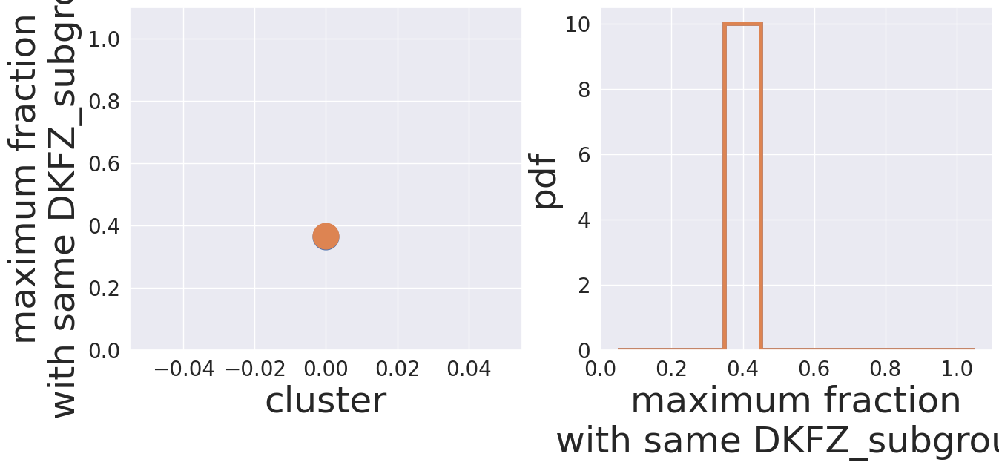

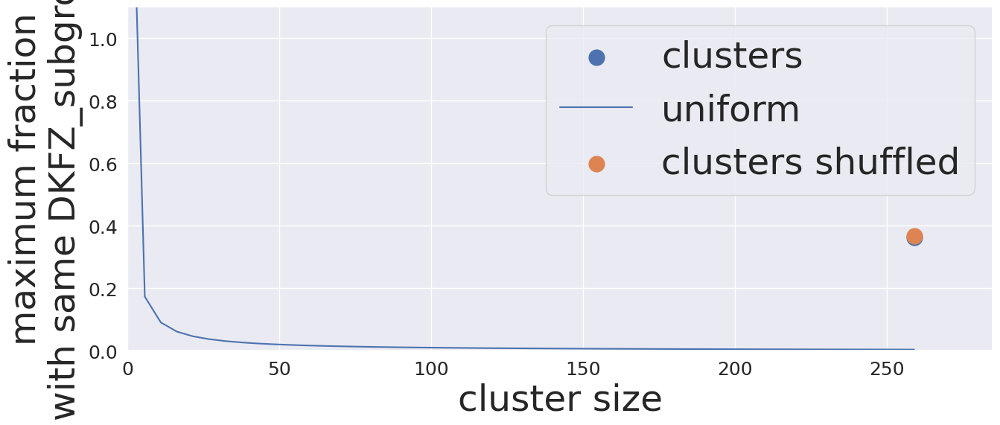

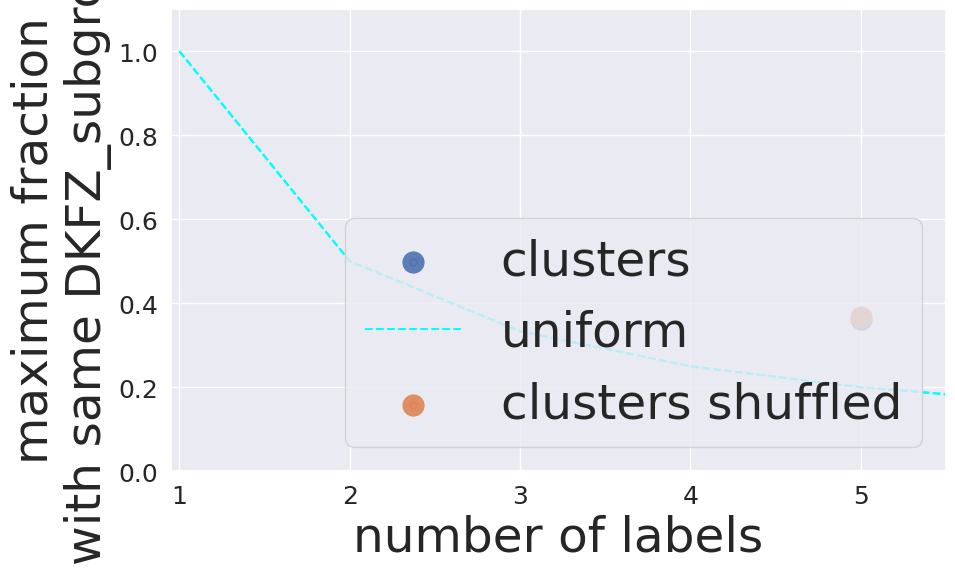

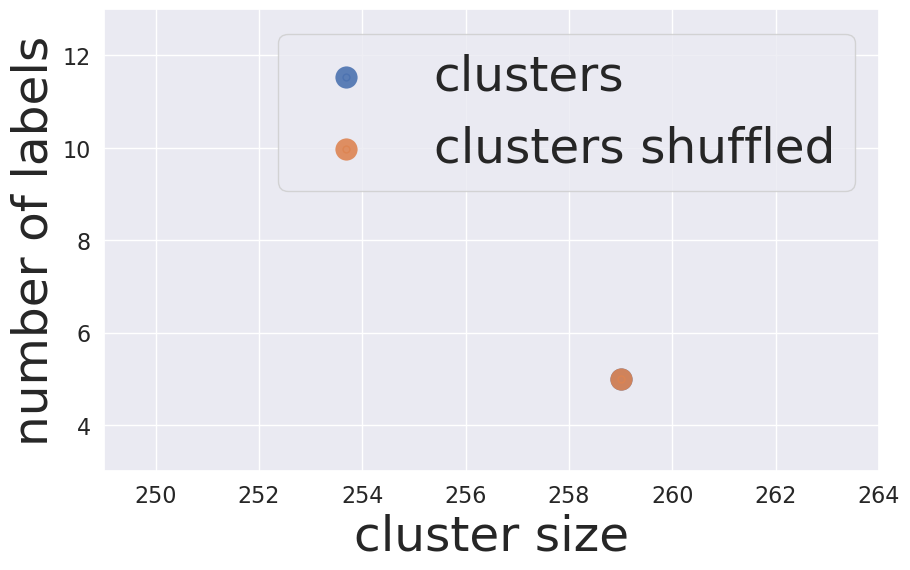

False DKFZ_subgroup 3


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


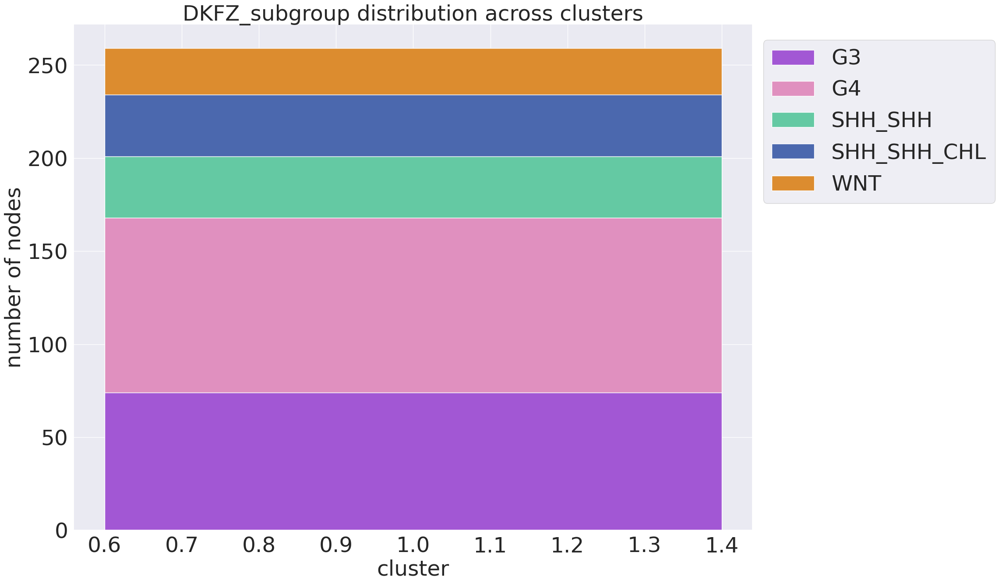

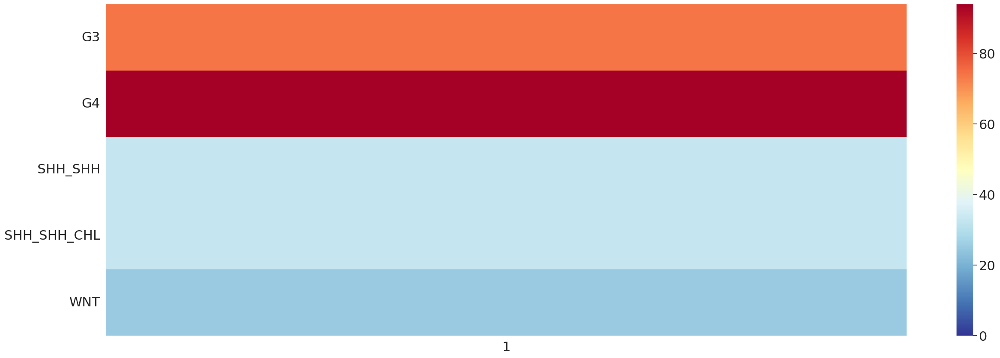

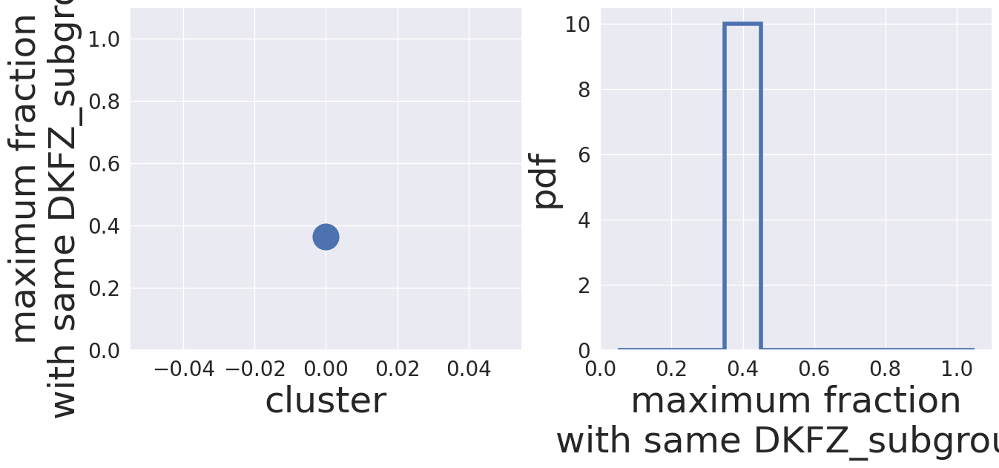

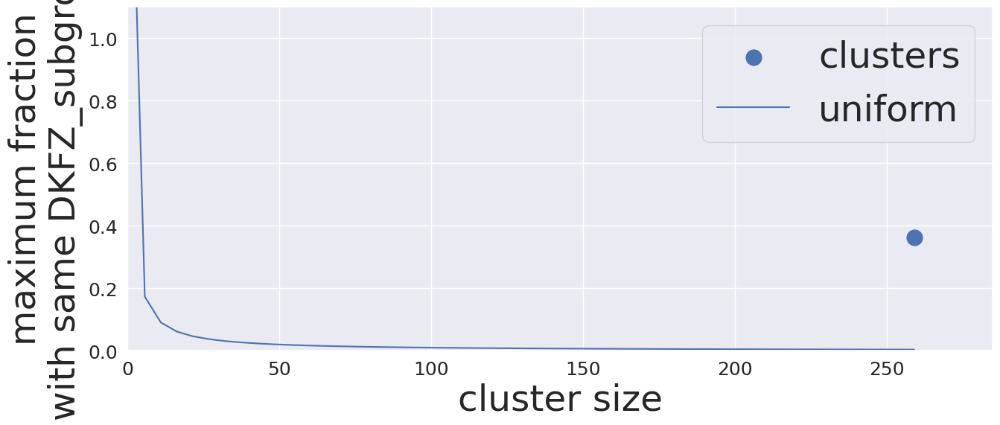

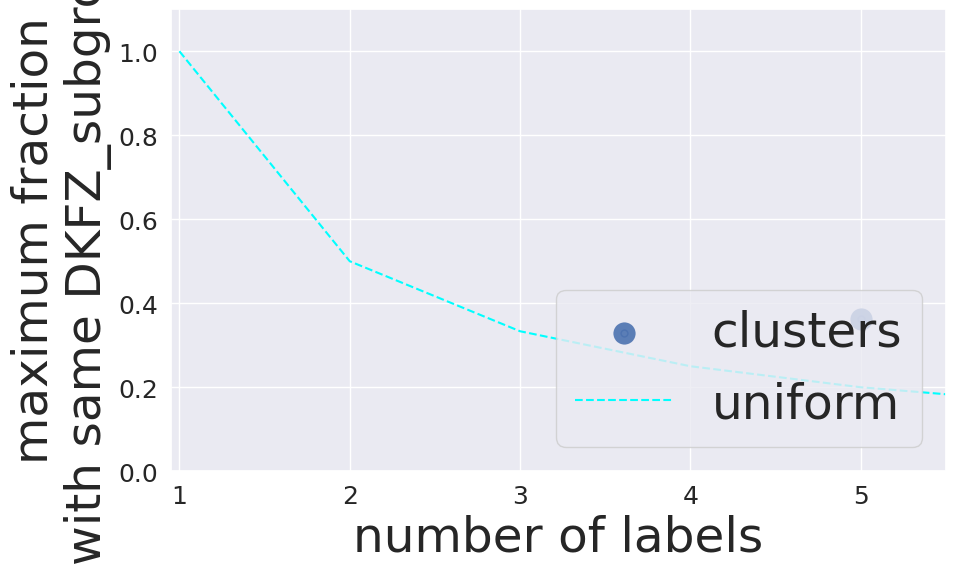

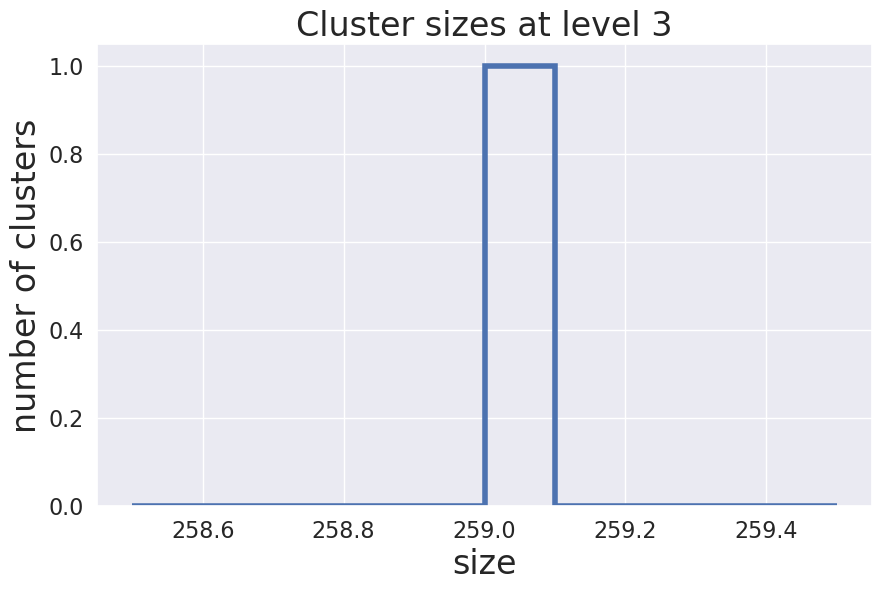

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


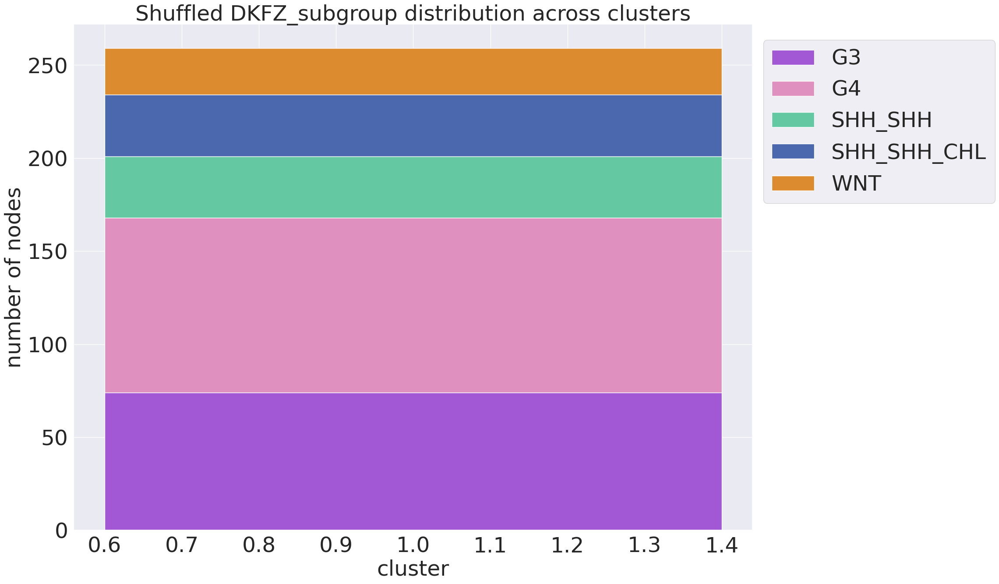

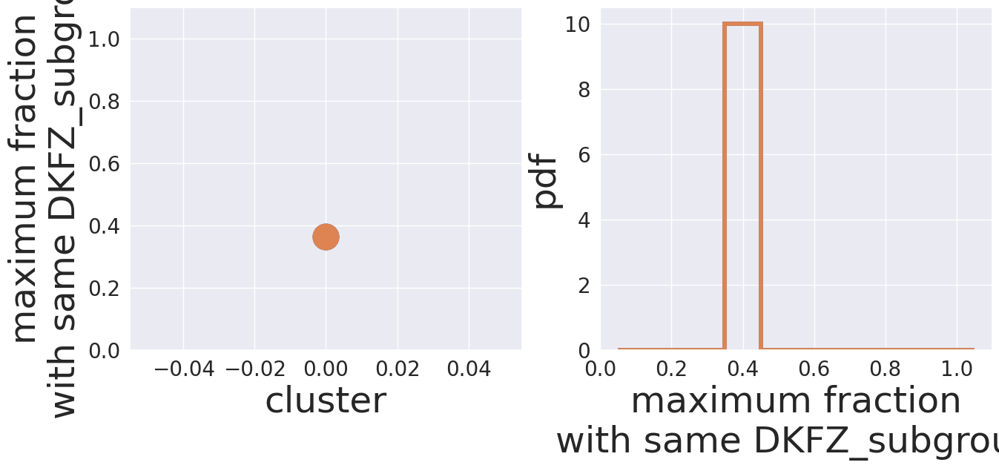

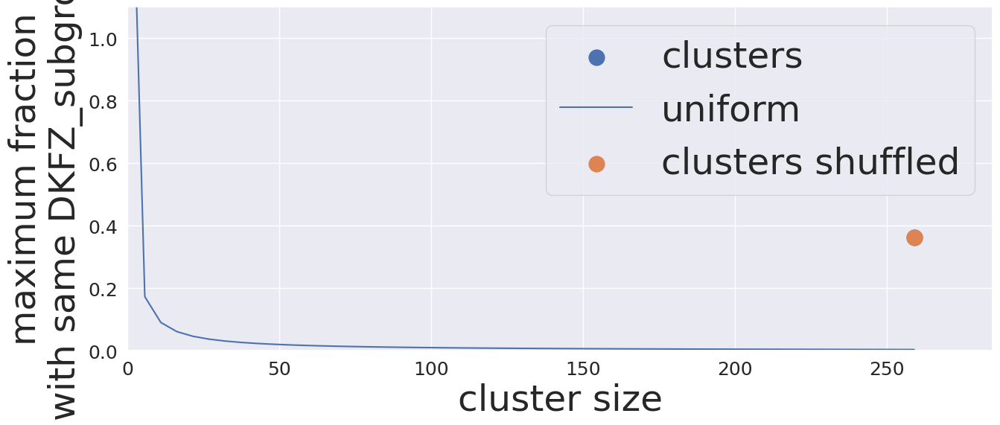

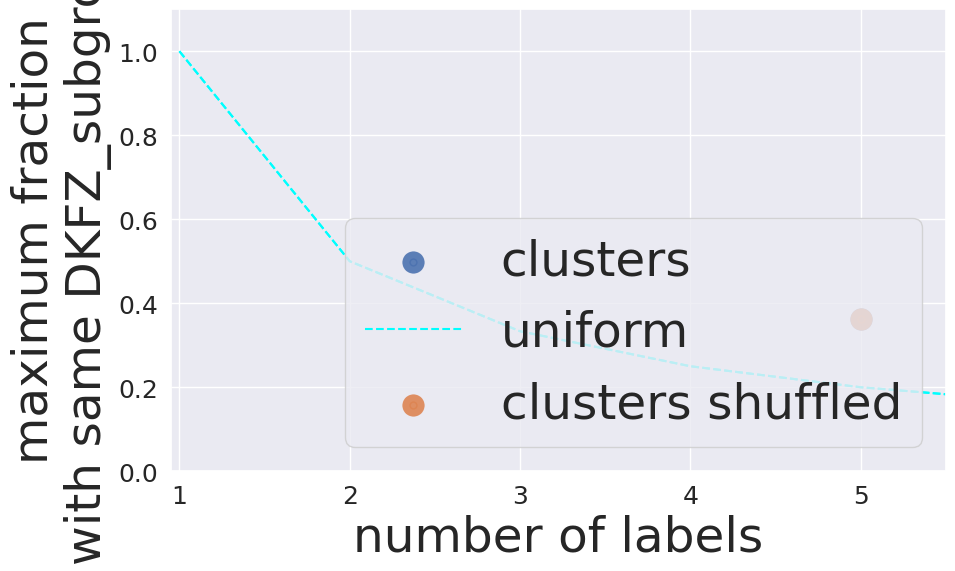

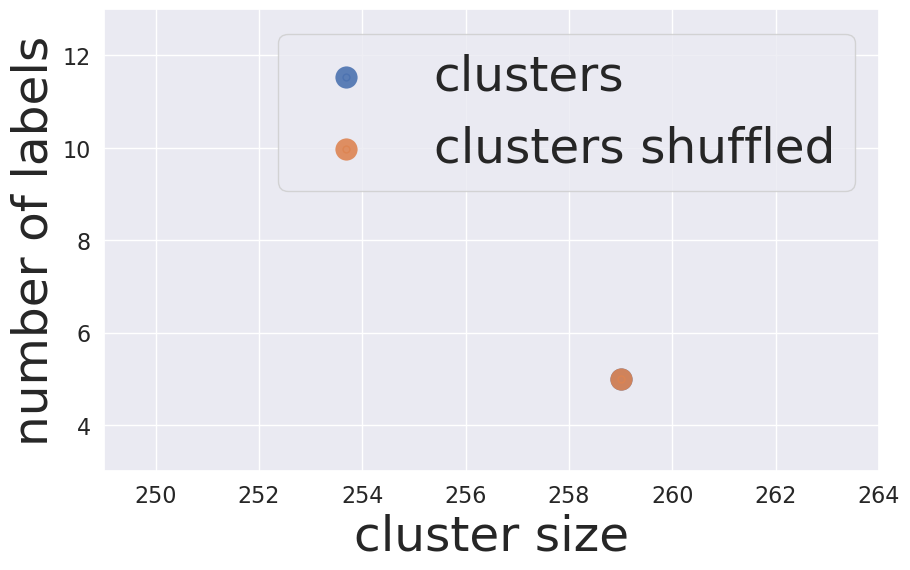

False DKFZ_subgroup 2


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


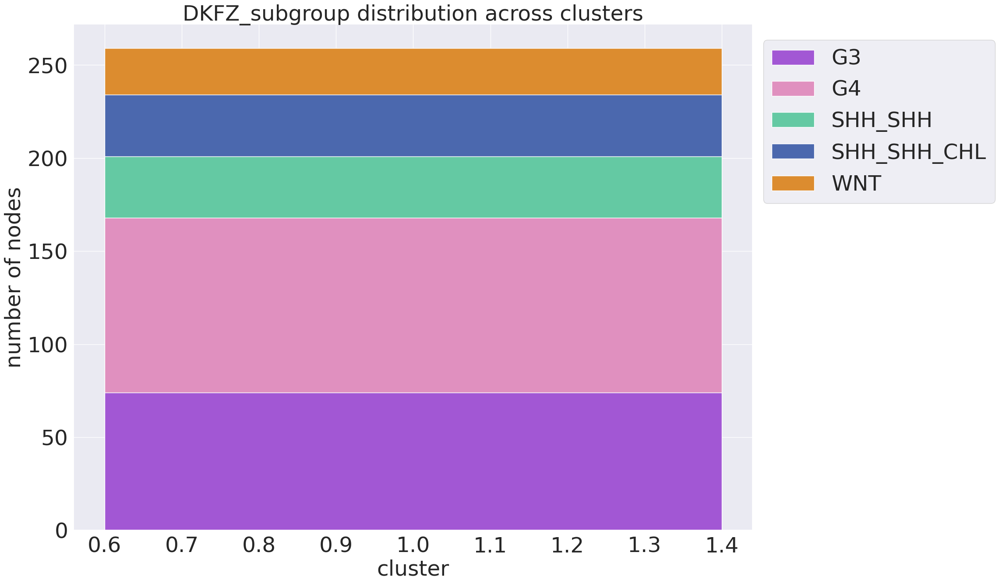

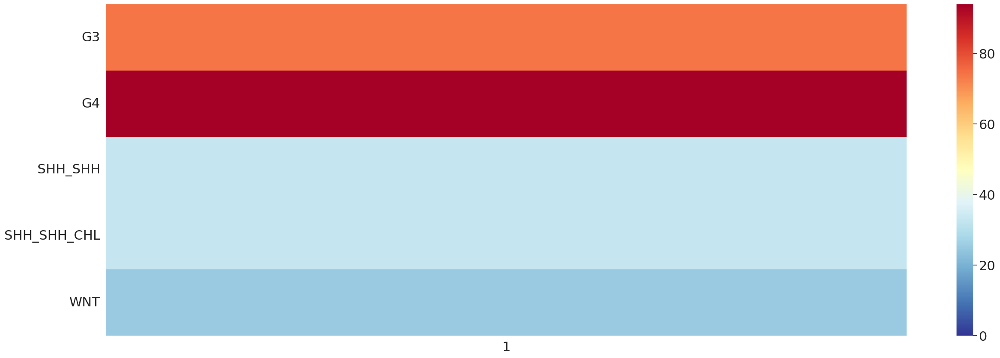

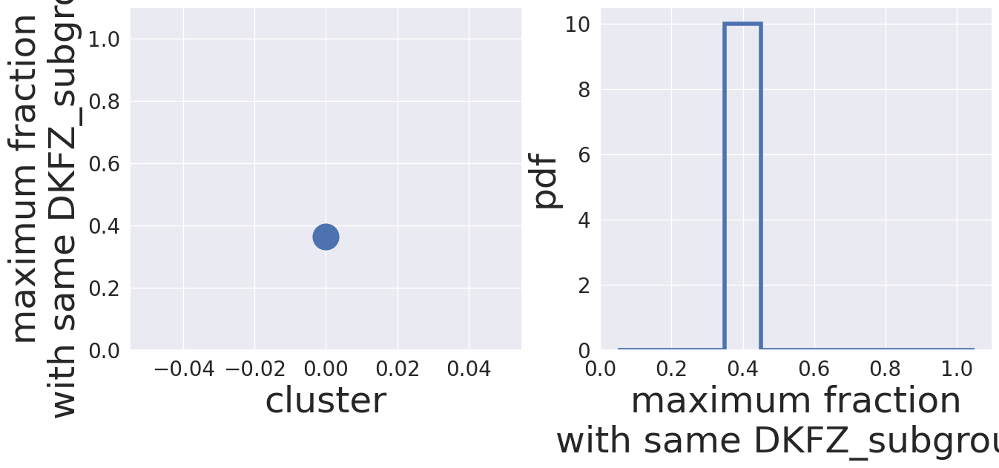

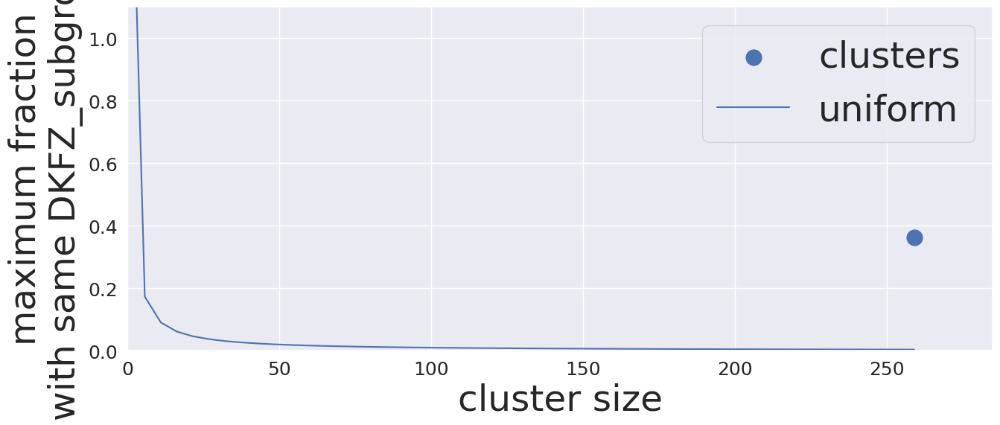

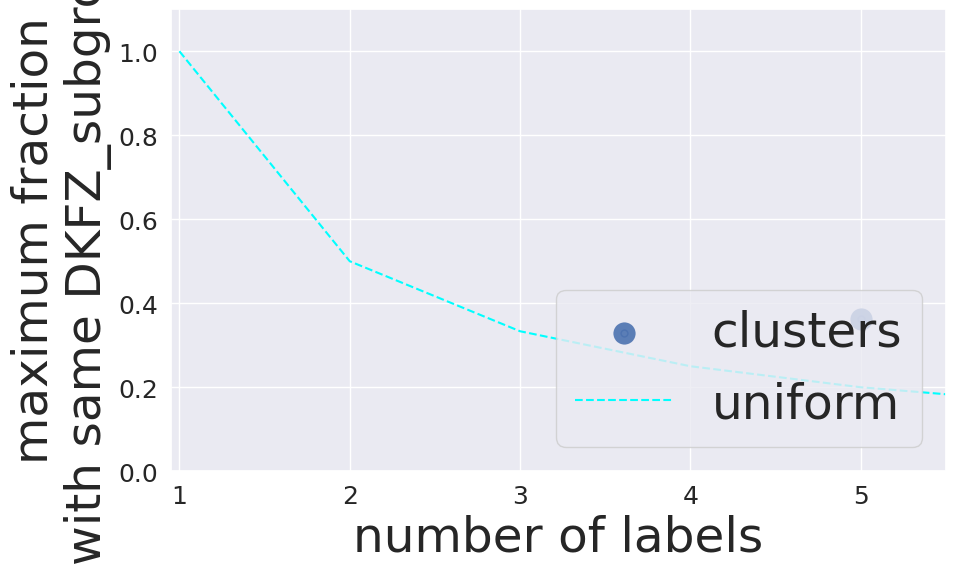

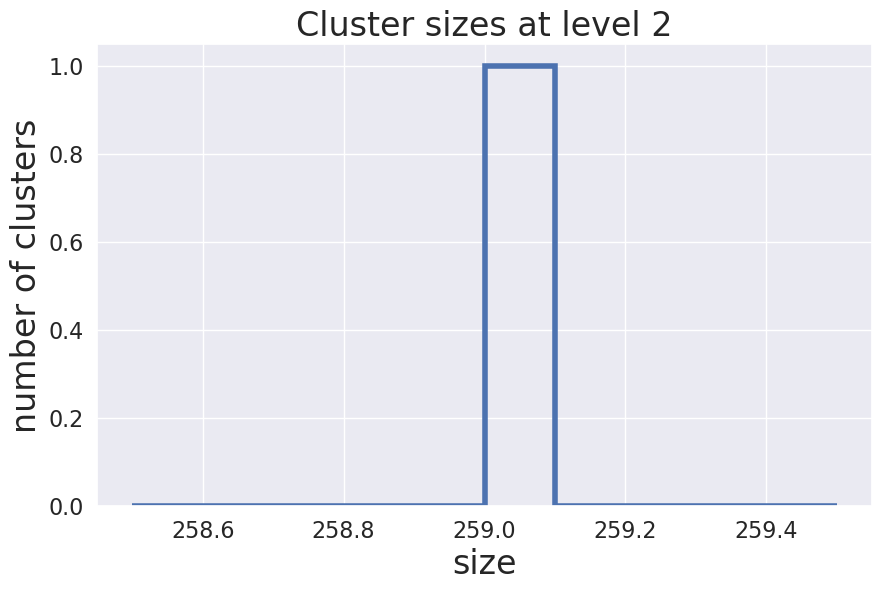

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


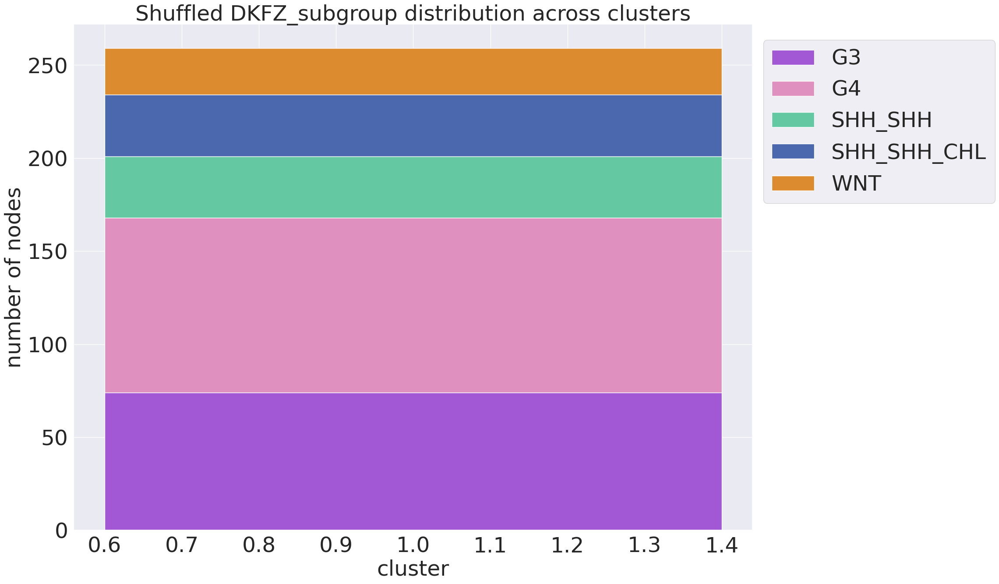

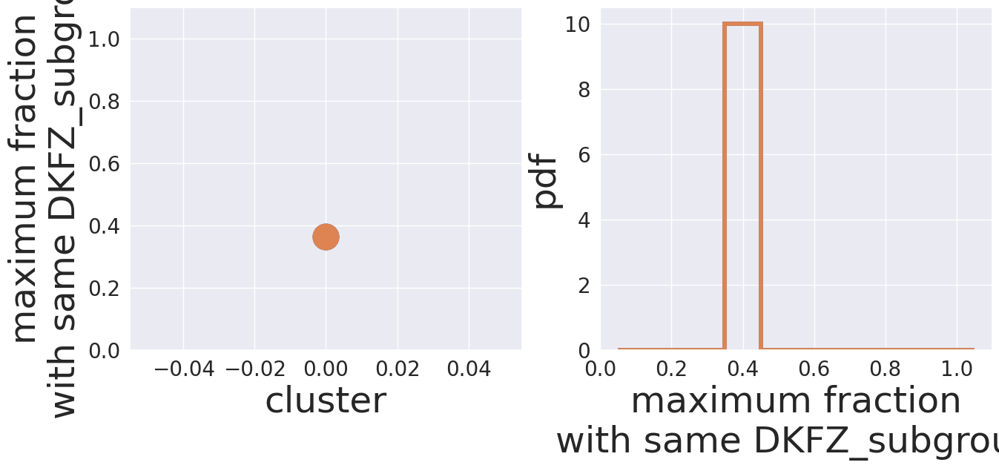

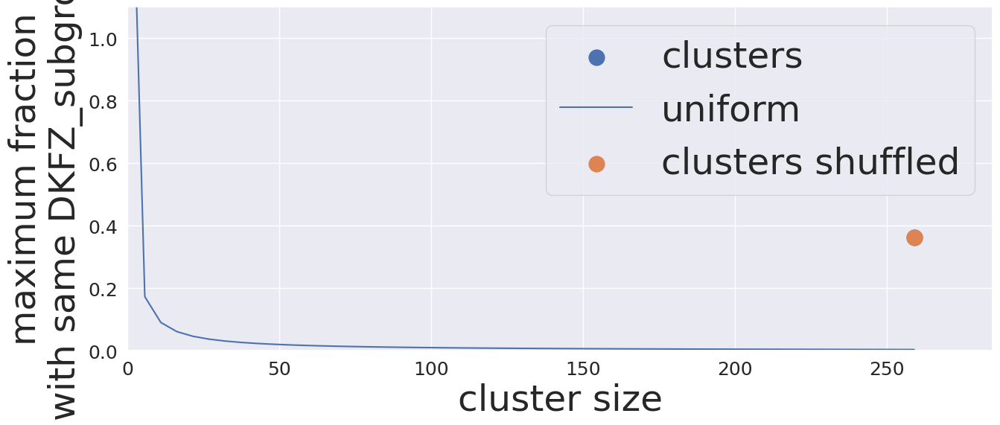

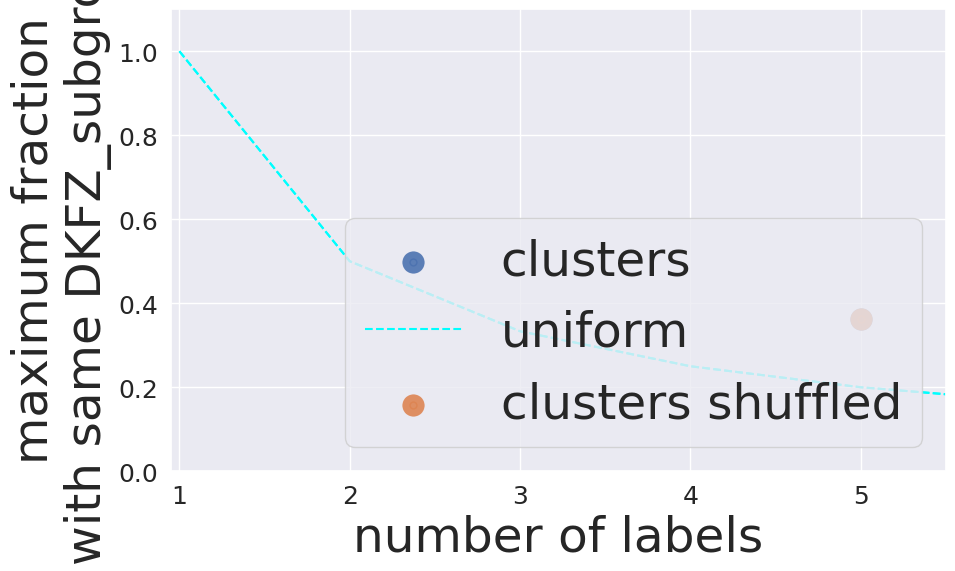

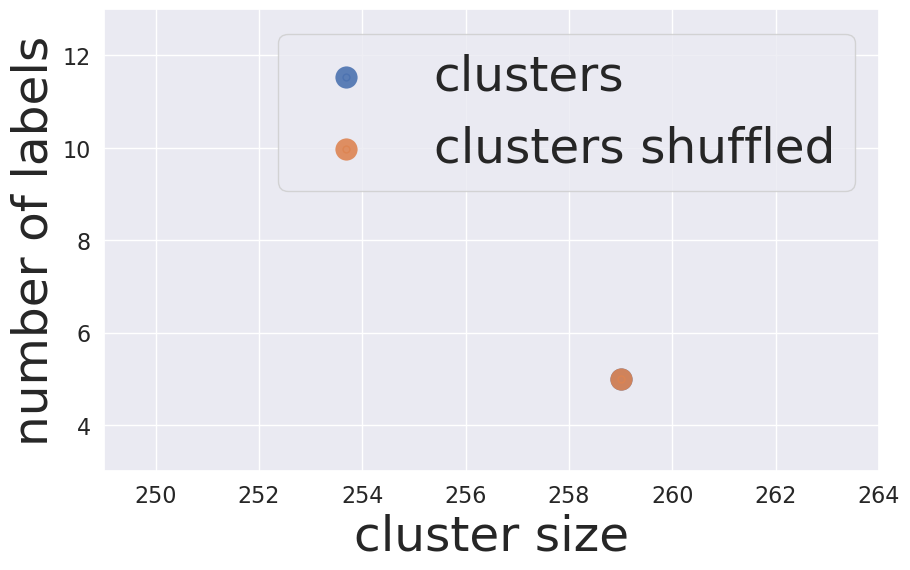

False DKFZ_subgroup 1


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


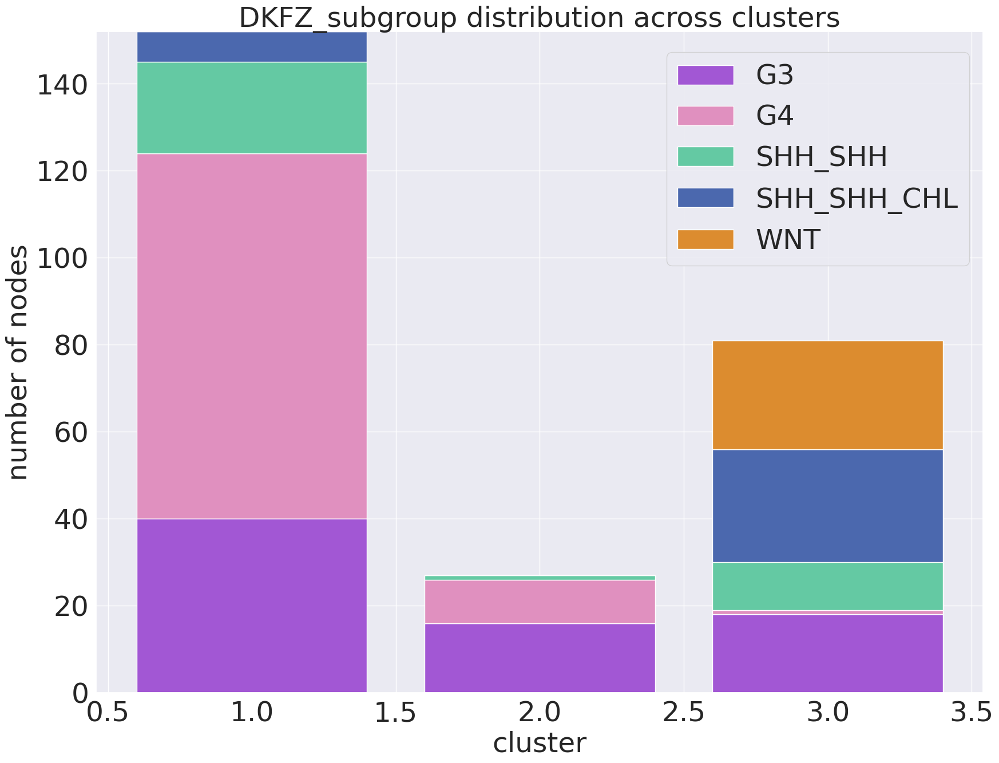

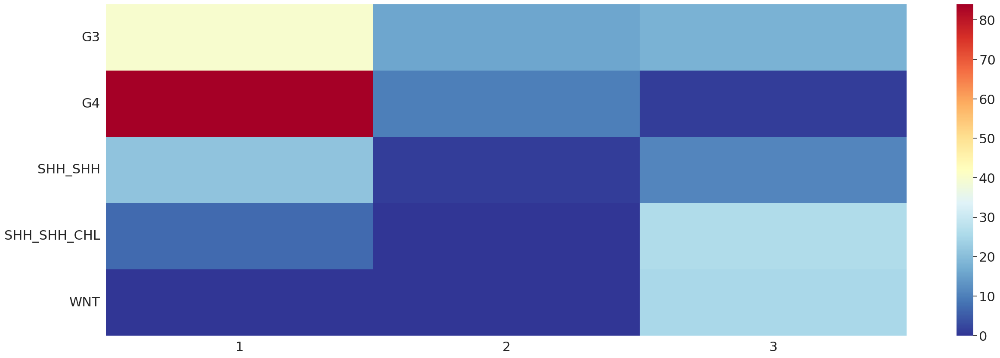

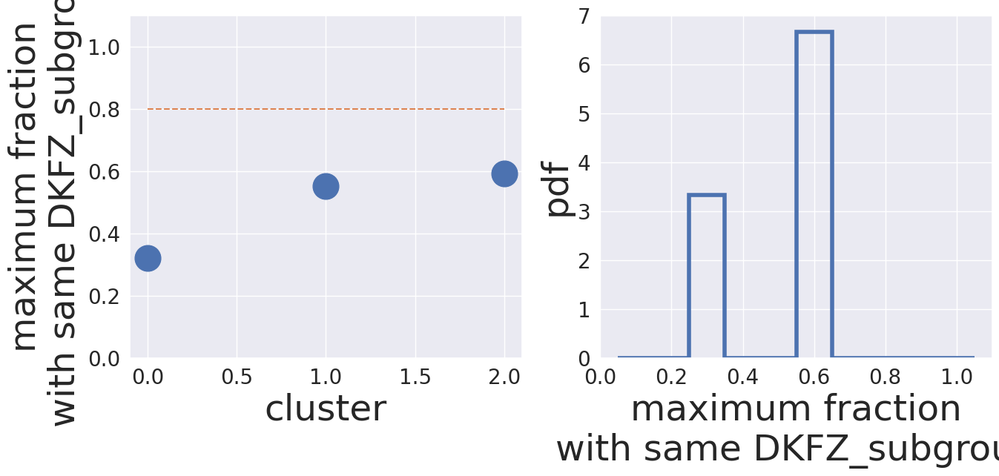

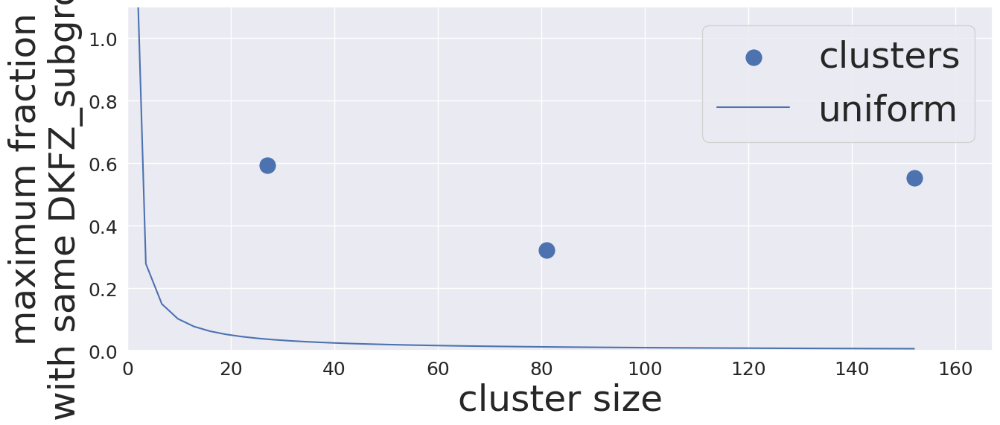

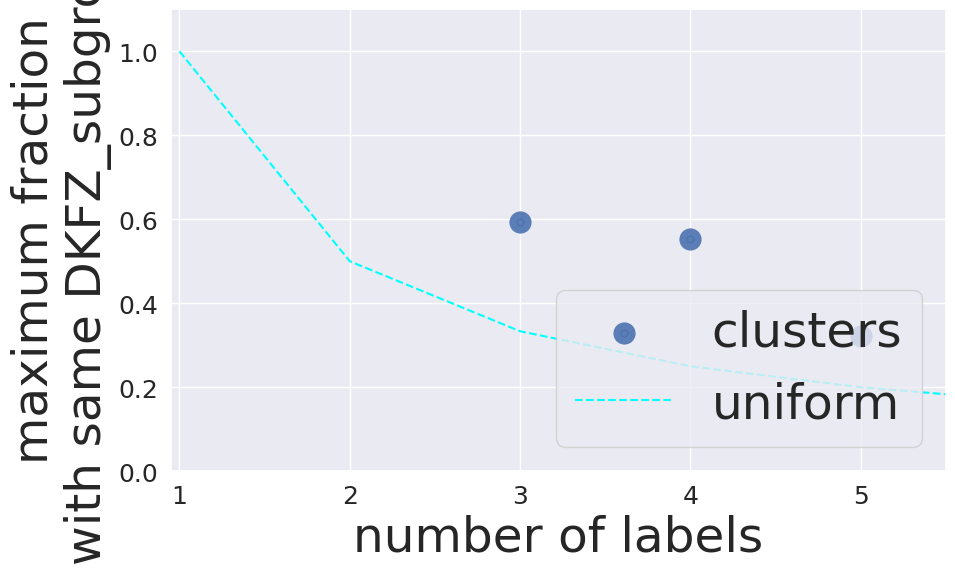

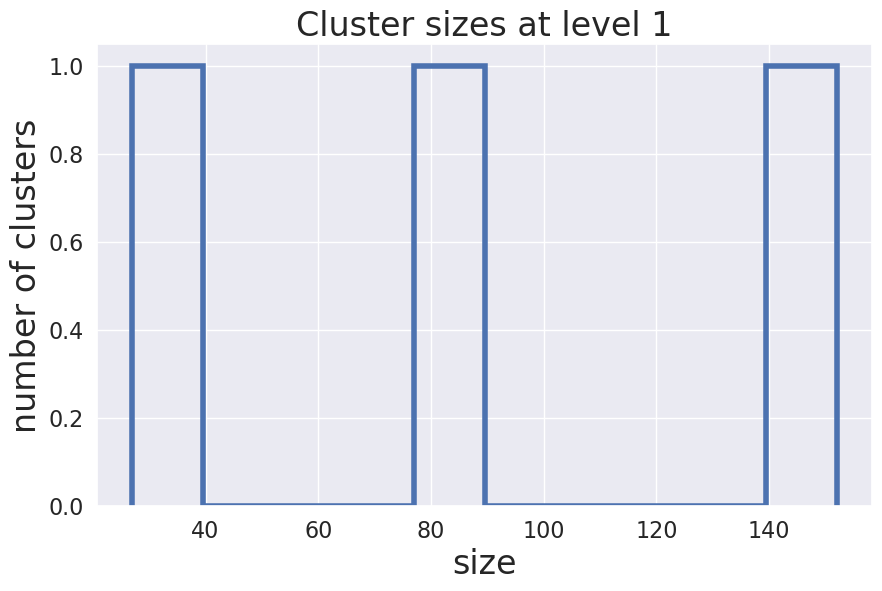

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


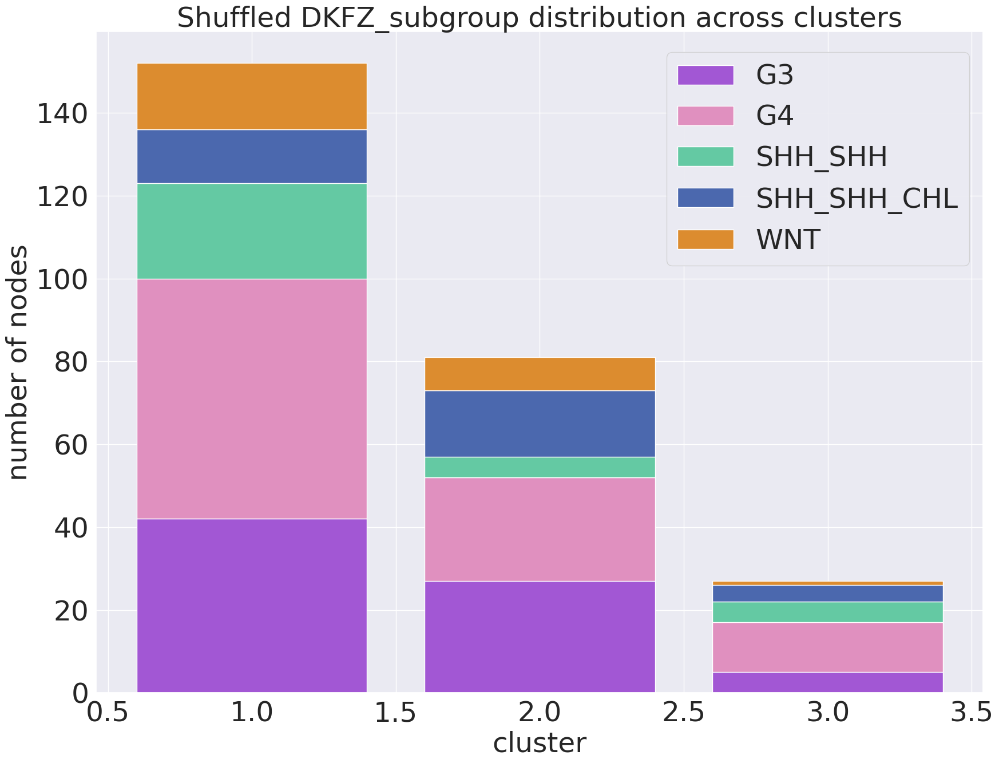

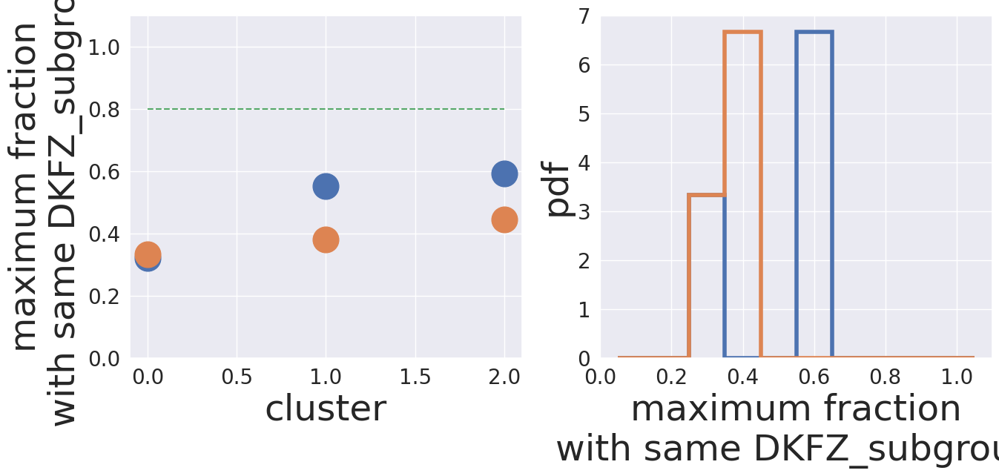

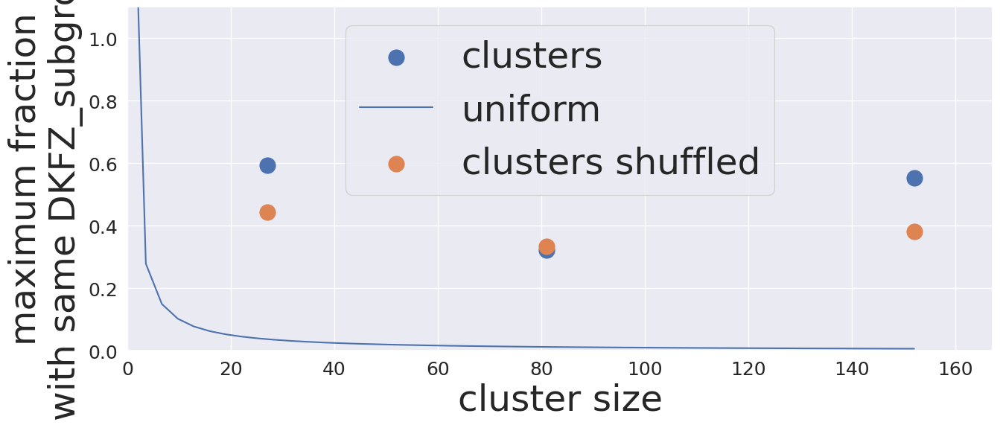

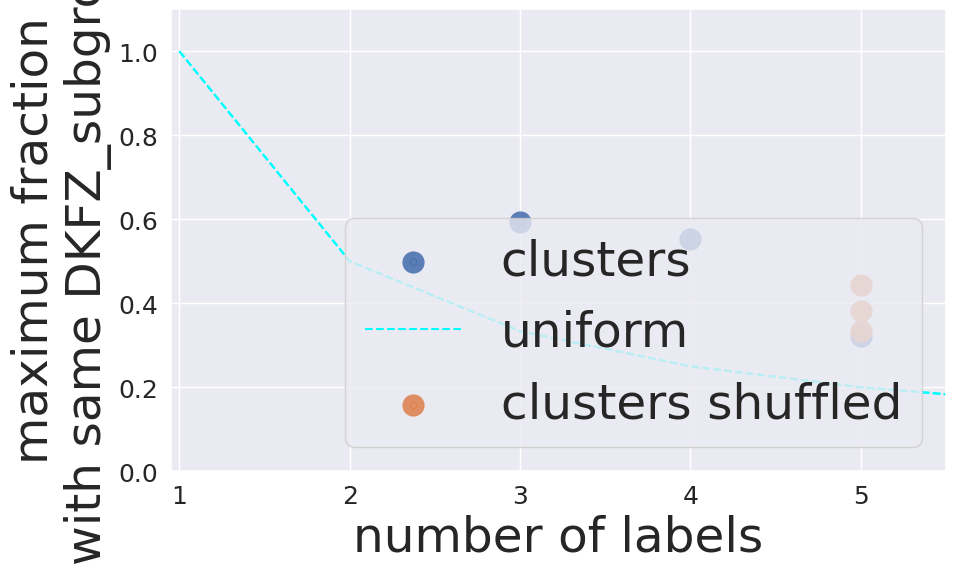

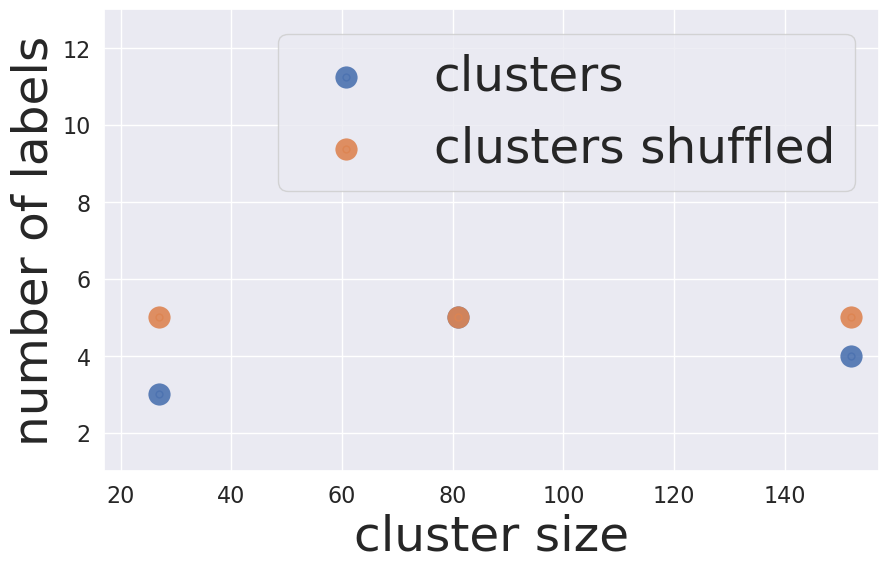

False DKFZ_subgroup 0


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


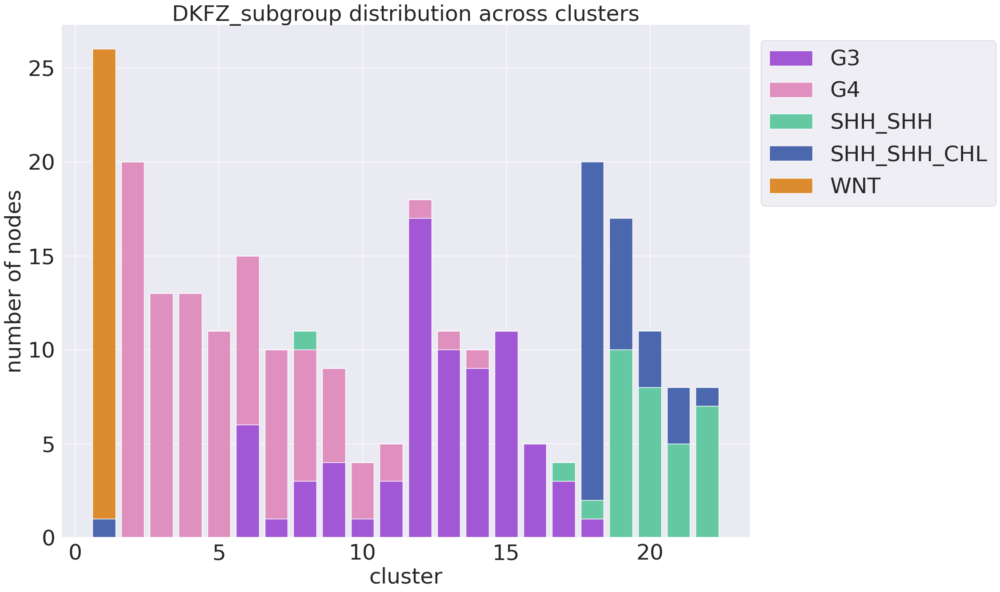

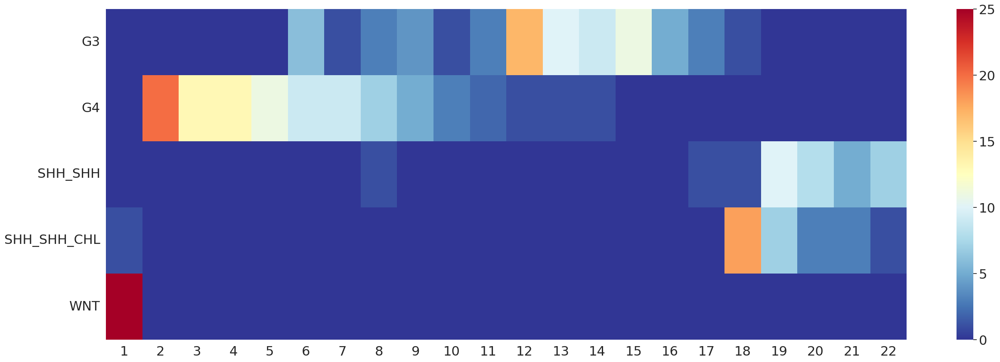

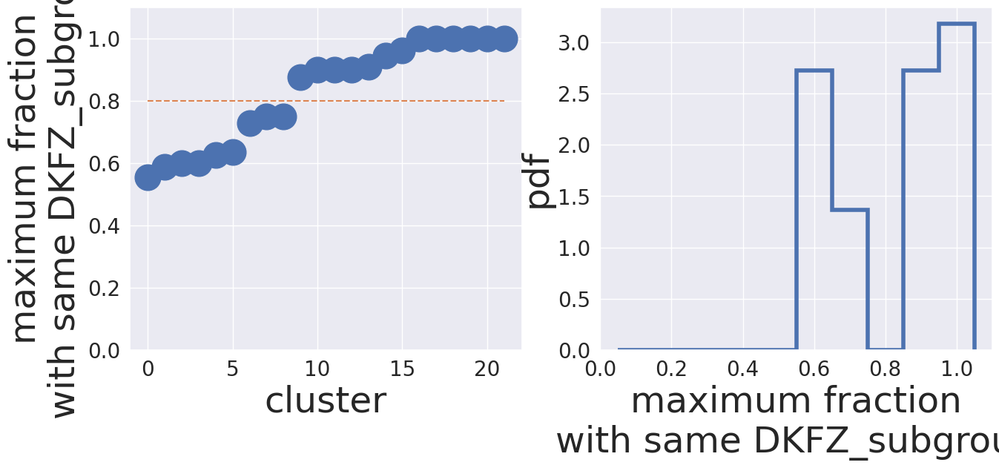

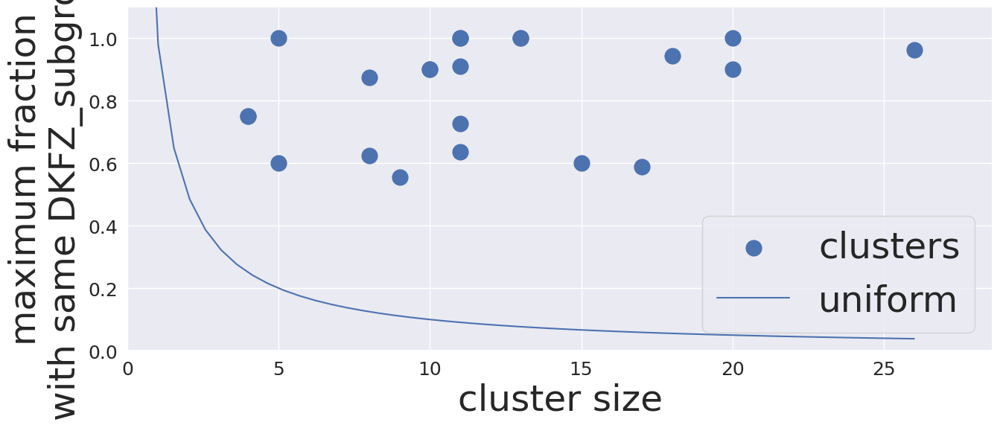

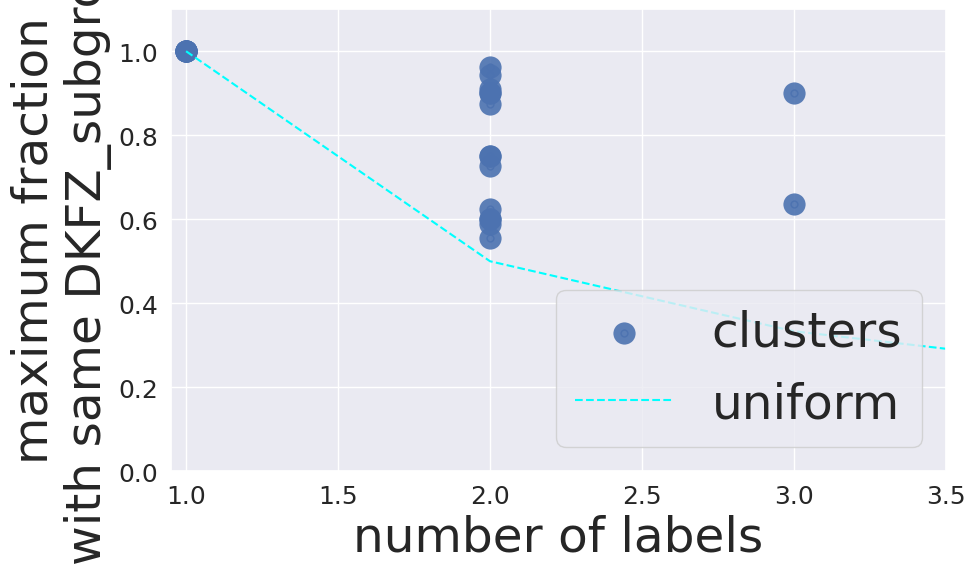

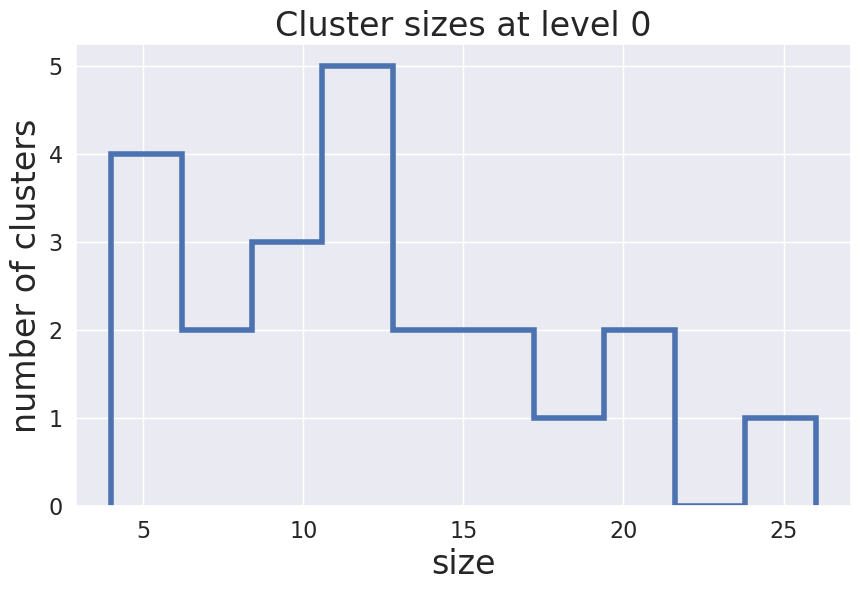

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


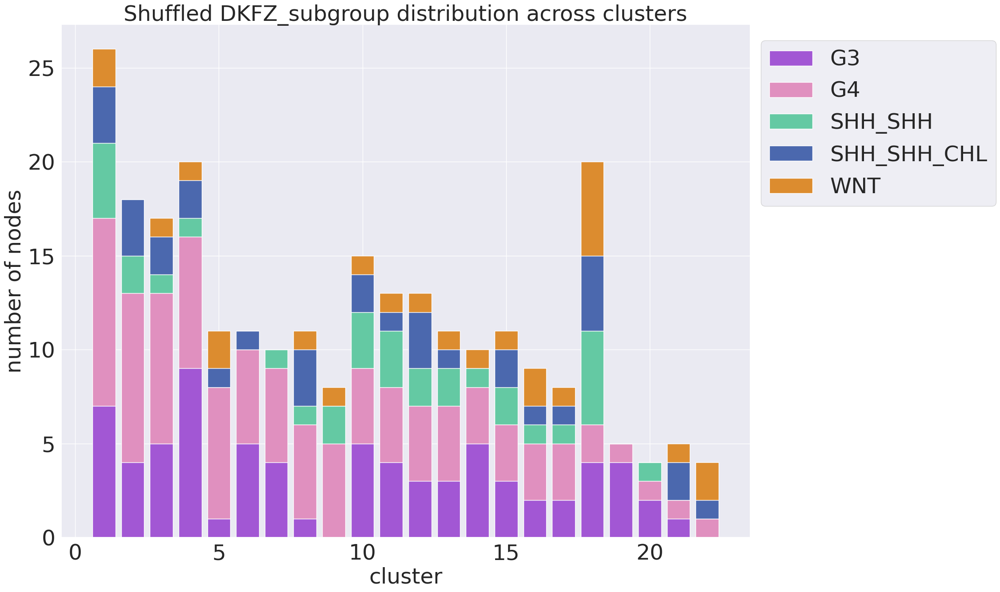

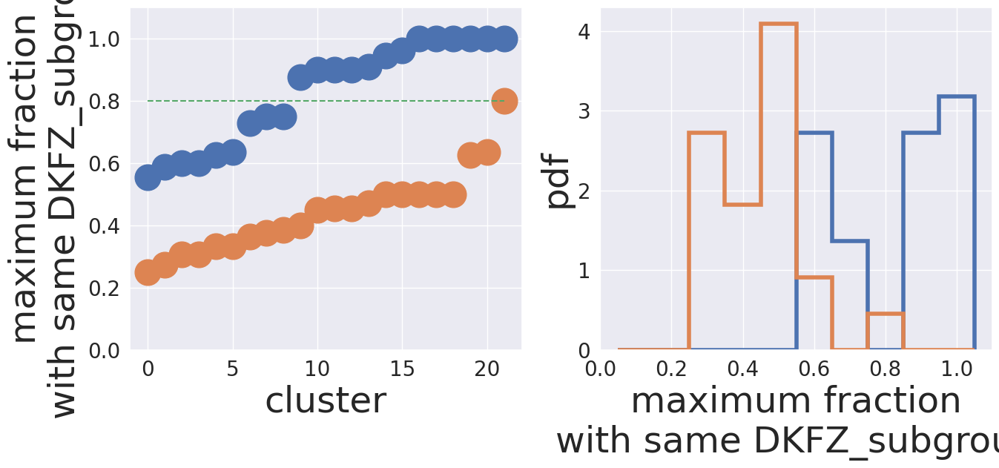

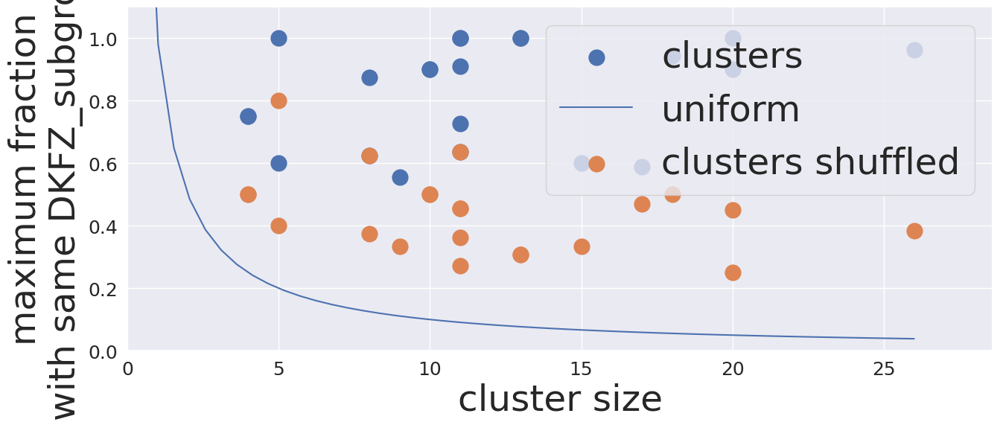

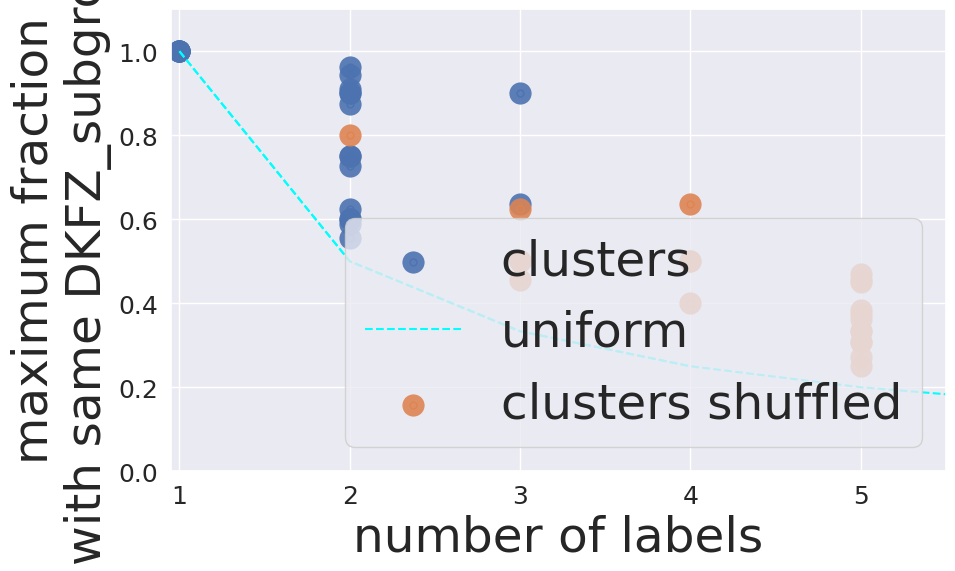

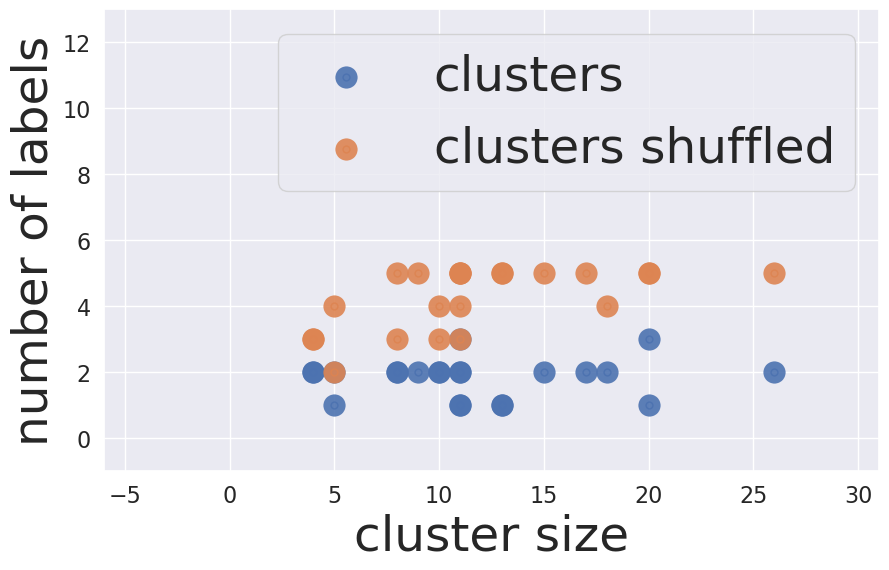

False DKFZ_subtype 10


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


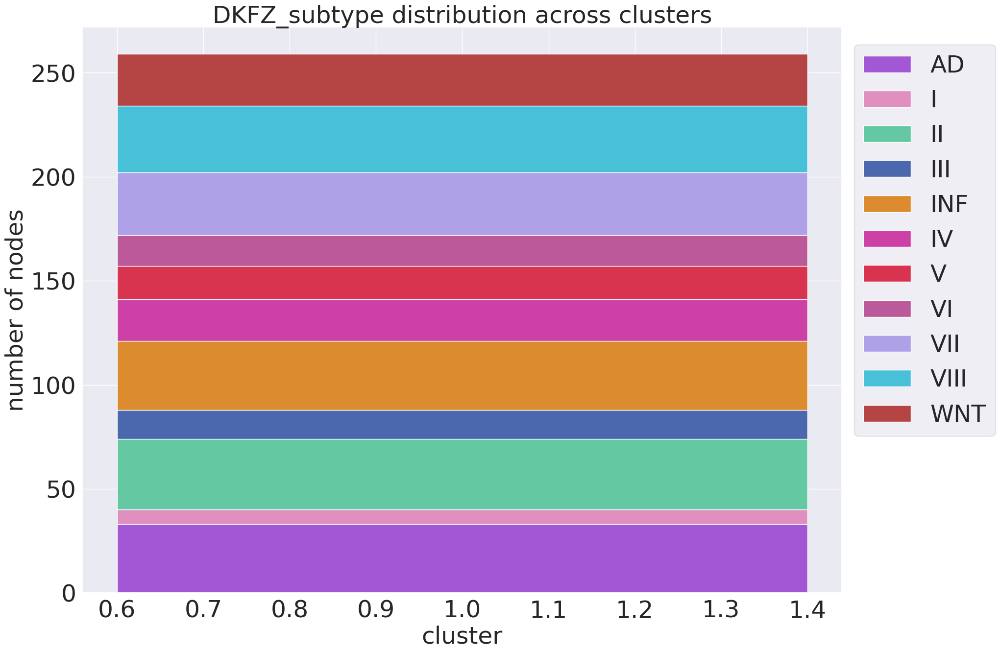

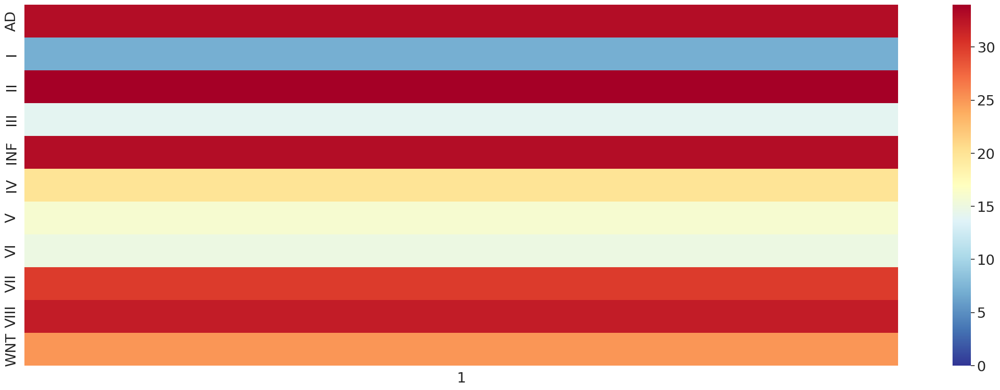

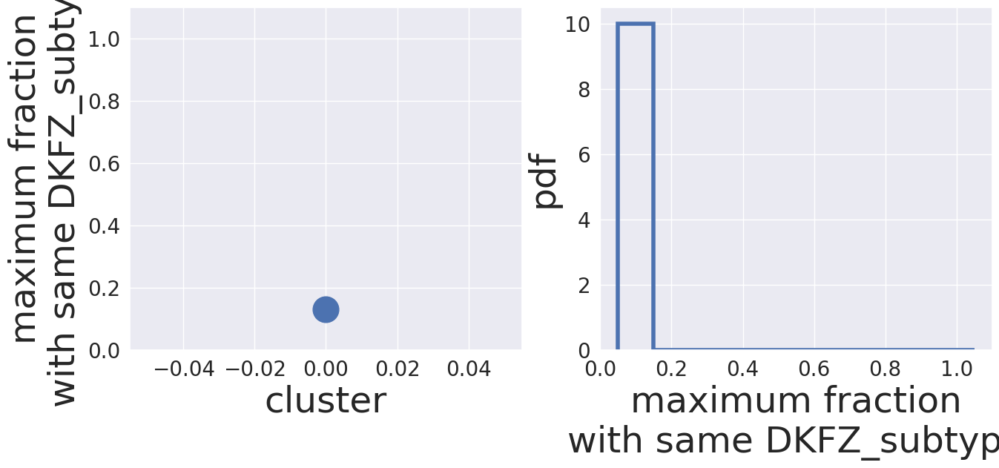

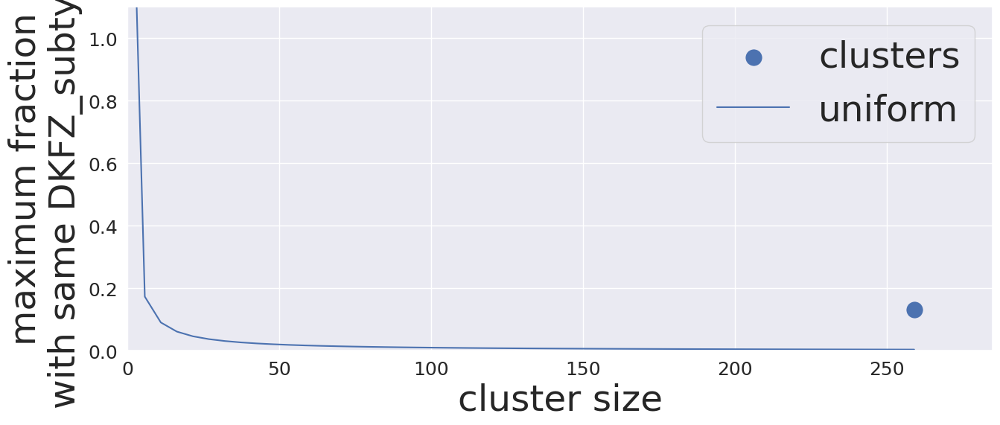

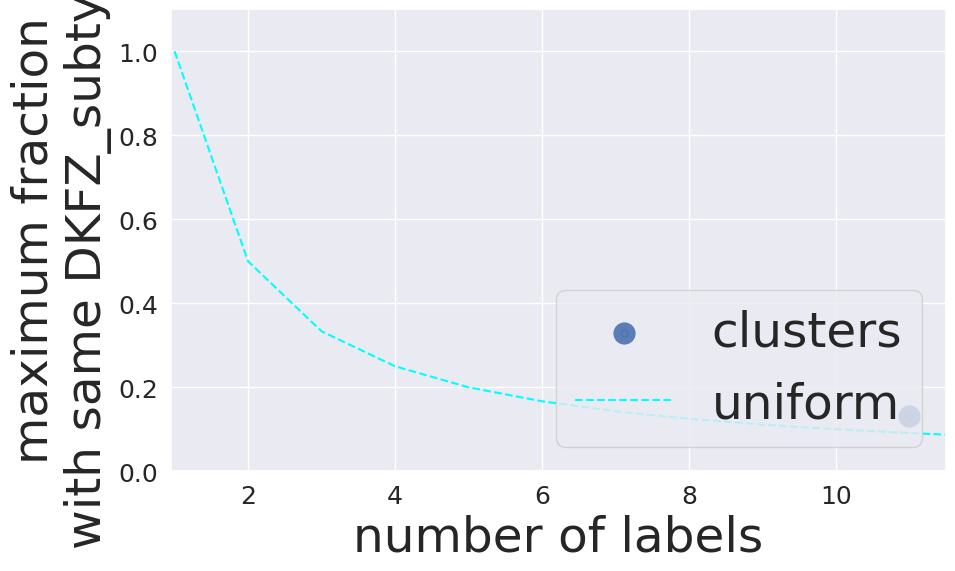

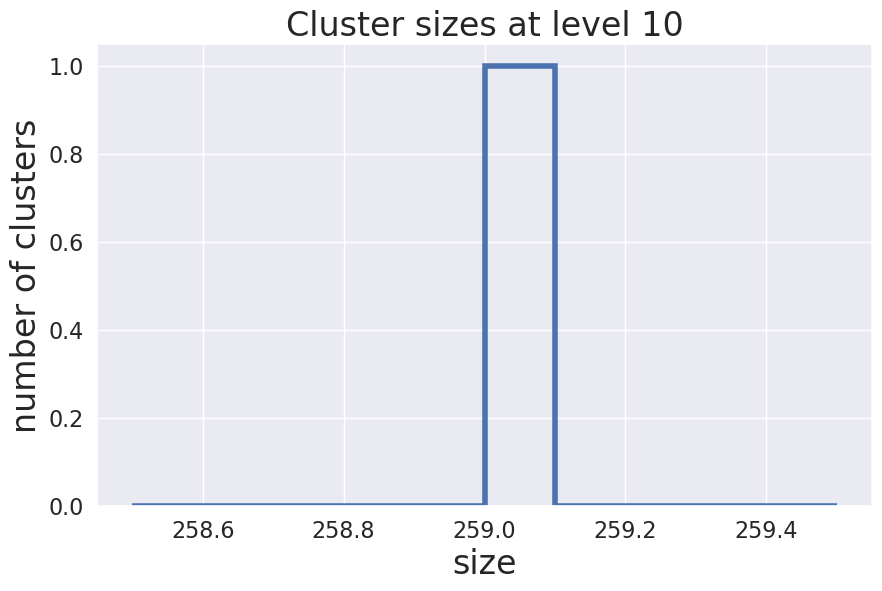

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


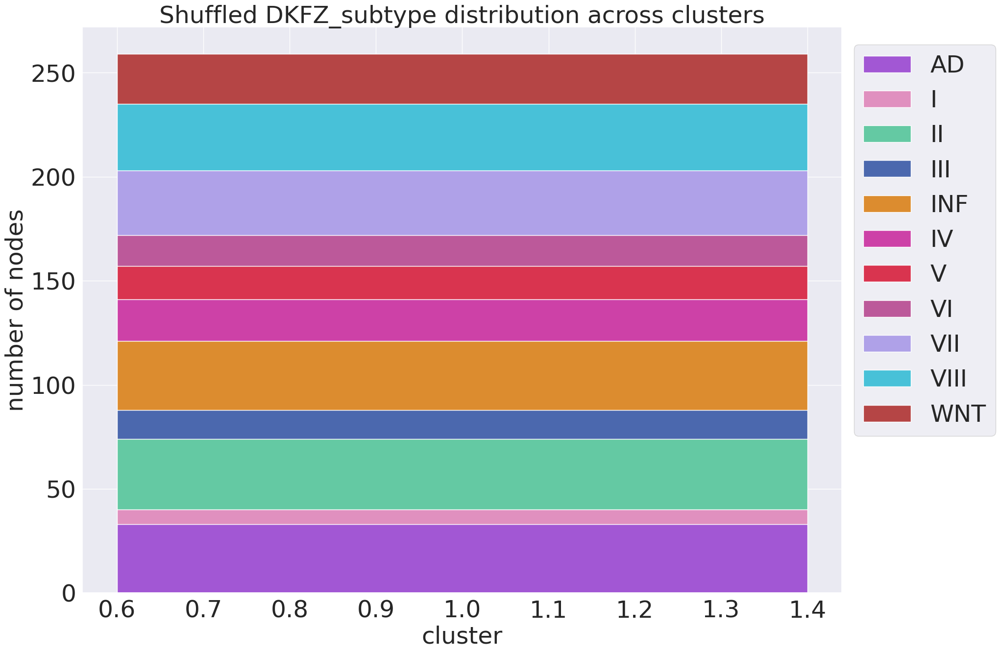

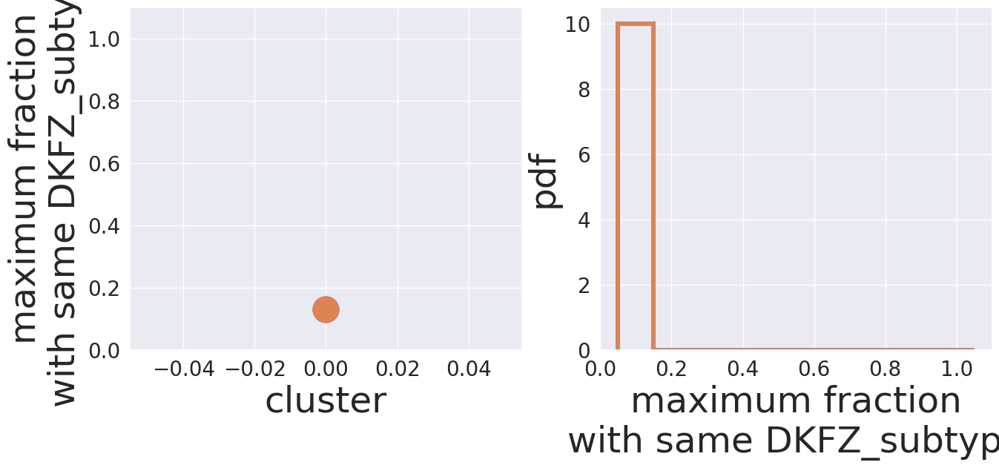

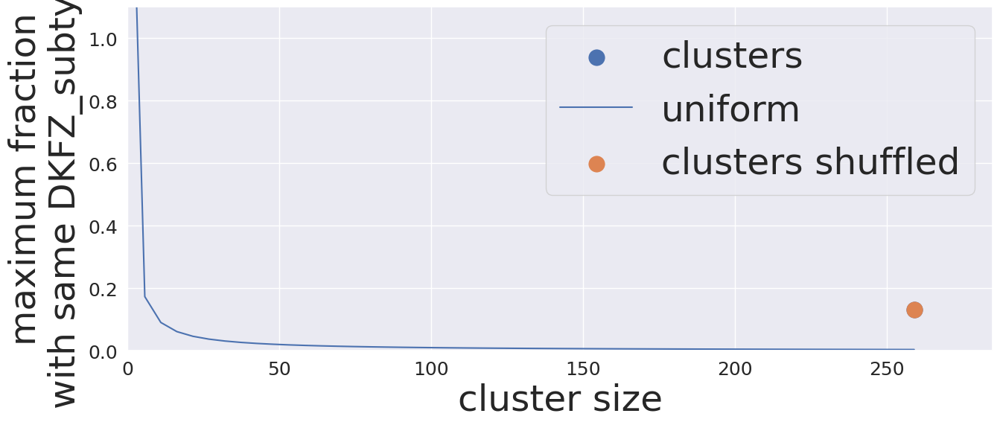

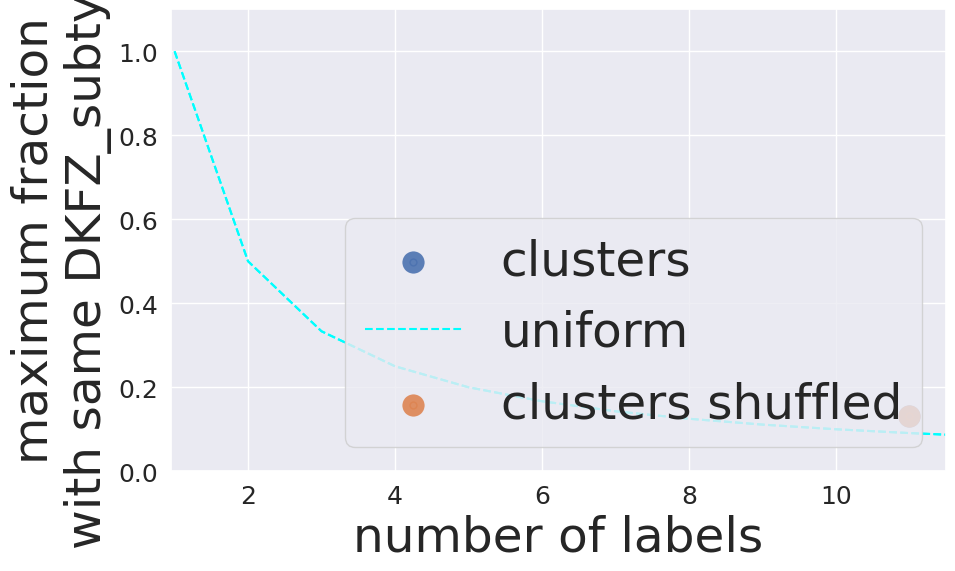

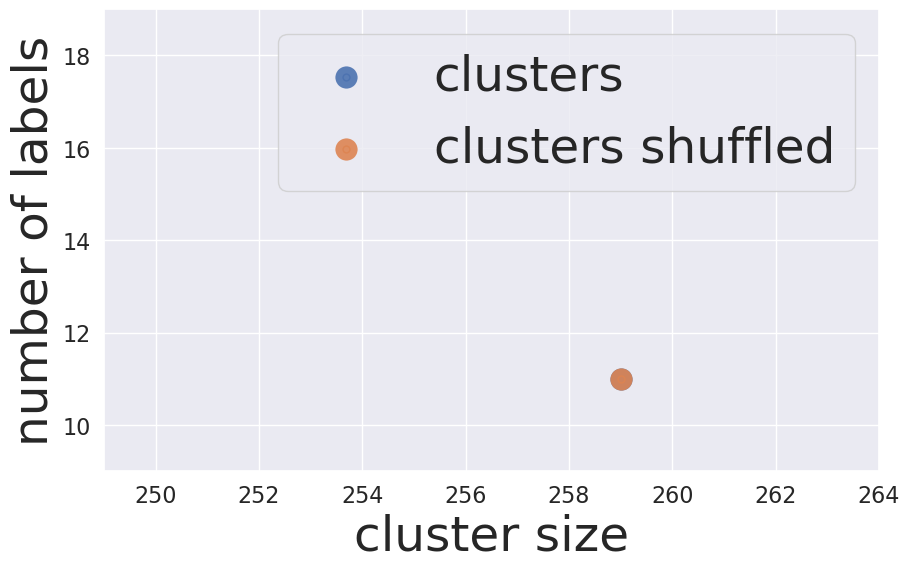

False DKFZ_subtype 9


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


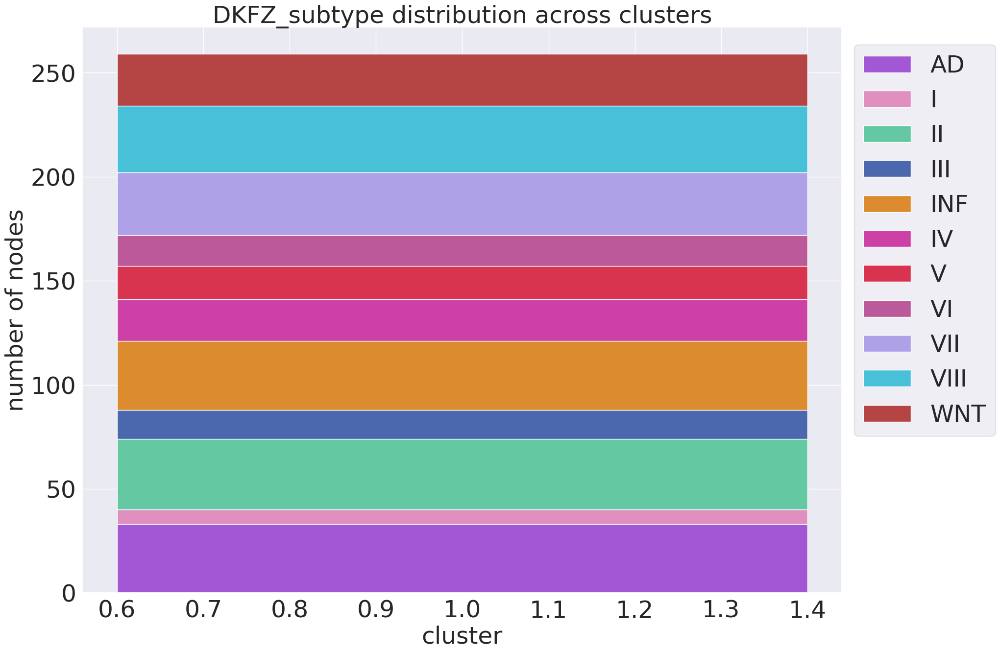

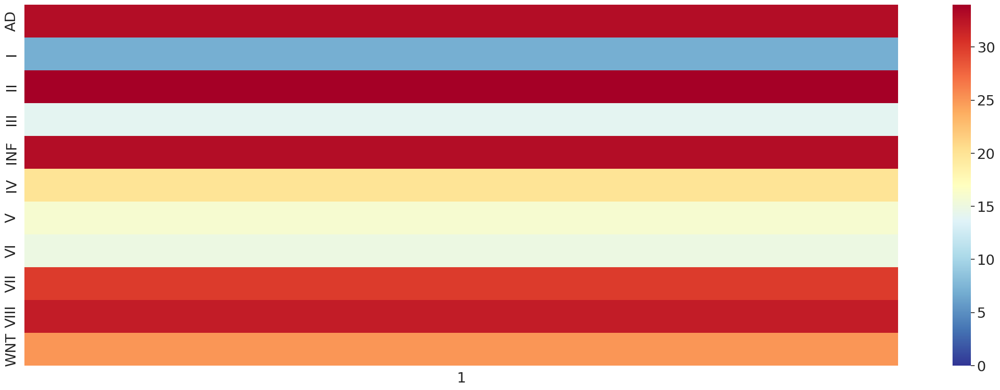

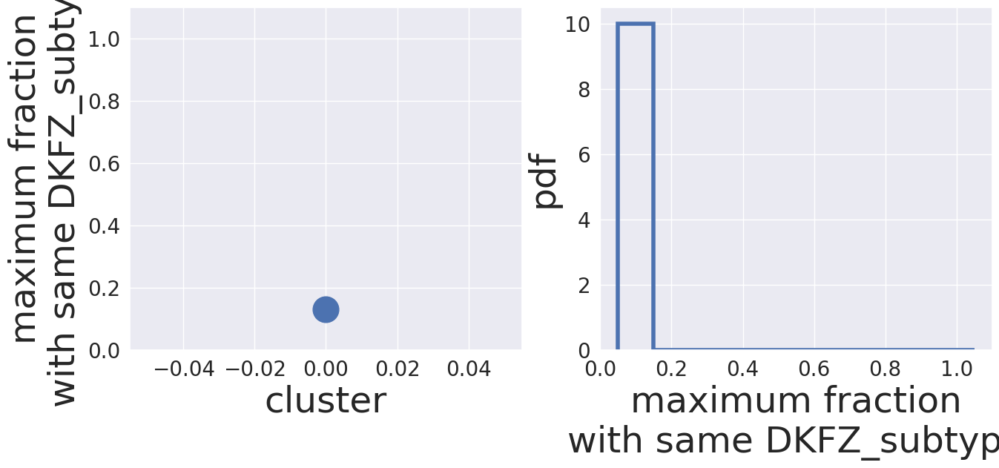

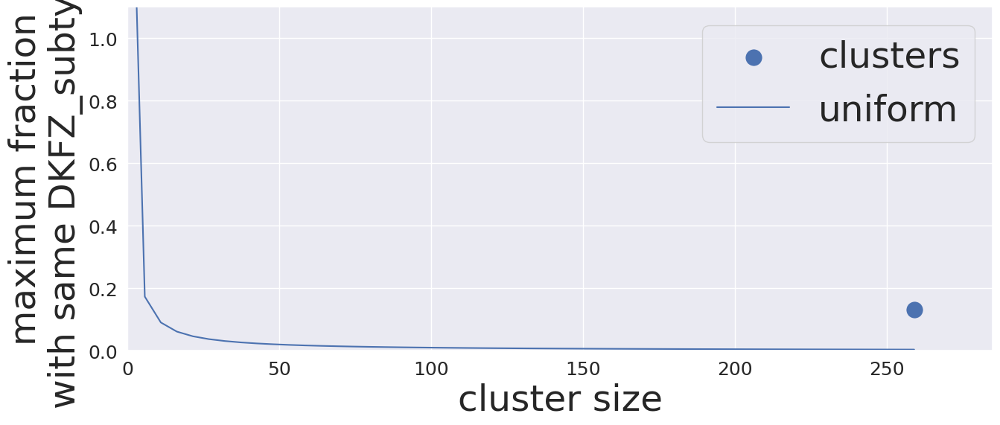

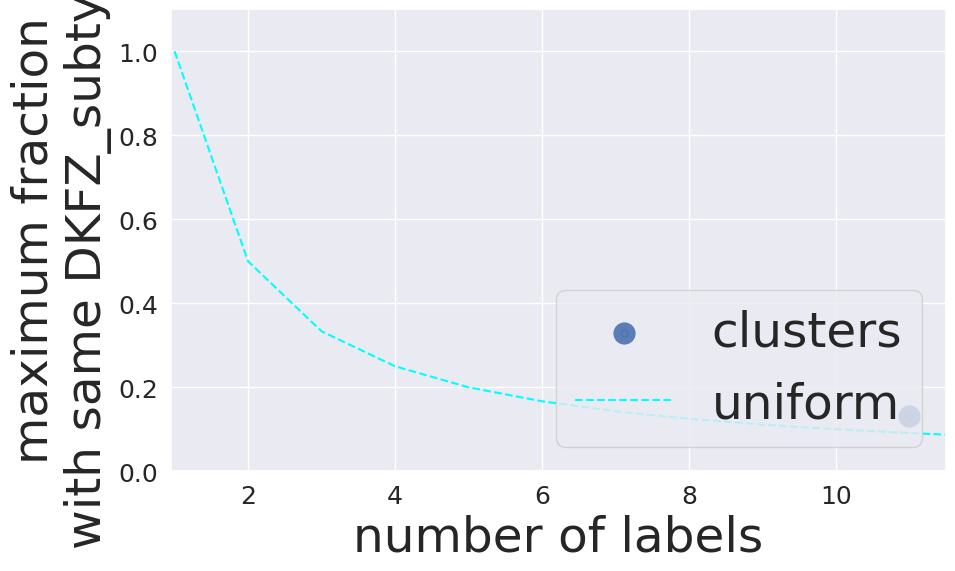

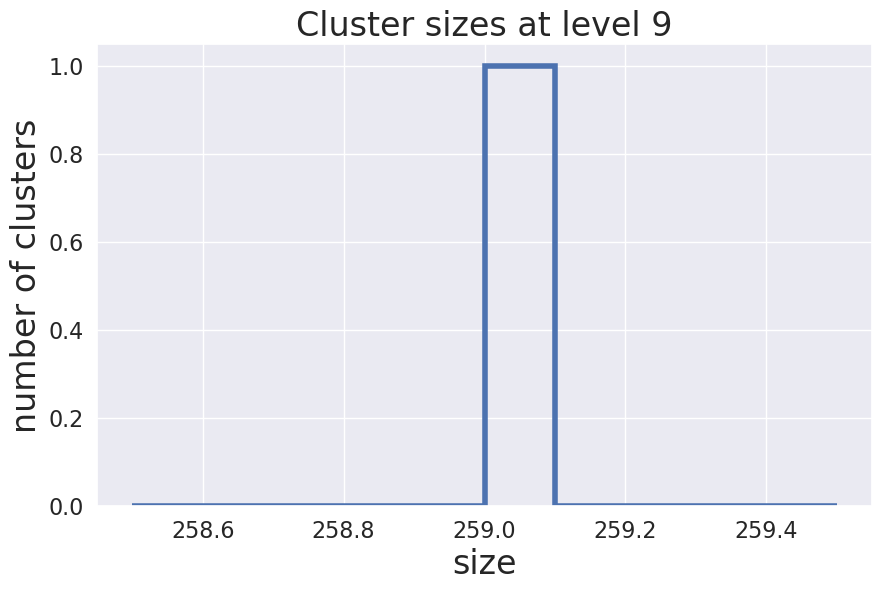

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


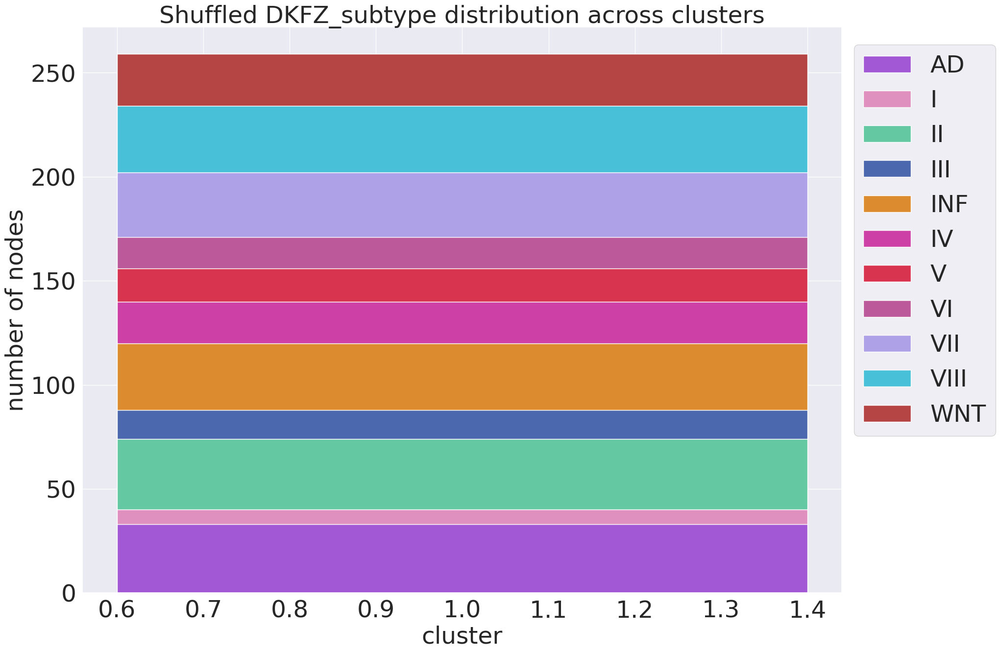

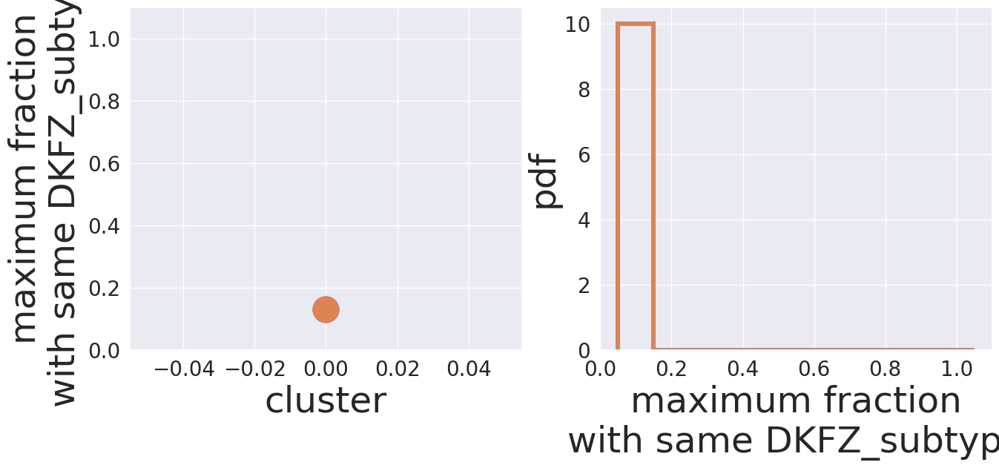

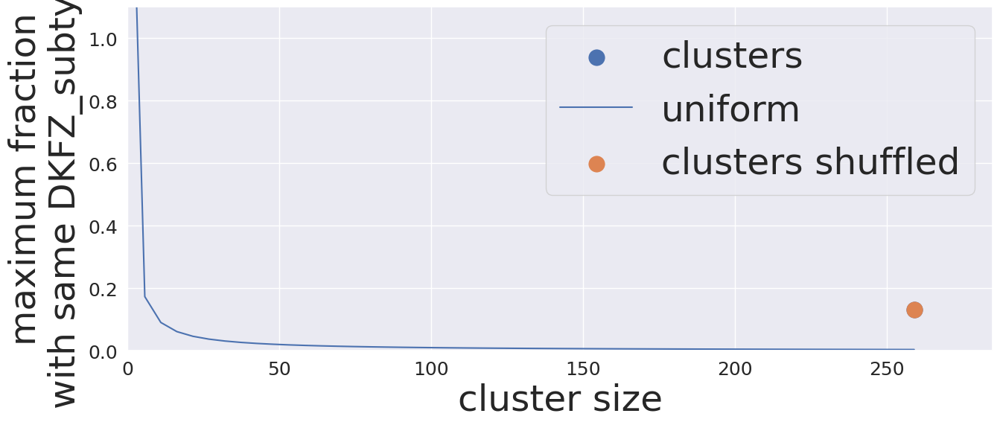

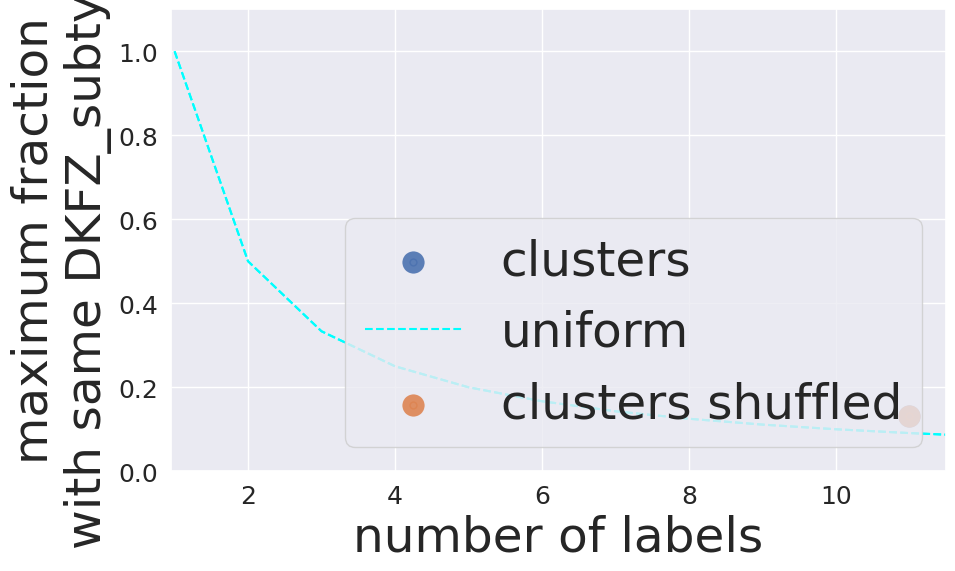

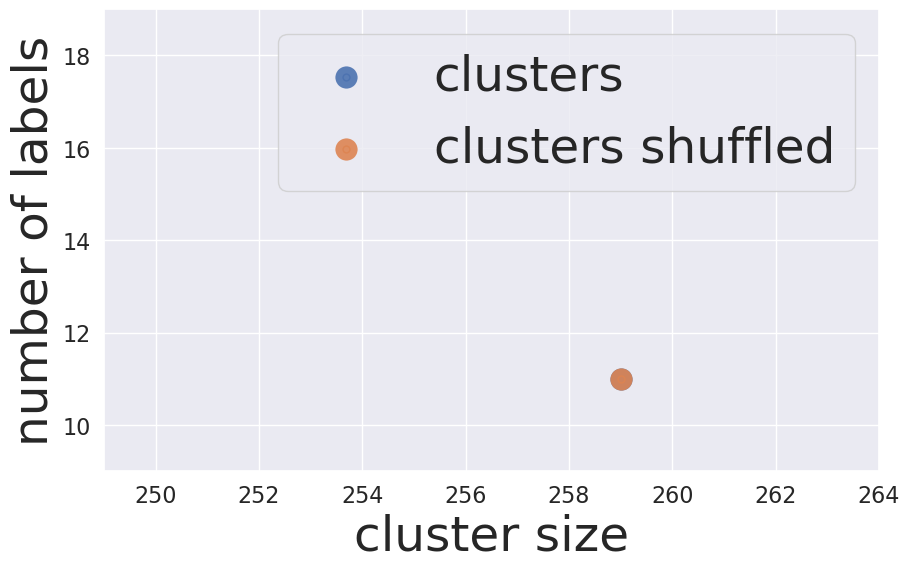

False DKFZ_subtype 8


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


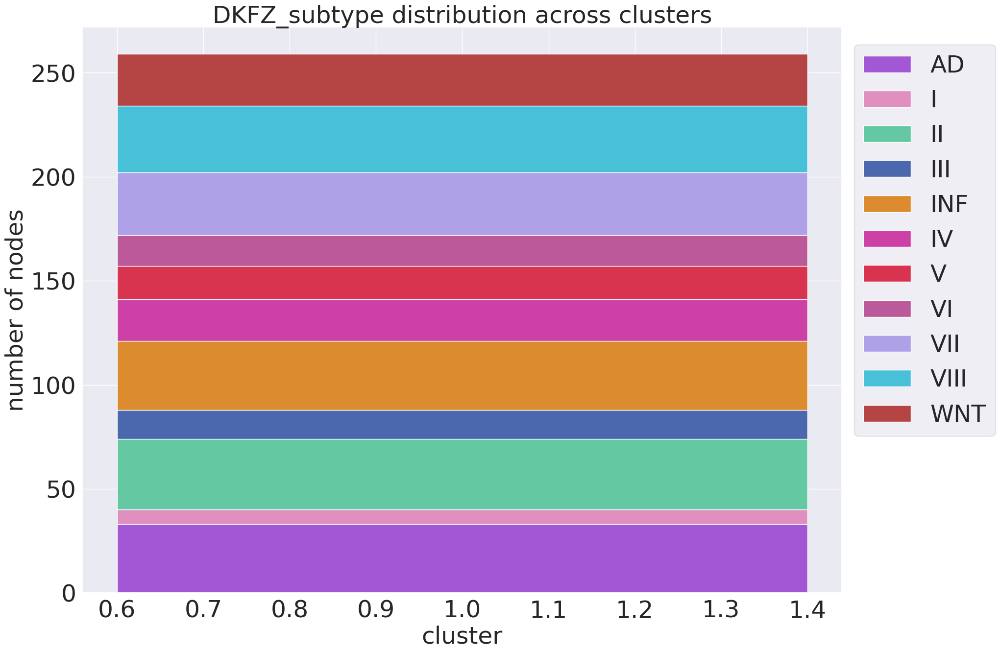

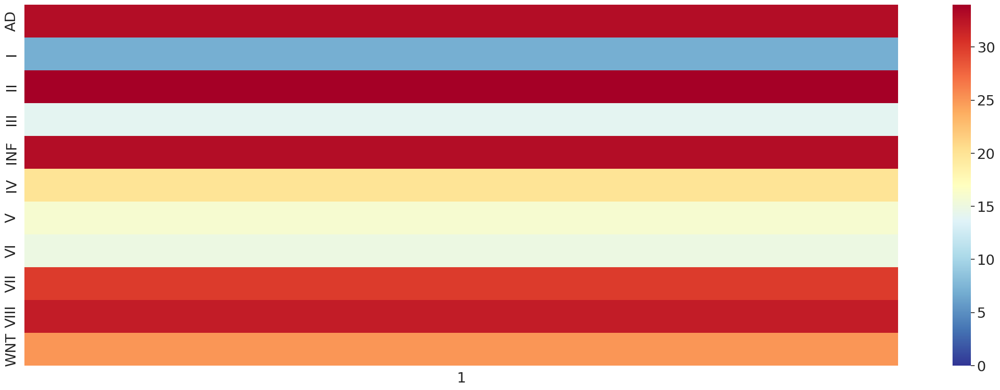

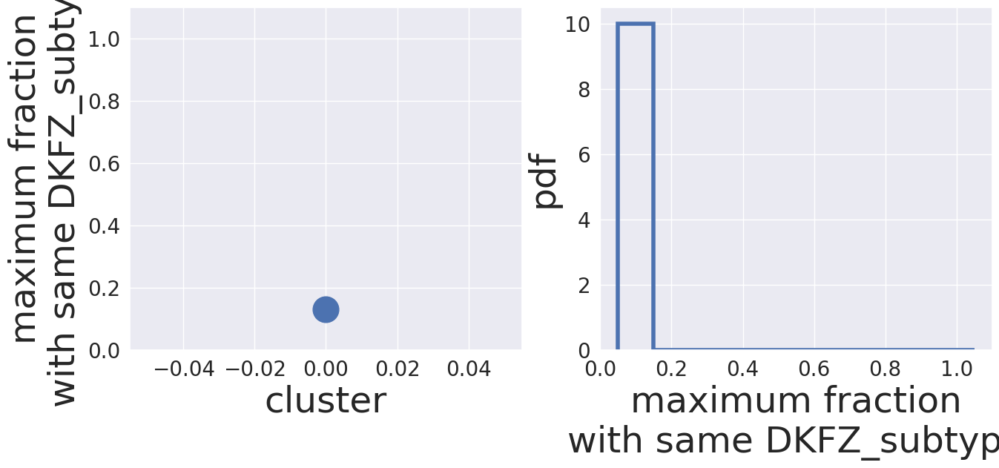

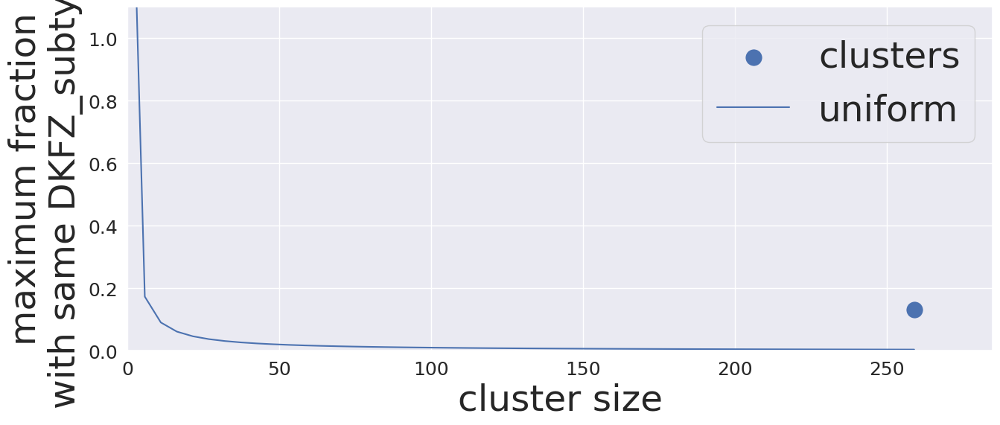

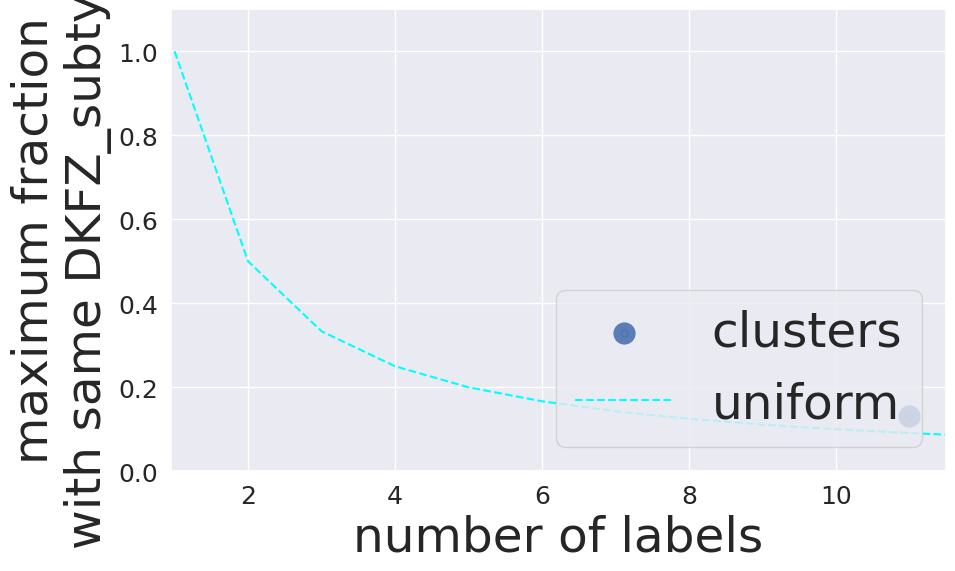

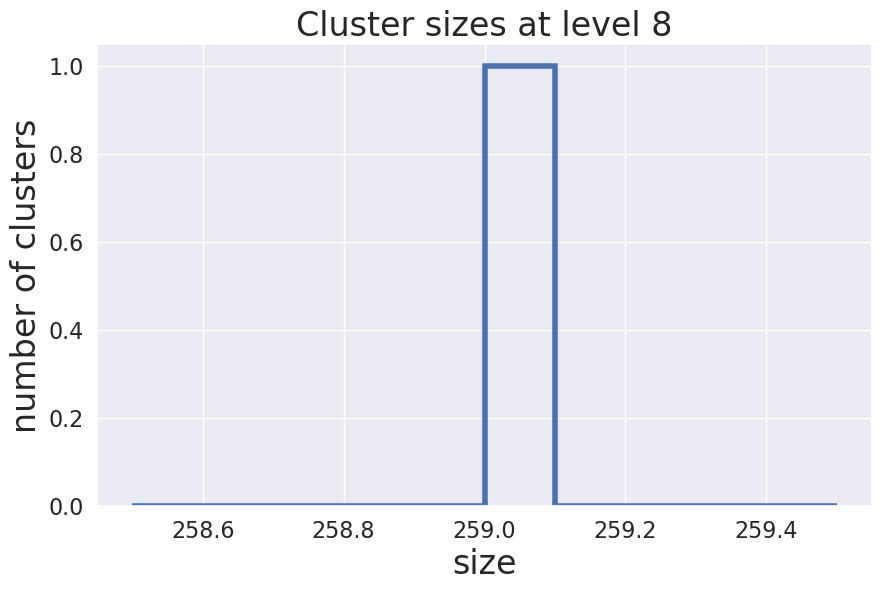

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


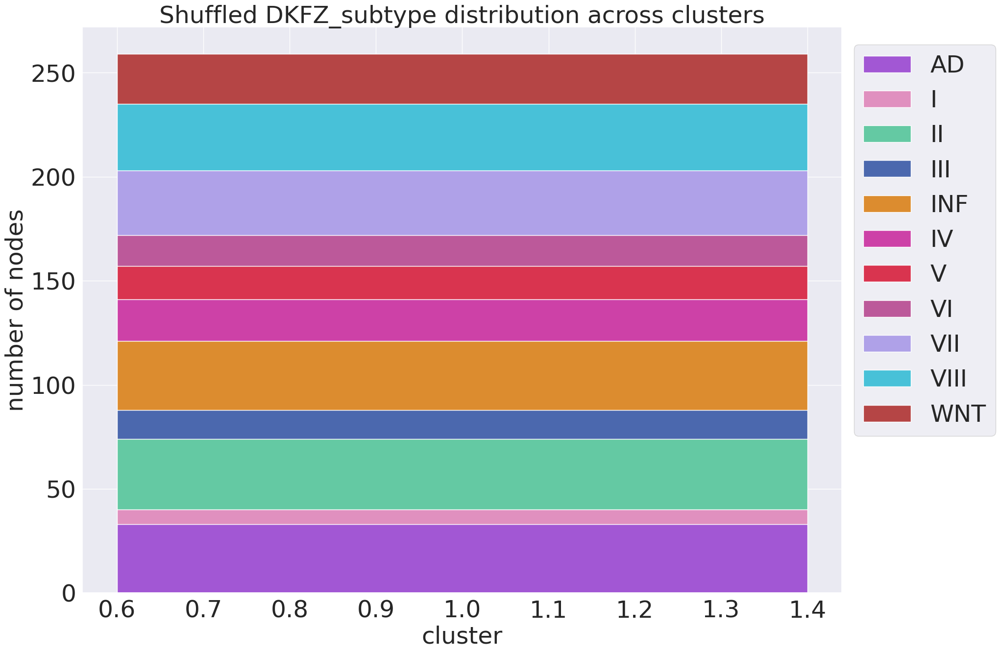

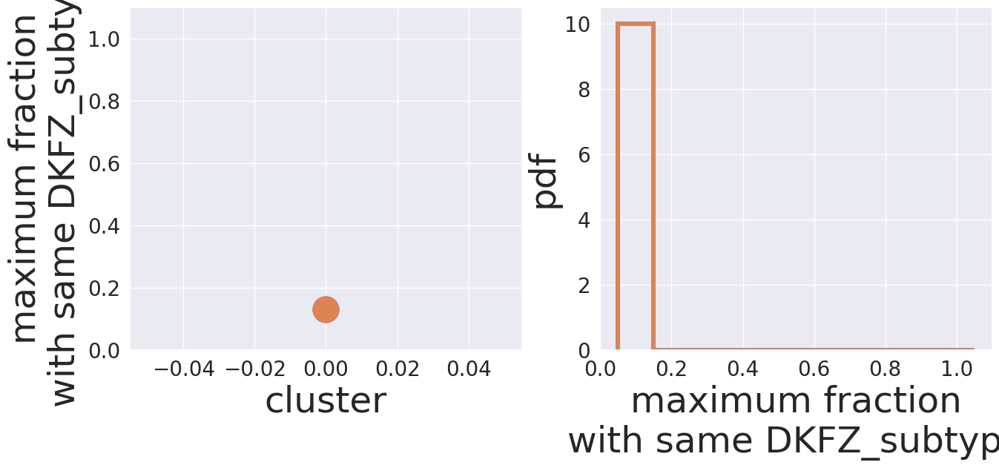

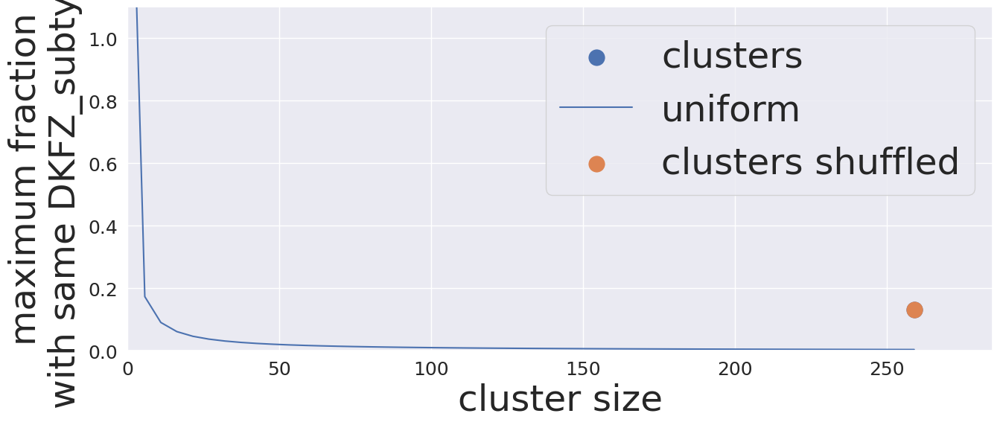

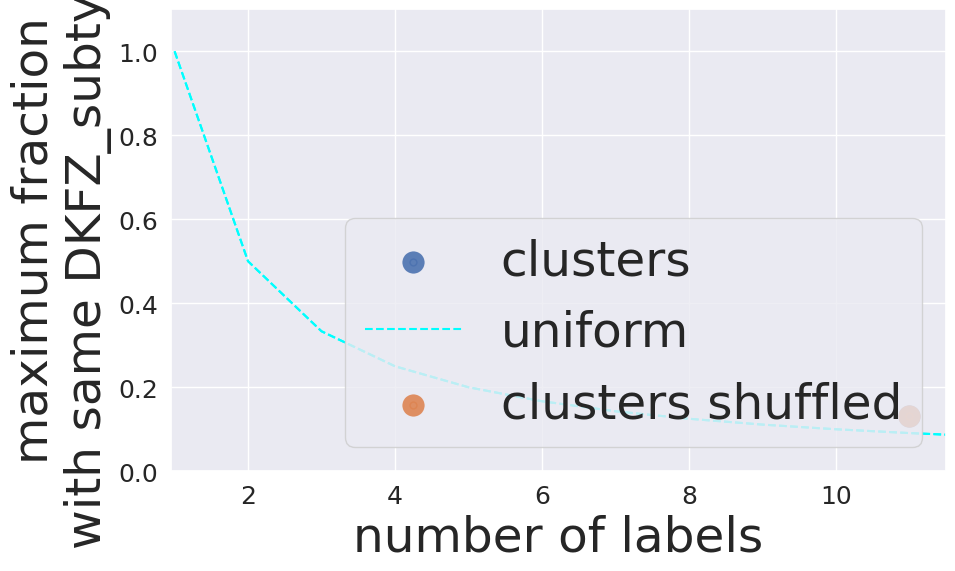

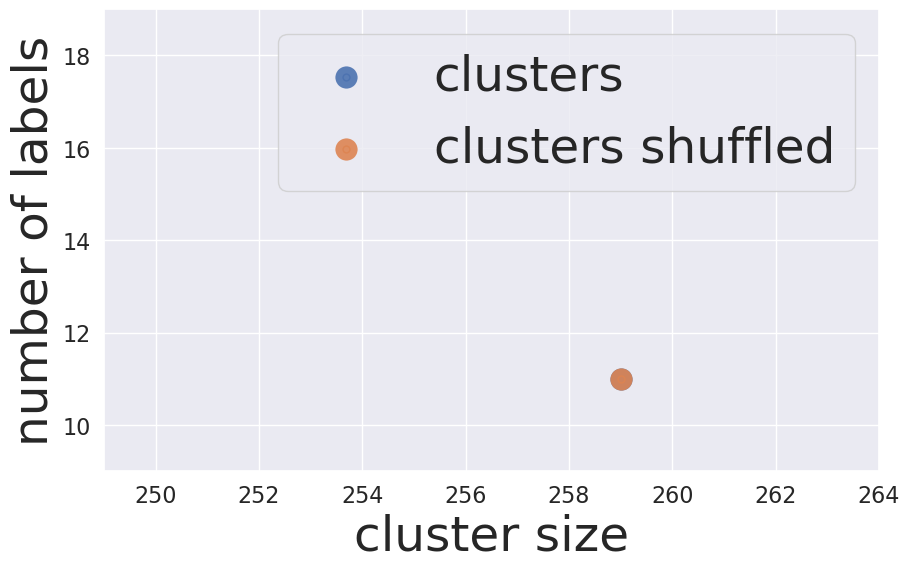

False DKFZ_subtype 7


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


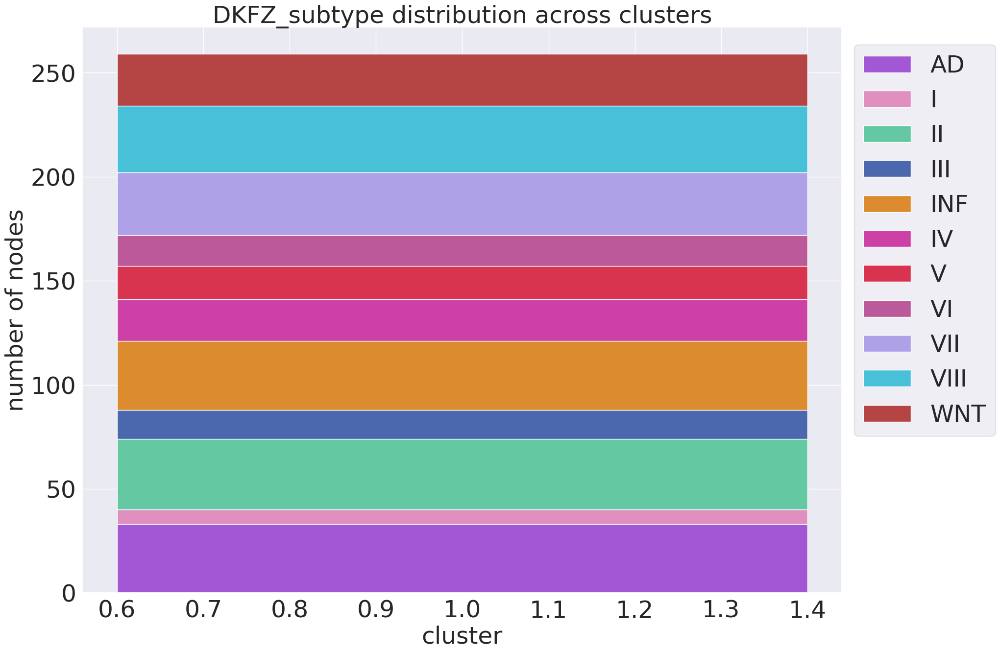

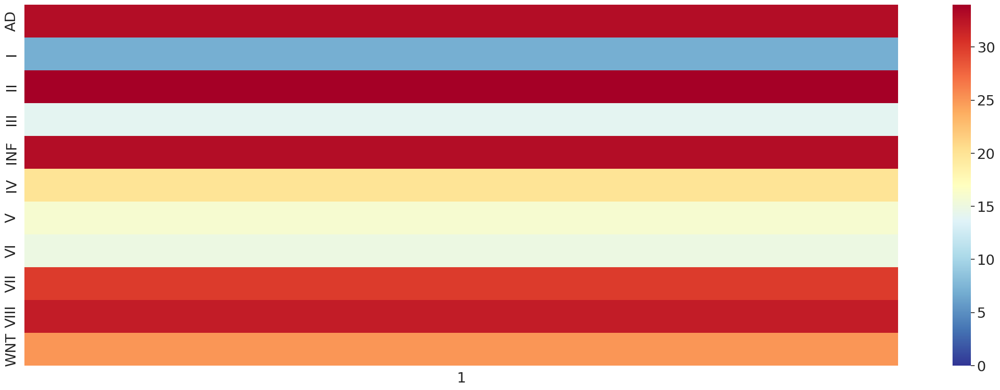

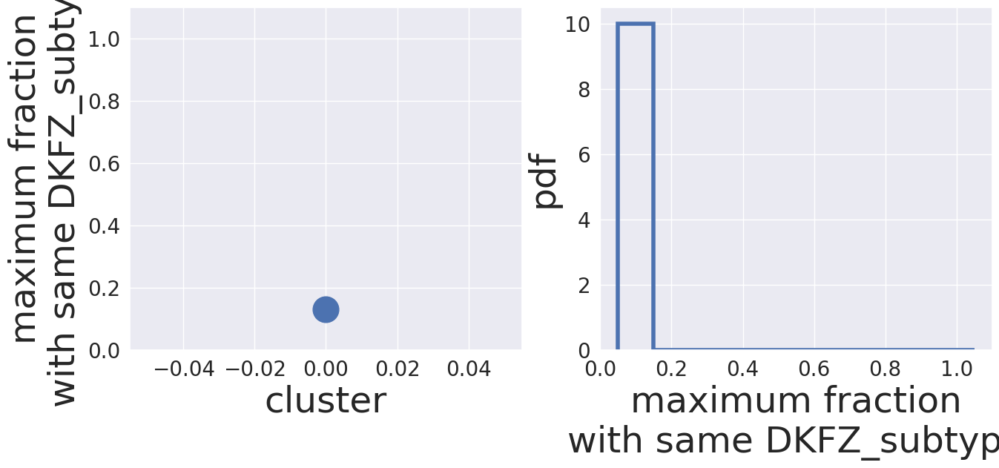

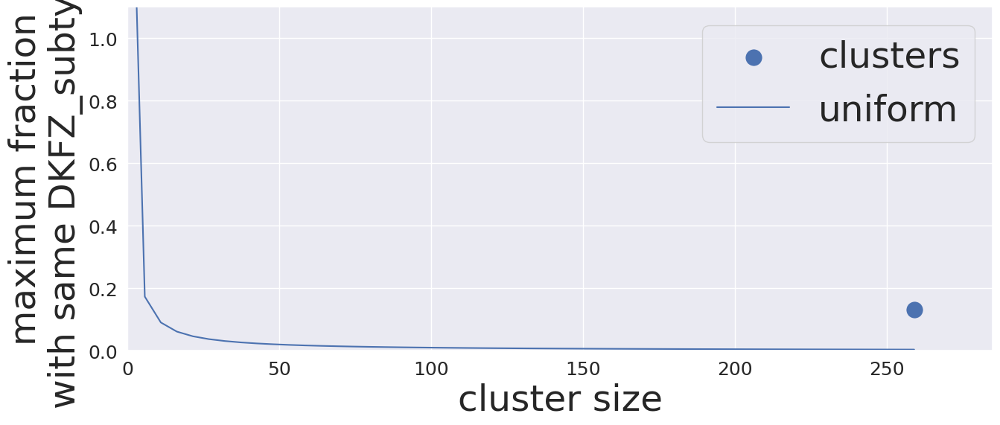

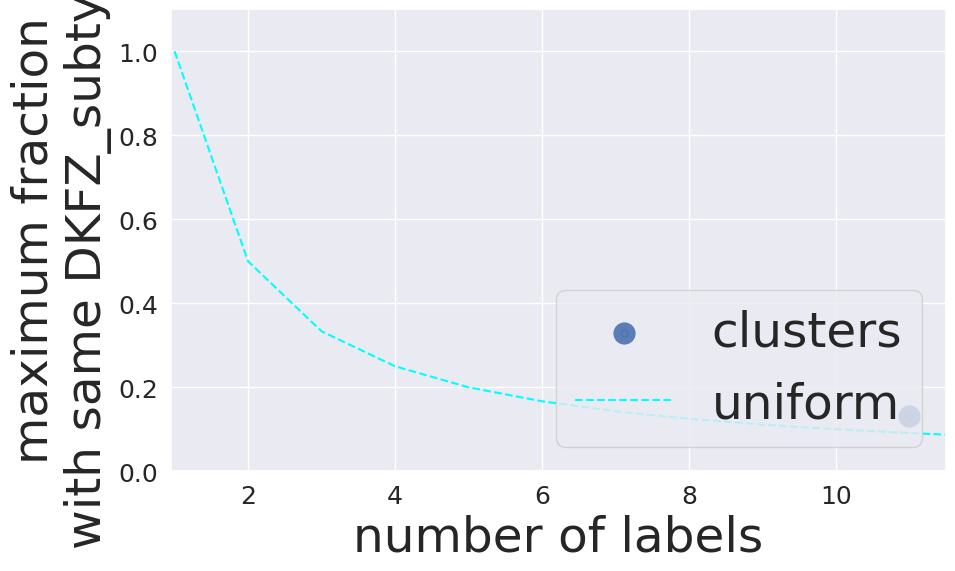

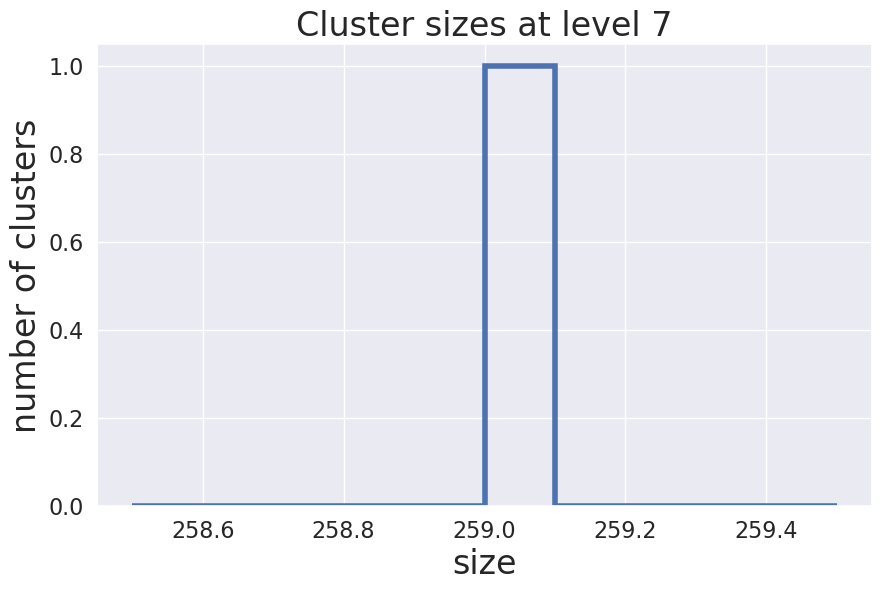

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


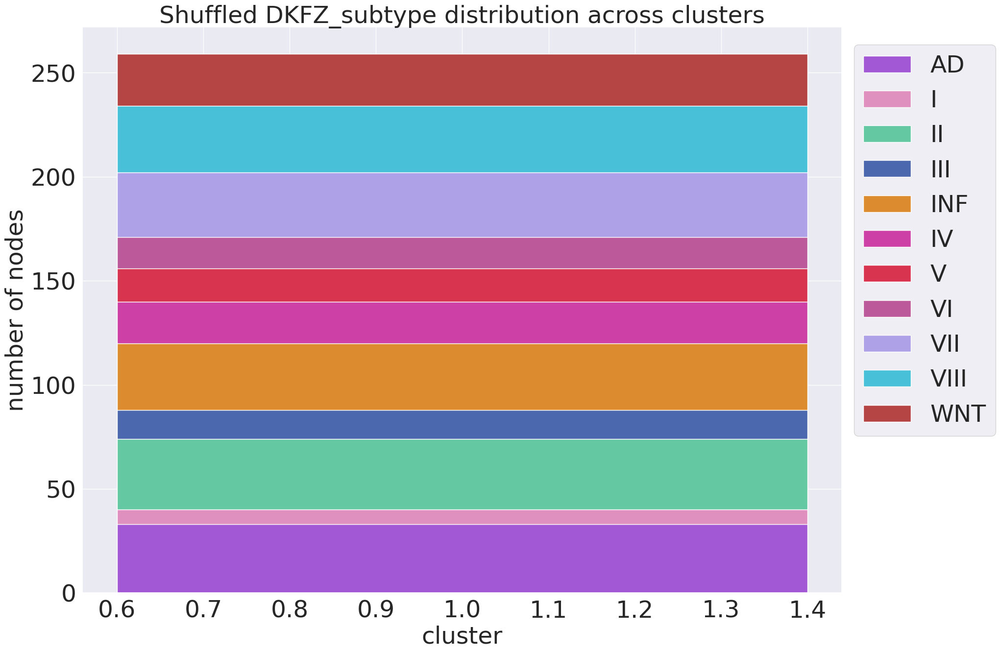

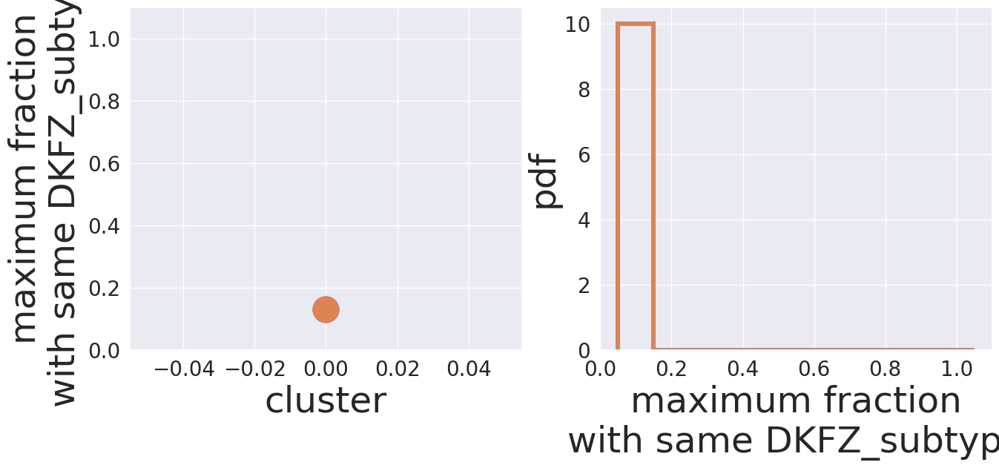

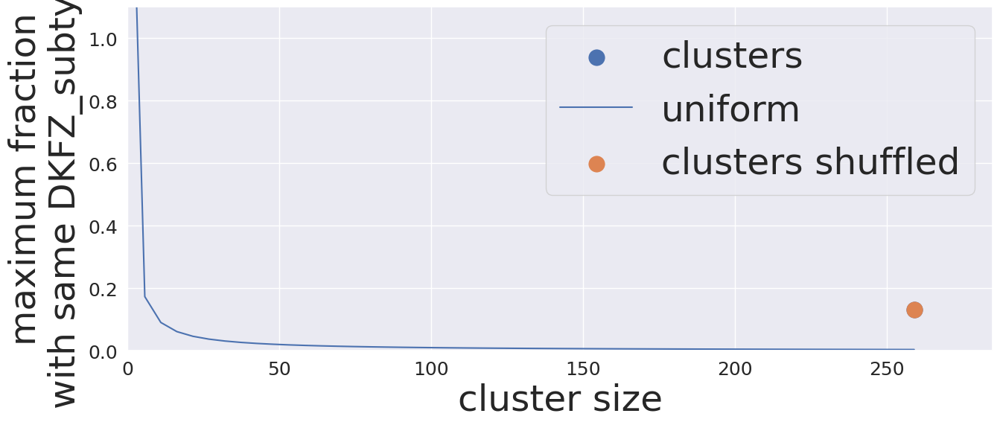

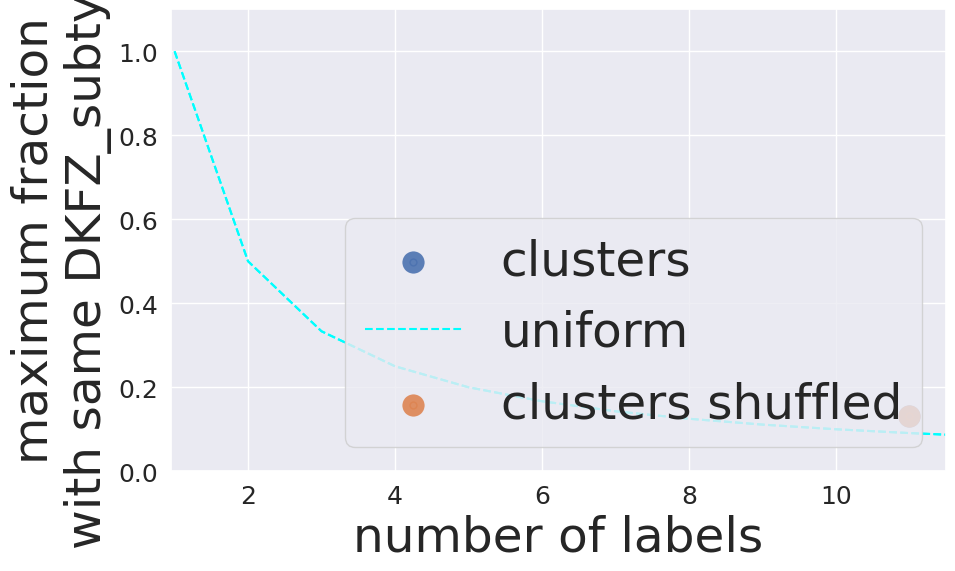

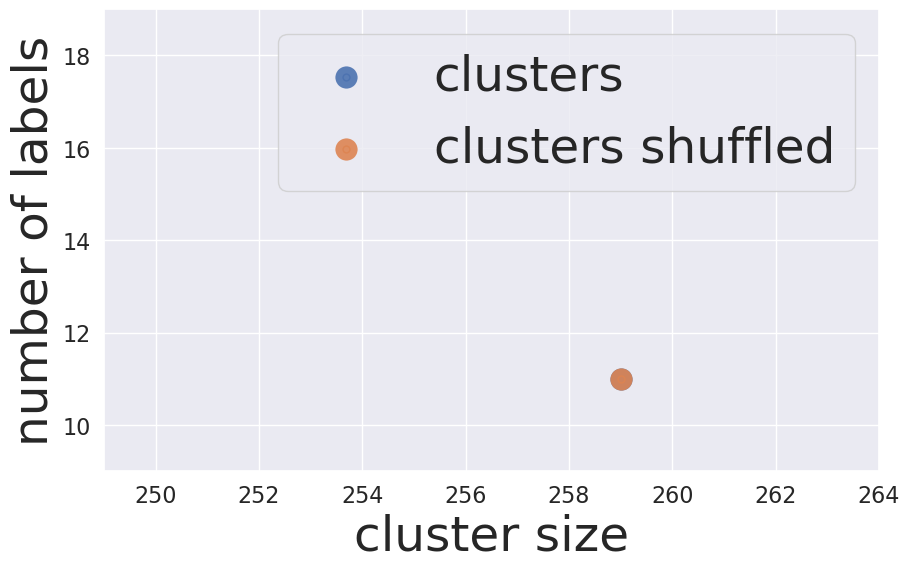

False DKFZ_subtype 6


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


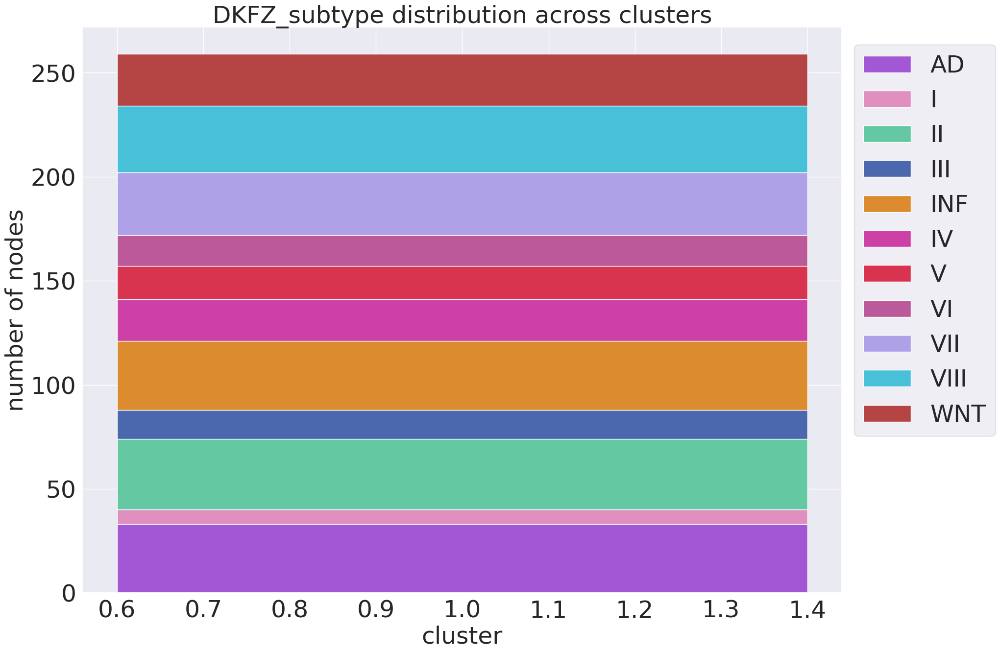

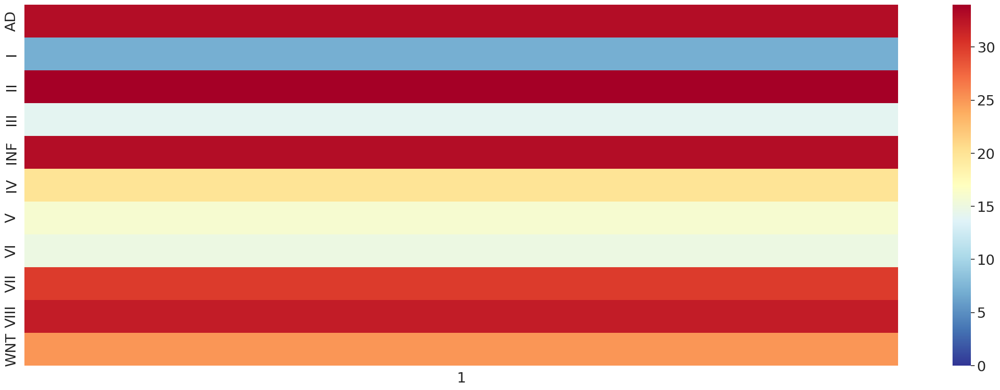

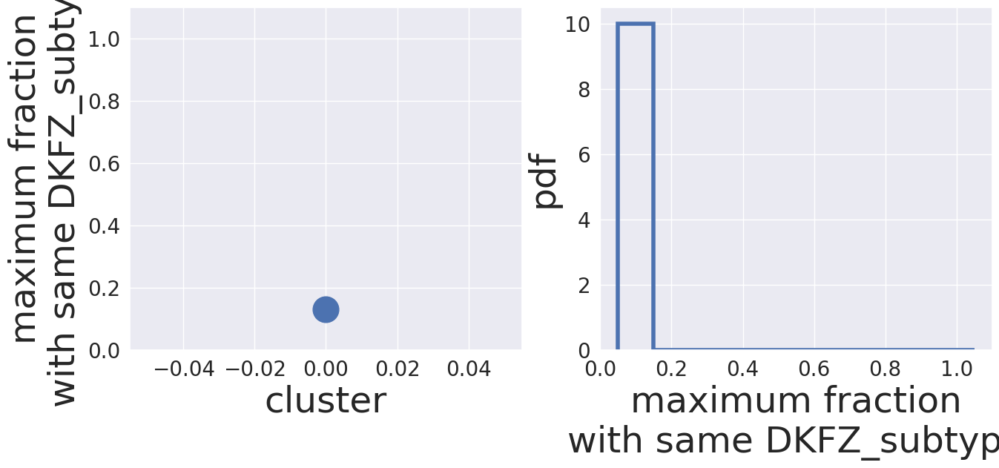

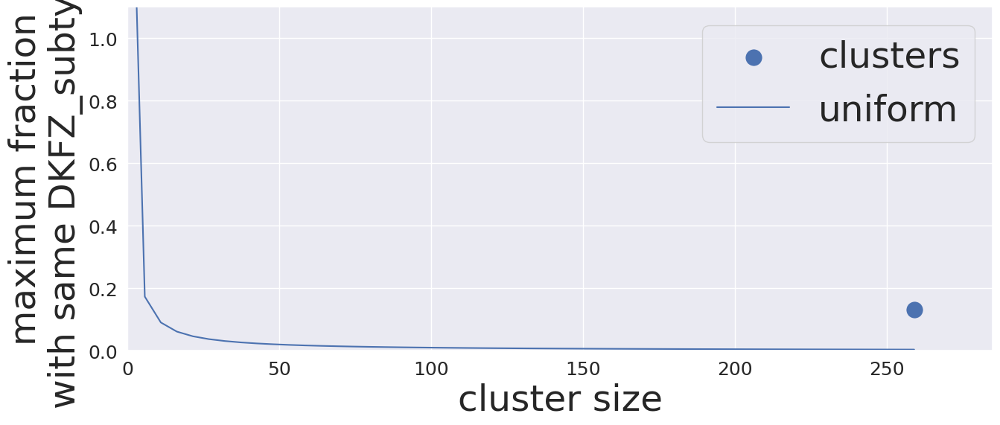

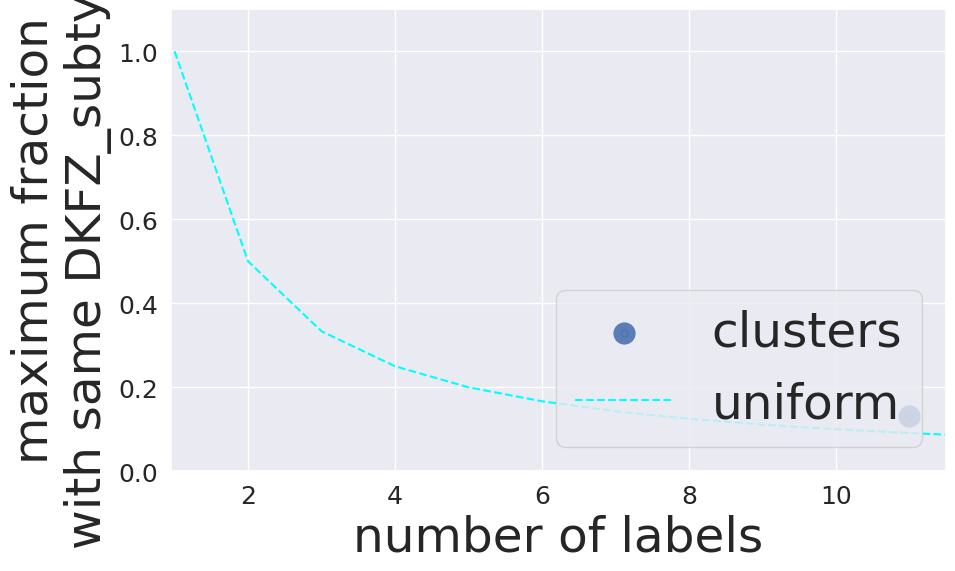

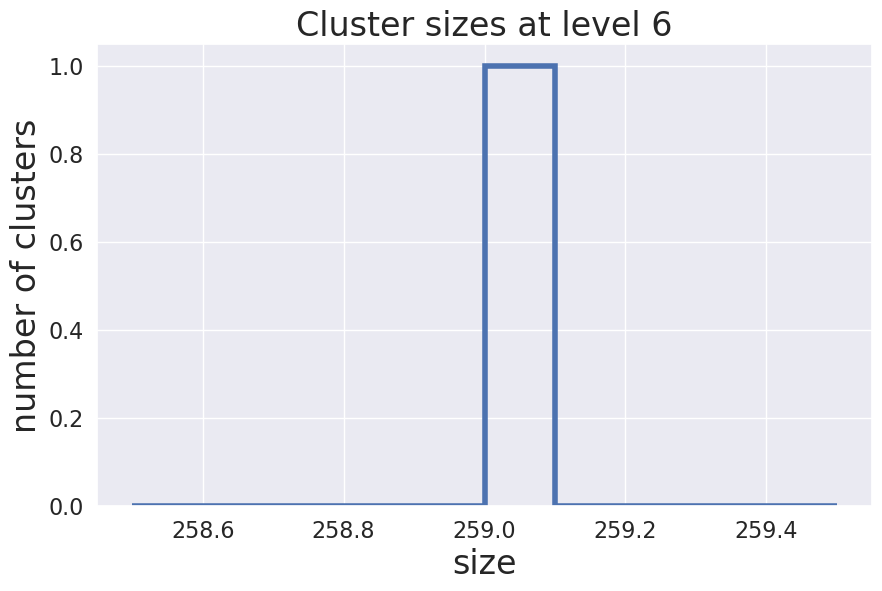

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


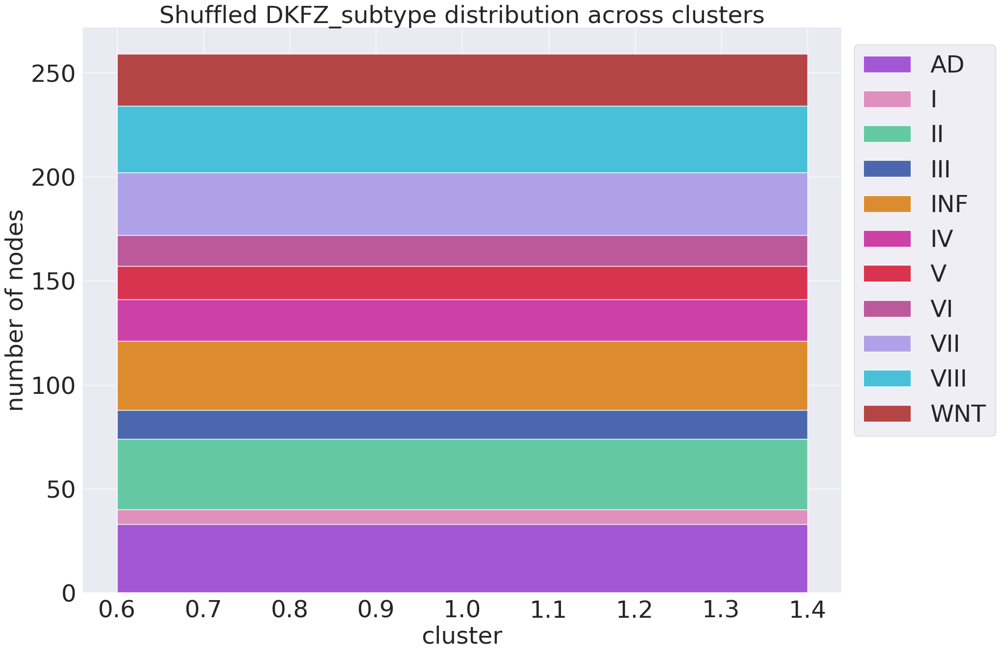

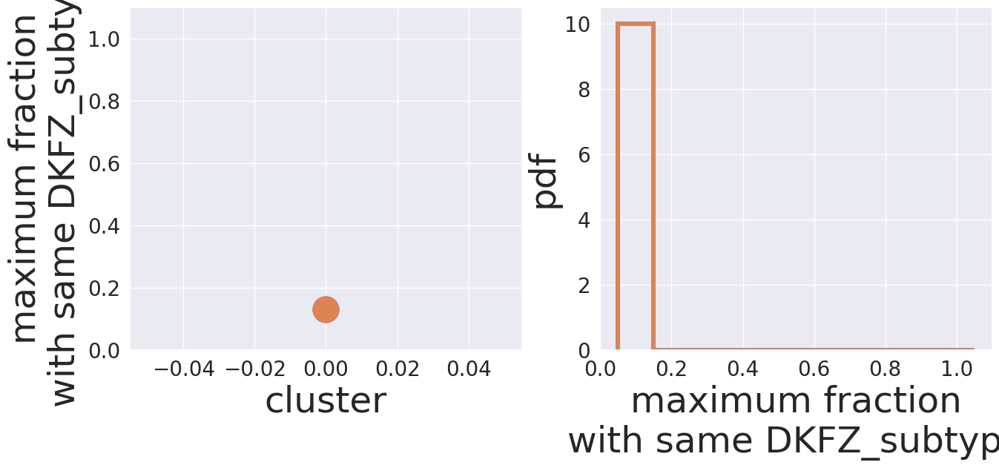

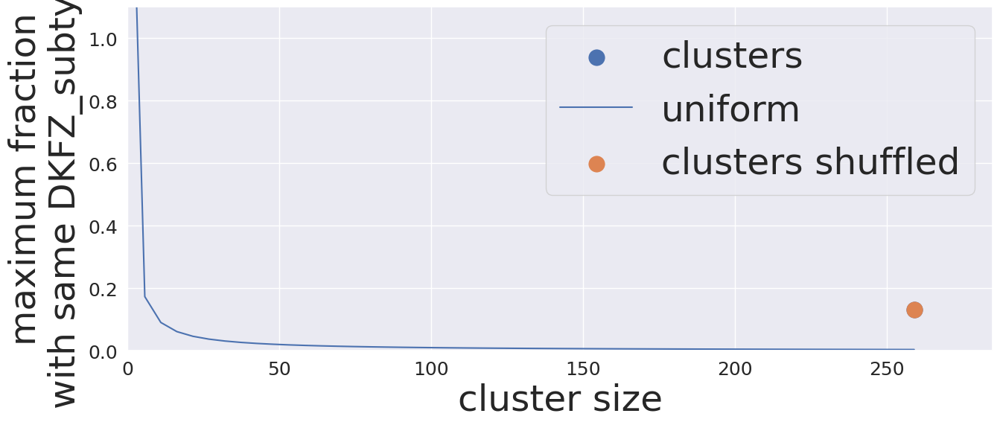

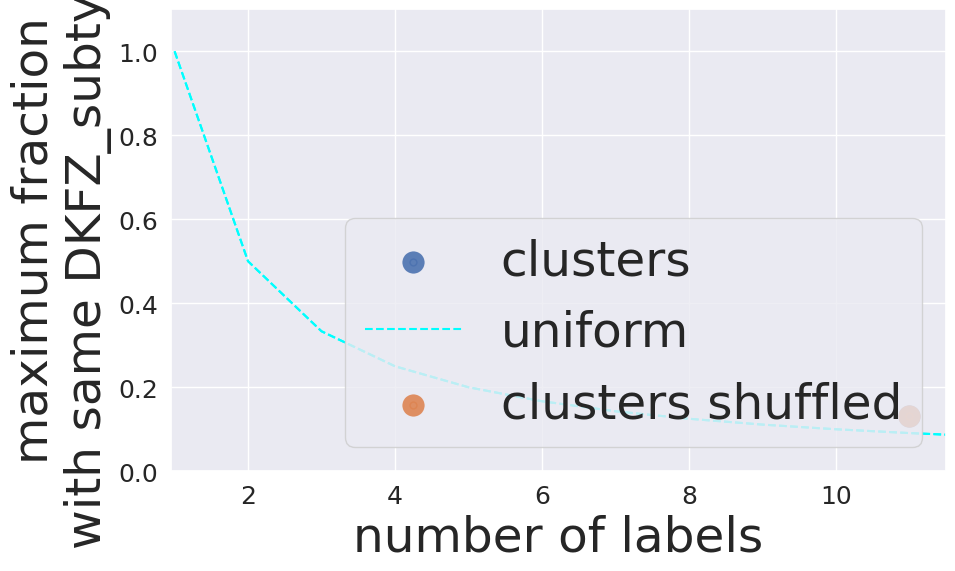

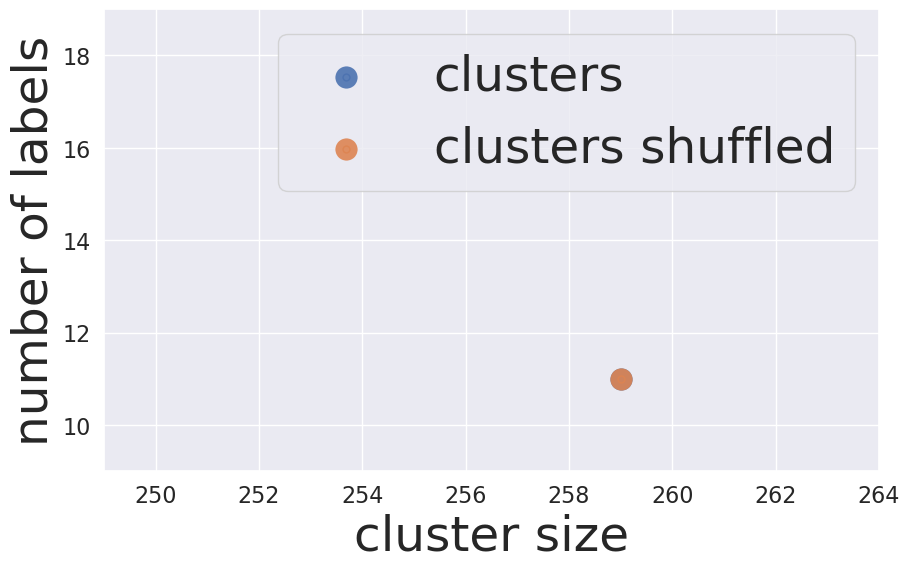

False DKFZ_subtype 5


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


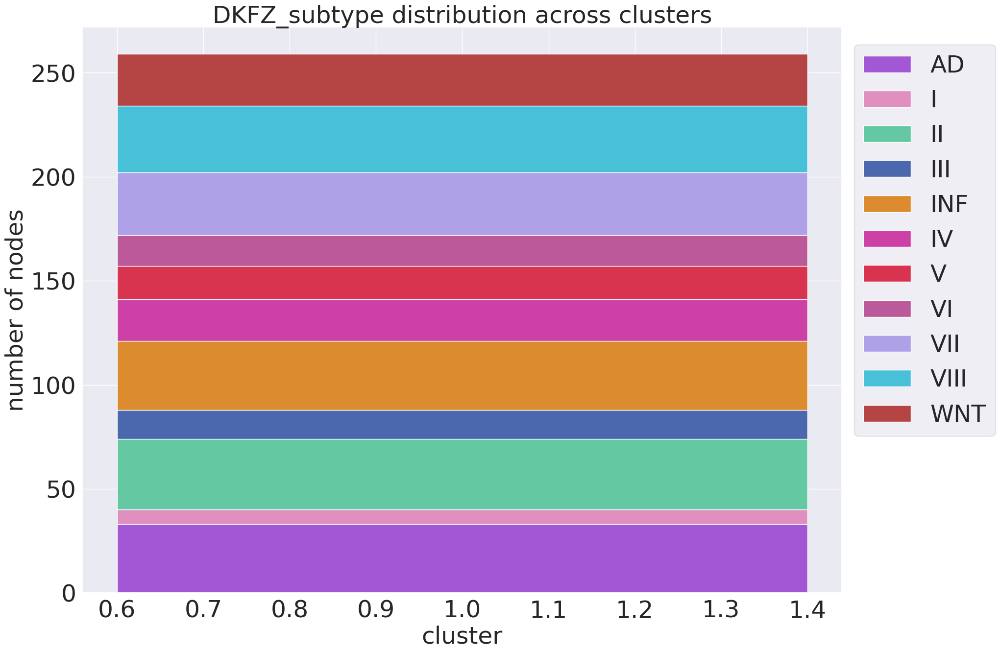

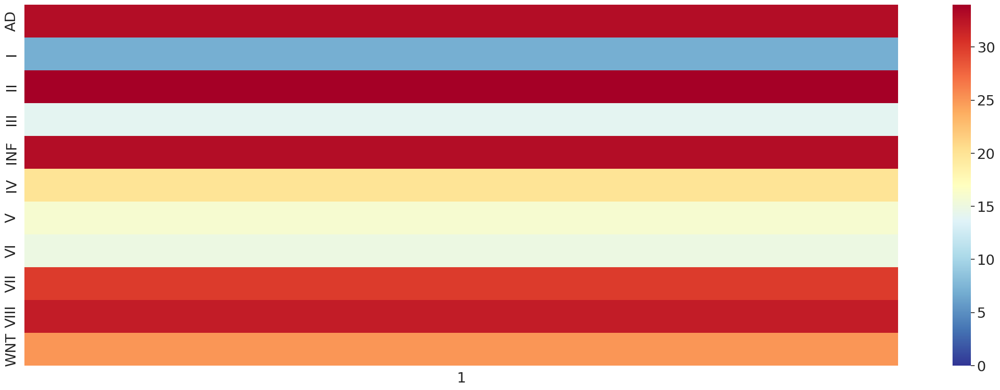

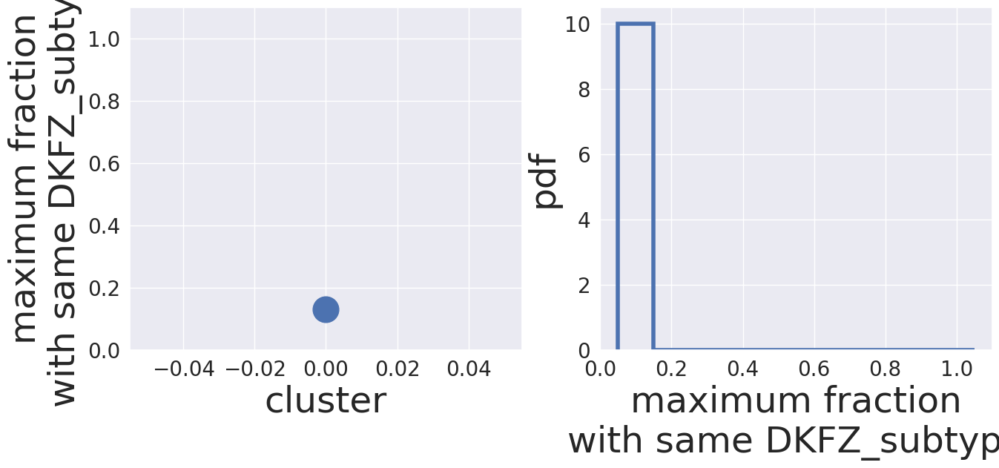

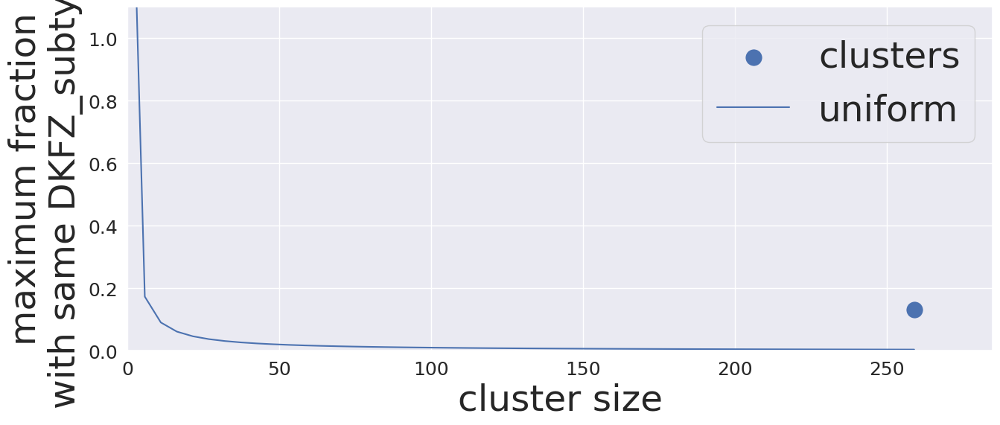

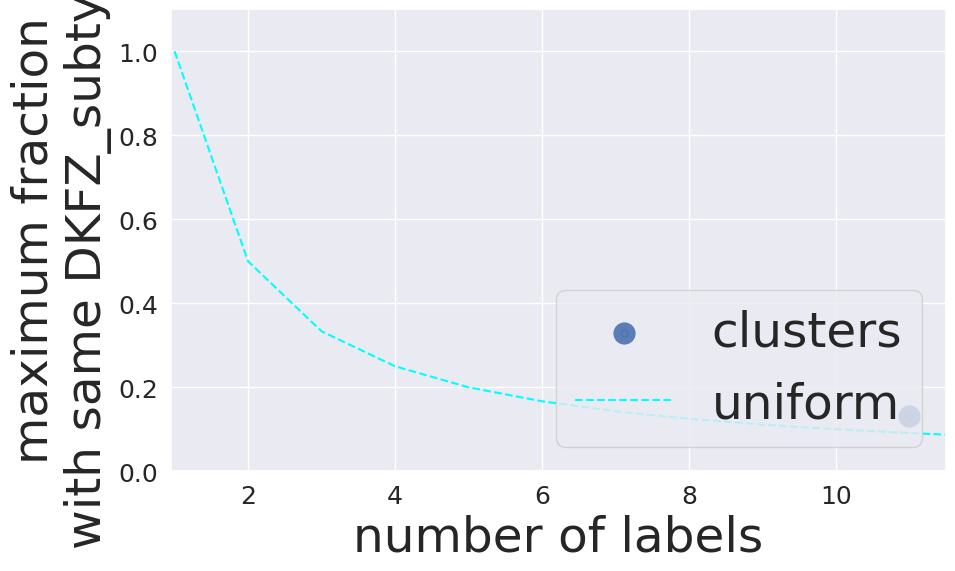

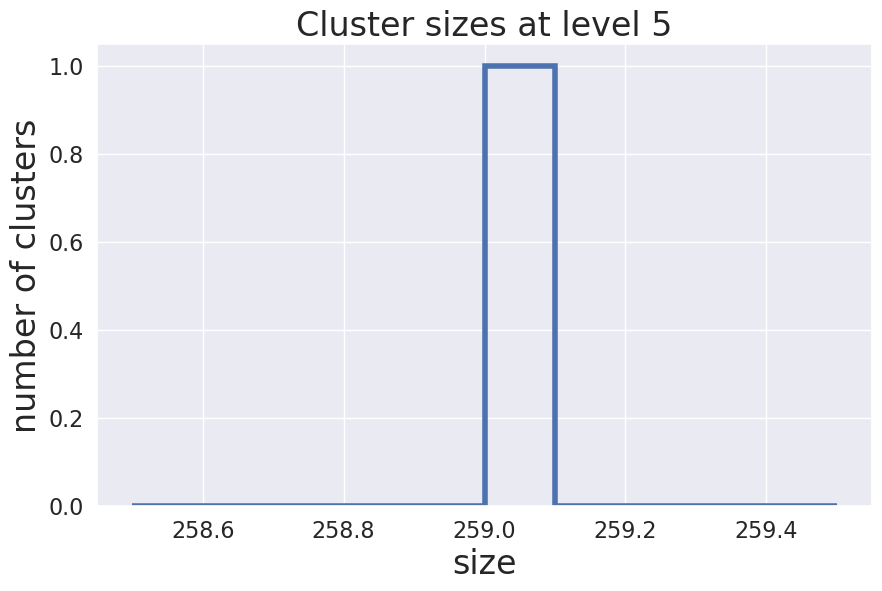

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


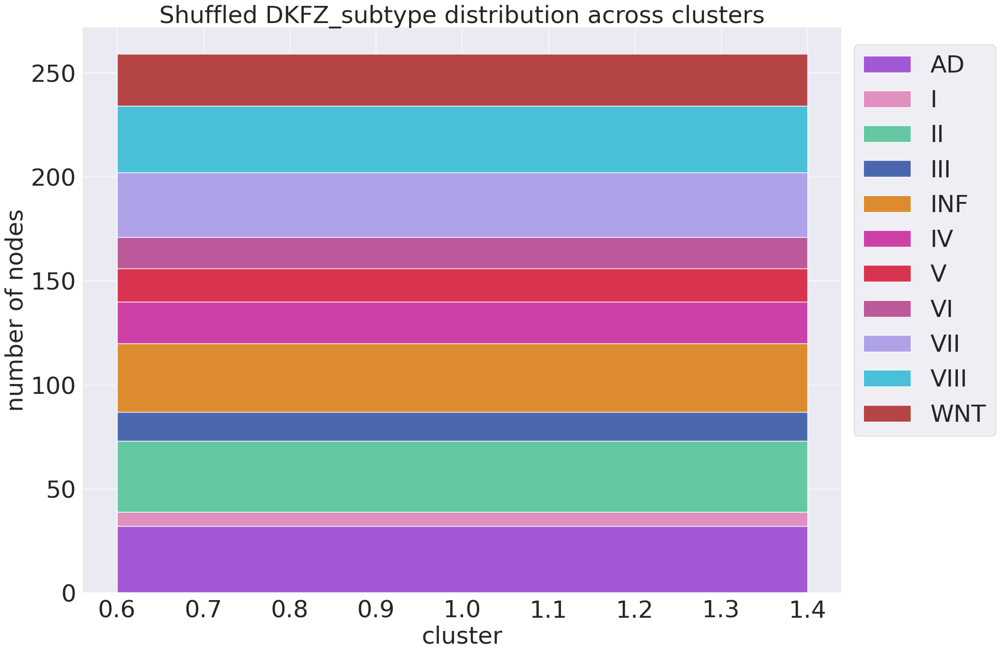

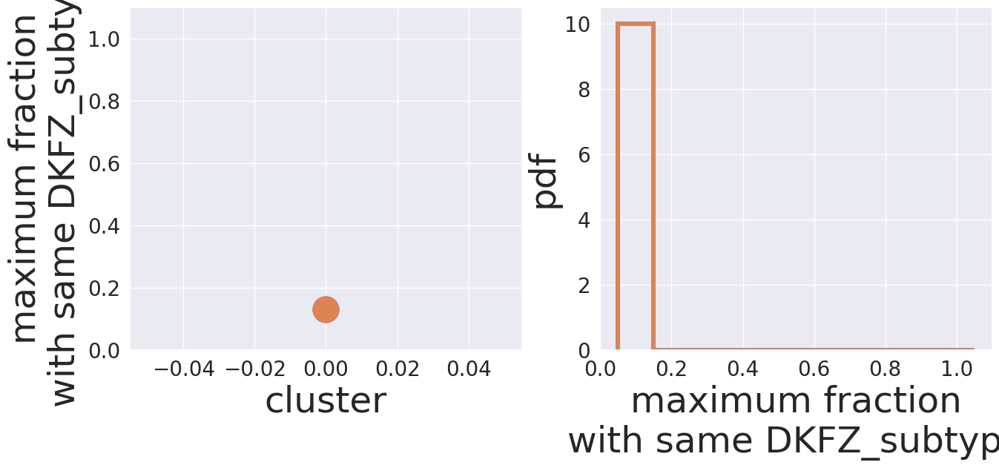

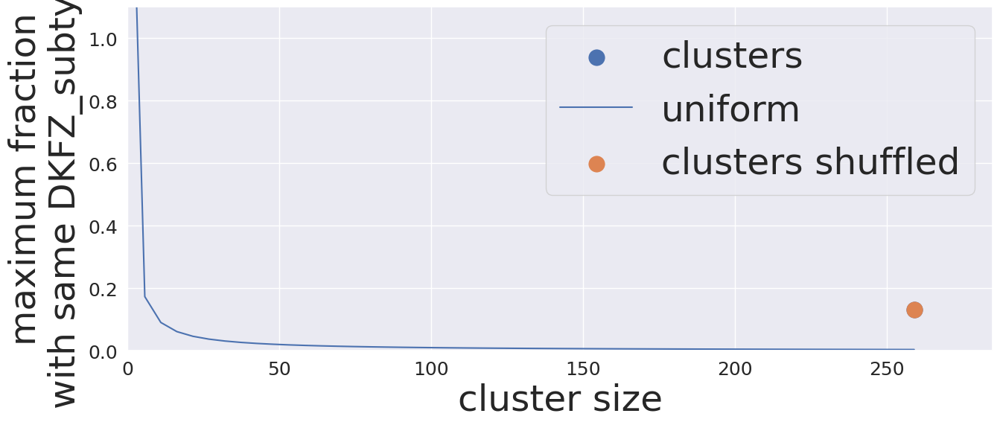

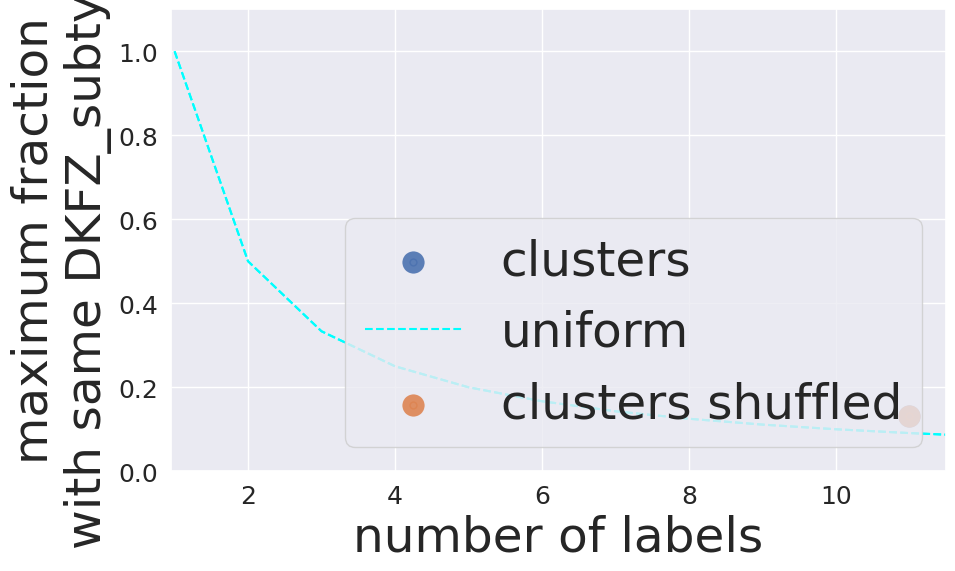

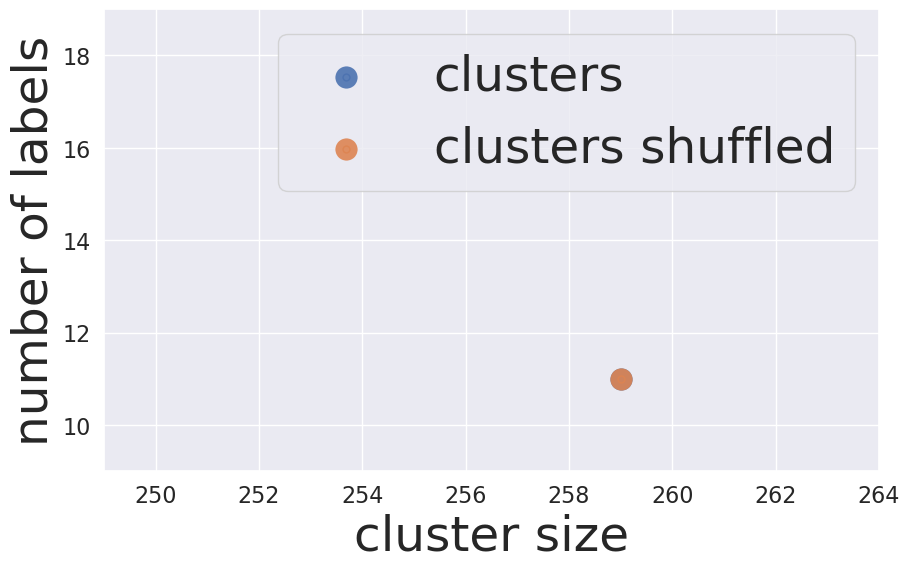

False DKFZ_subtype 4


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


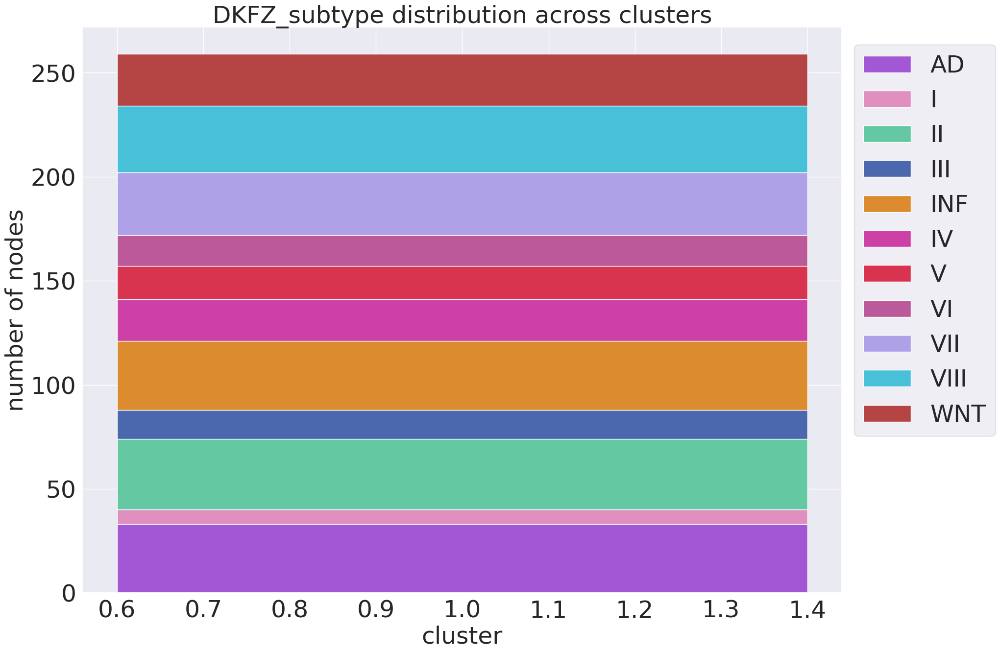

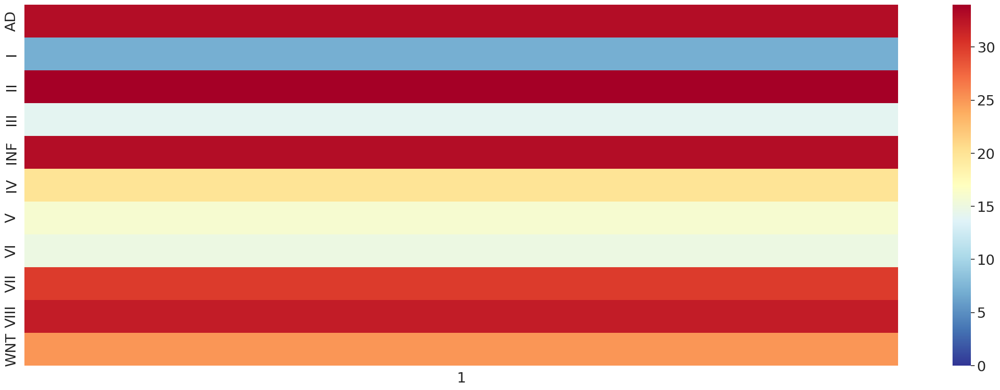

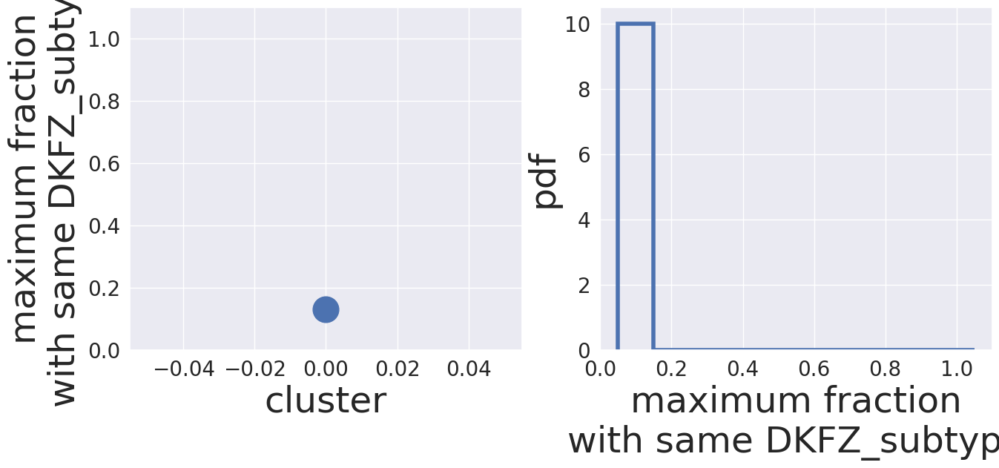

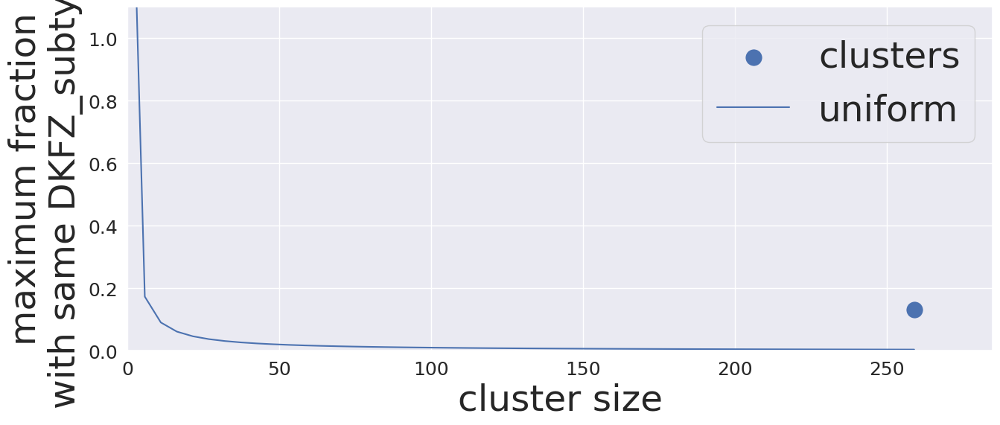

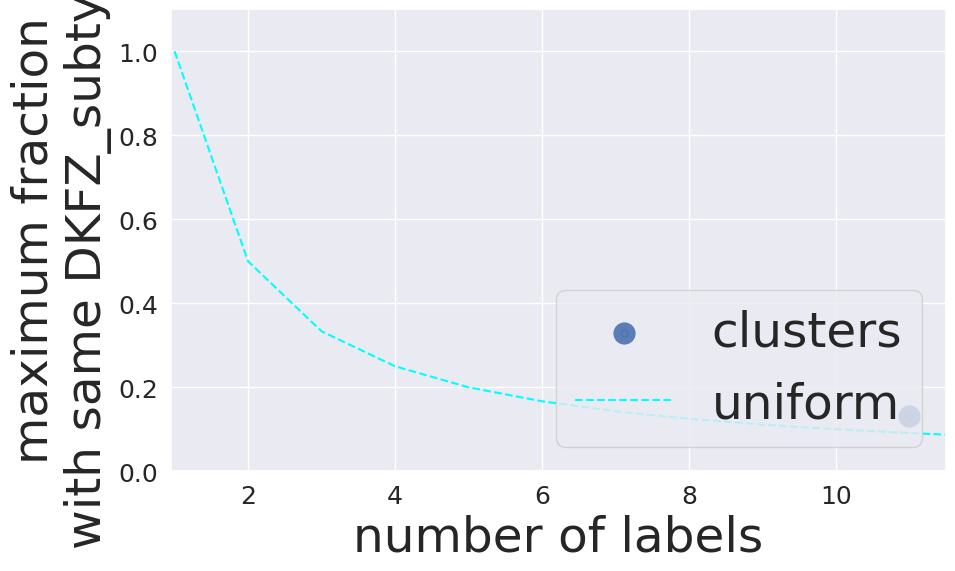

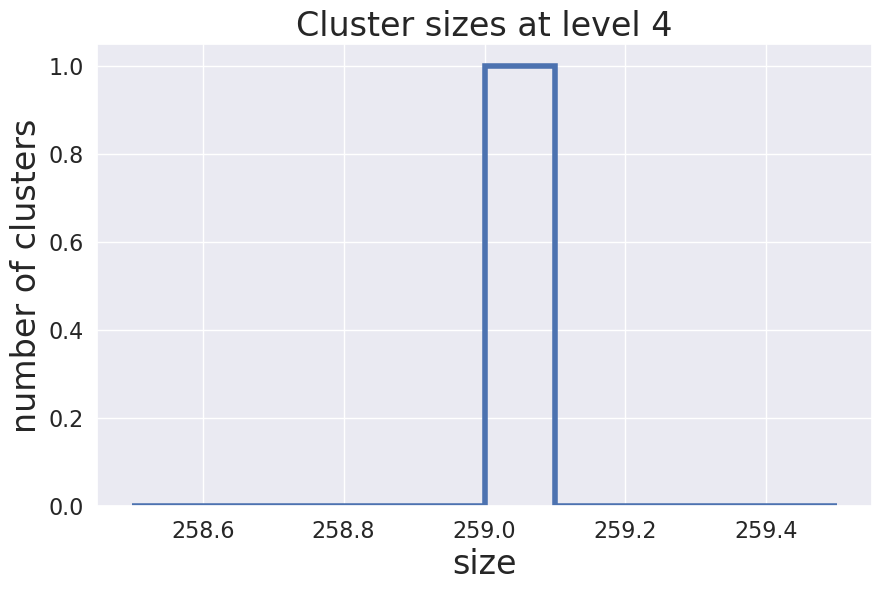

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


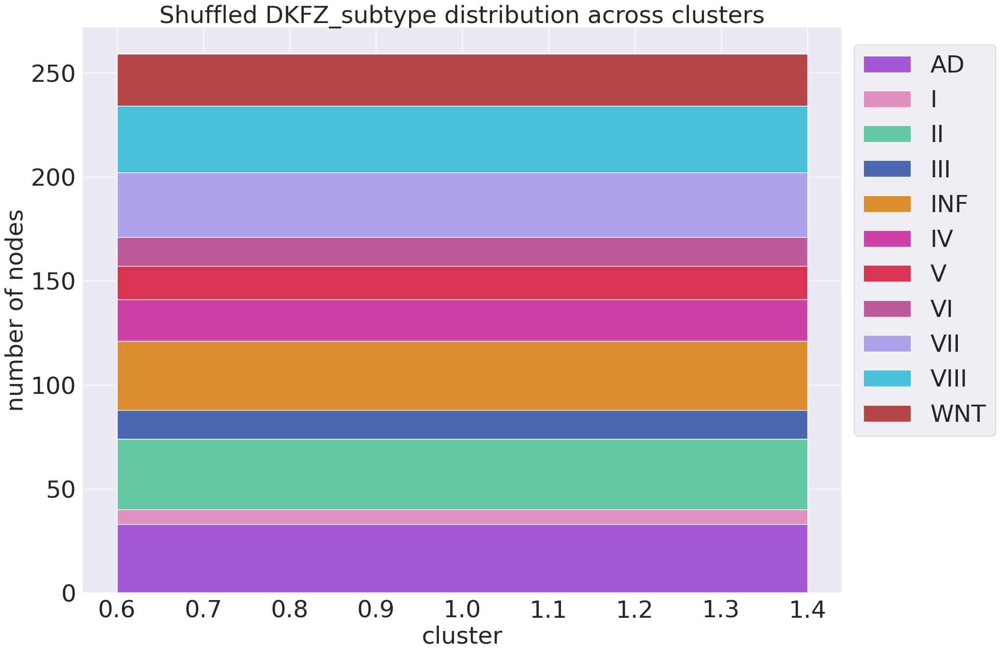

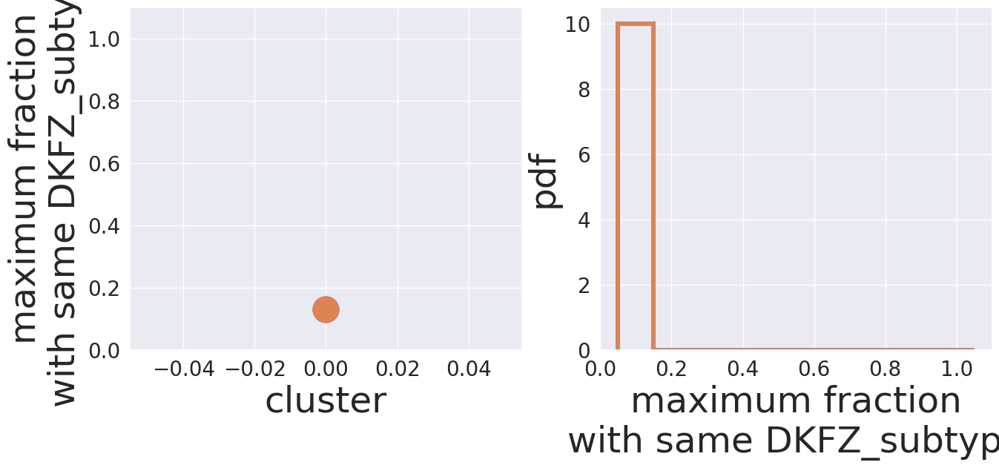

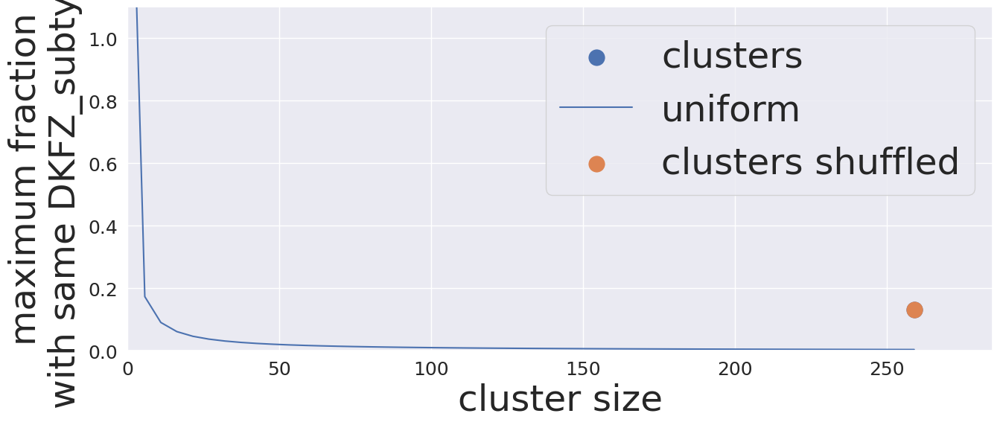

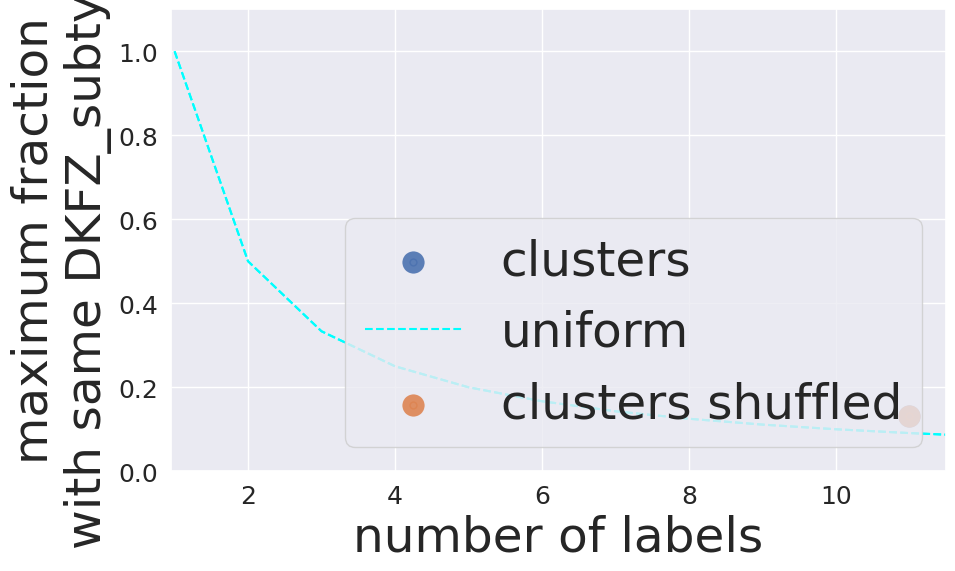

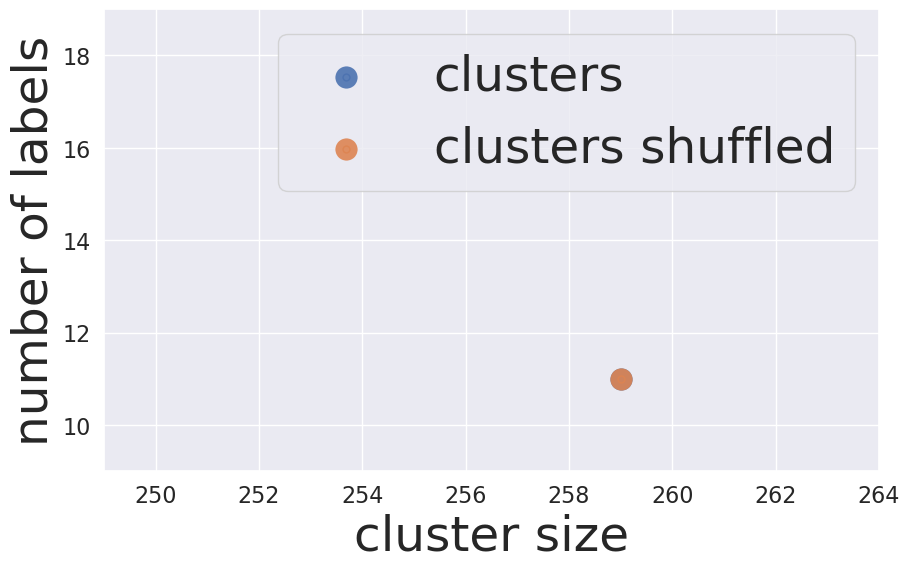

False DKFZ_subtype 3


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


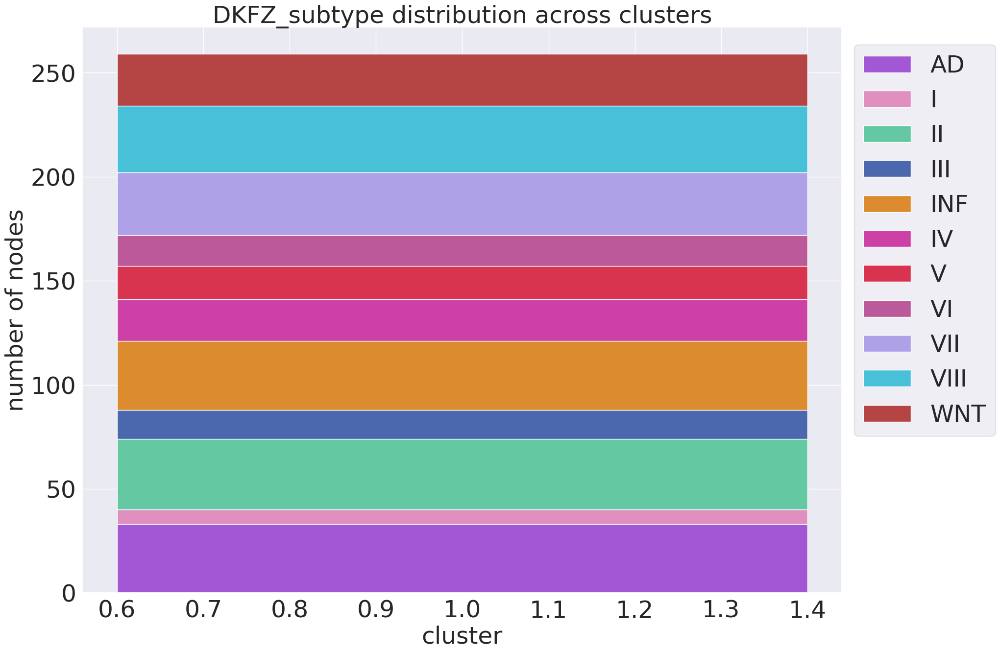

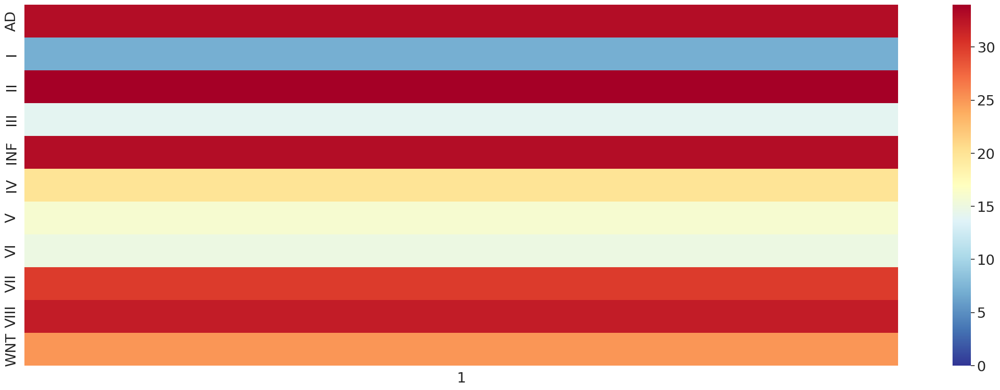

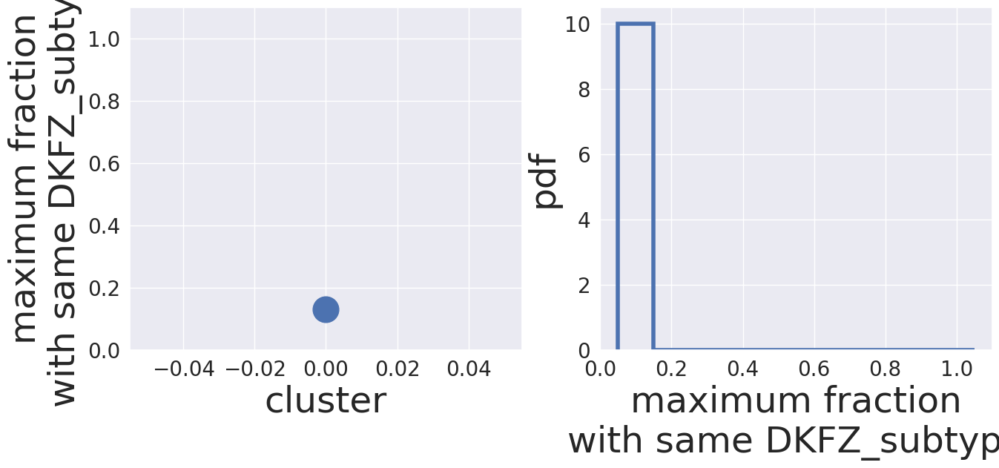

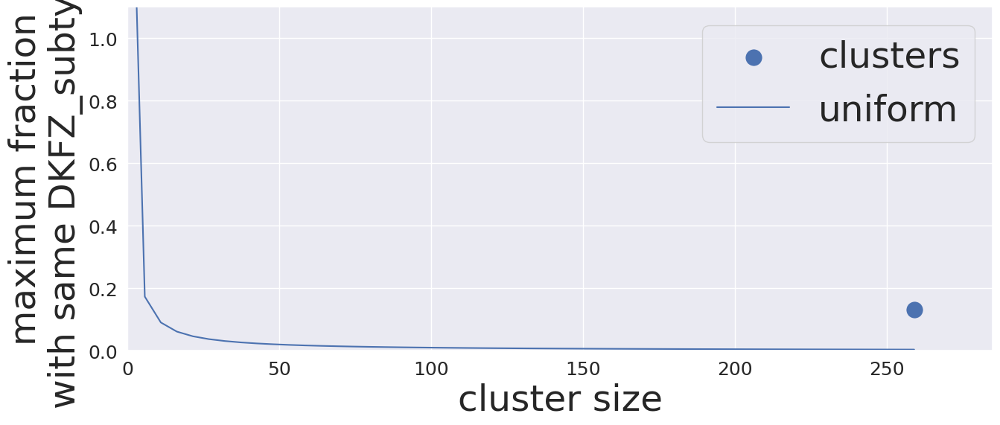

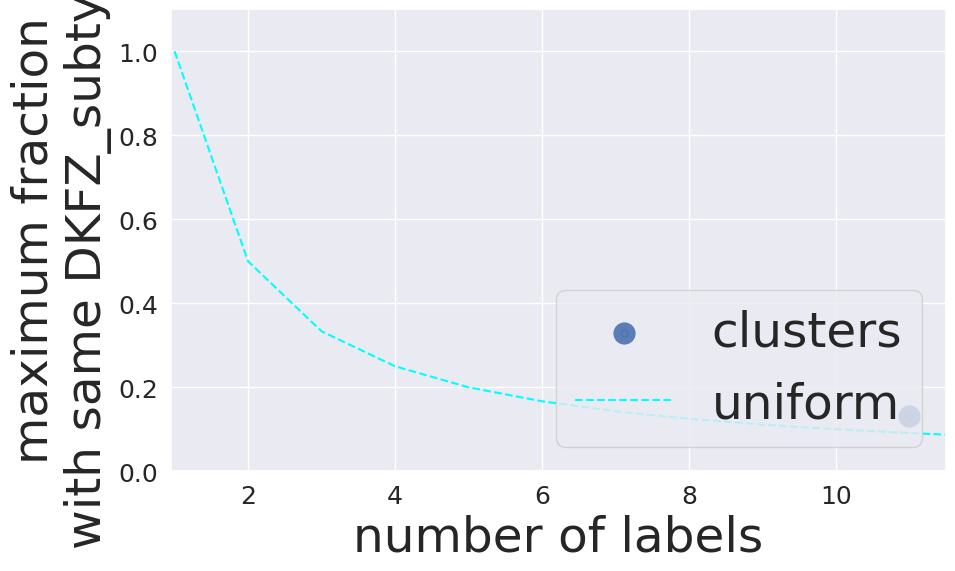

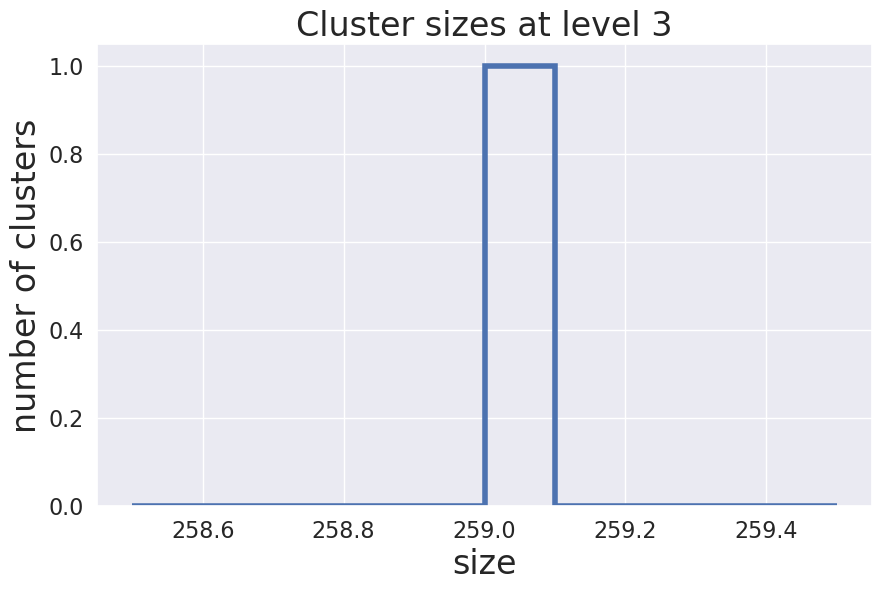

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


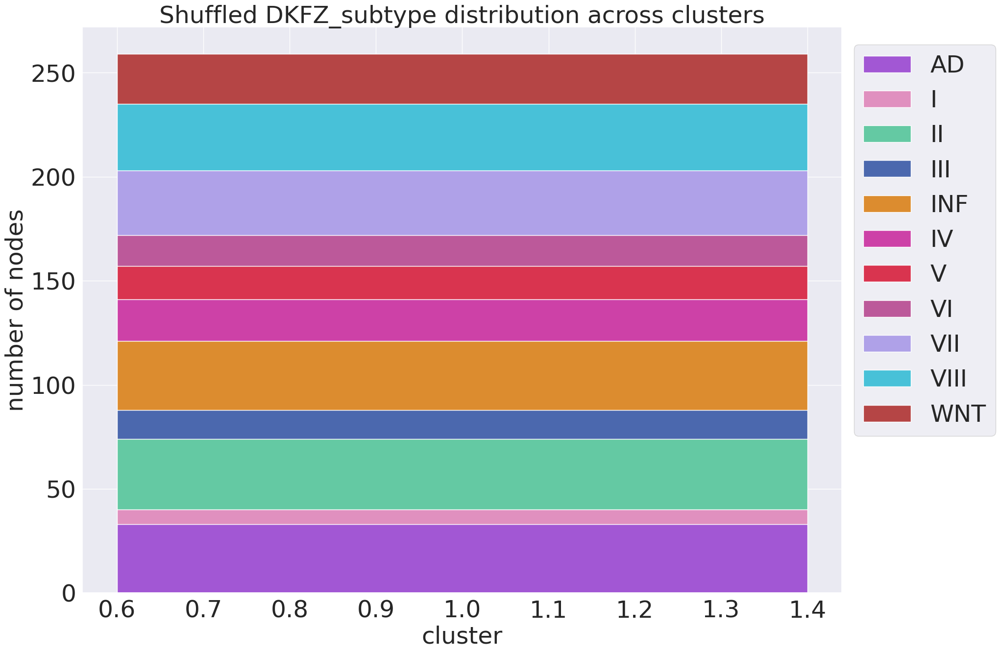

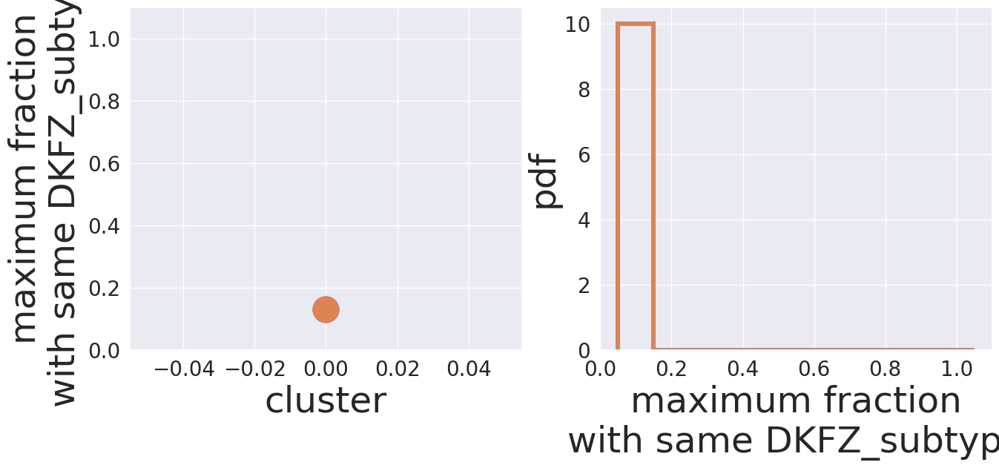

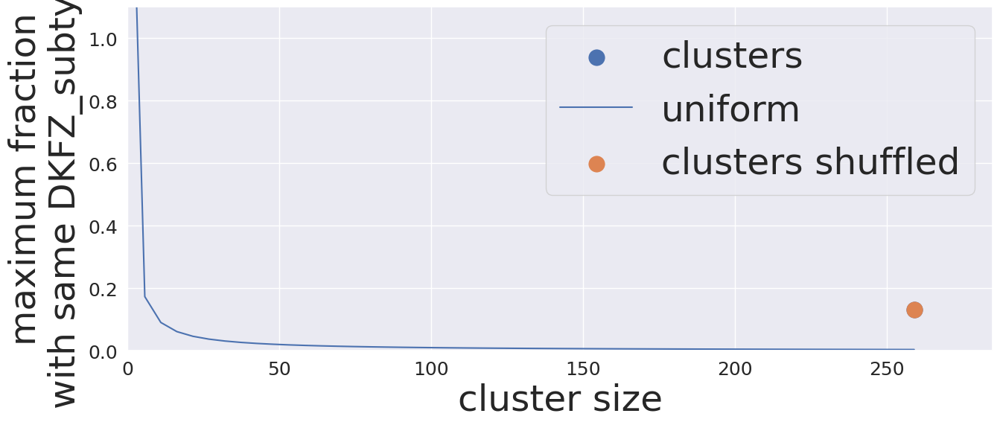

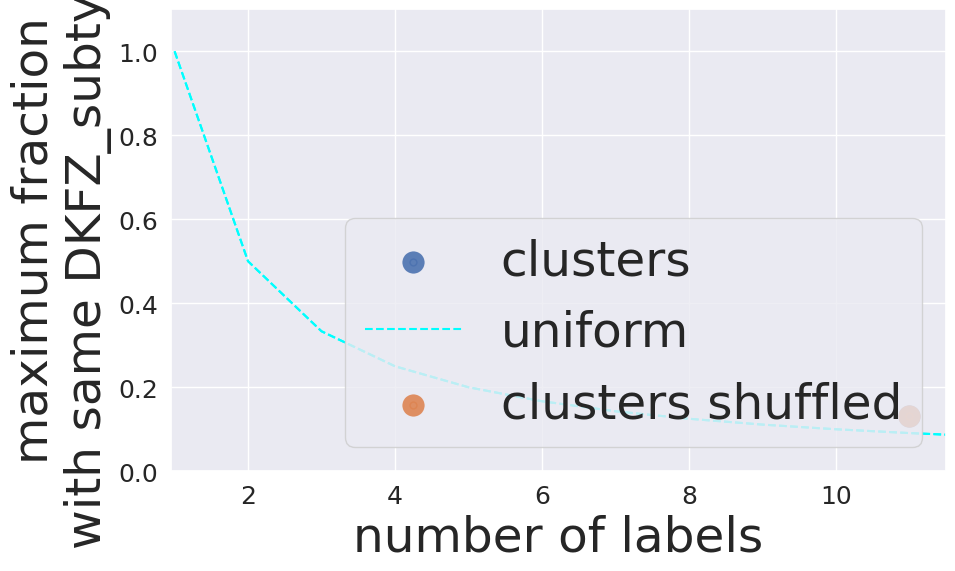

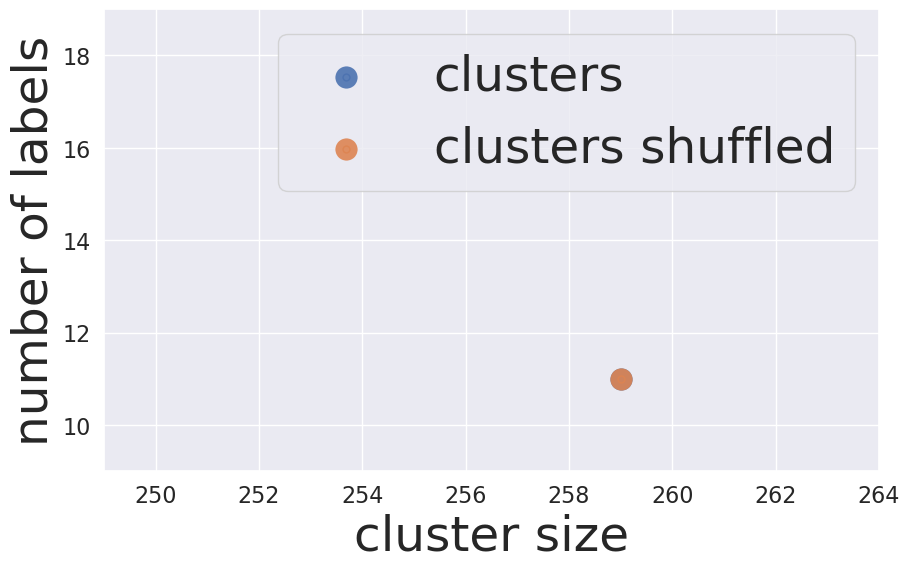

False DKFZ_subtype 2


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


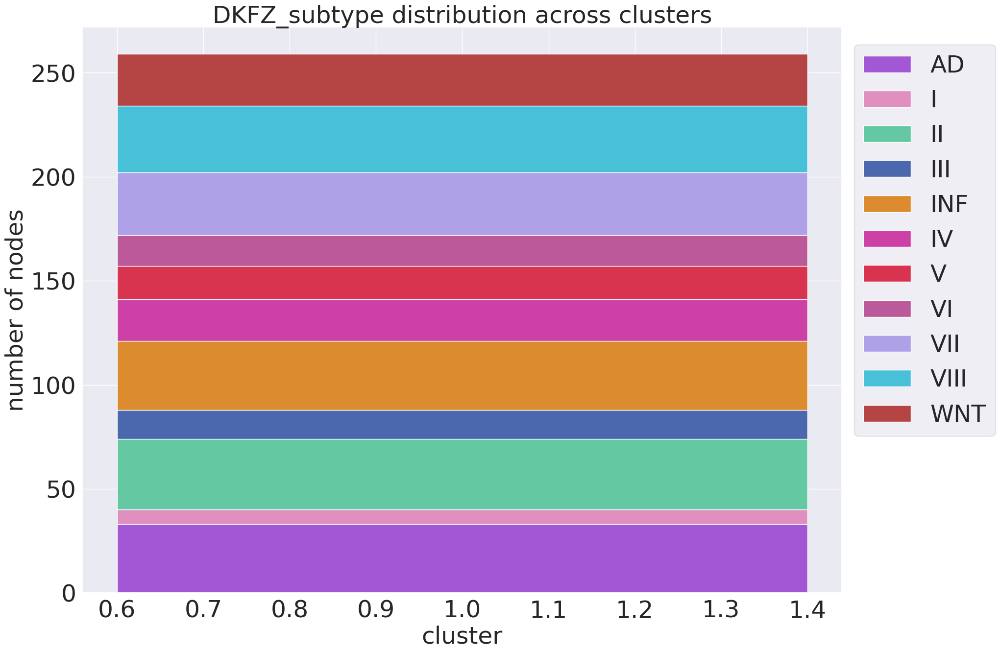

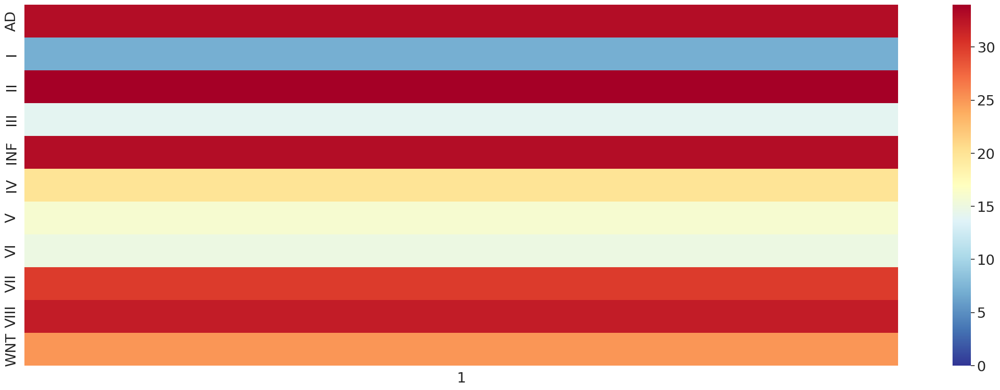

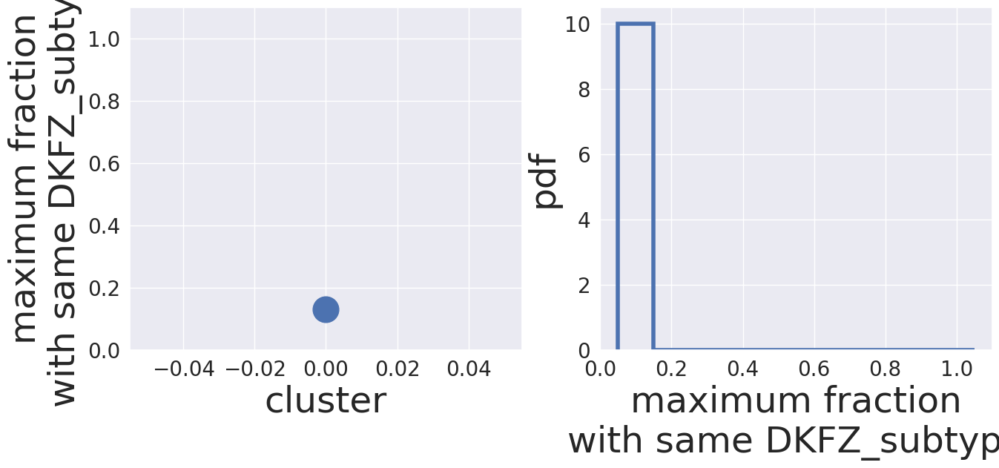

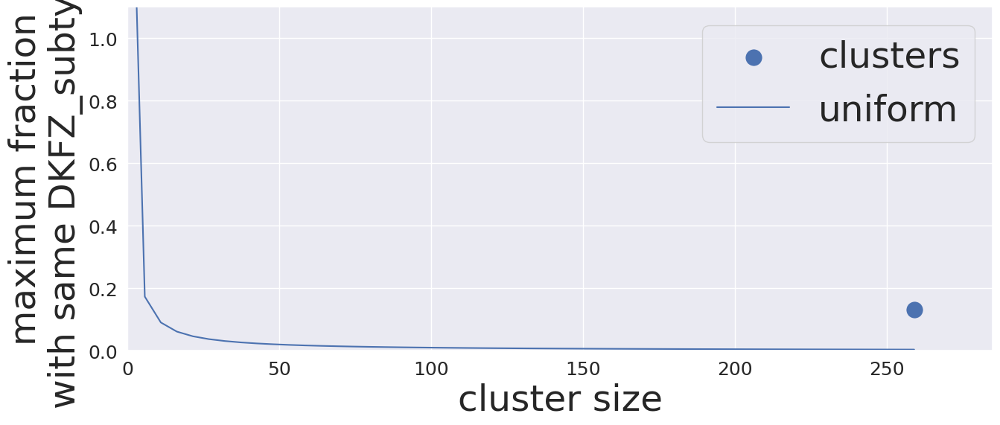

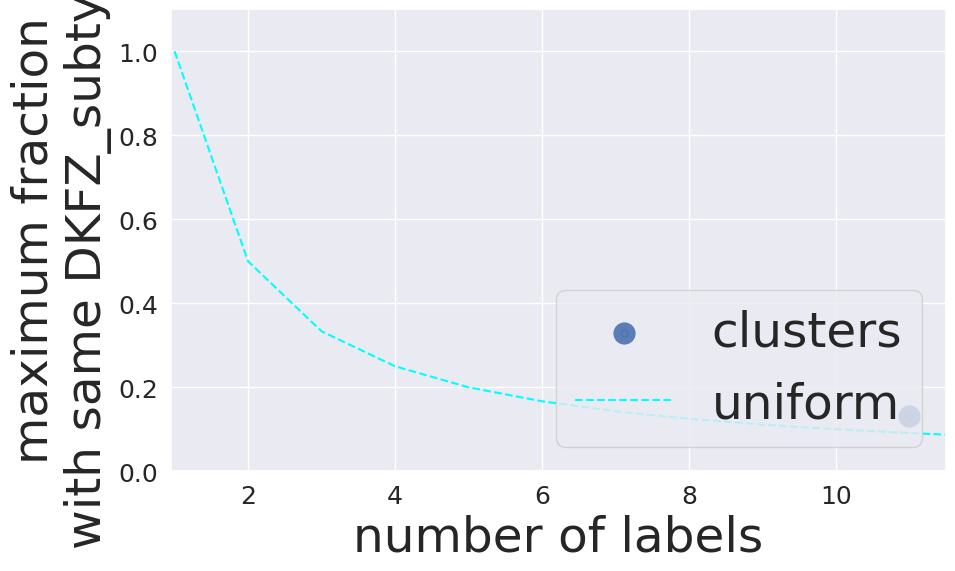

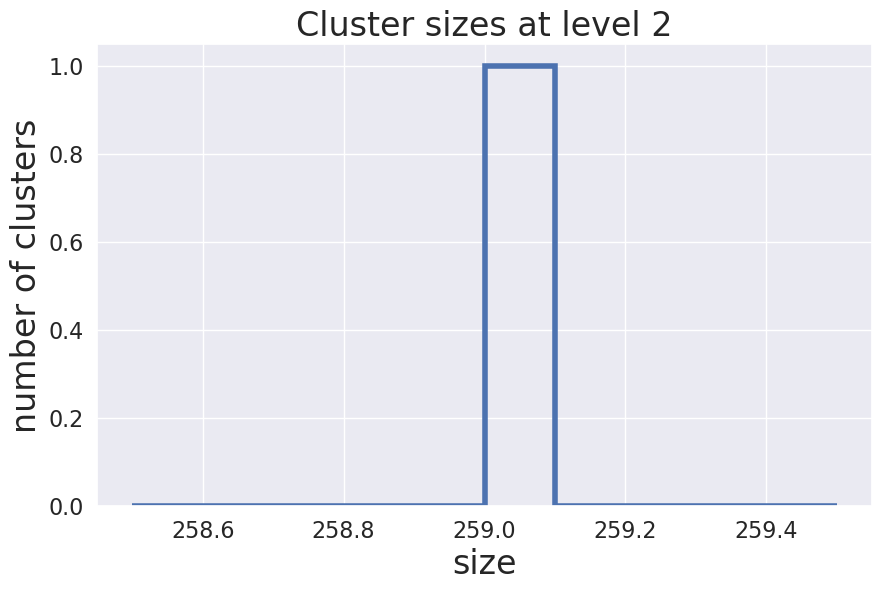

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


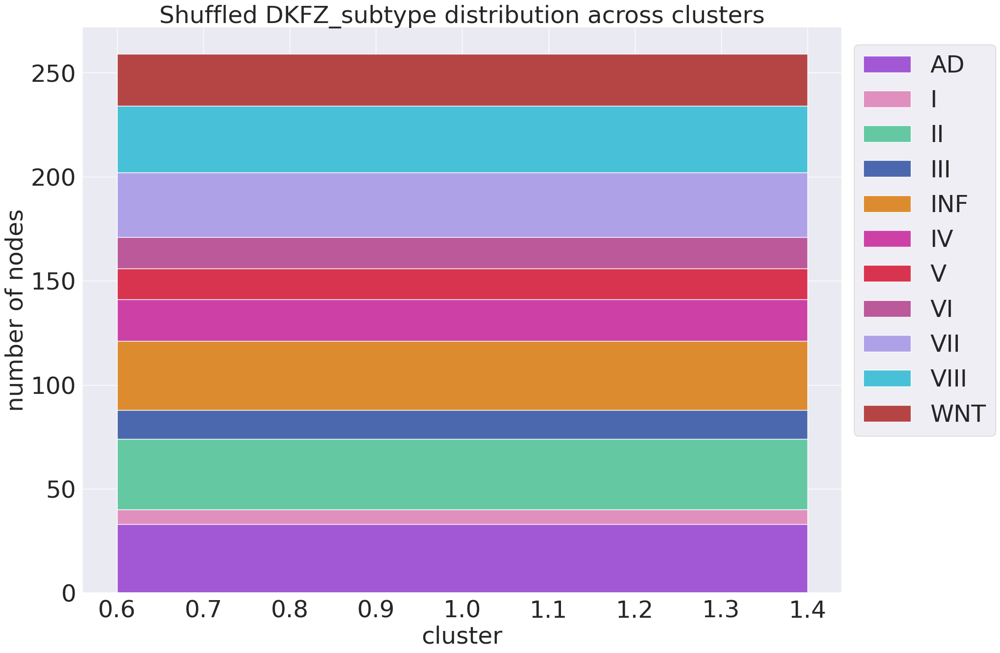

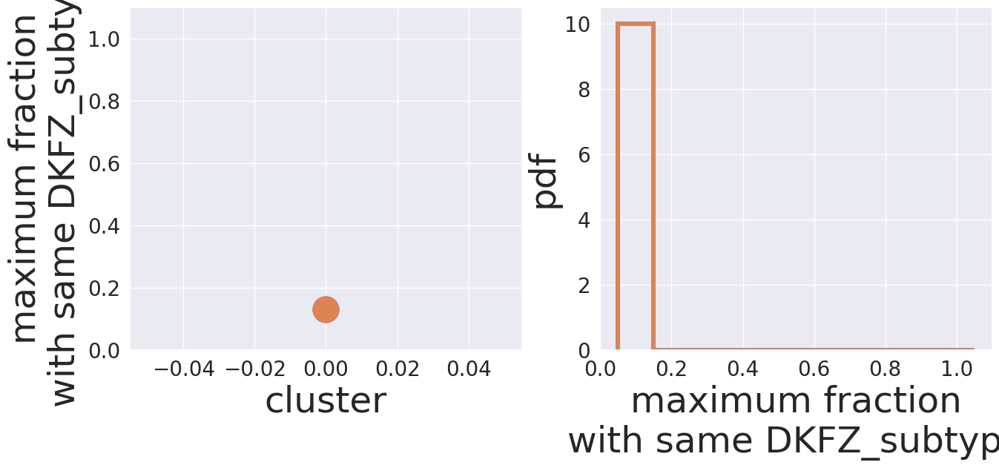

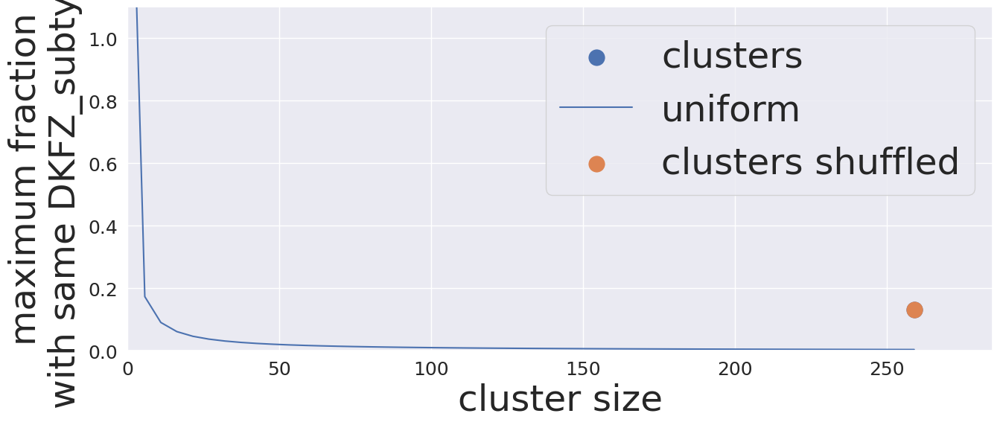

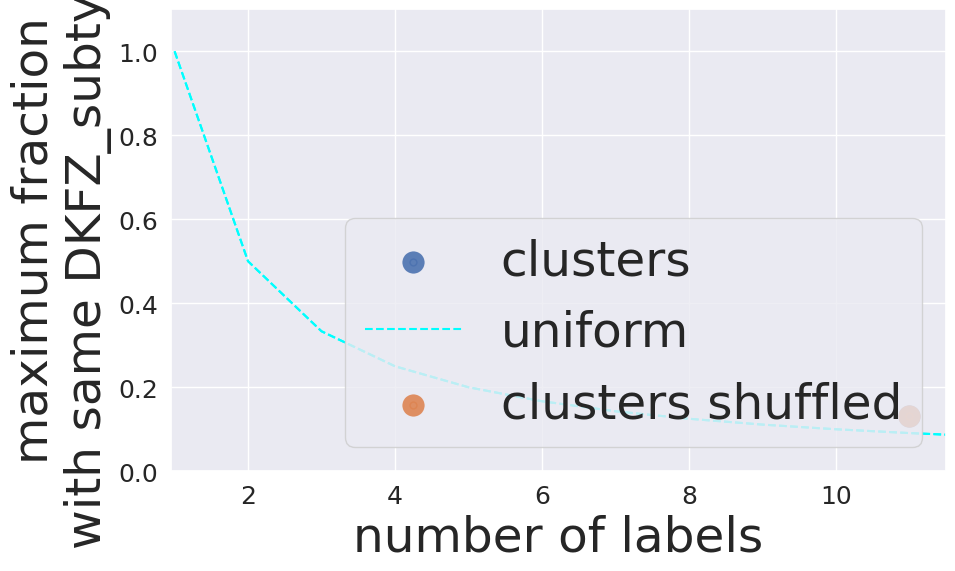

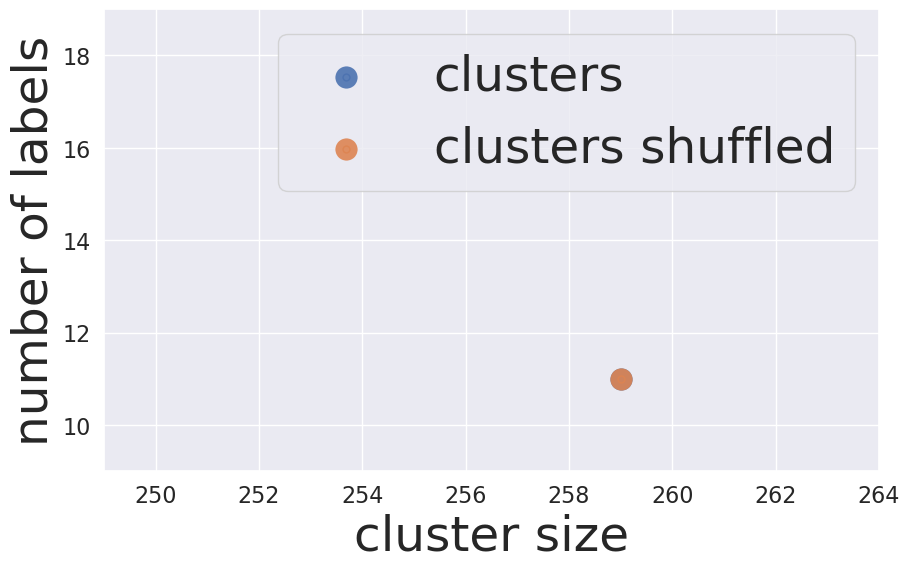

False DKFZ_subtype 1


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


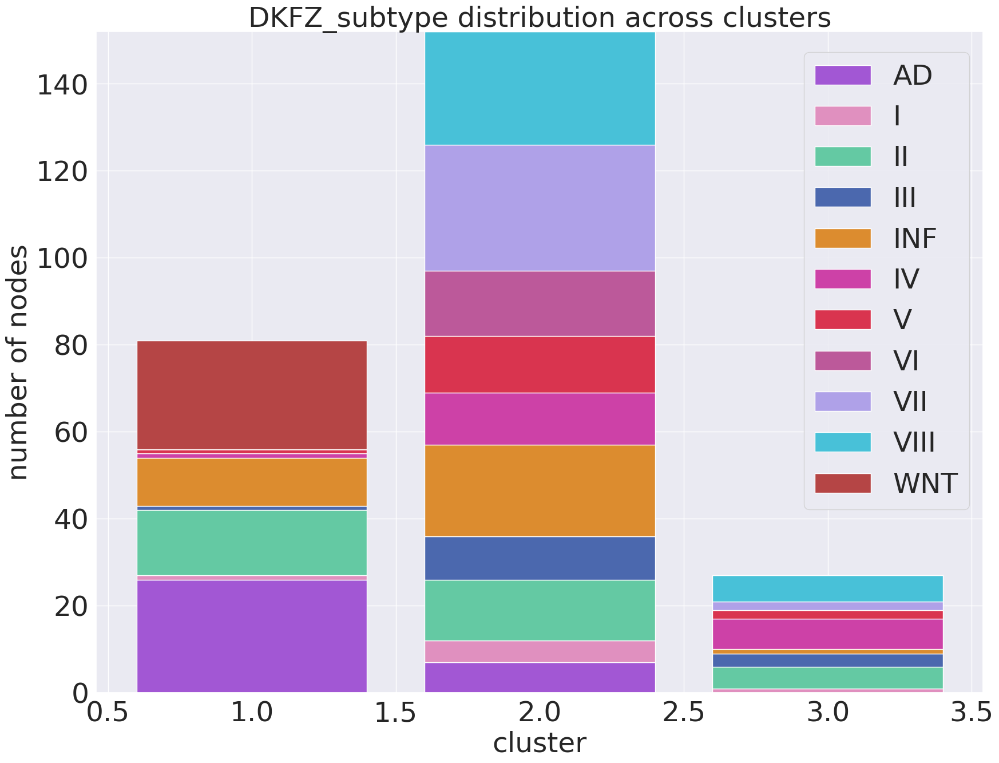

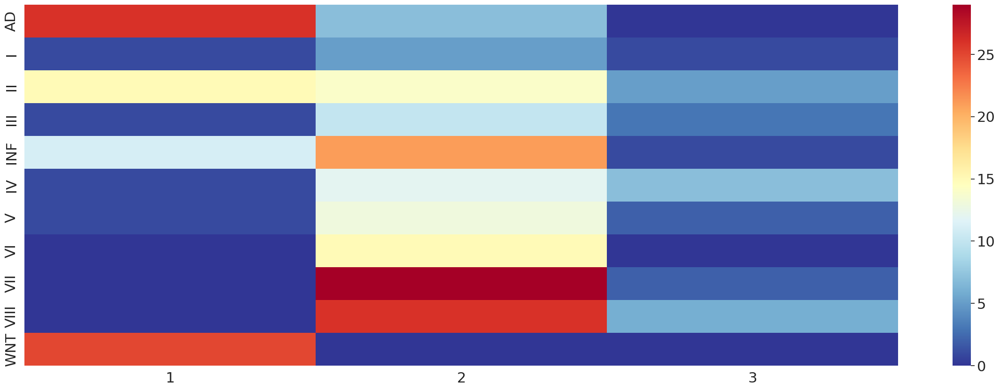

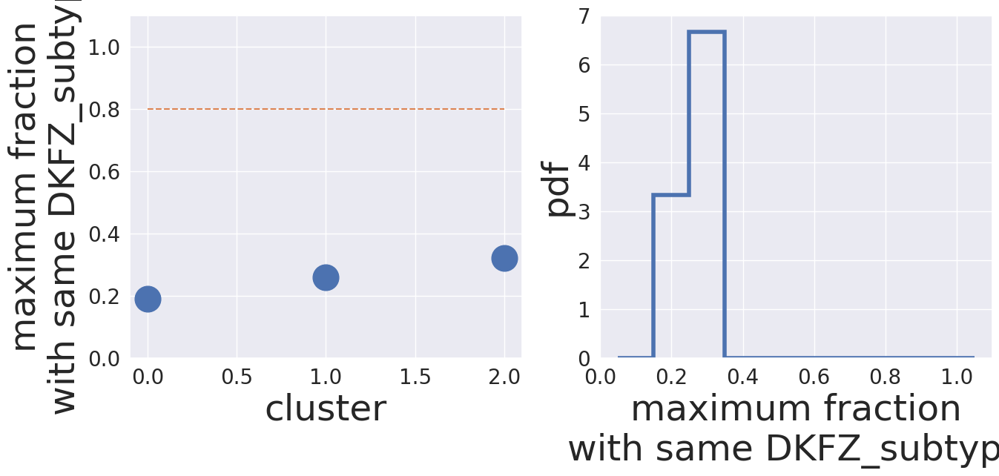

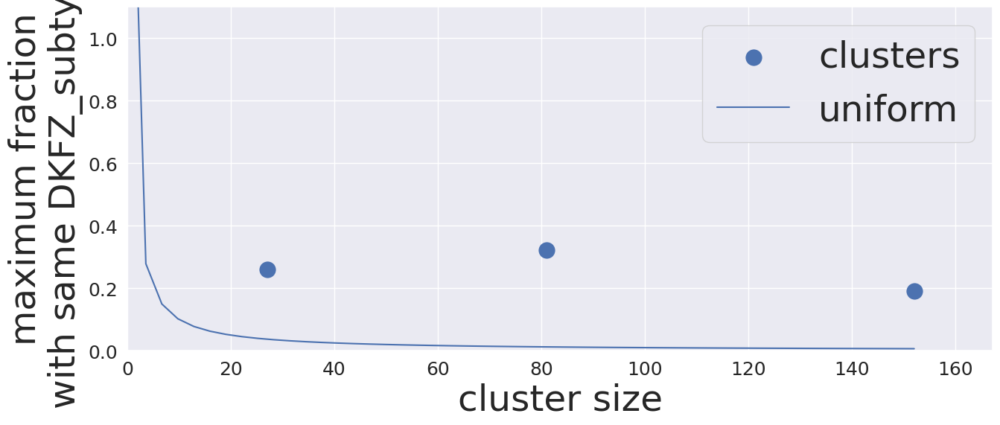

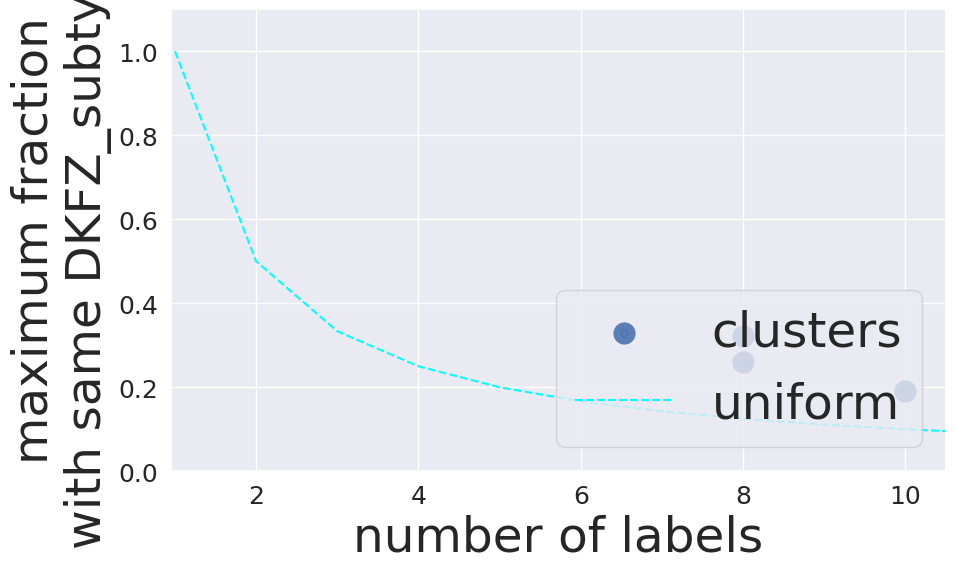

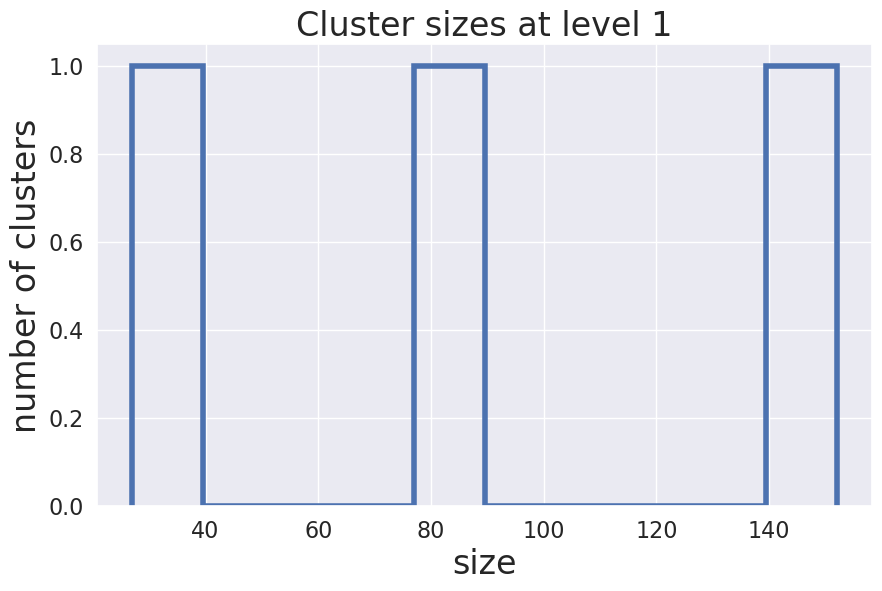

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


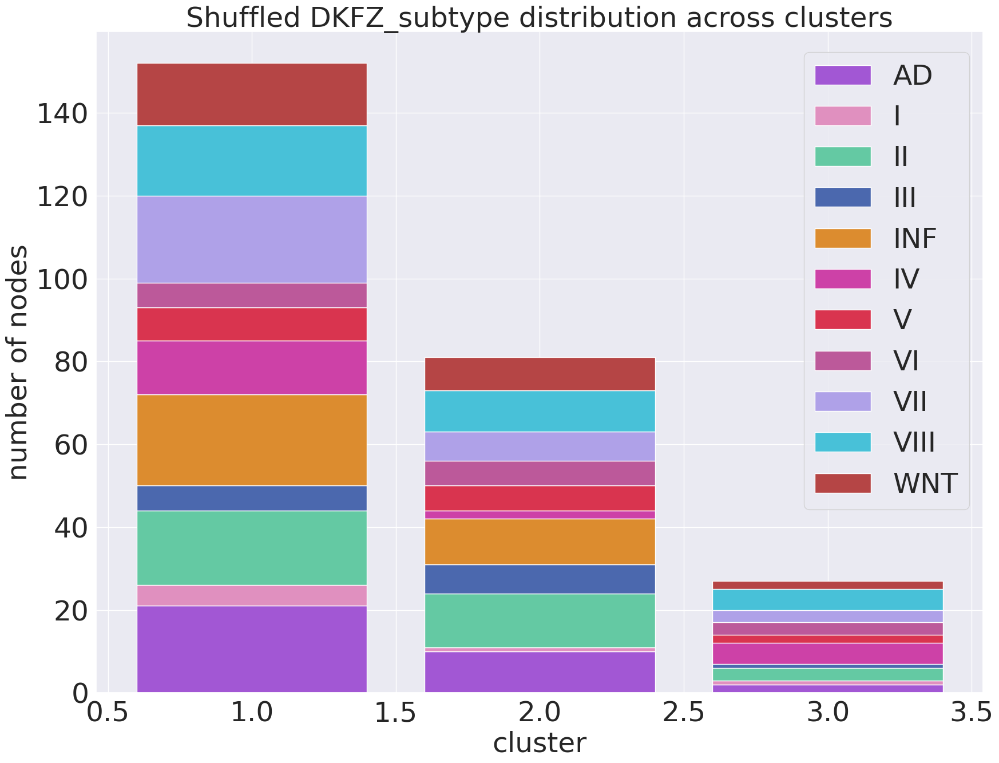

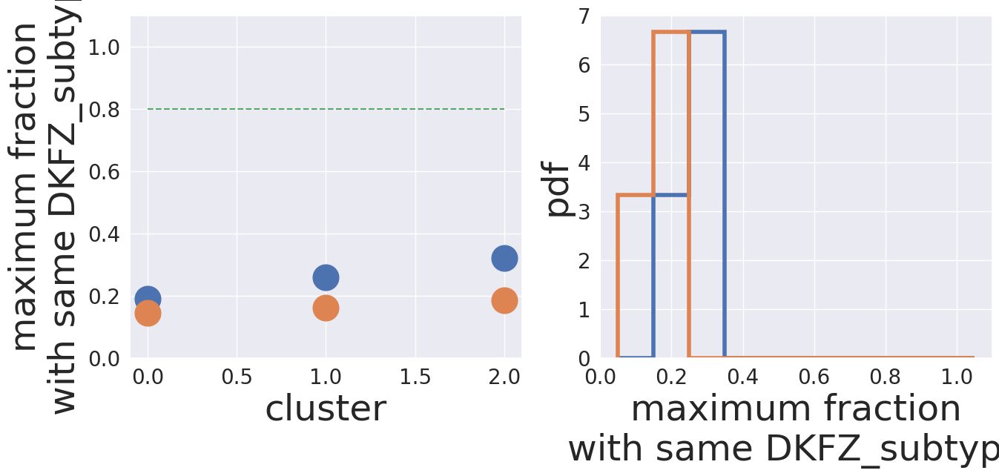

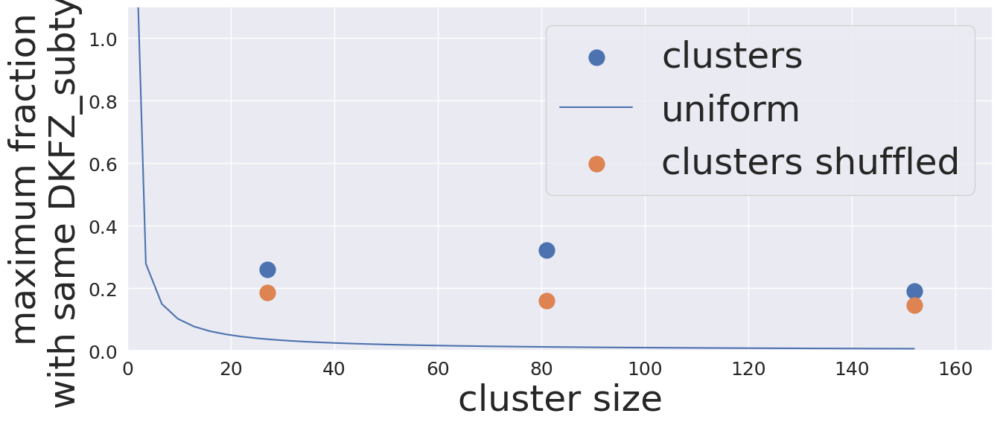

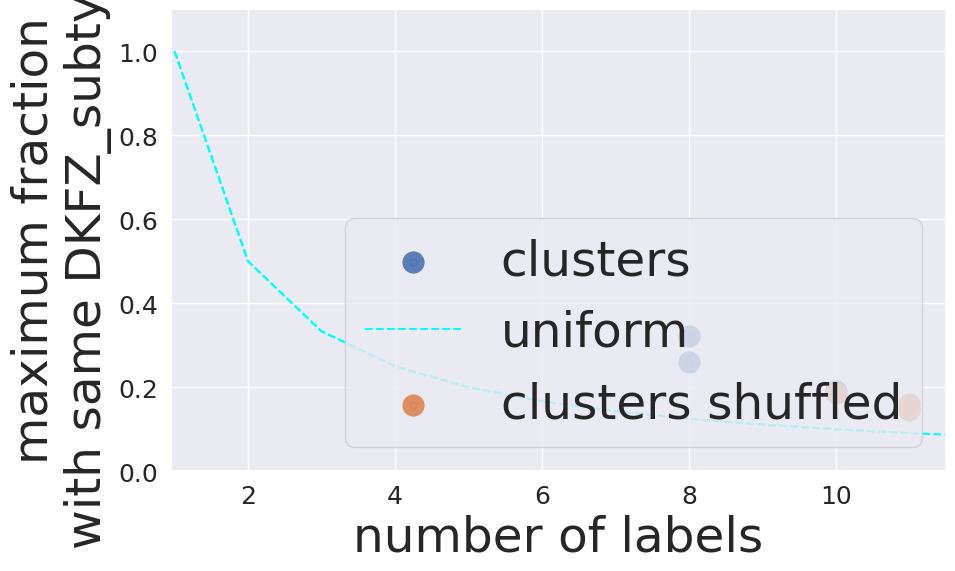

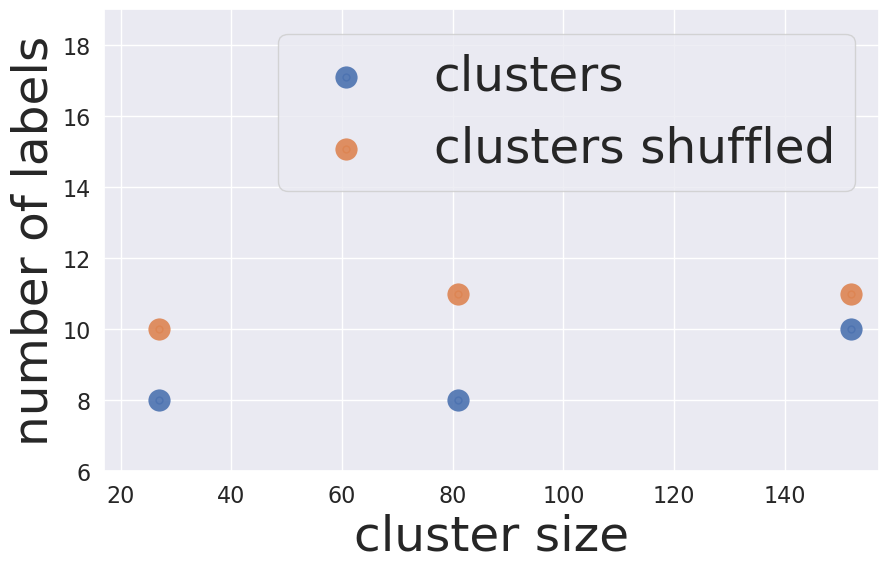

False DKFZ_subtype 0


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


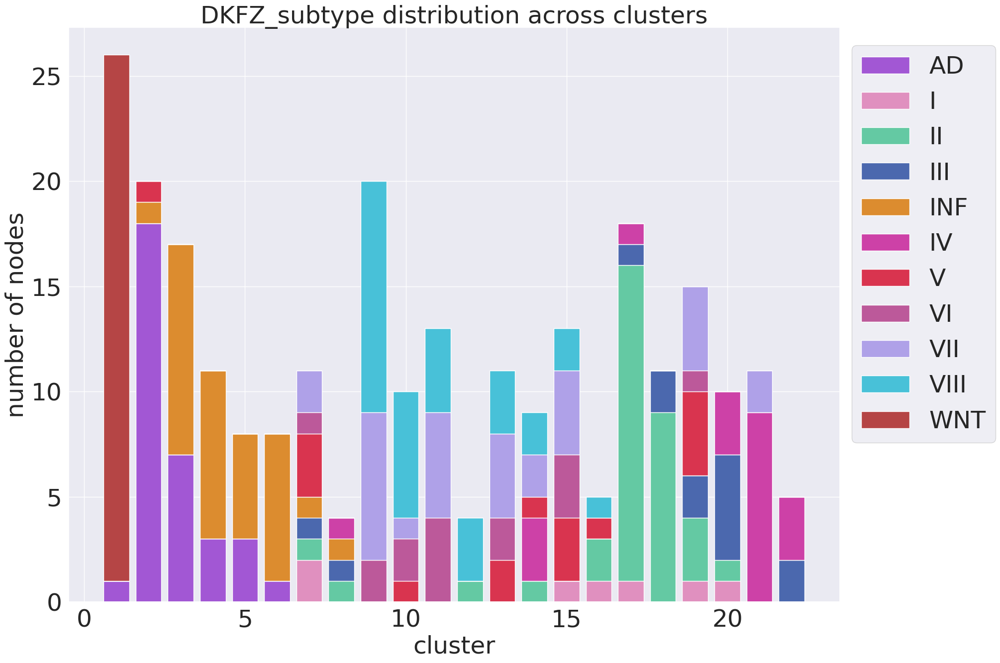

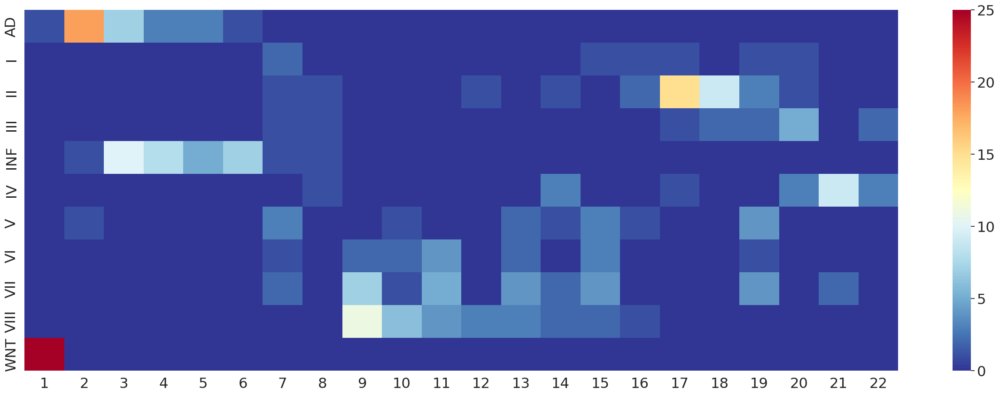

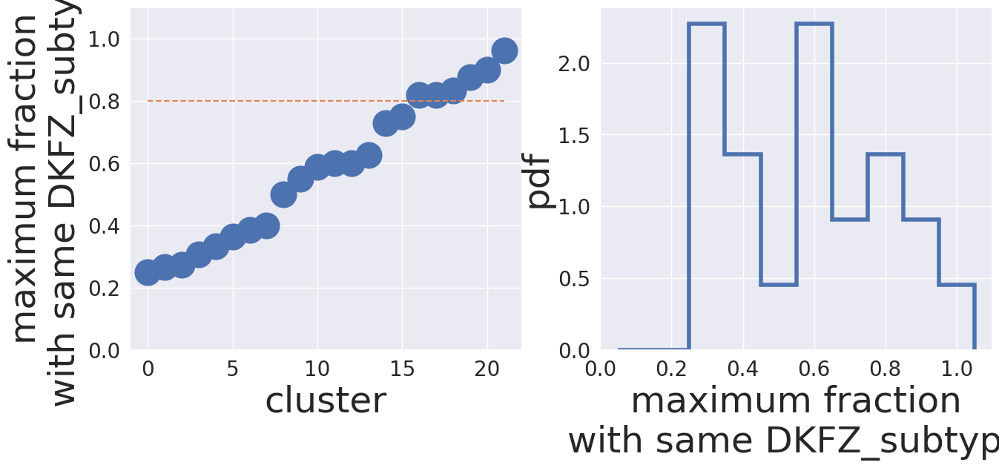

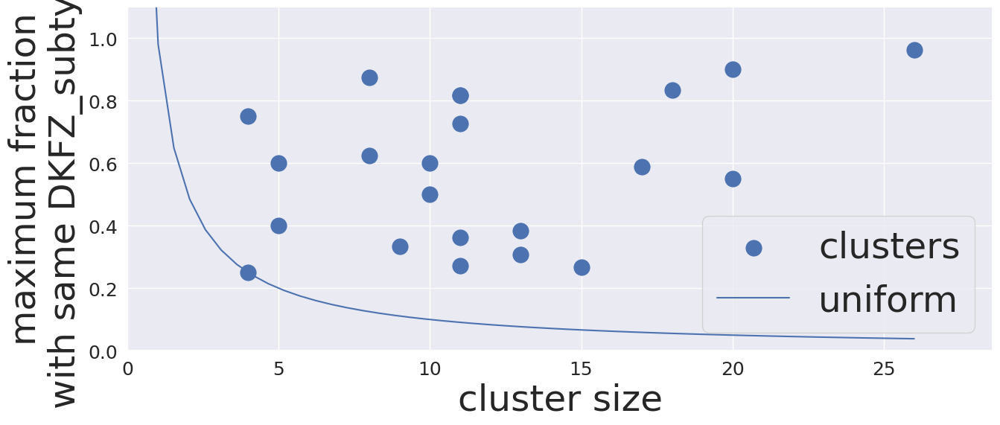

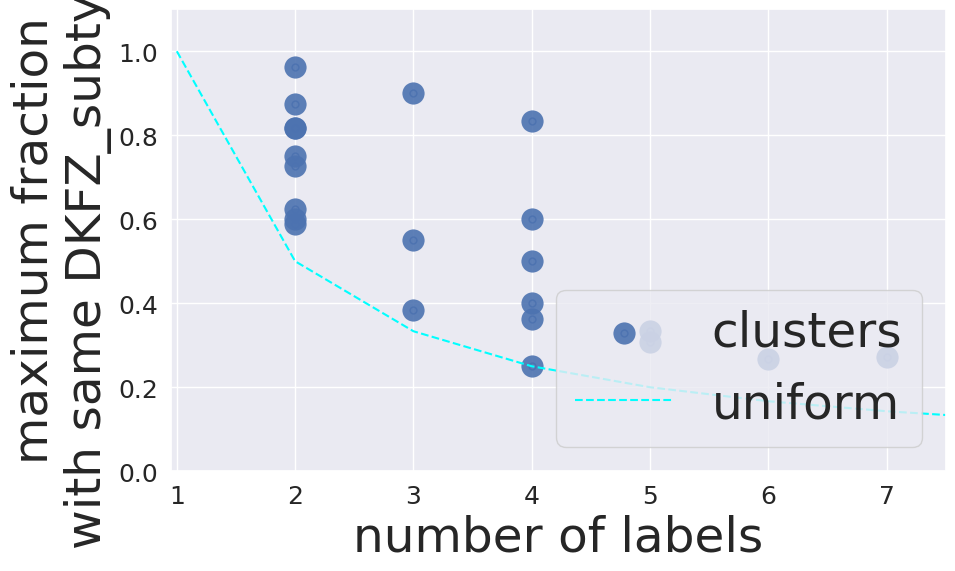

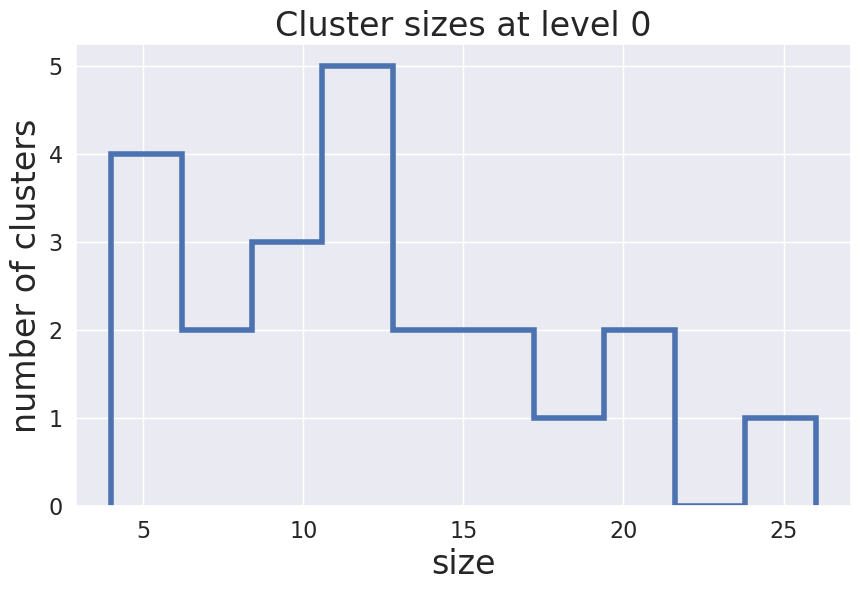

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


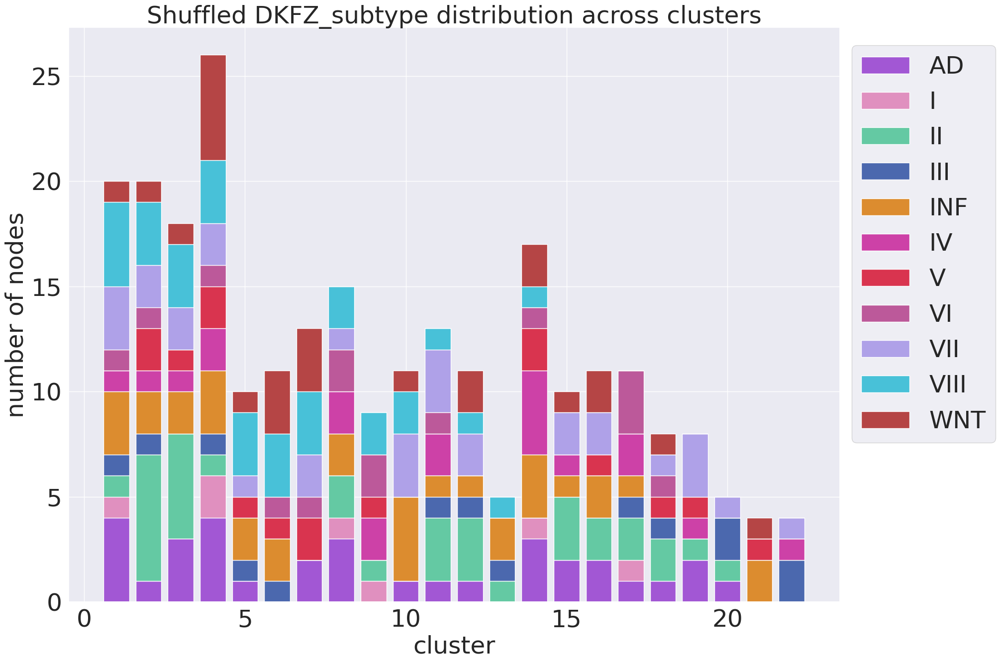

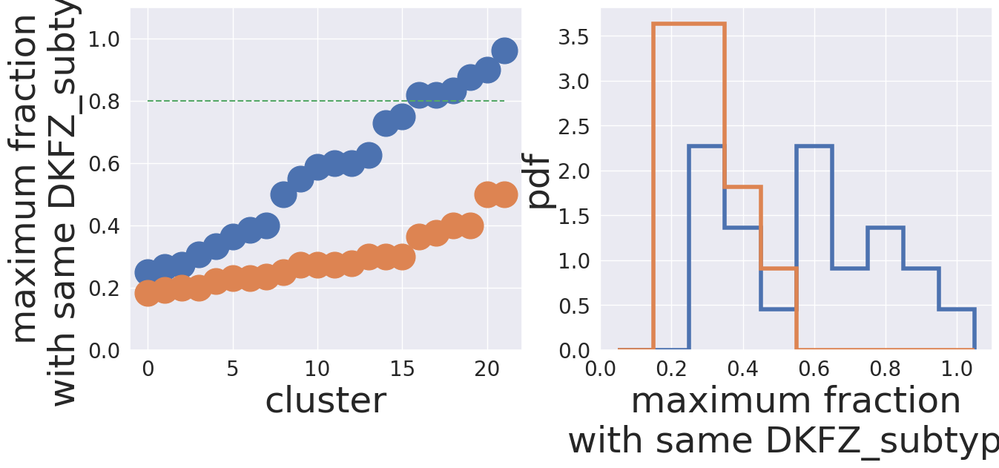

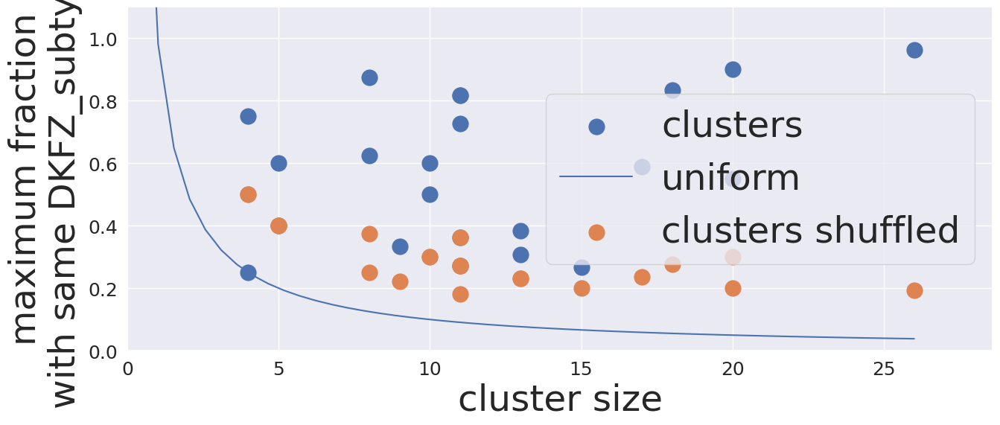

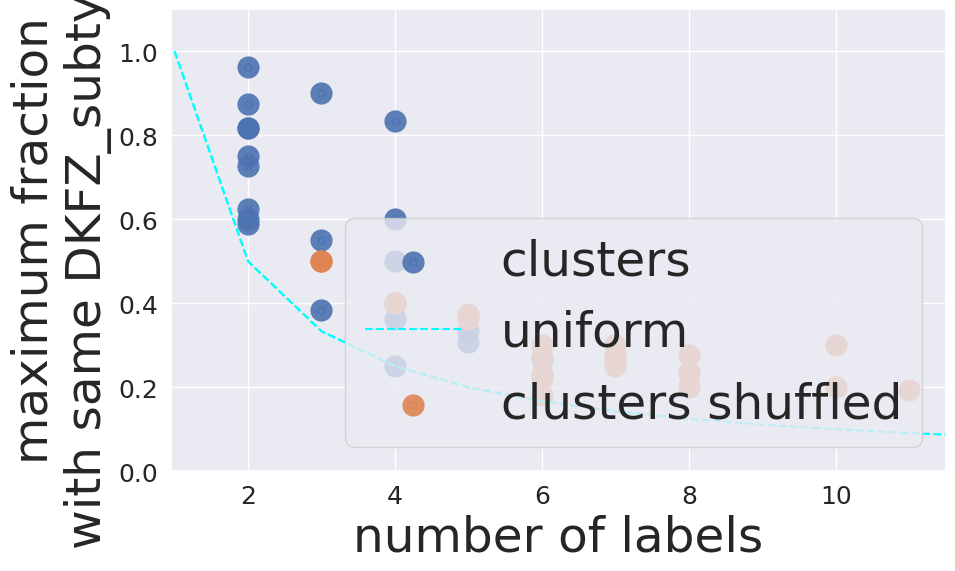

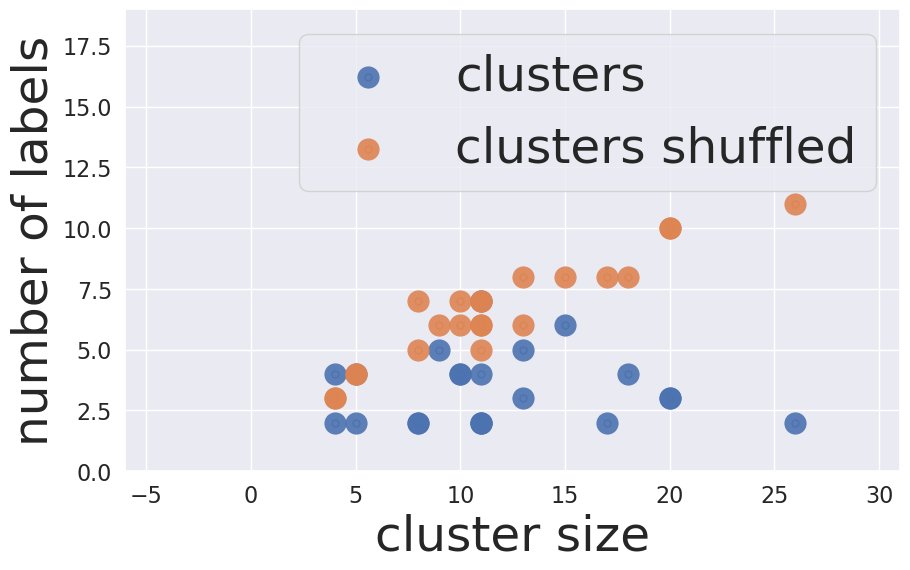

False Proteome_subgroup 10


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


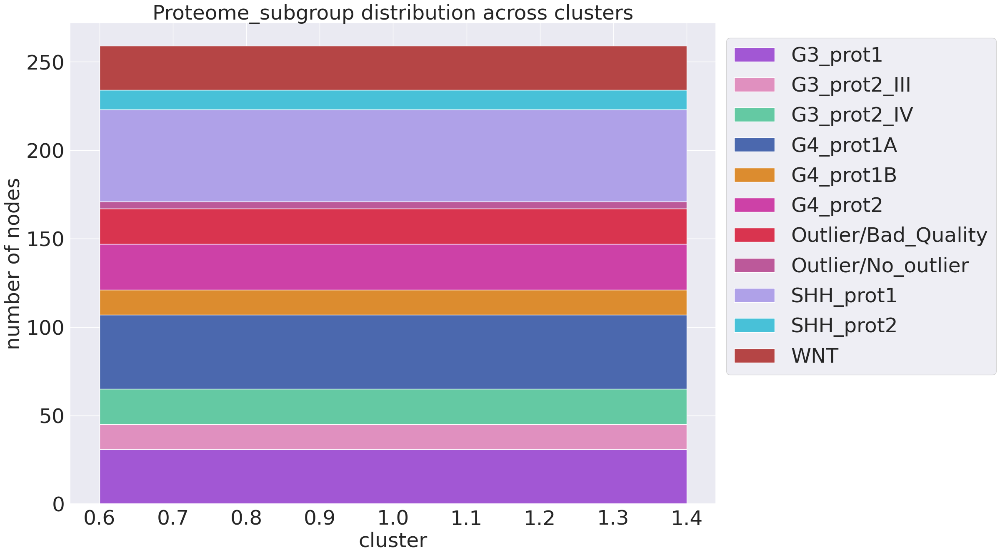

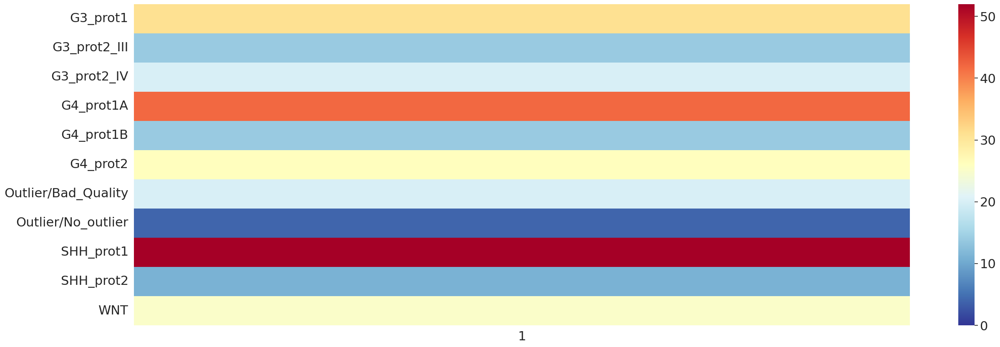

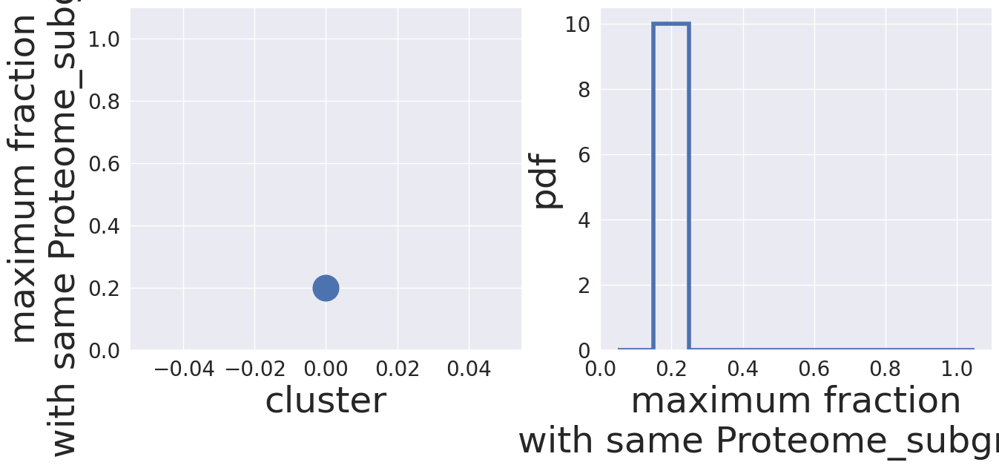

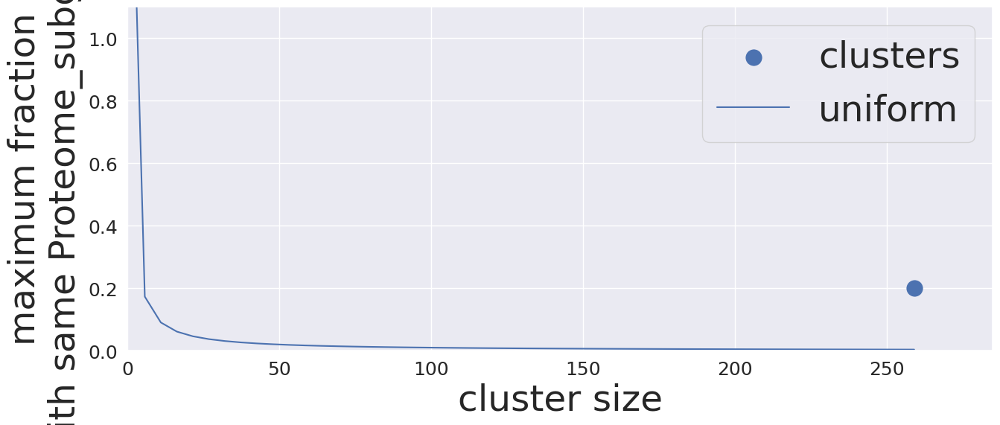

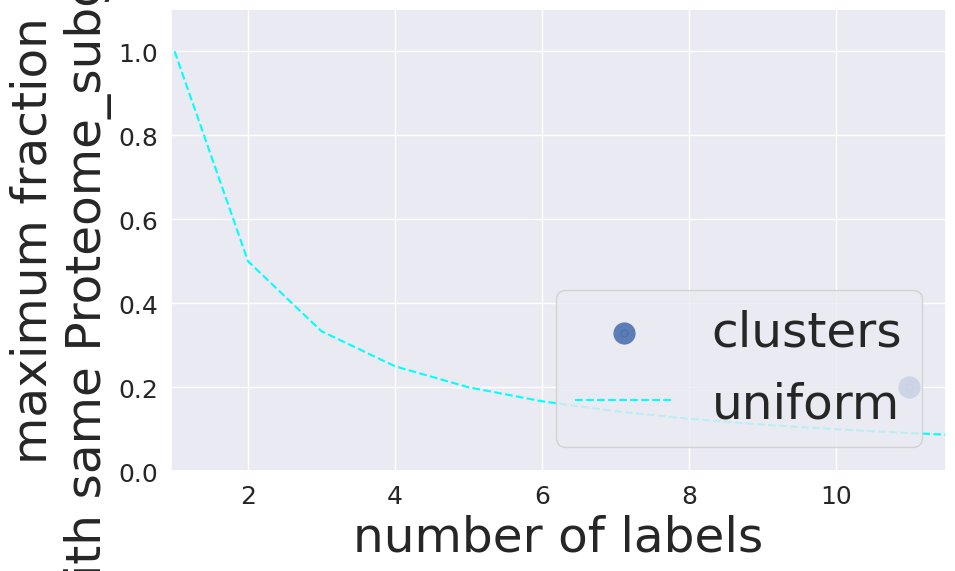

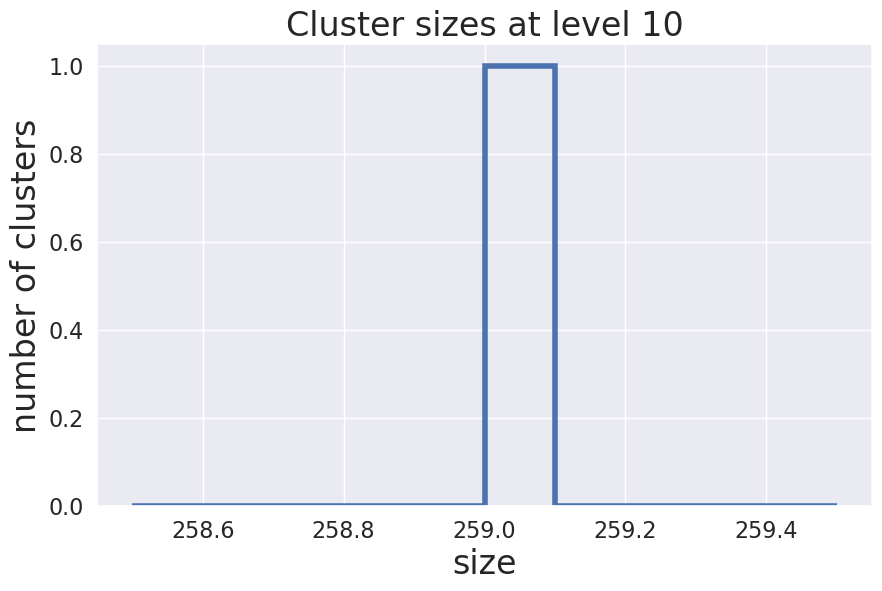

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


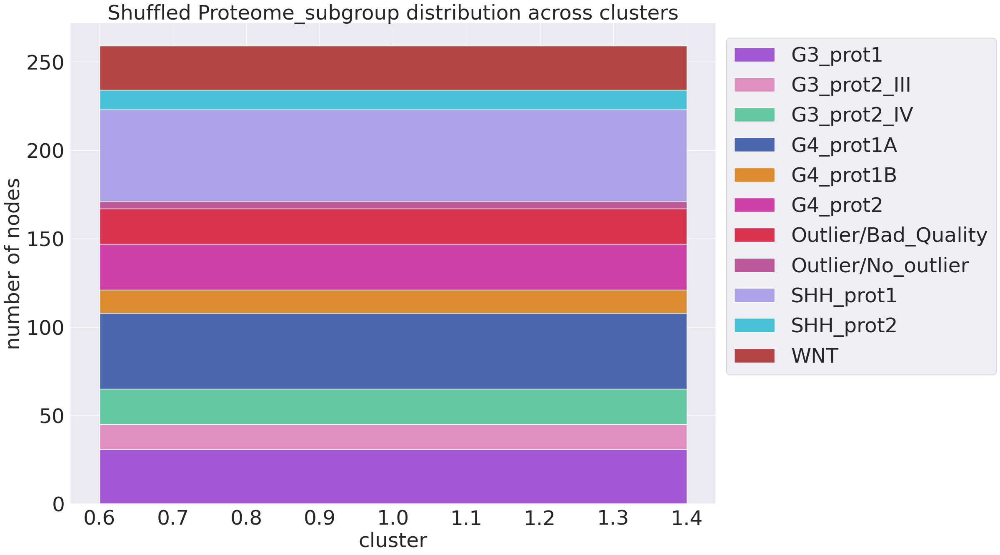

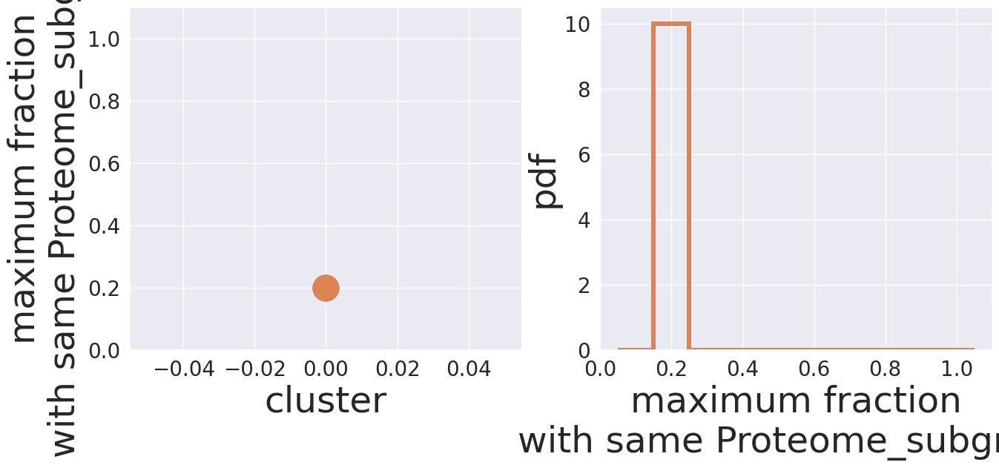

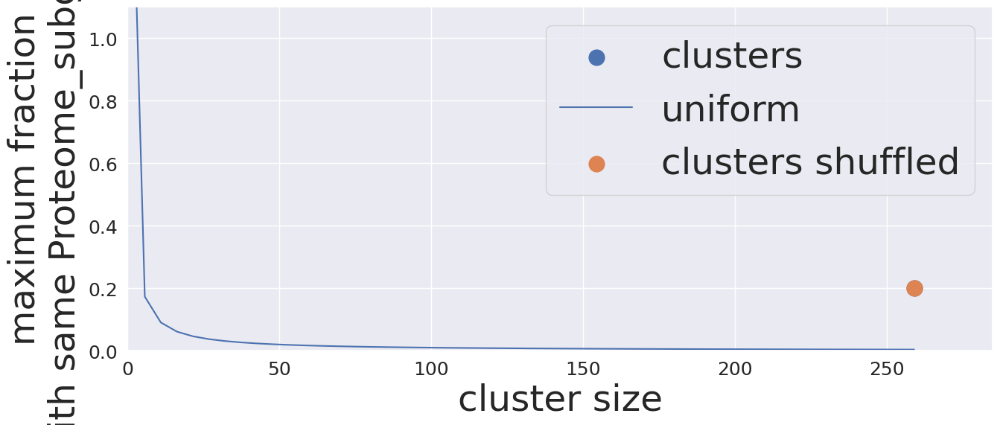

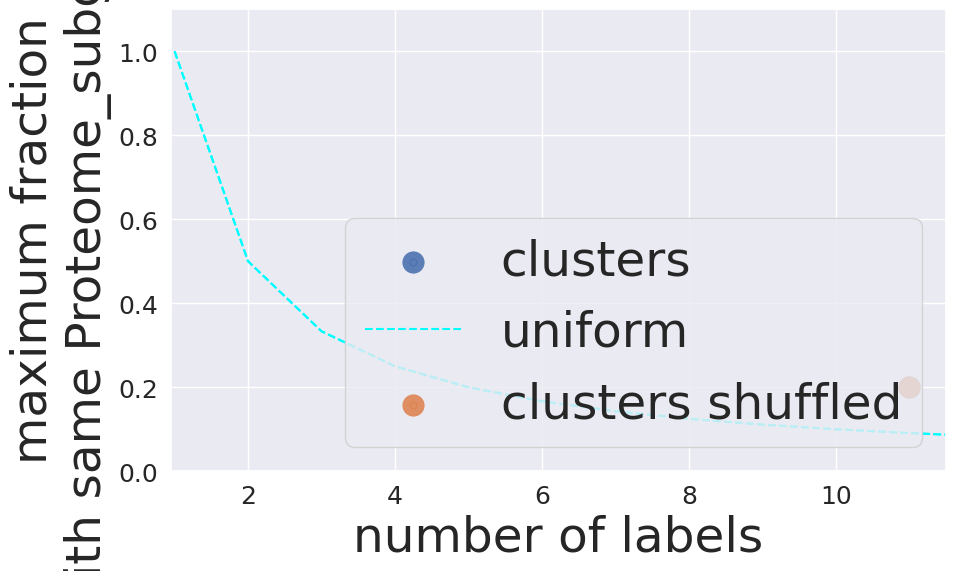

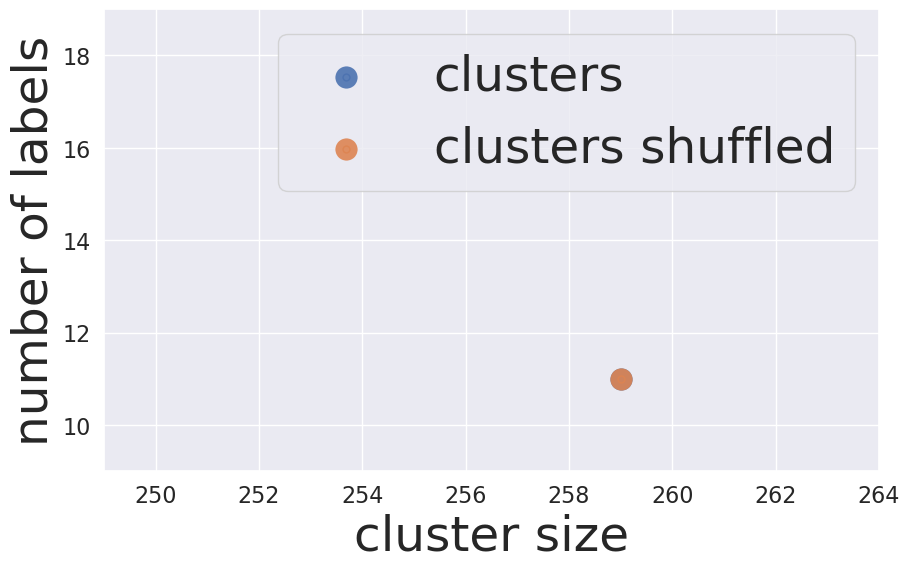

False Proteome_subgroup 9


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


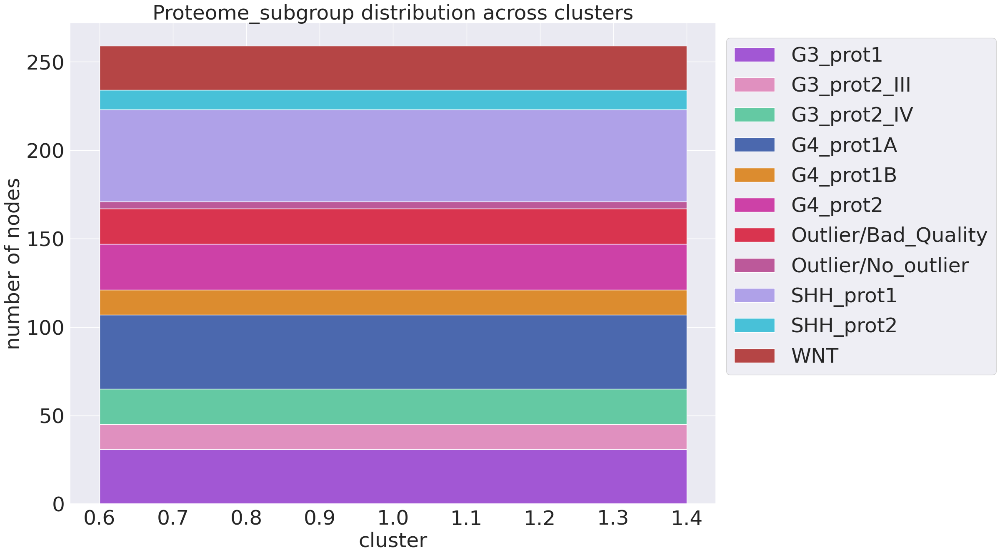

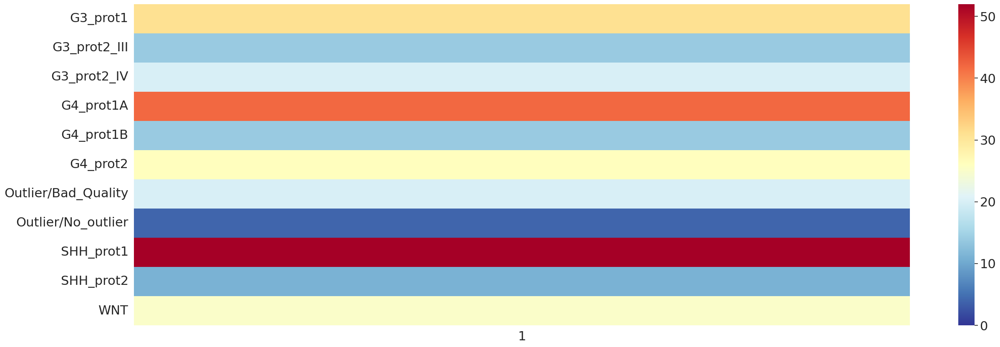

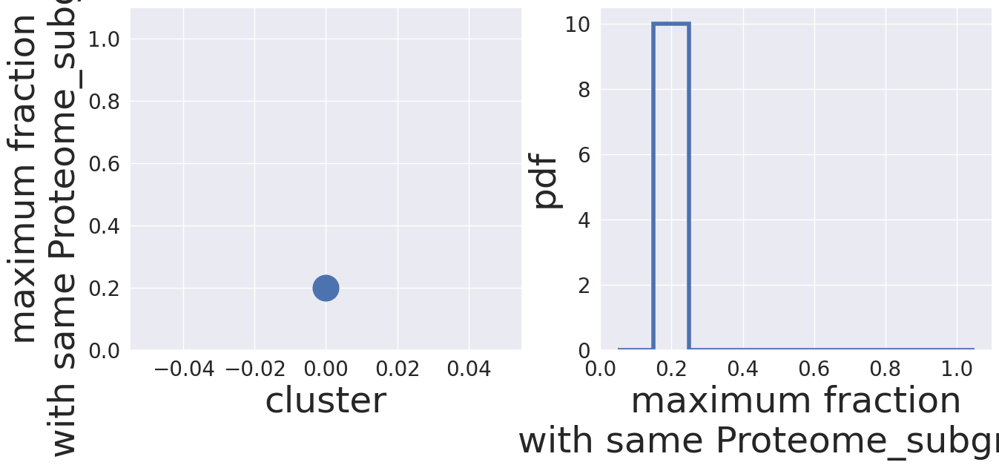

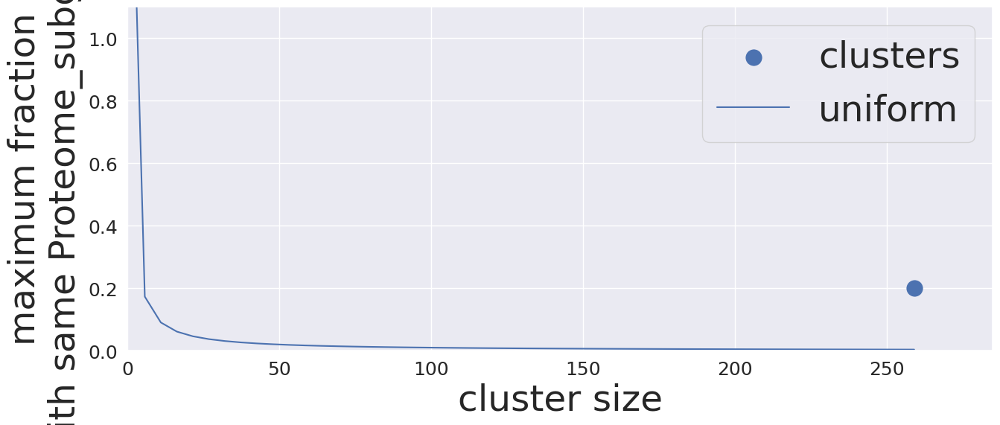

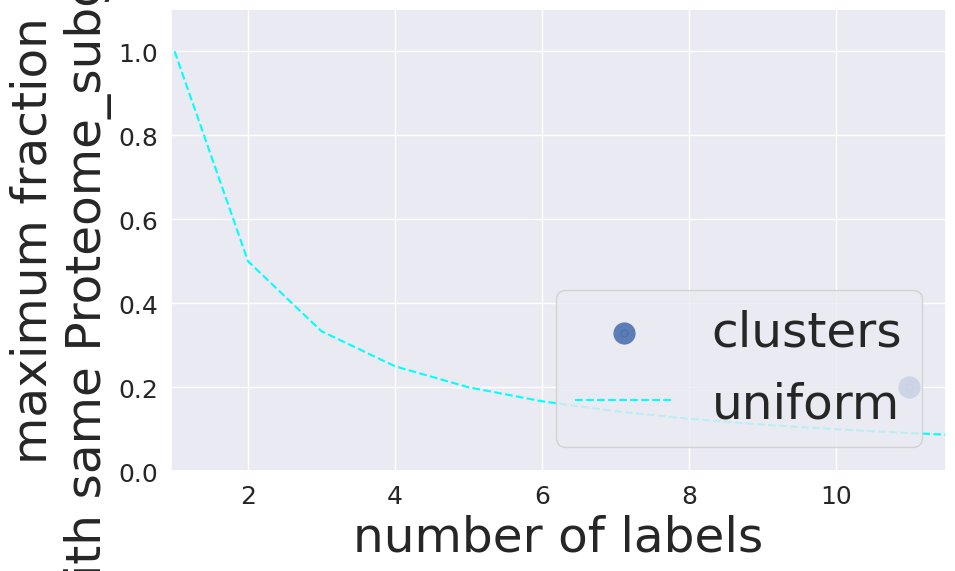

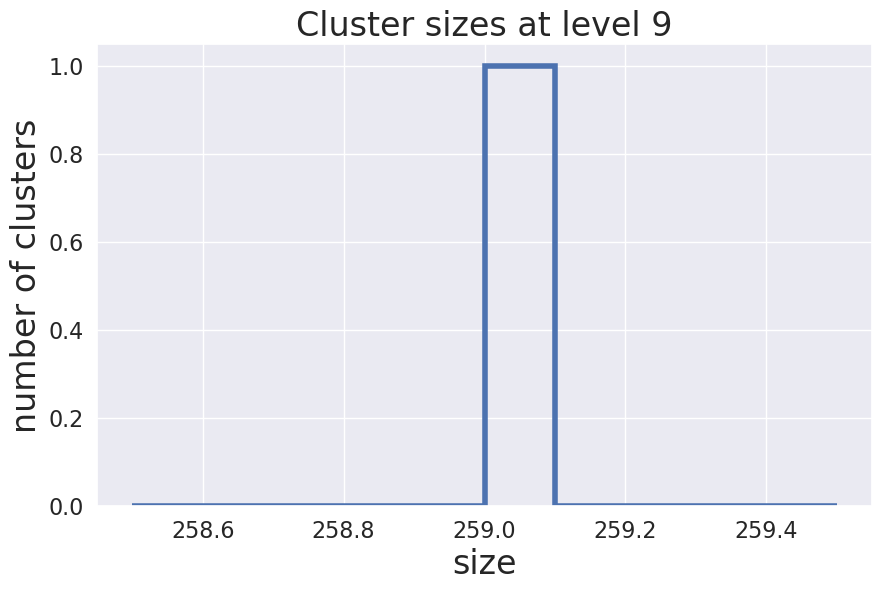

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


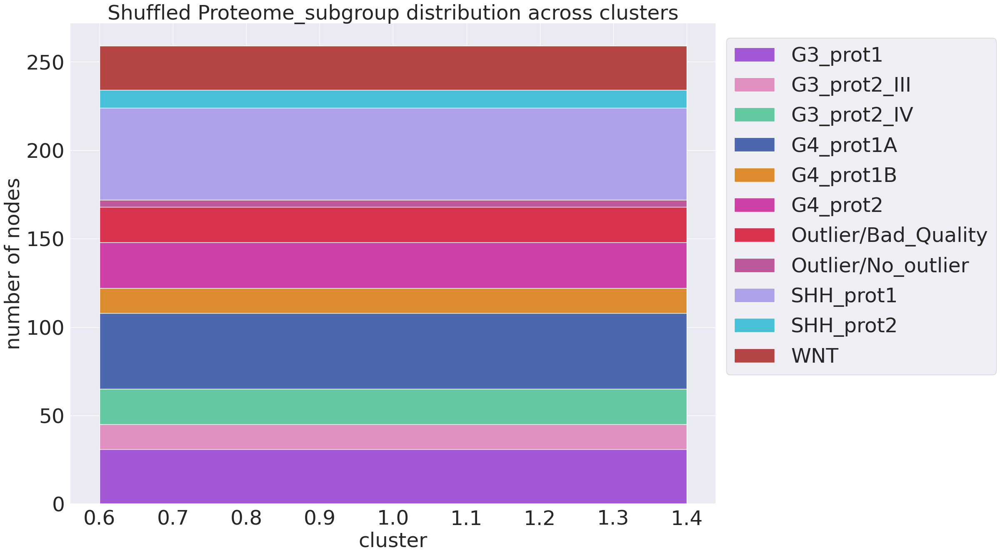

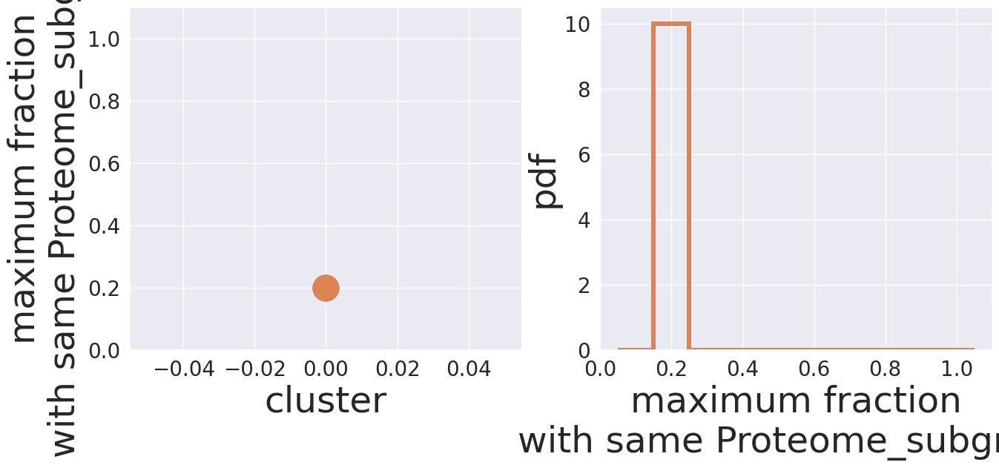

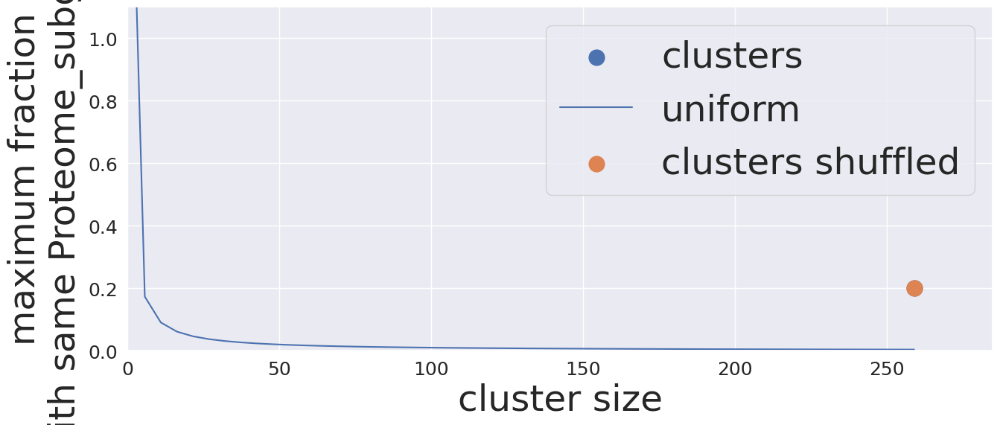

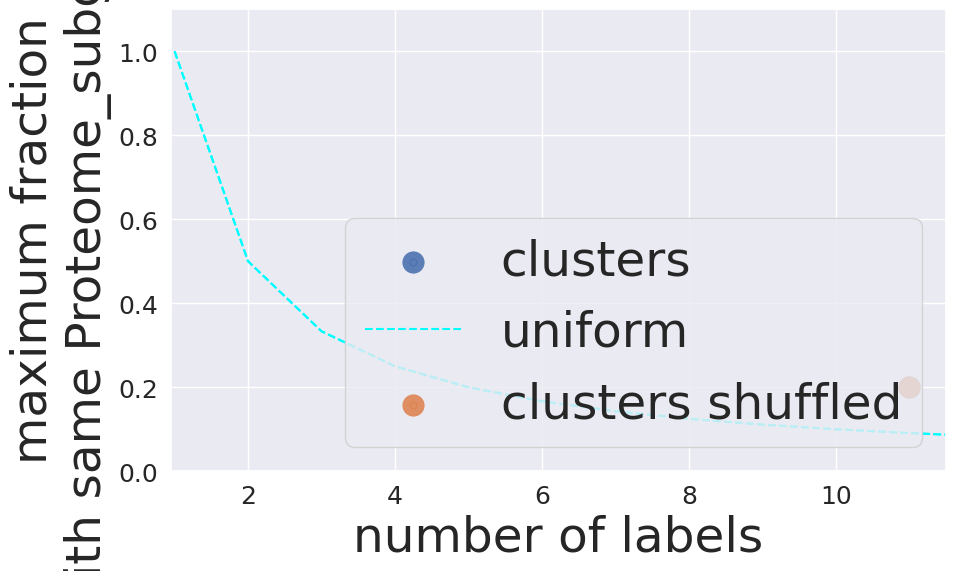

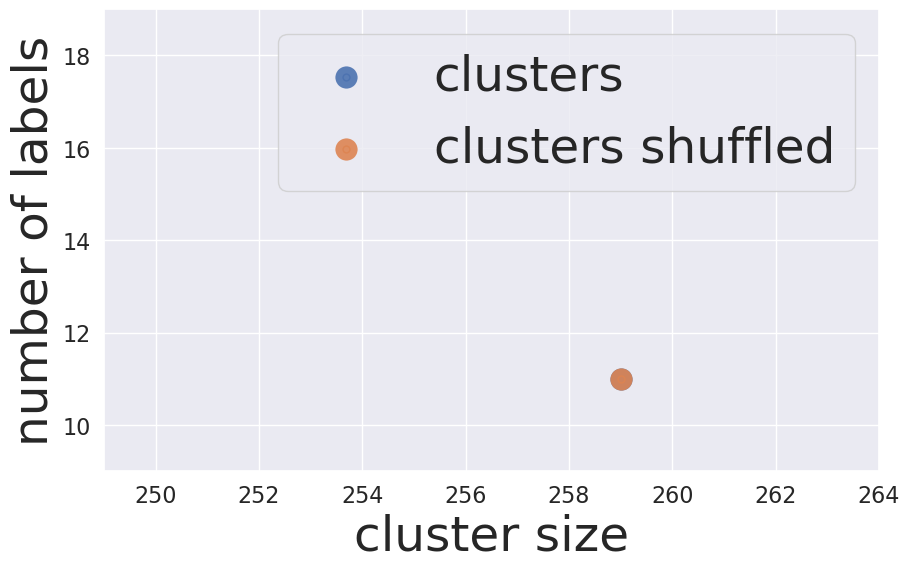

False Proteome_subgroup 8


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


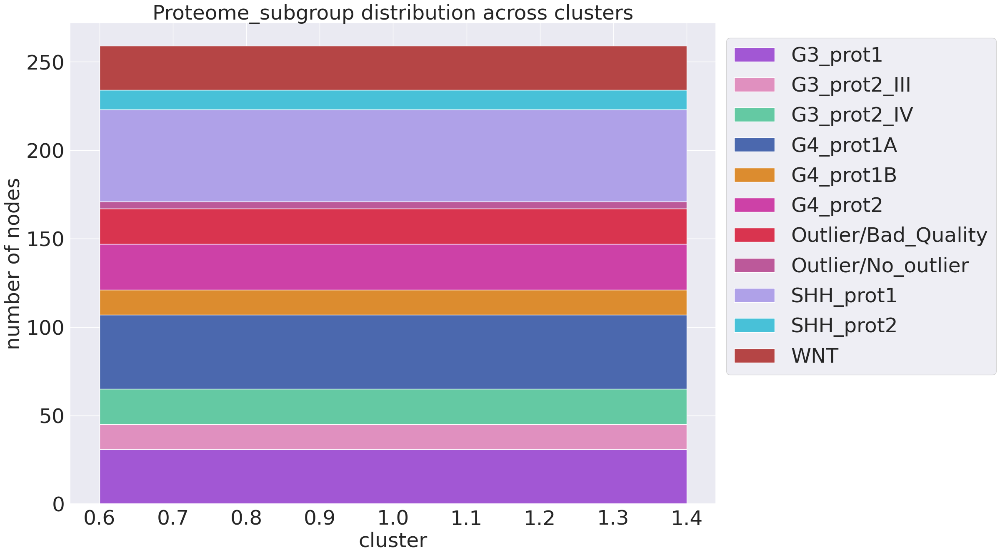

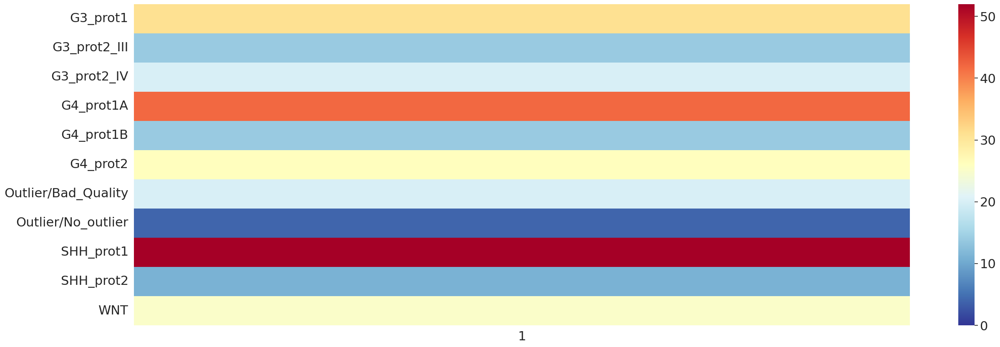

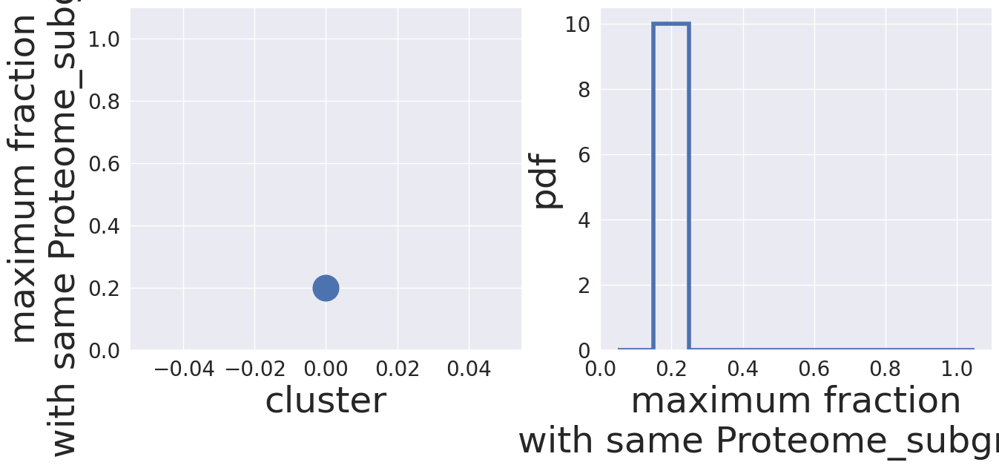

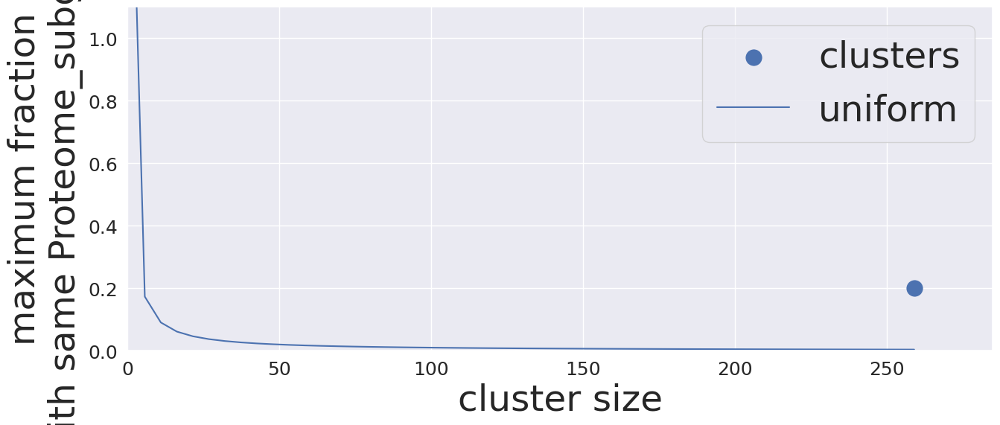

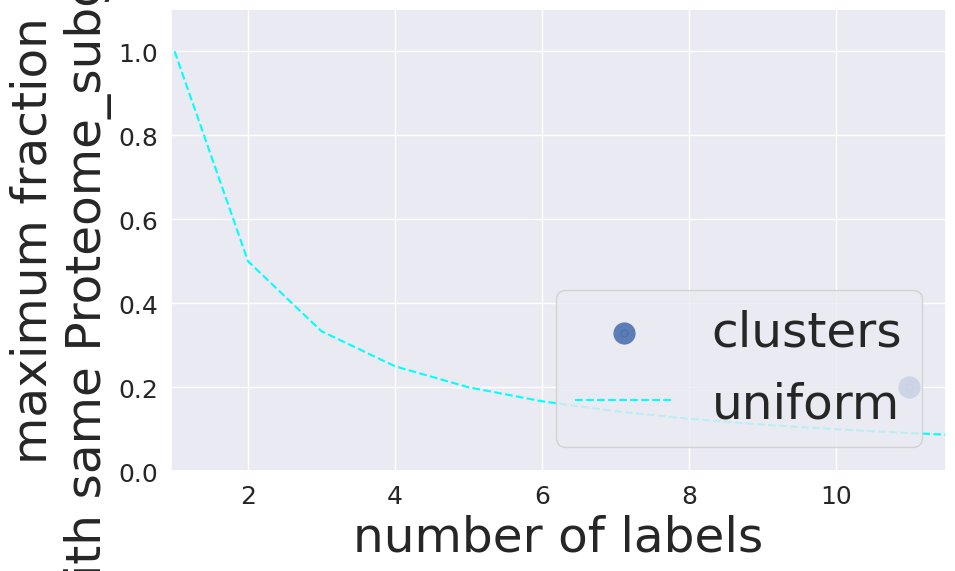

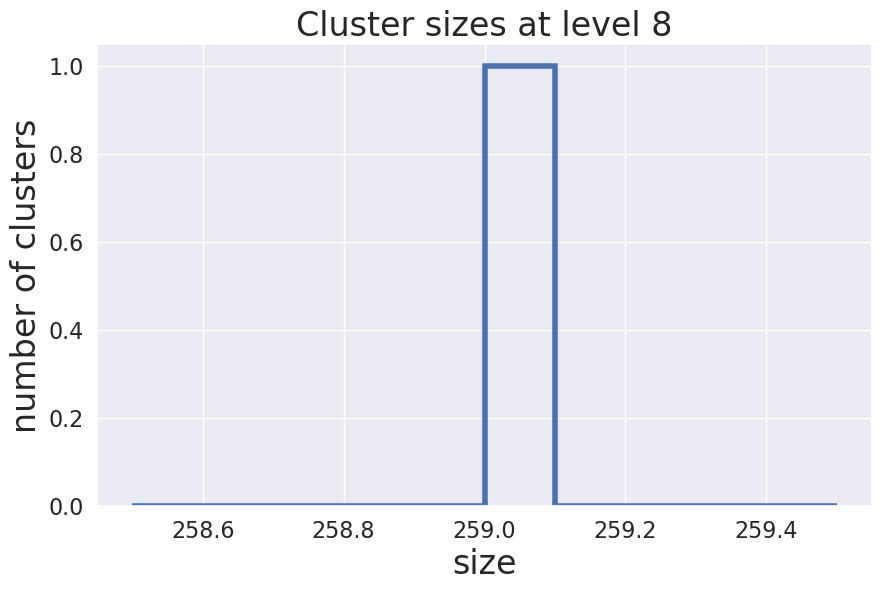

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


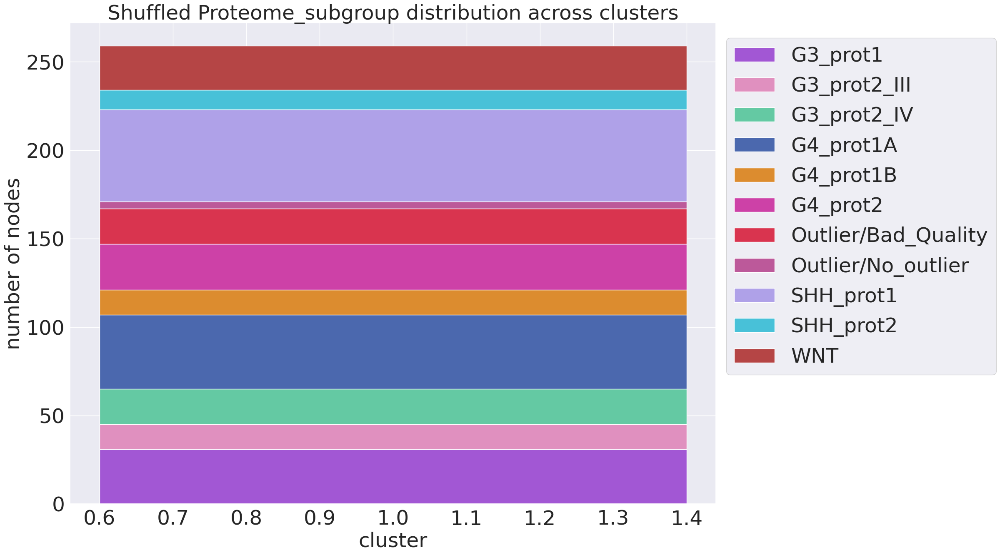

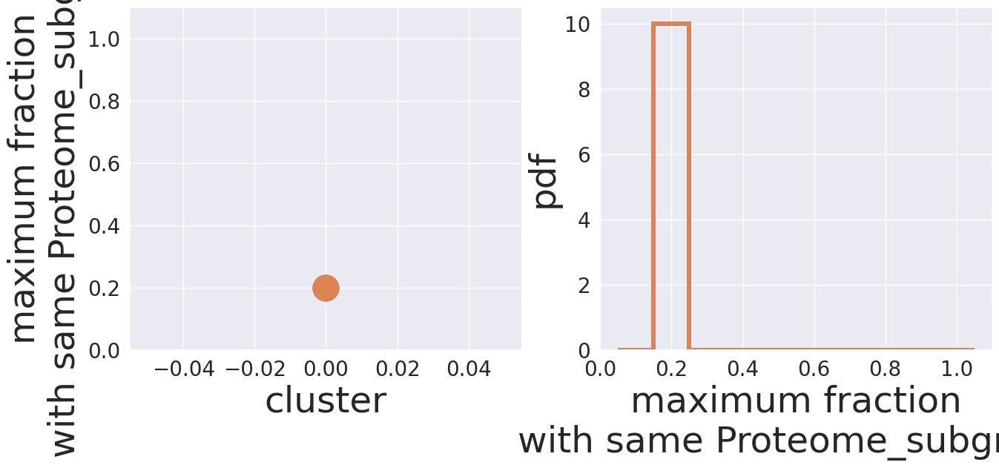

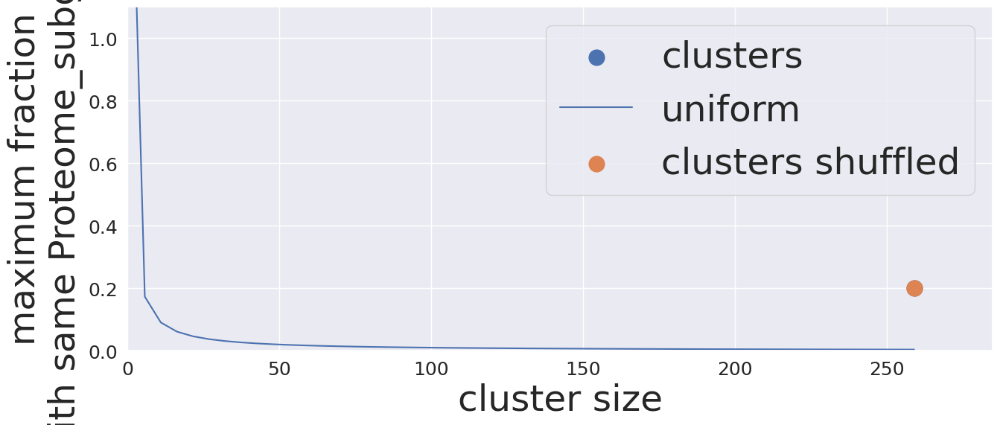

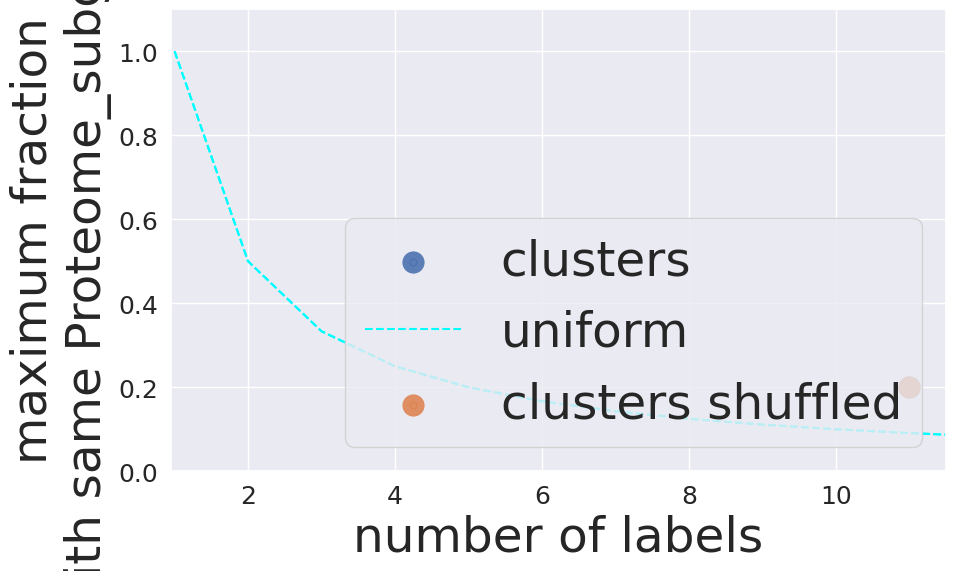

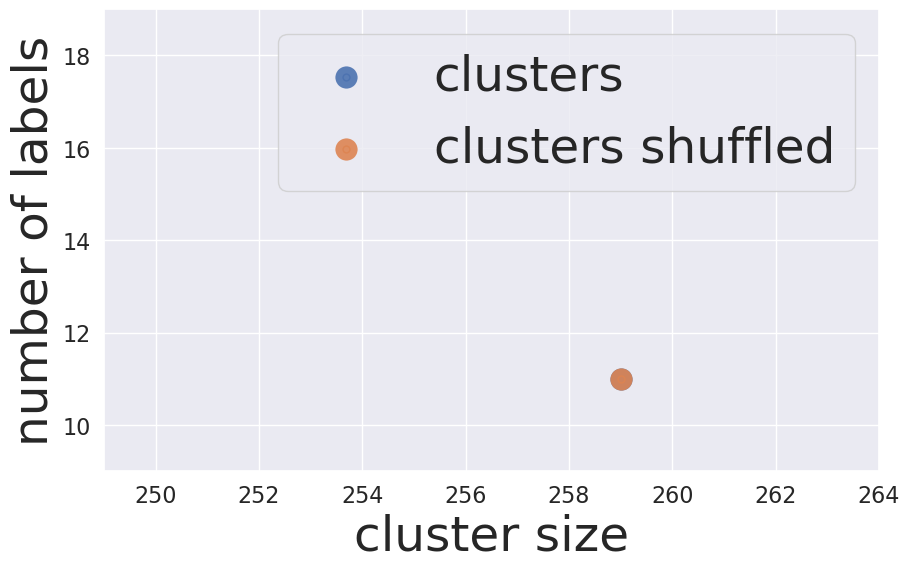

False Proteome_subgroup 7


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


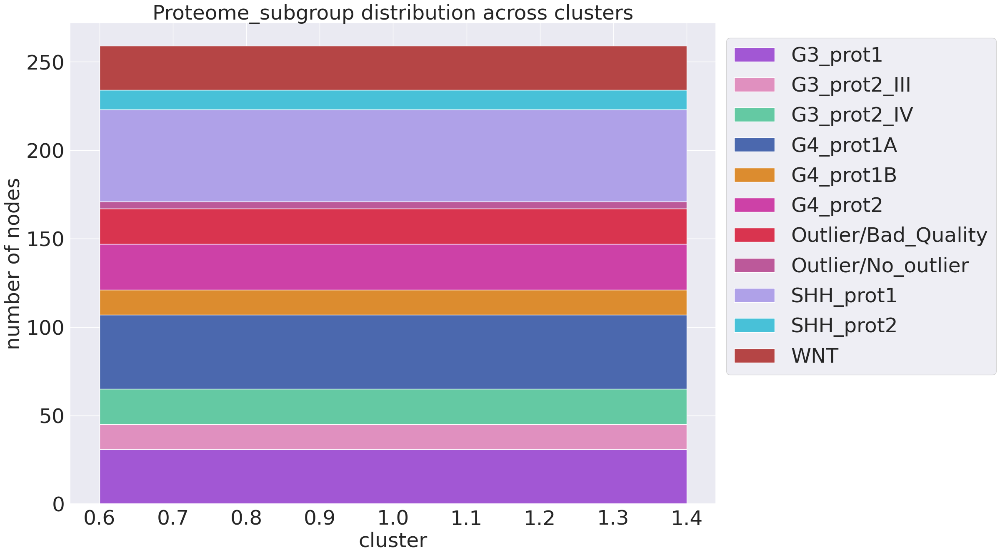

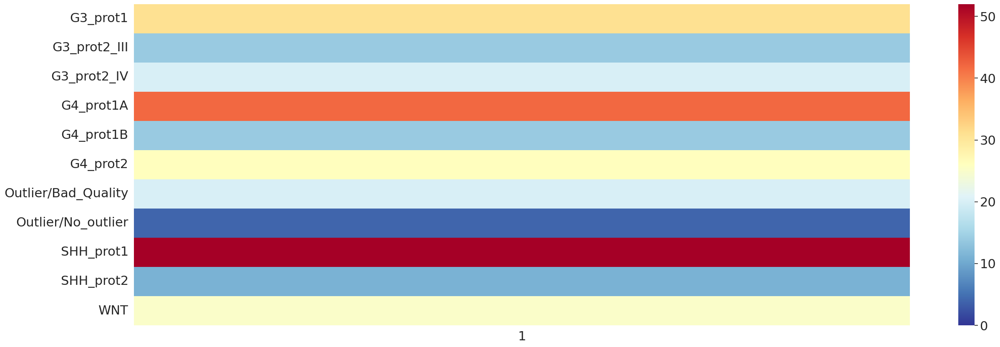

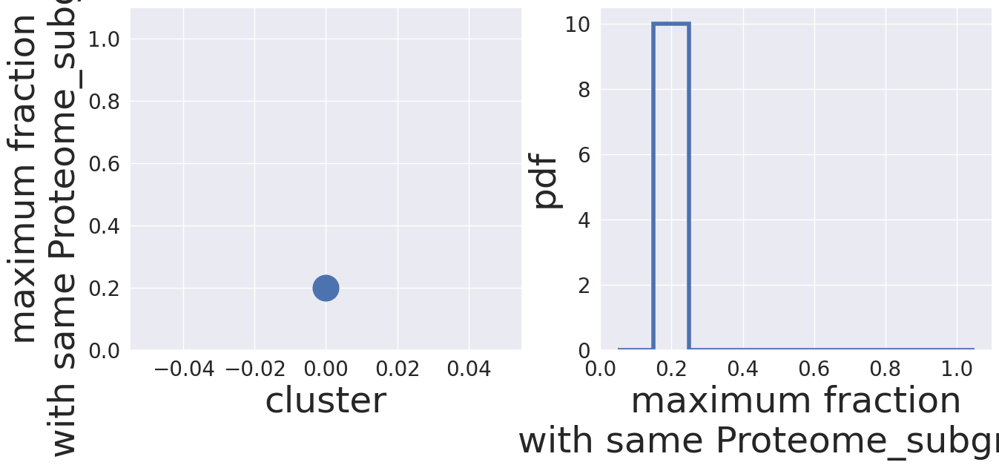

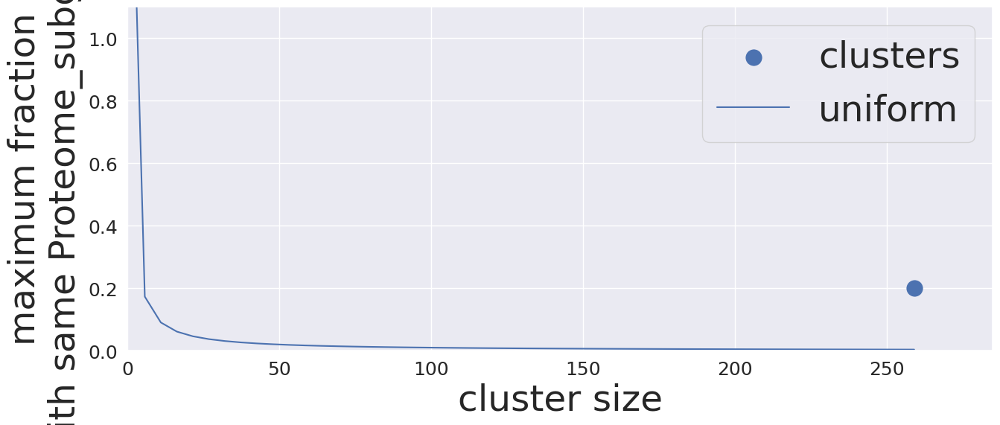

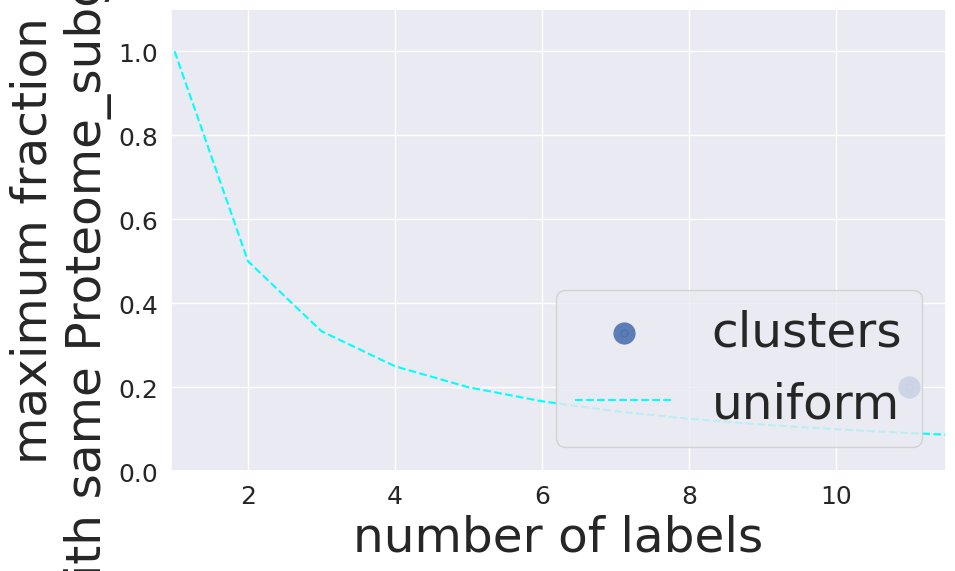

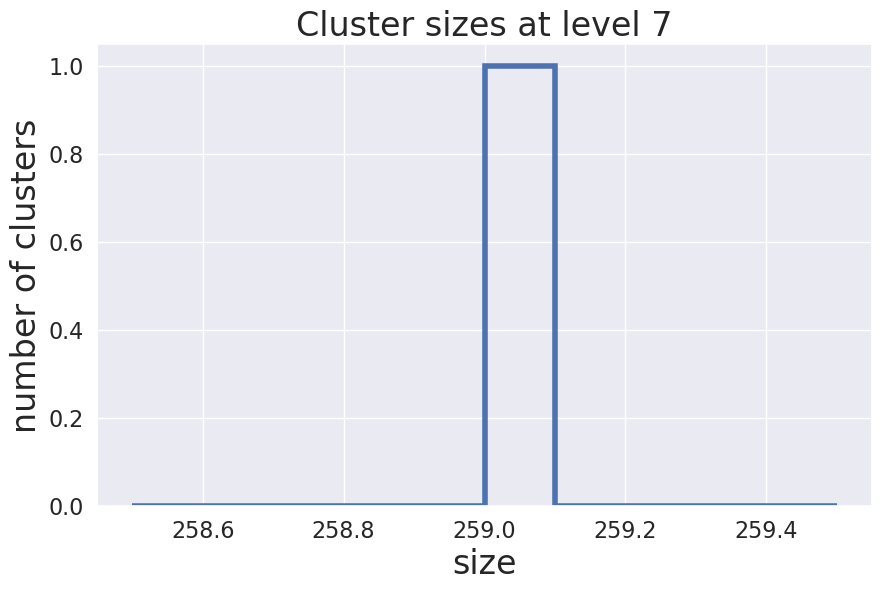

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


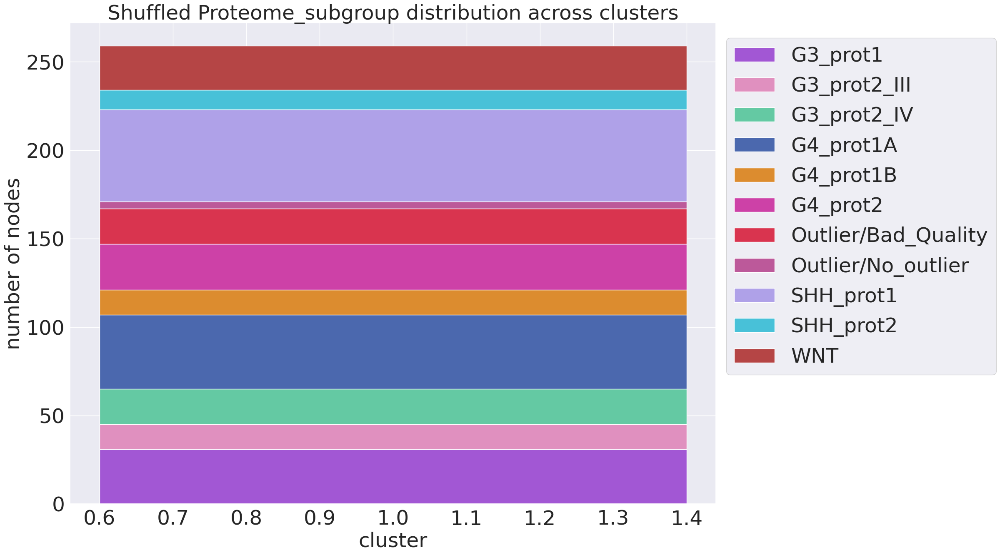

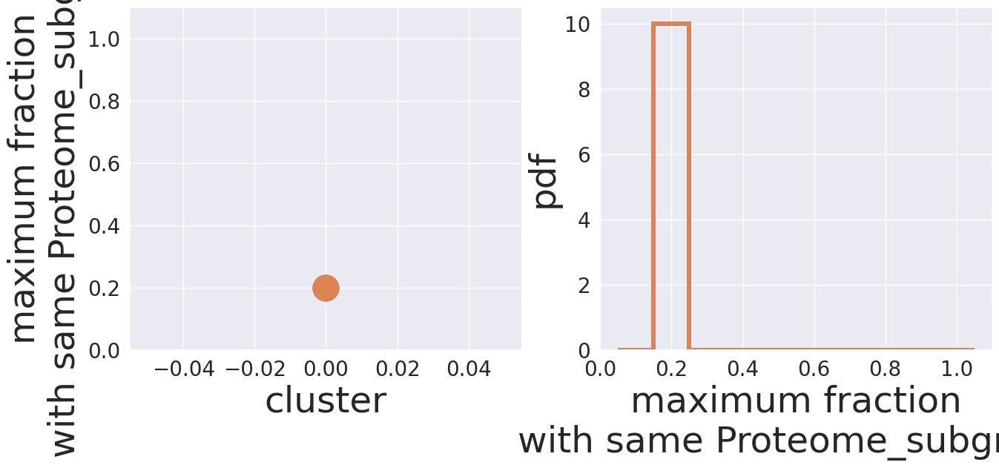

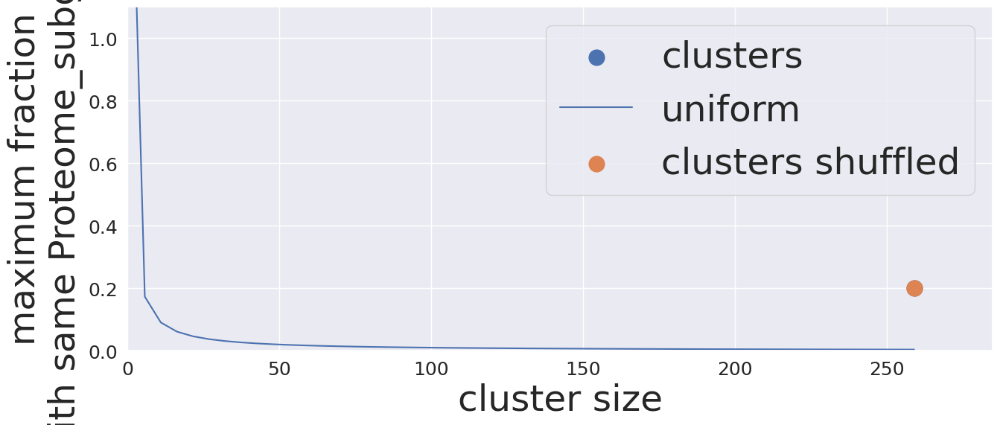

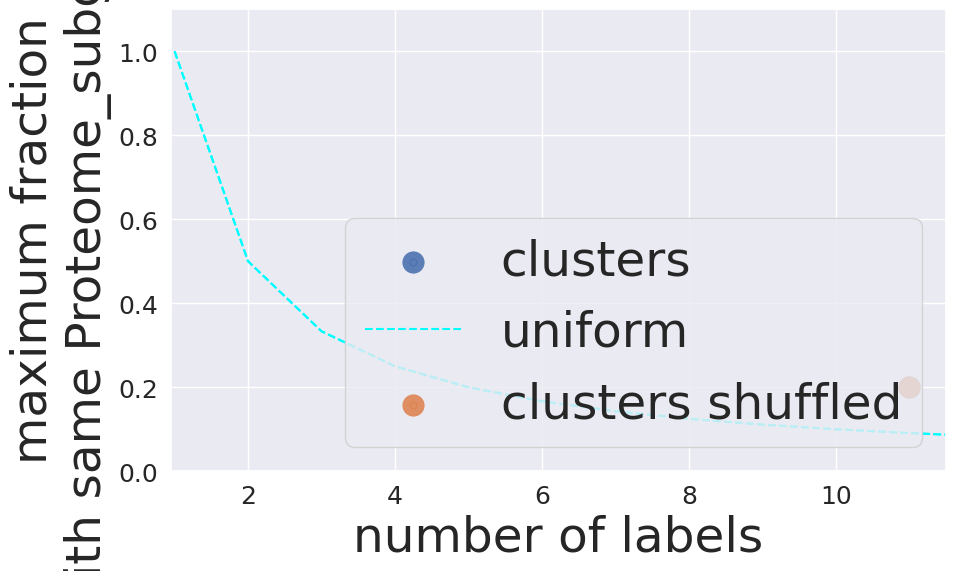

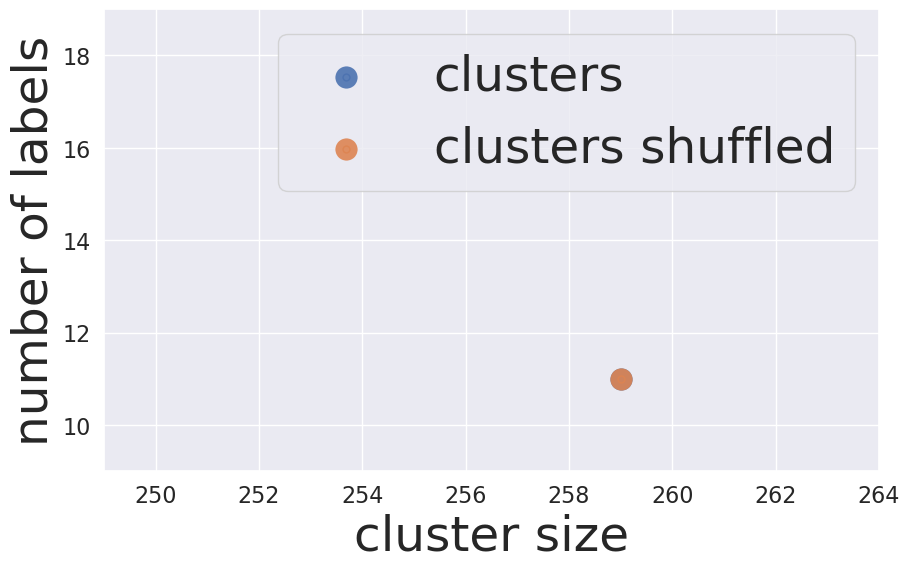

False Proteome_subgroup 6


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


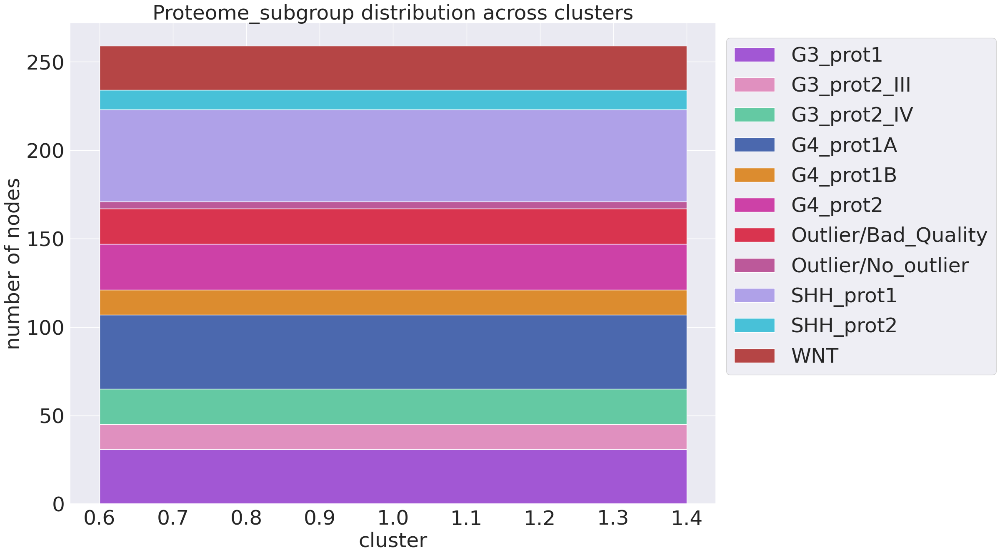

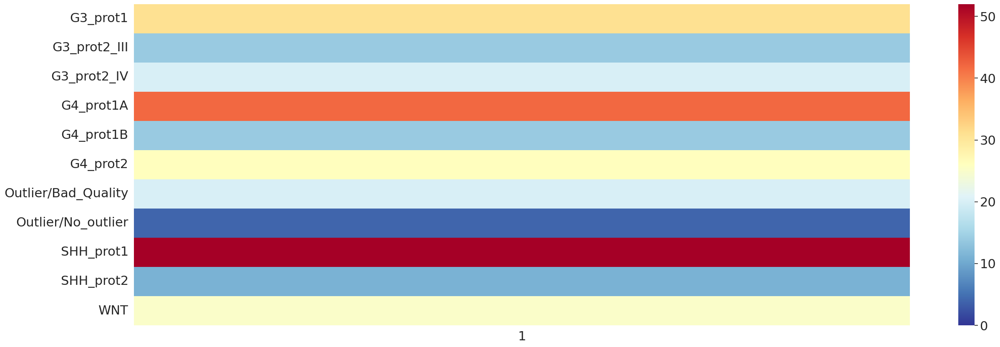

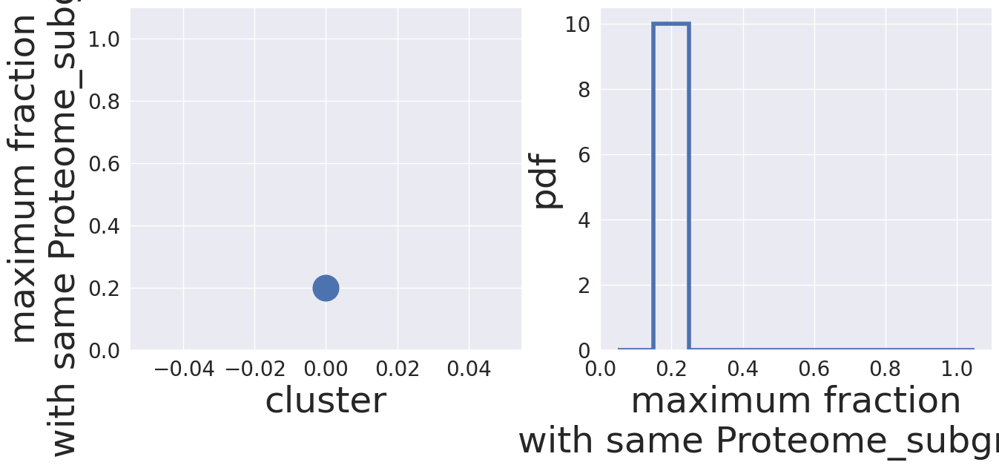

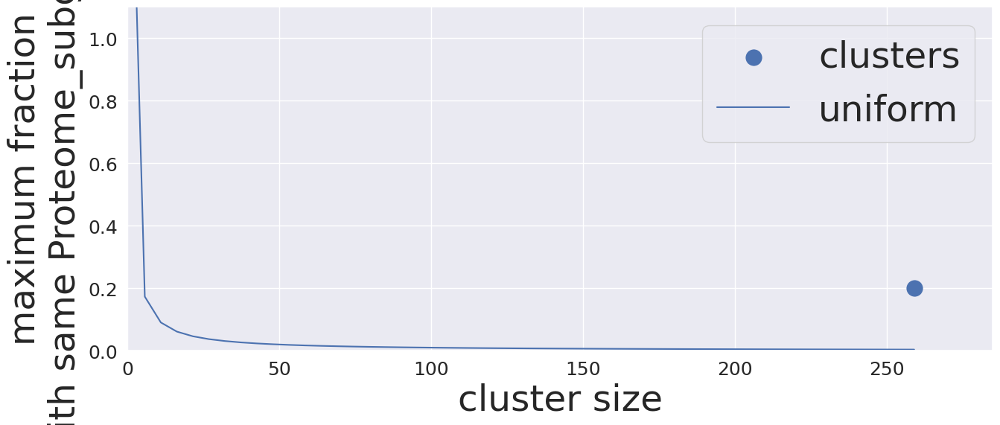

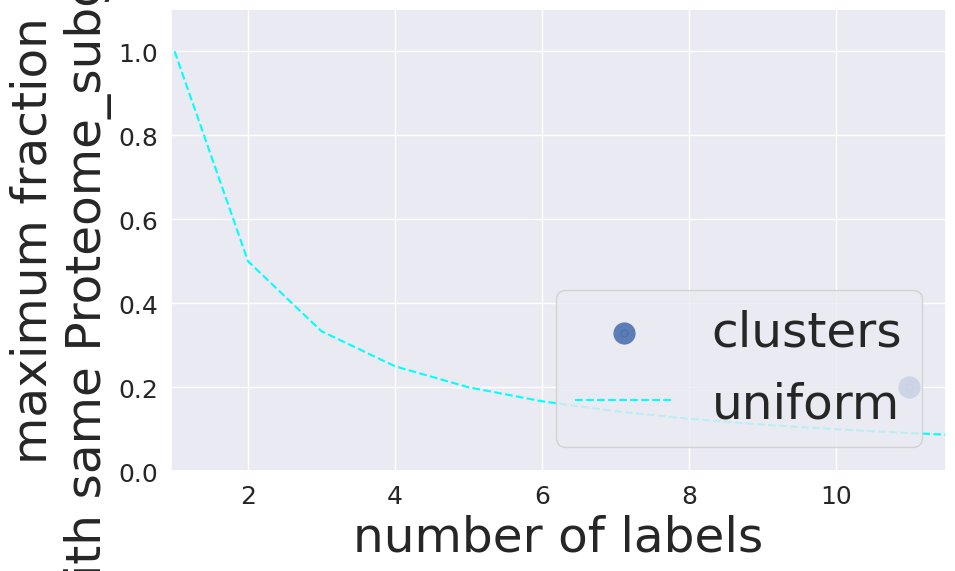

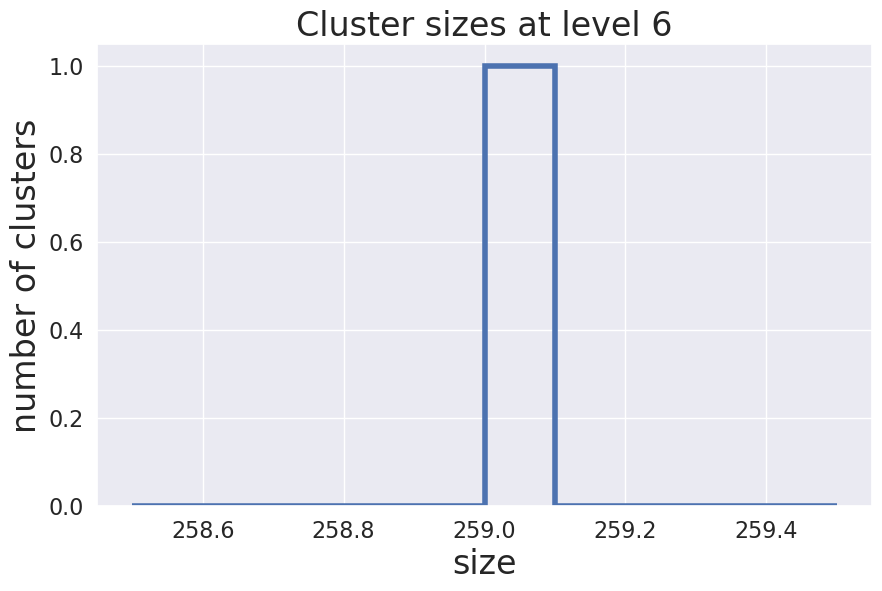

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


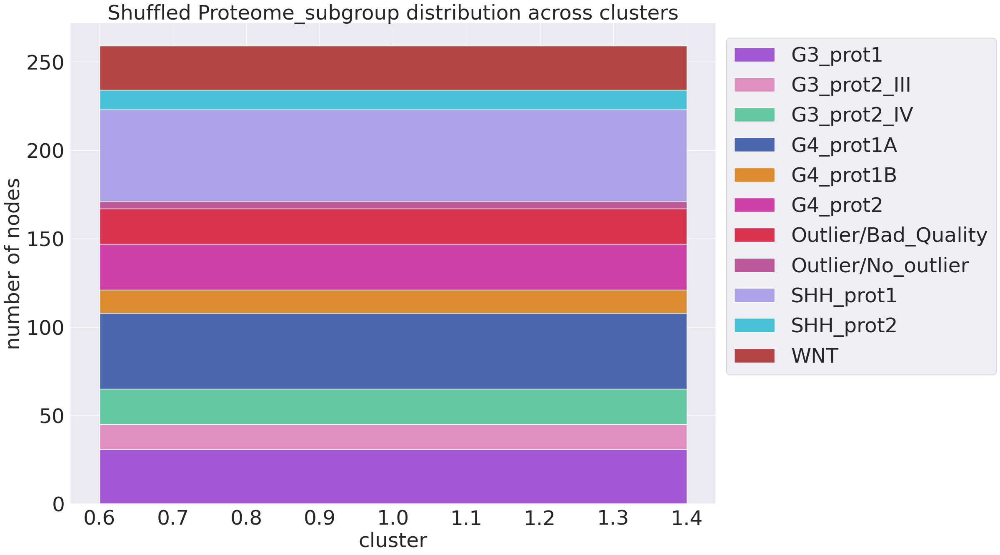

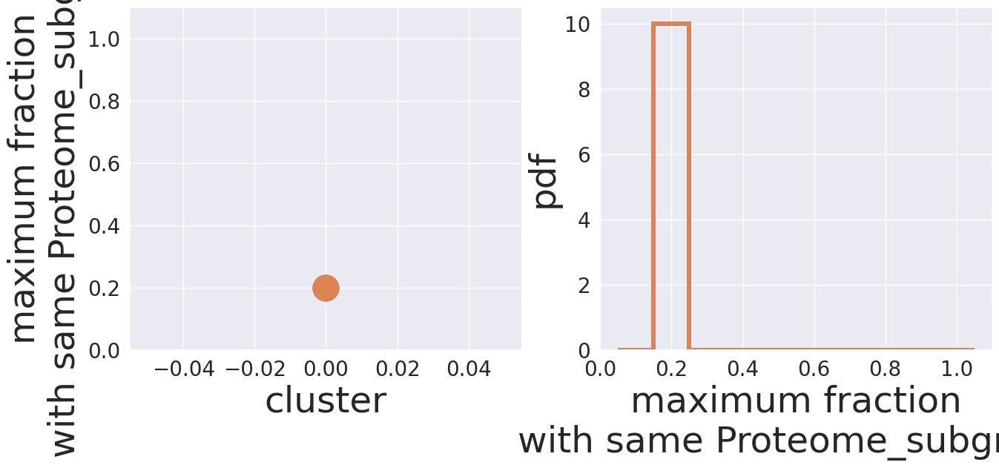

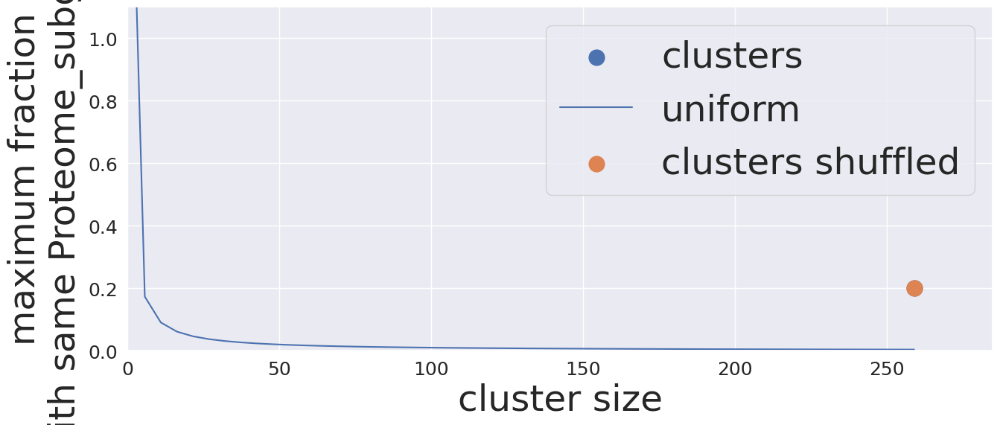

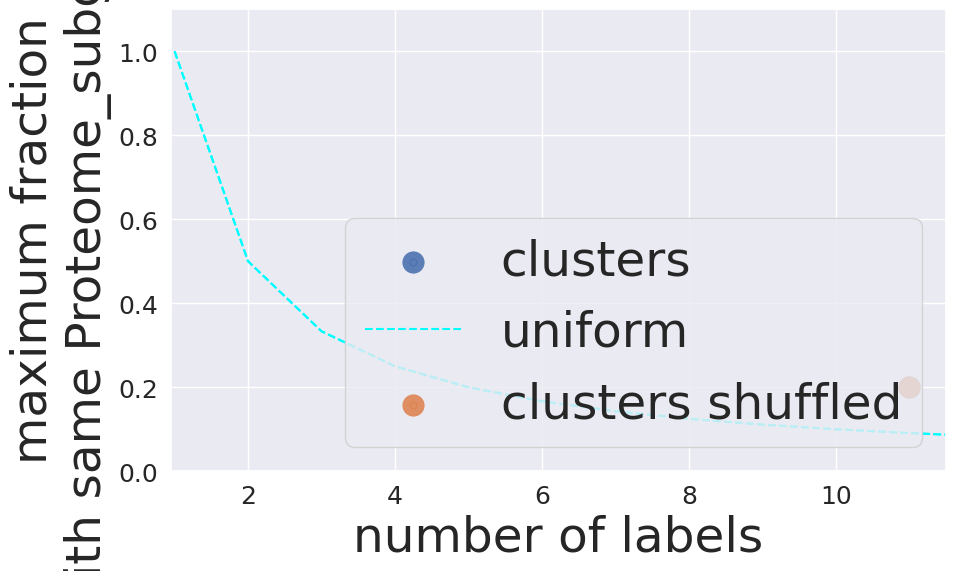

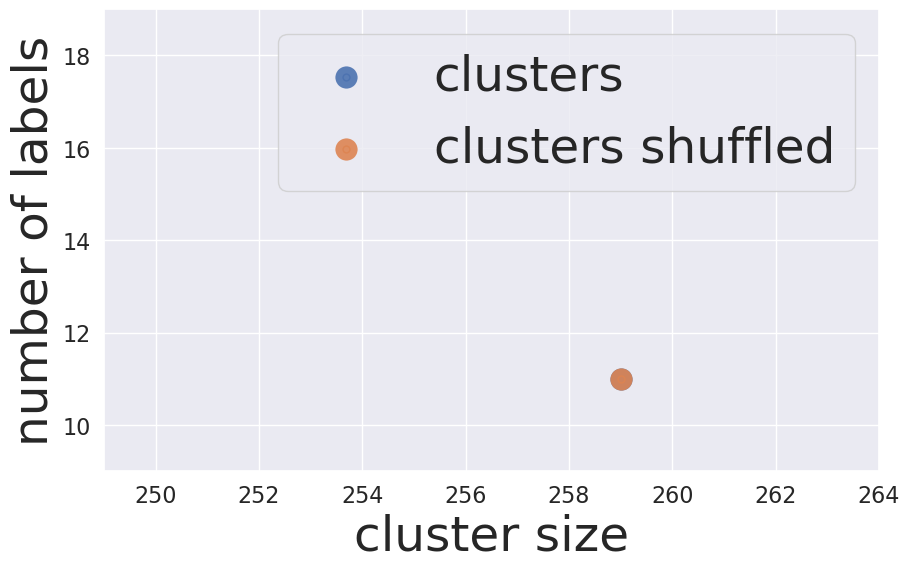

False Proteome_subgroup 5


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


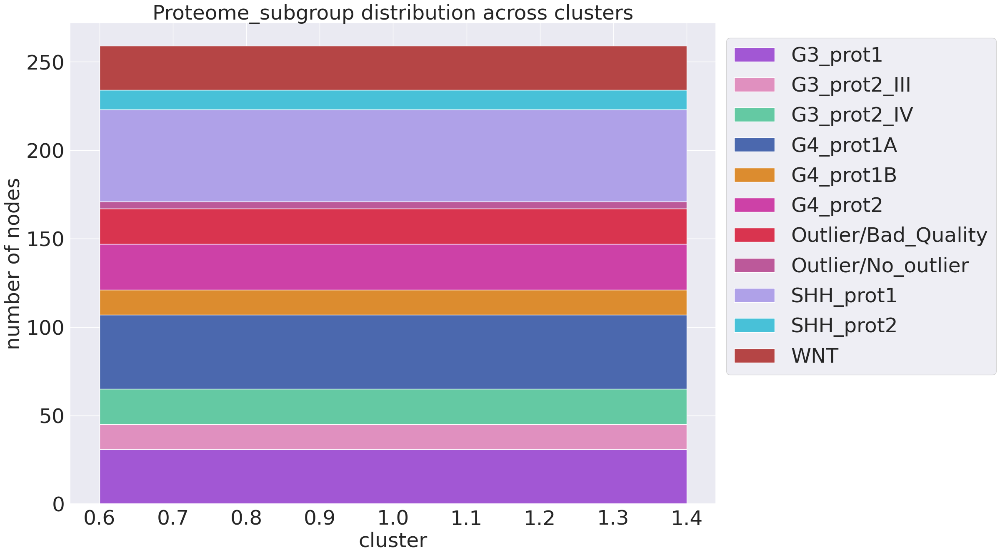

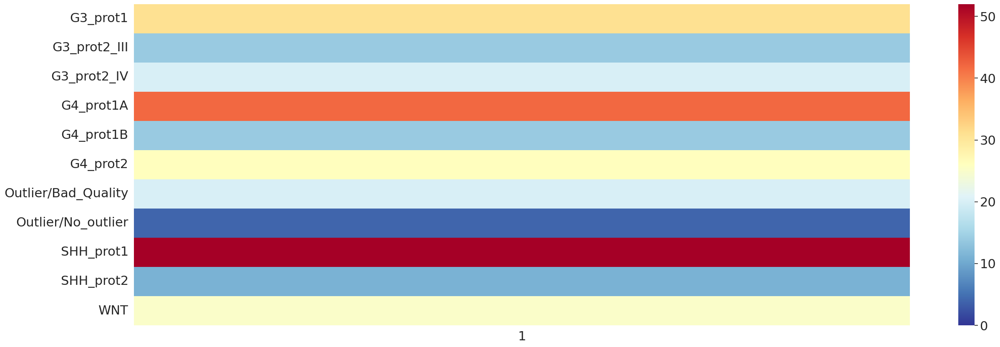

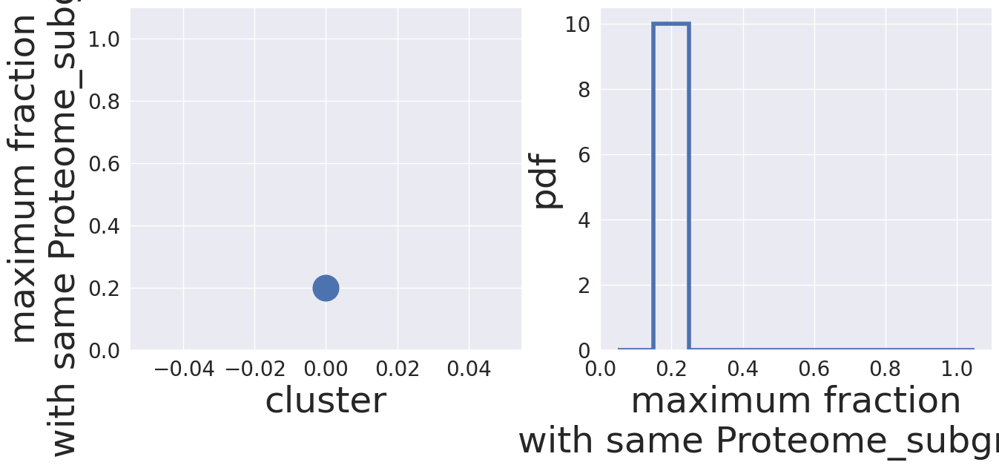

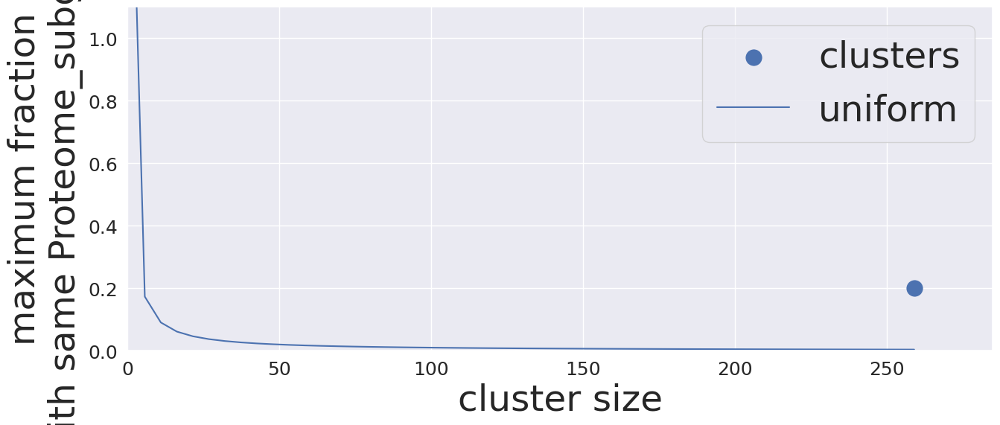

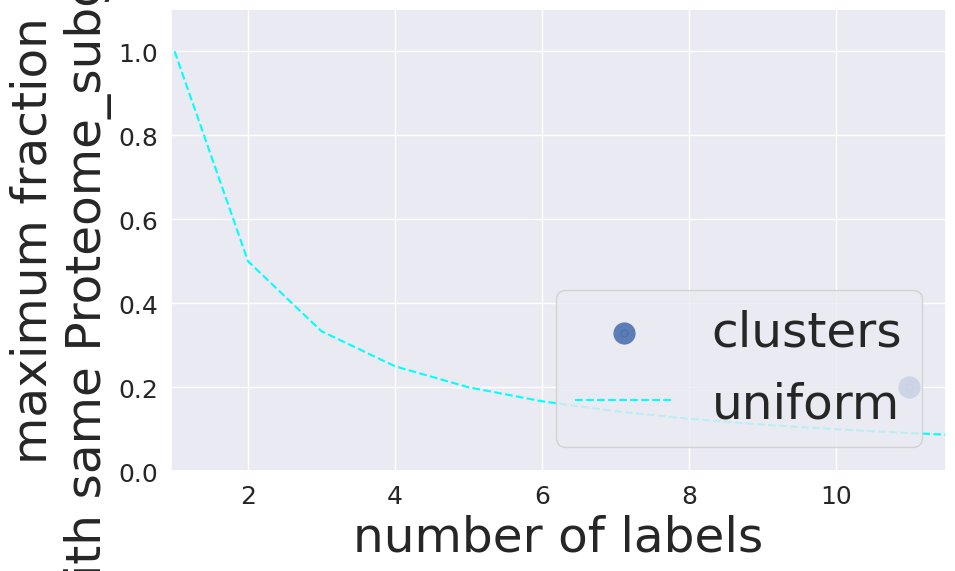

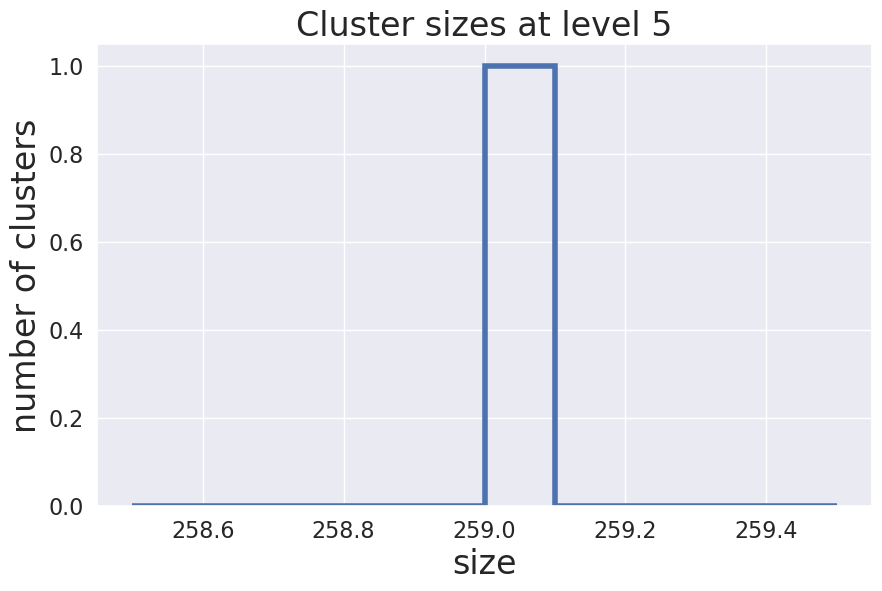

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


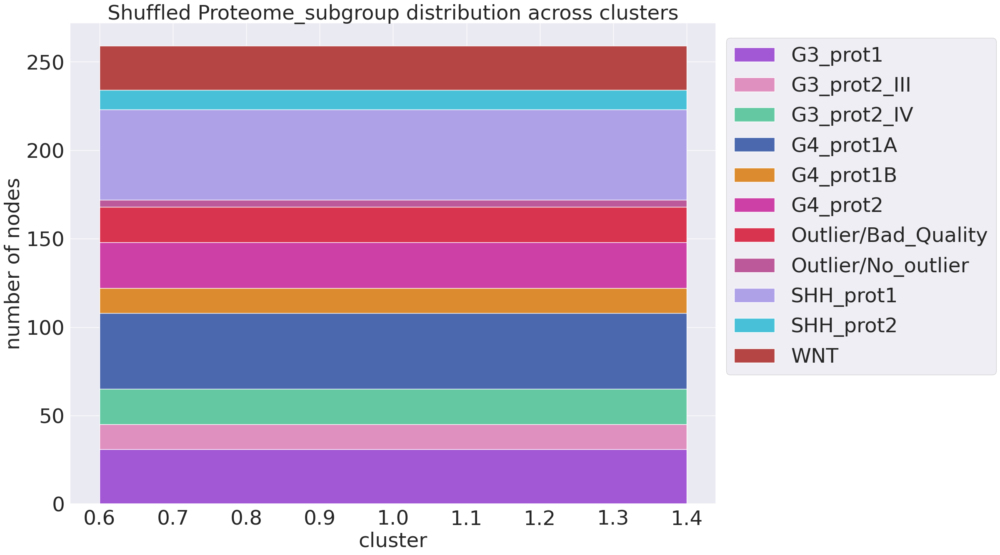

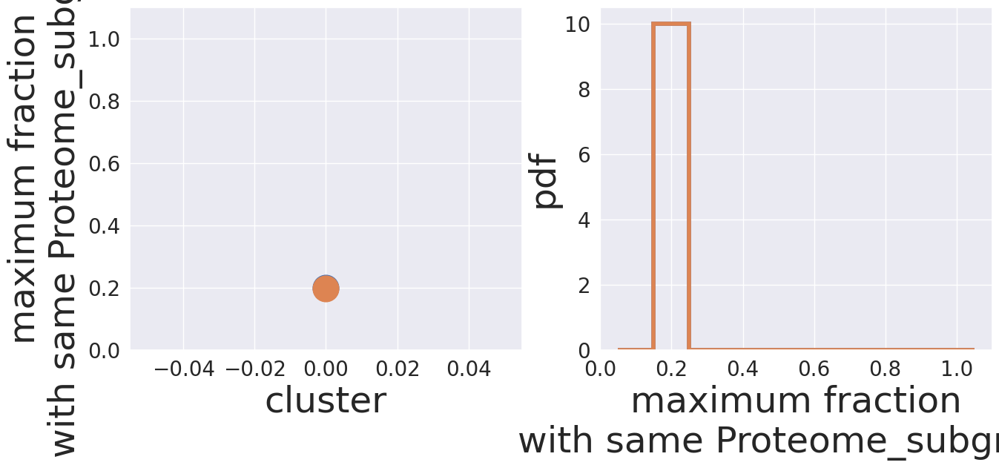

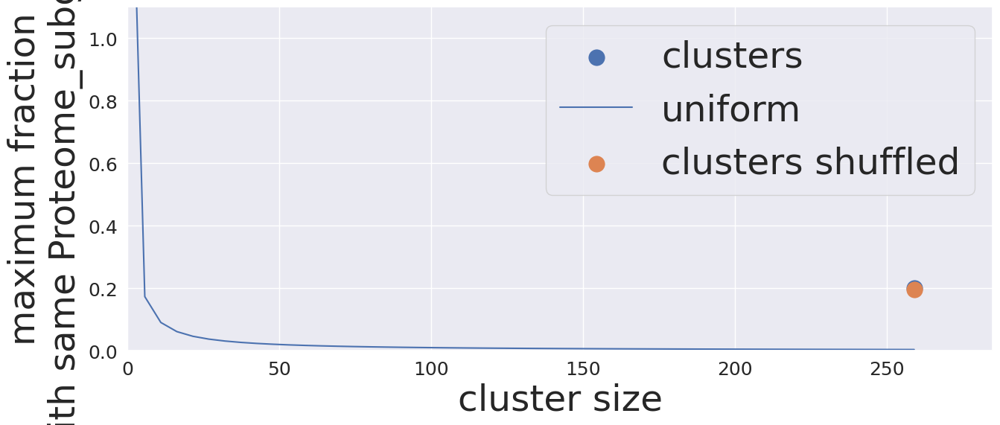

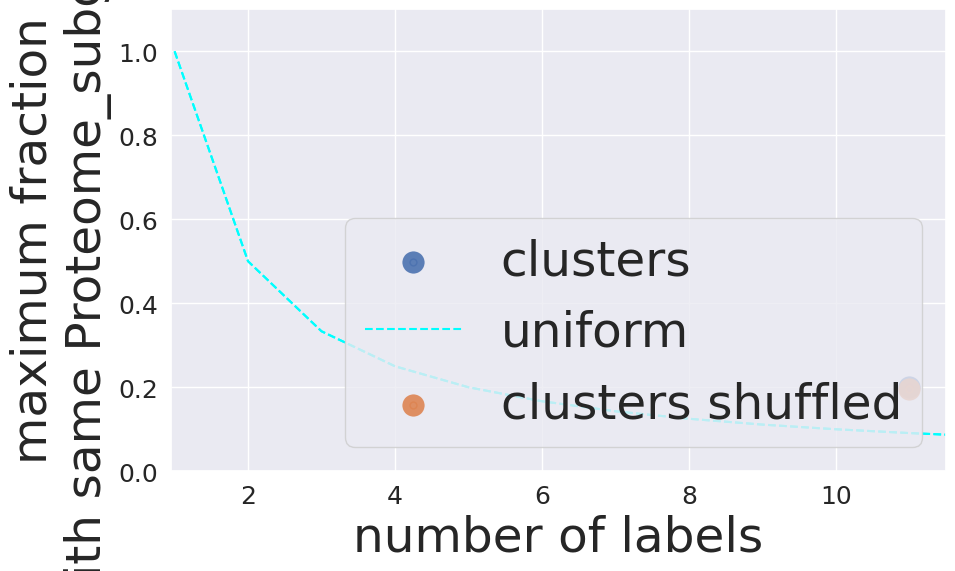

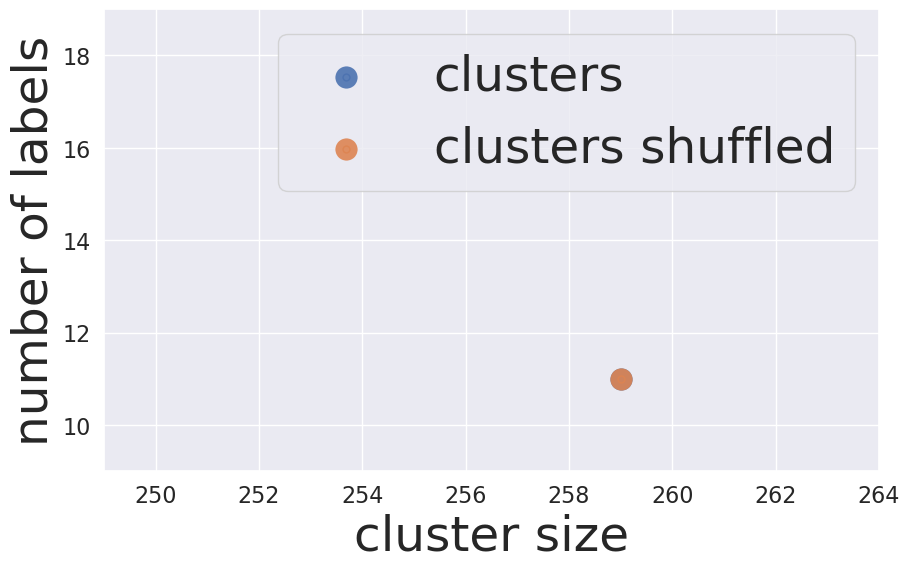

False Proteome_subgroup 4


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


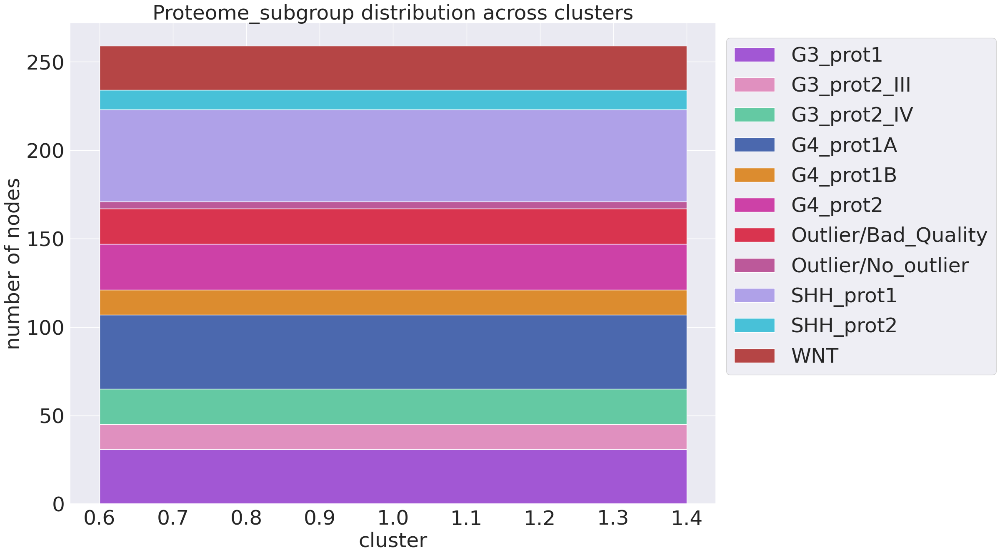

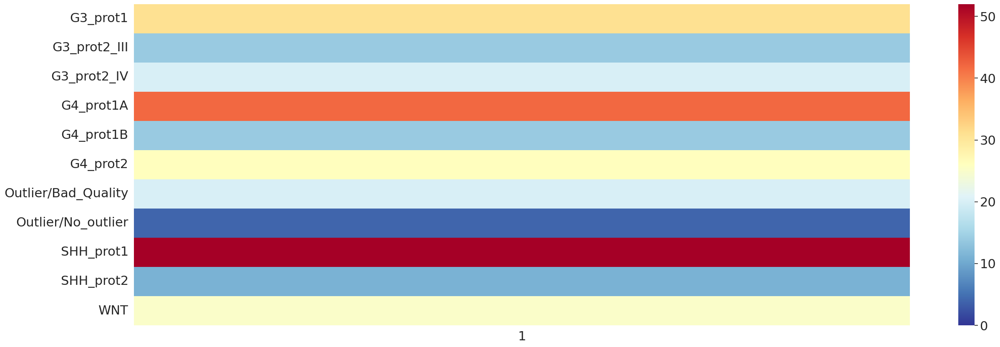

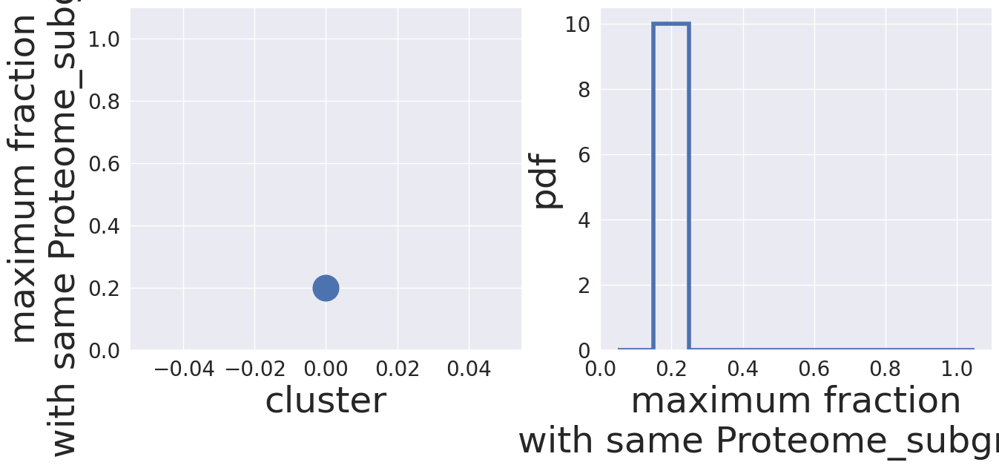

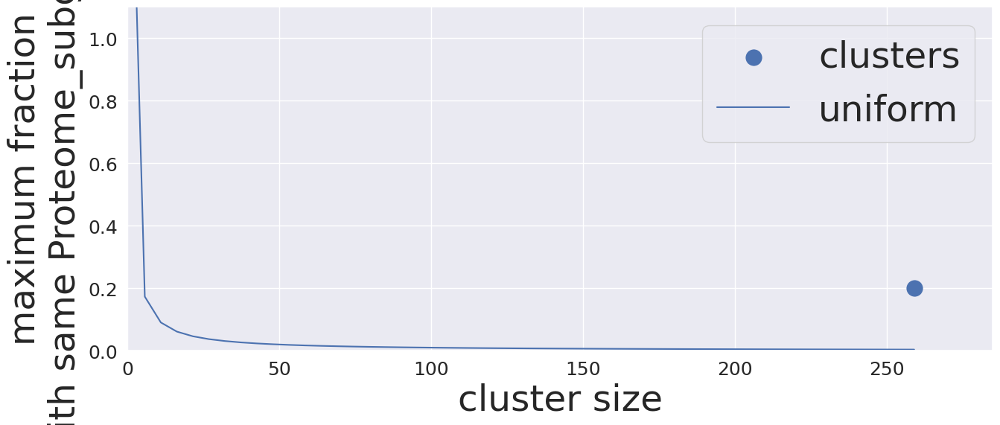

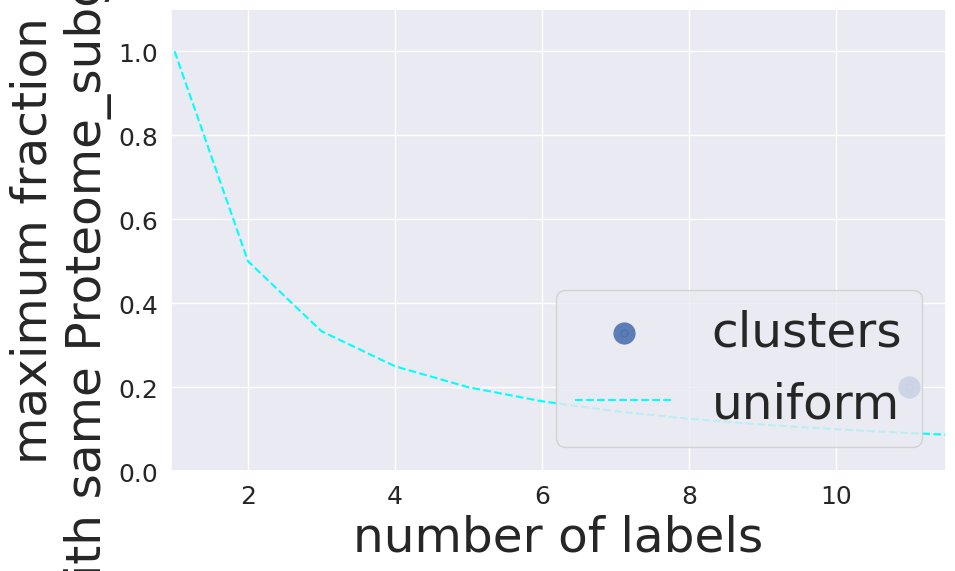

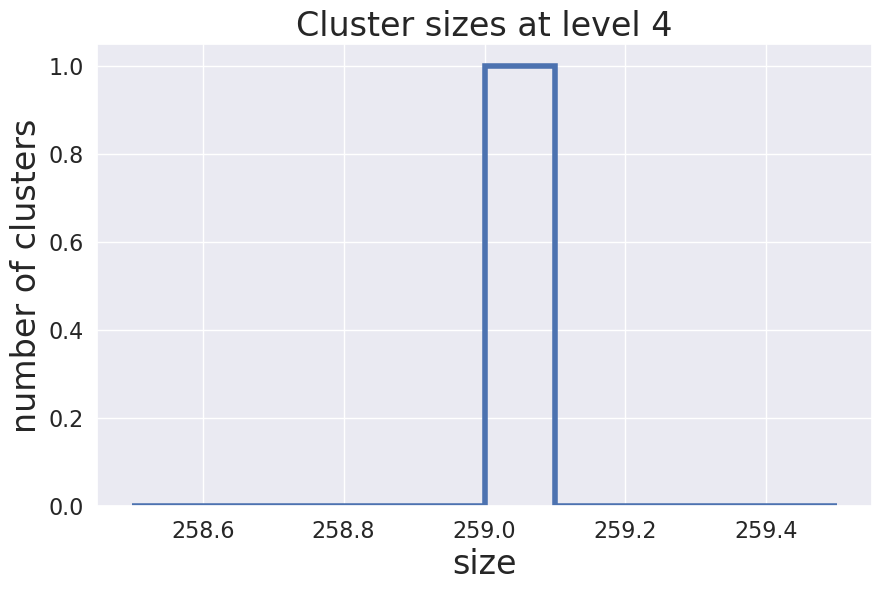

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


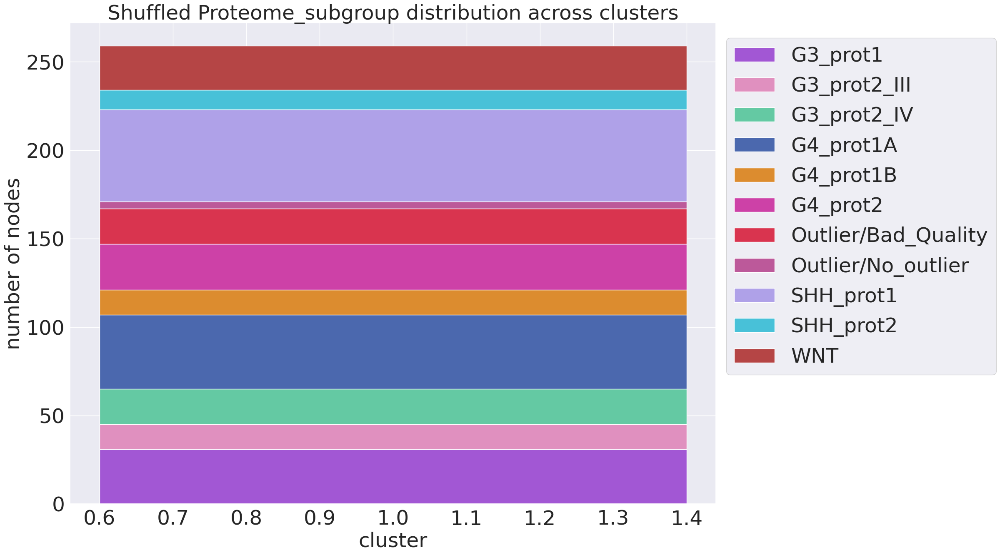

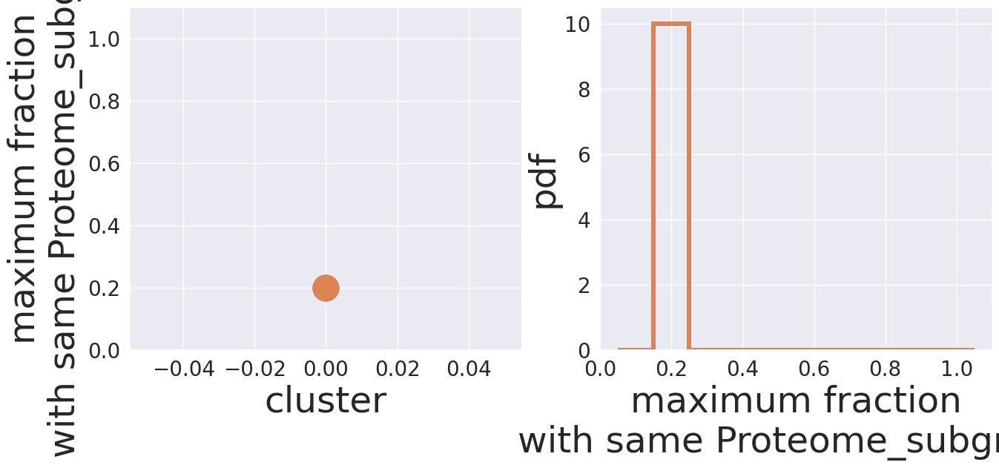

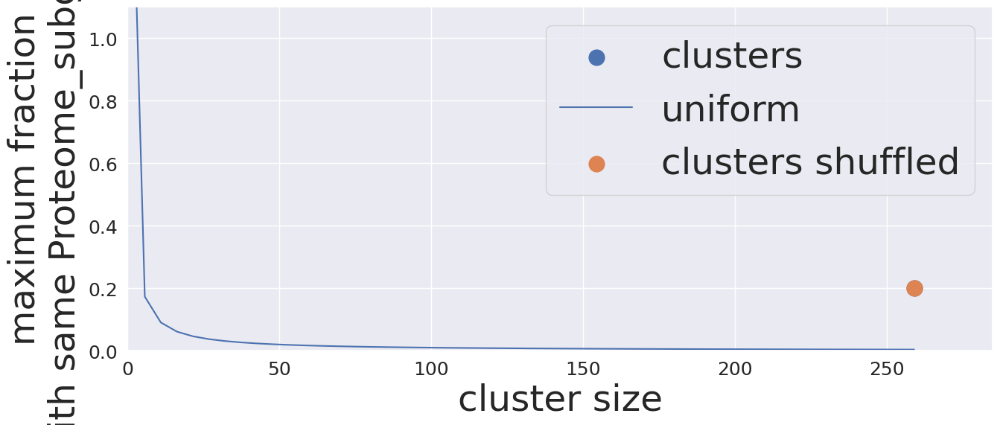

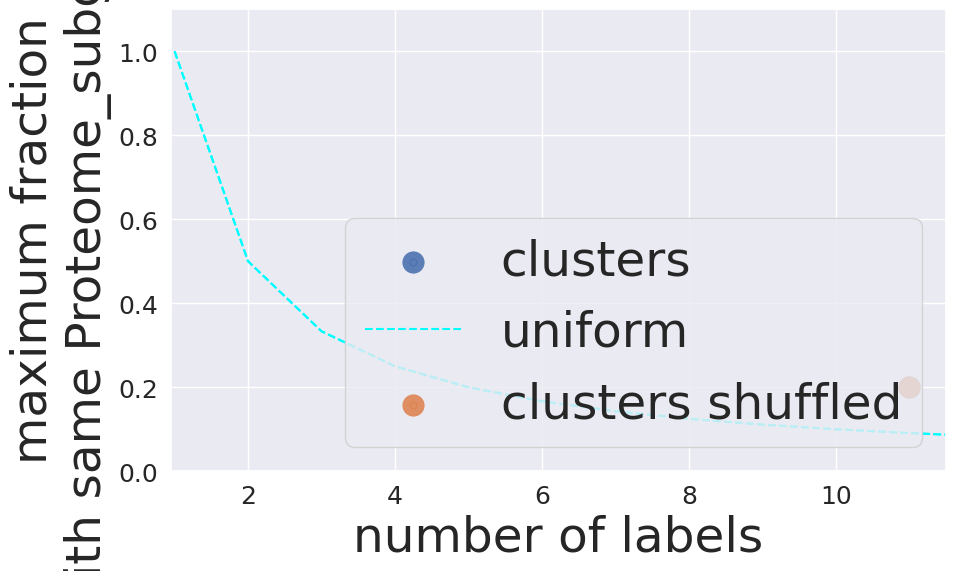

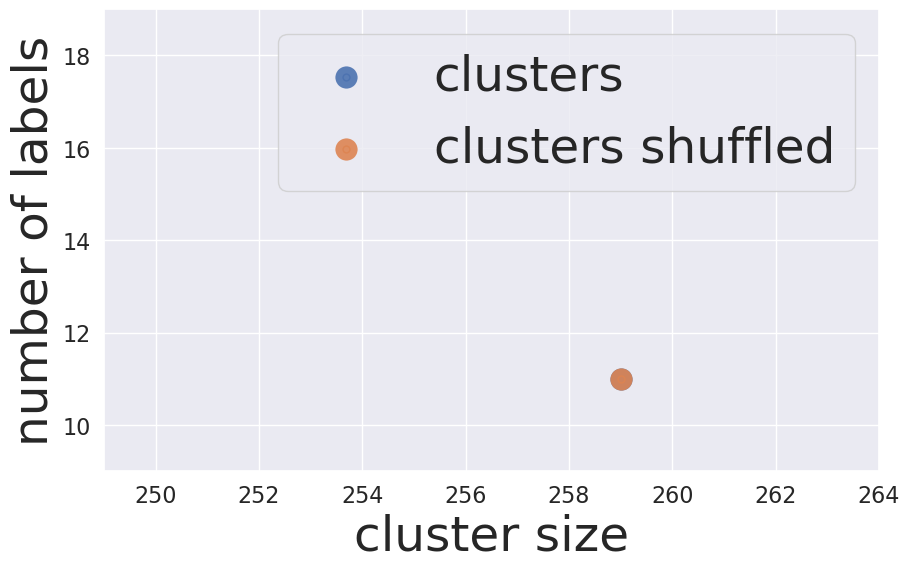

False Proteome_subgroup 3


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


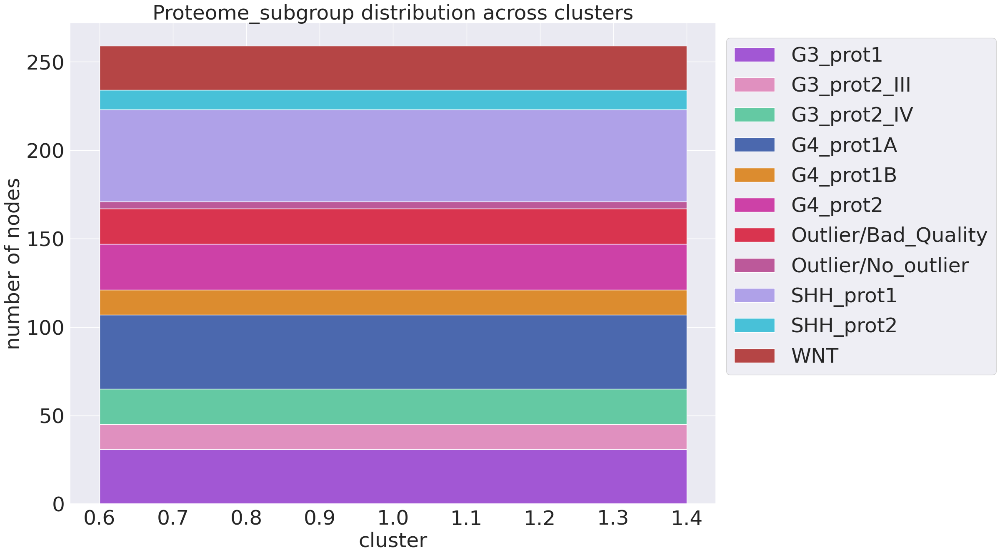

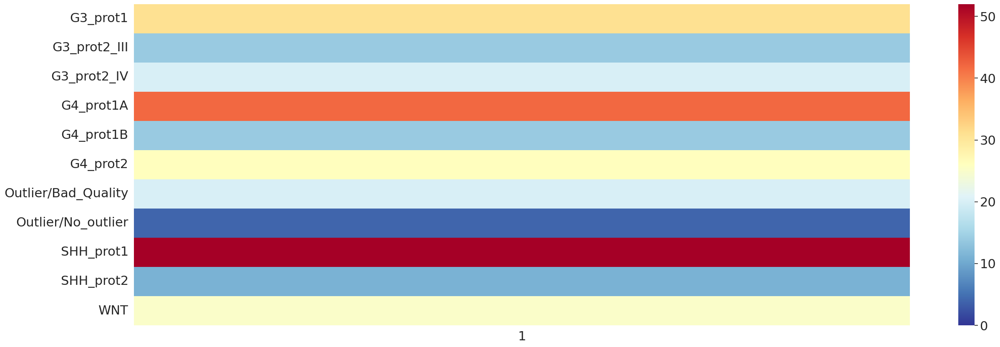

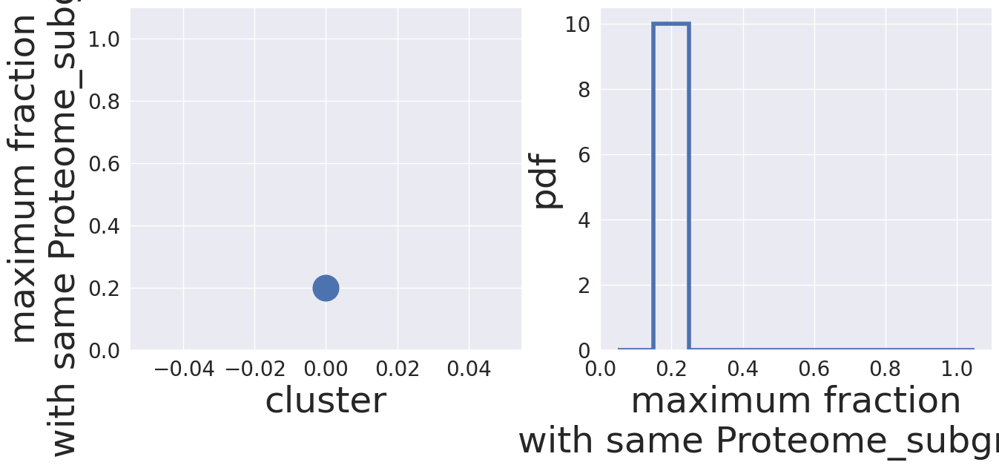

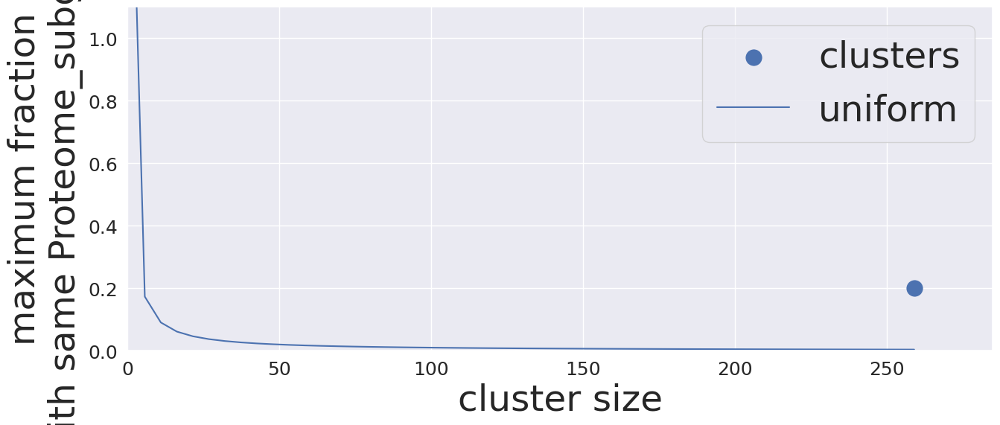

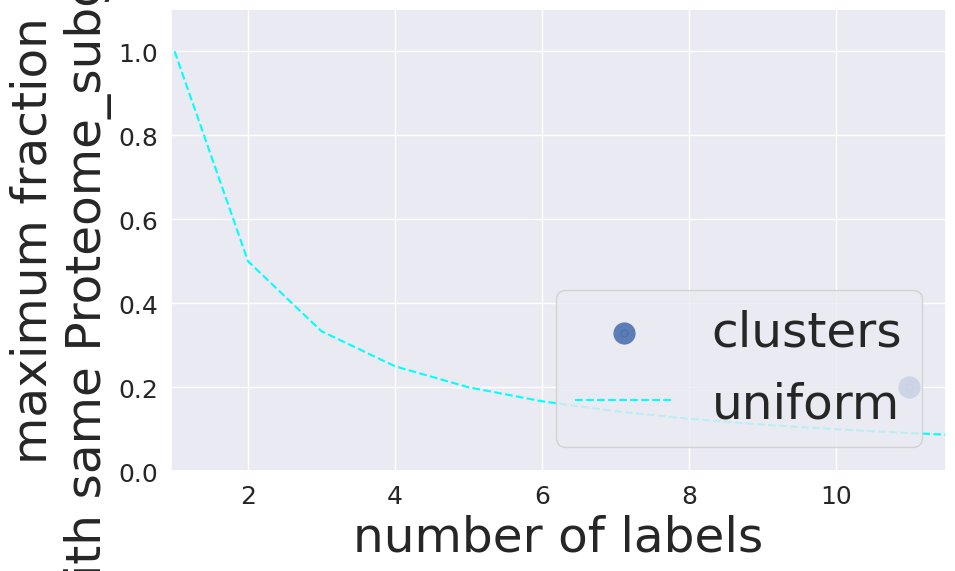

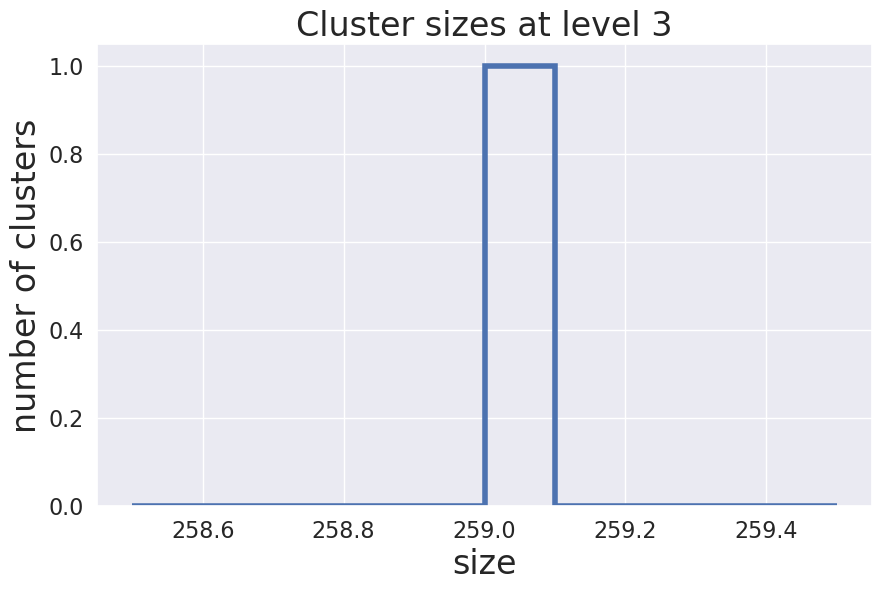

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


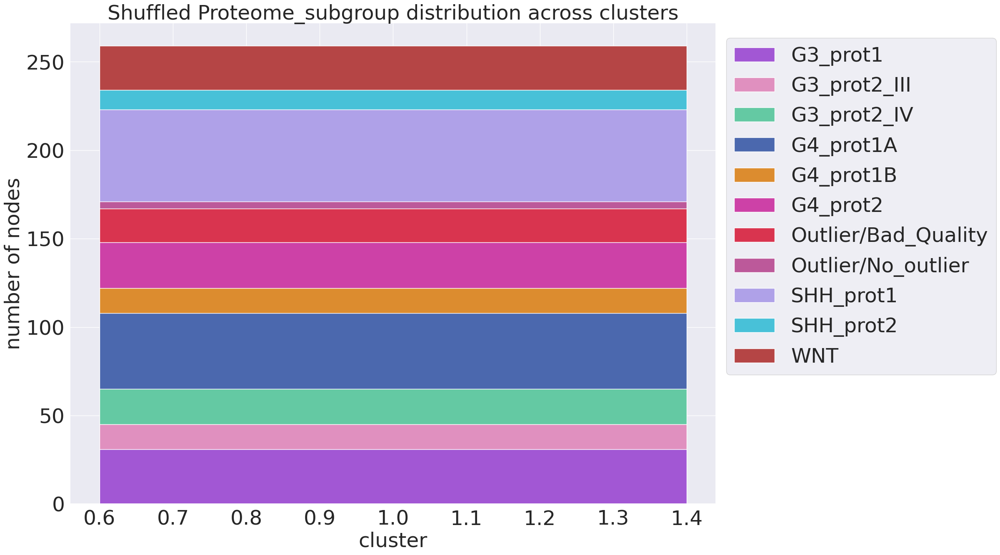

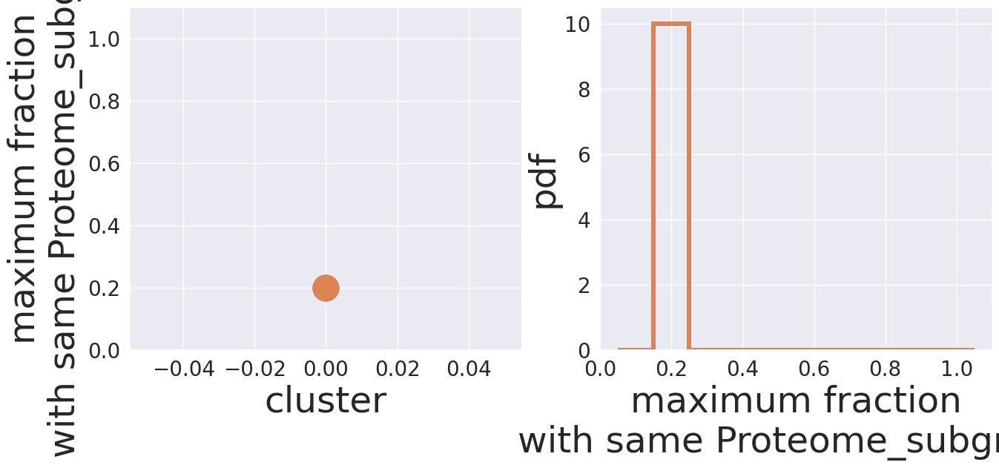

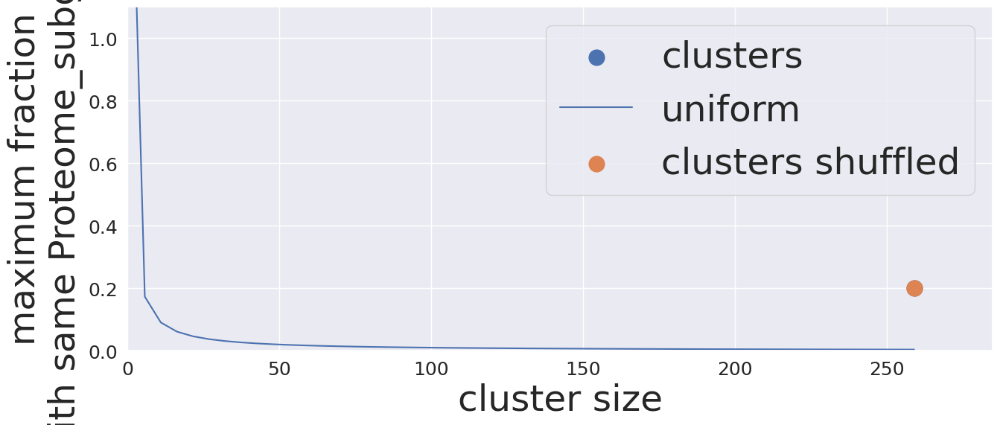

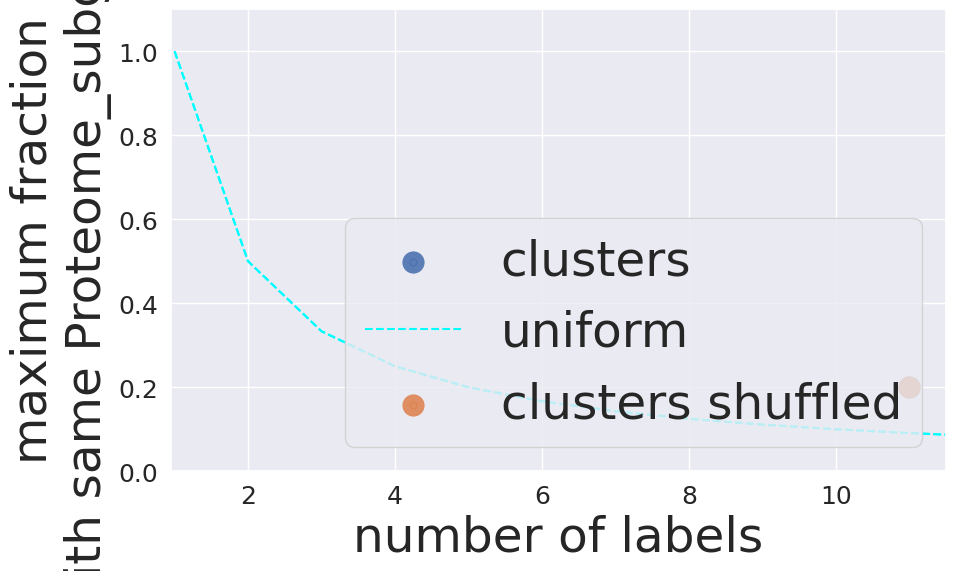

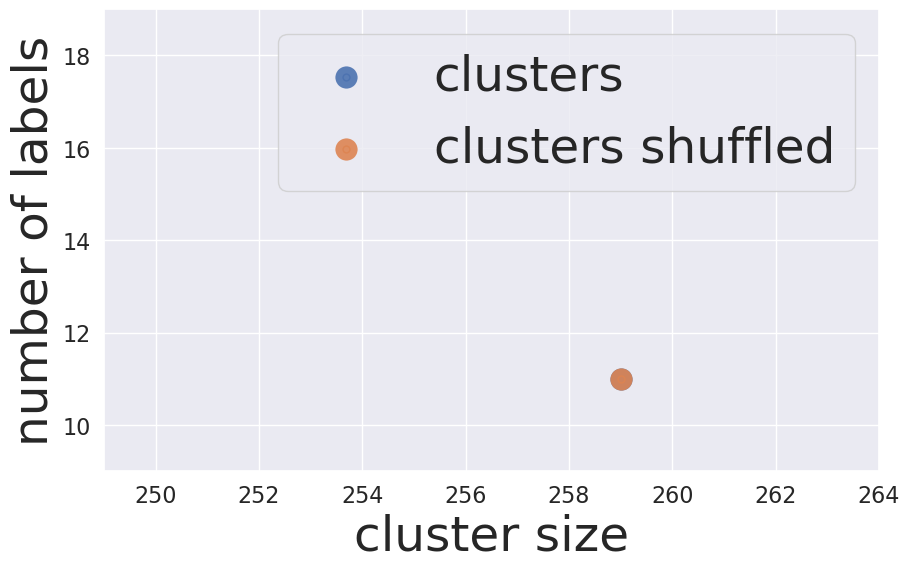

False Proteome_subgroup 2


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


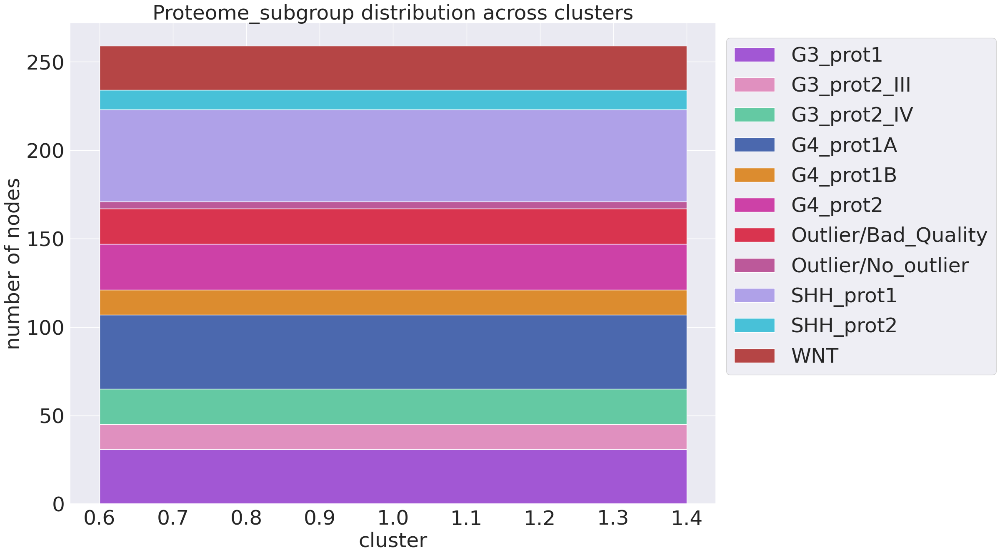

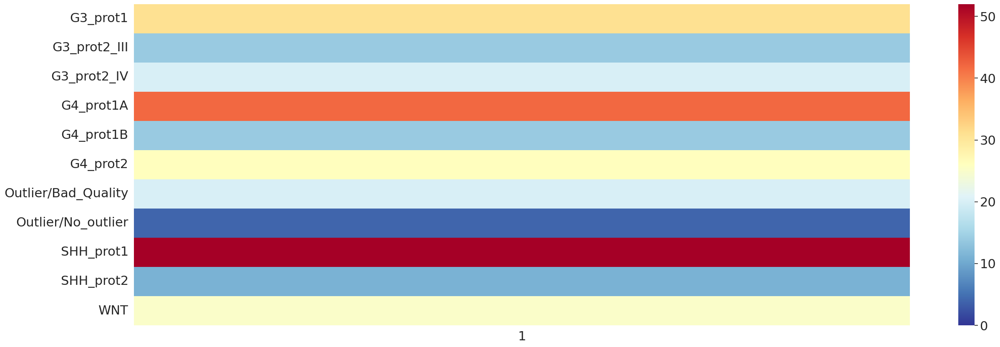

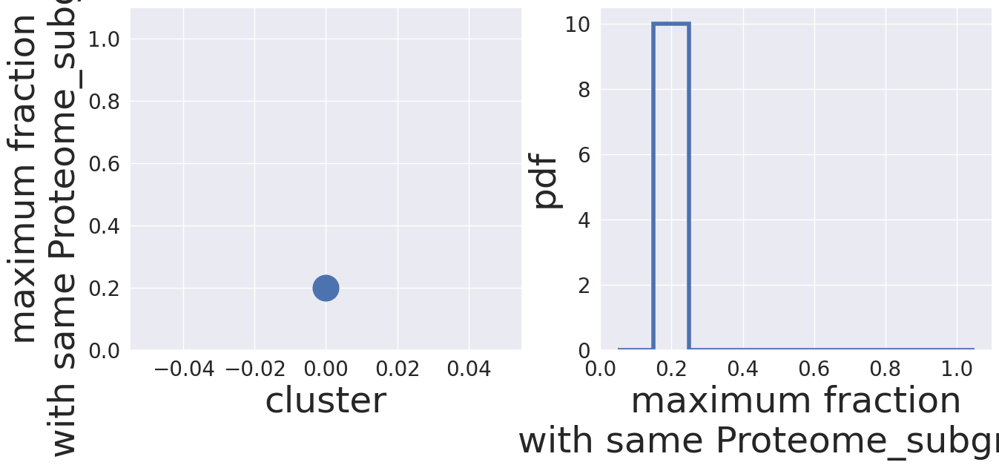

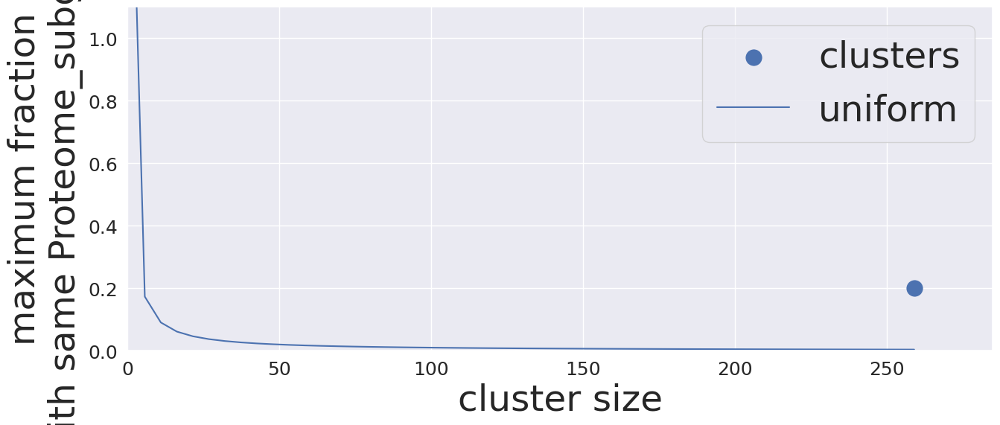

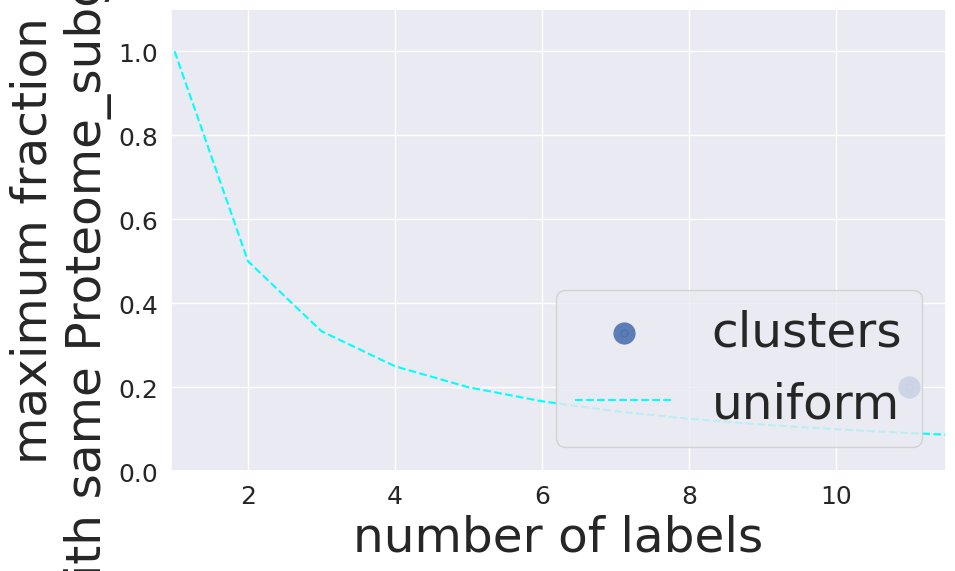

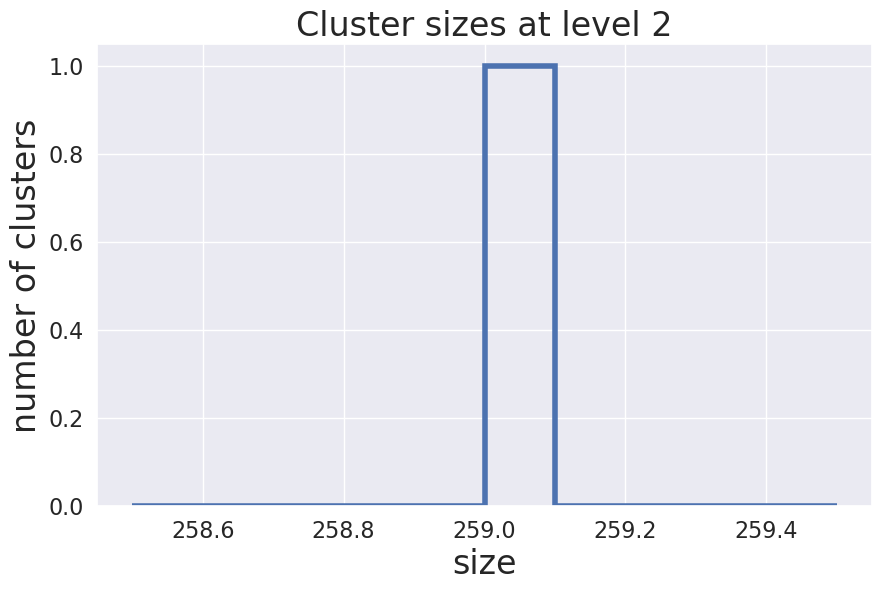

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


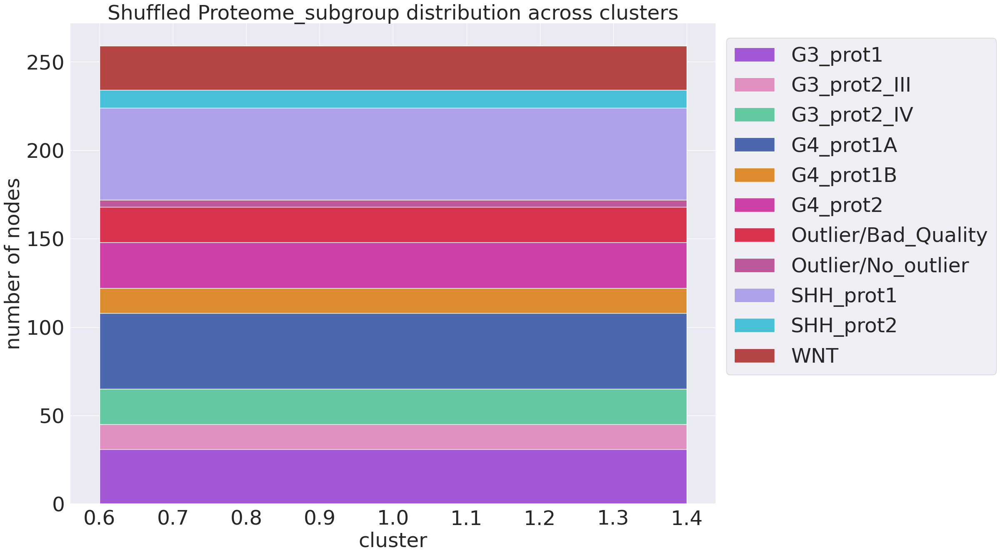

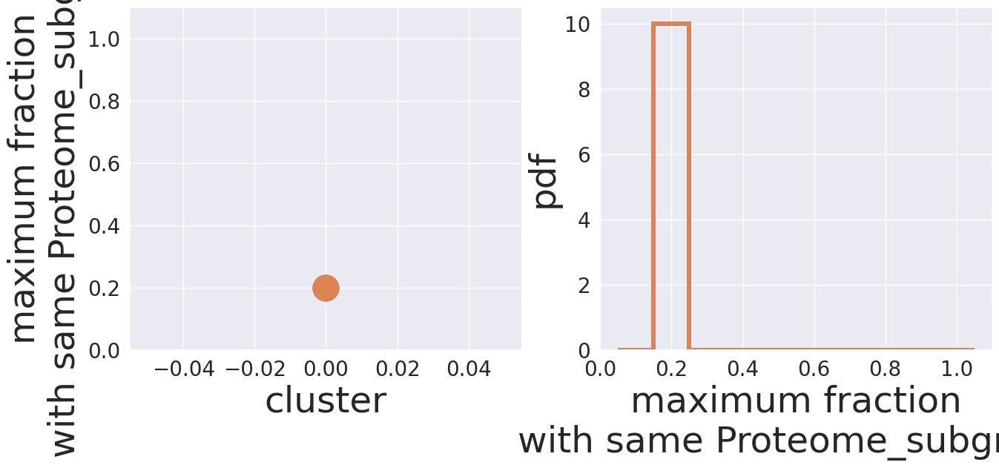

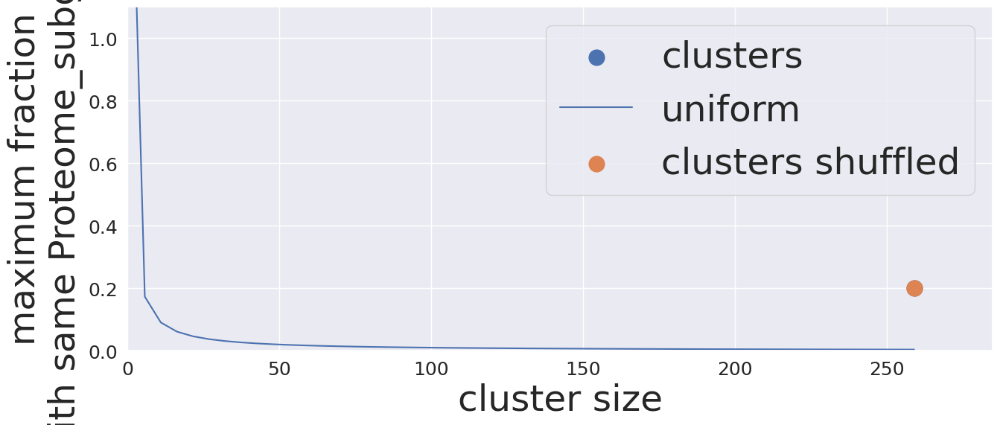

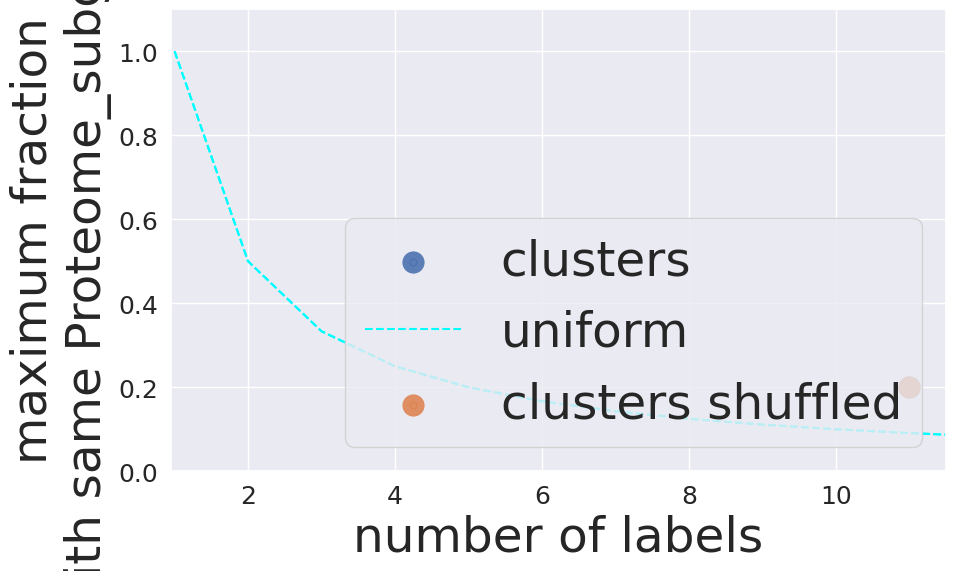

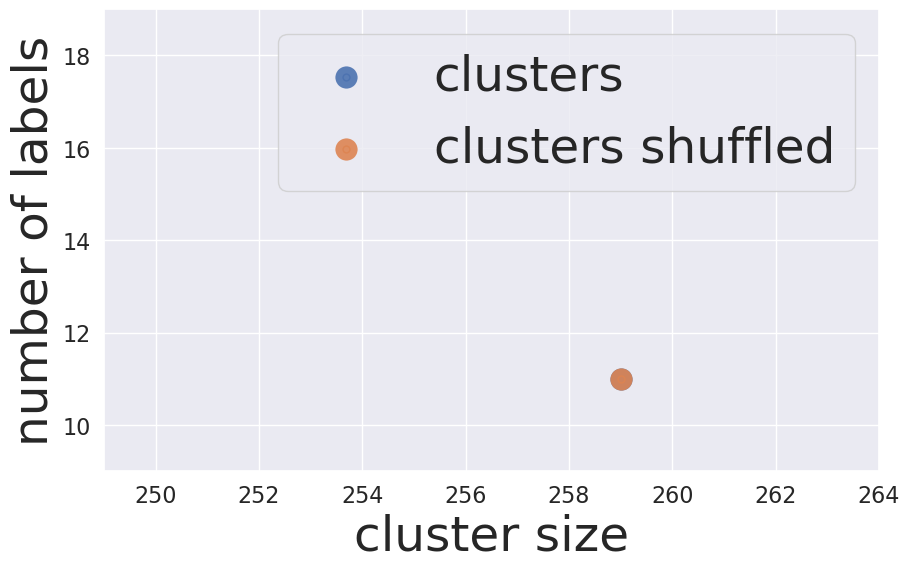

False Proteome_subgroup 1


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


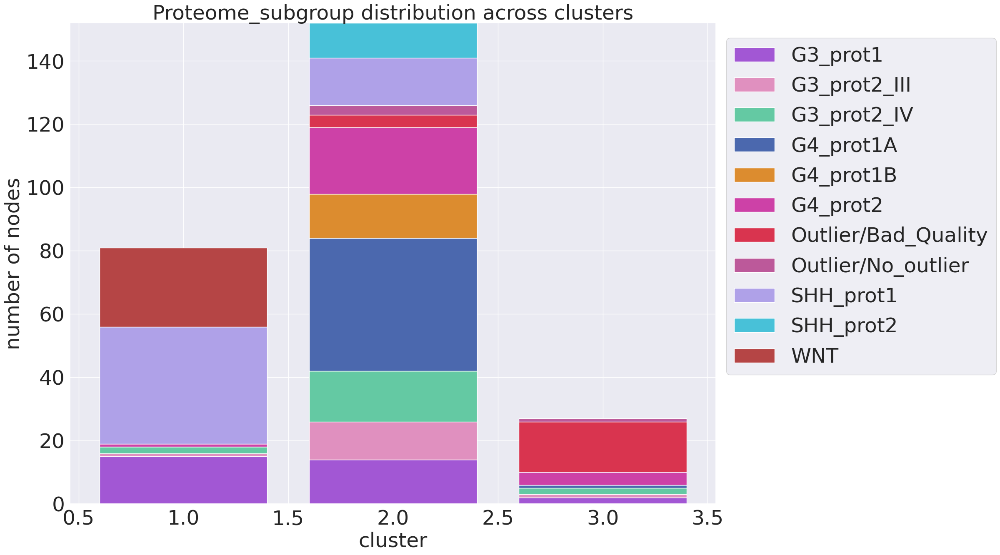

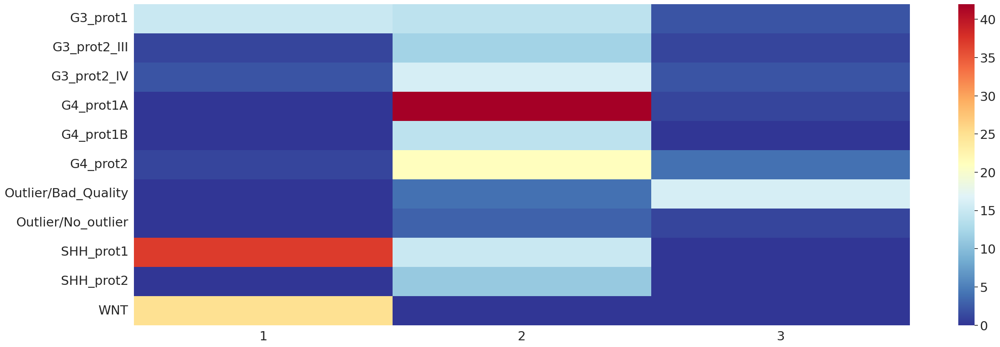

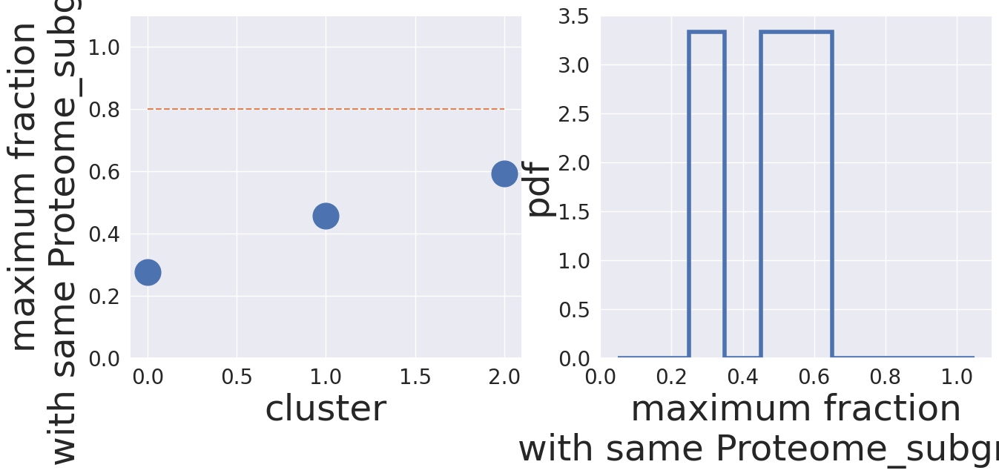

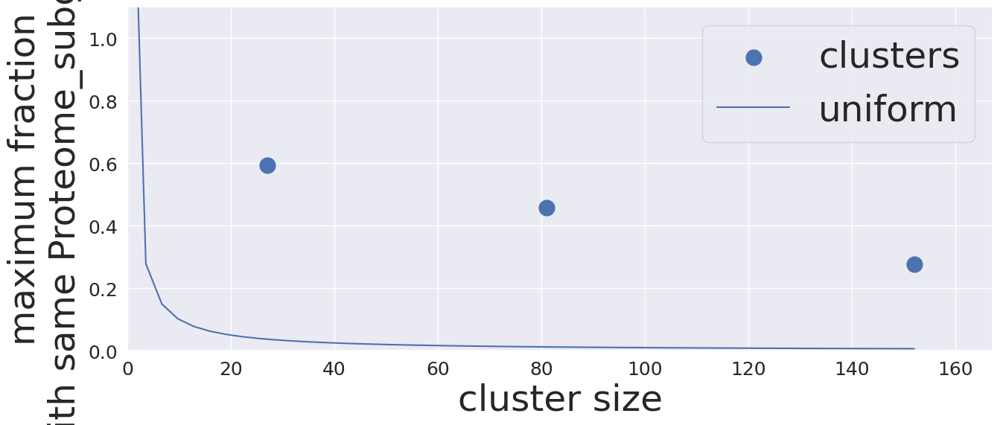

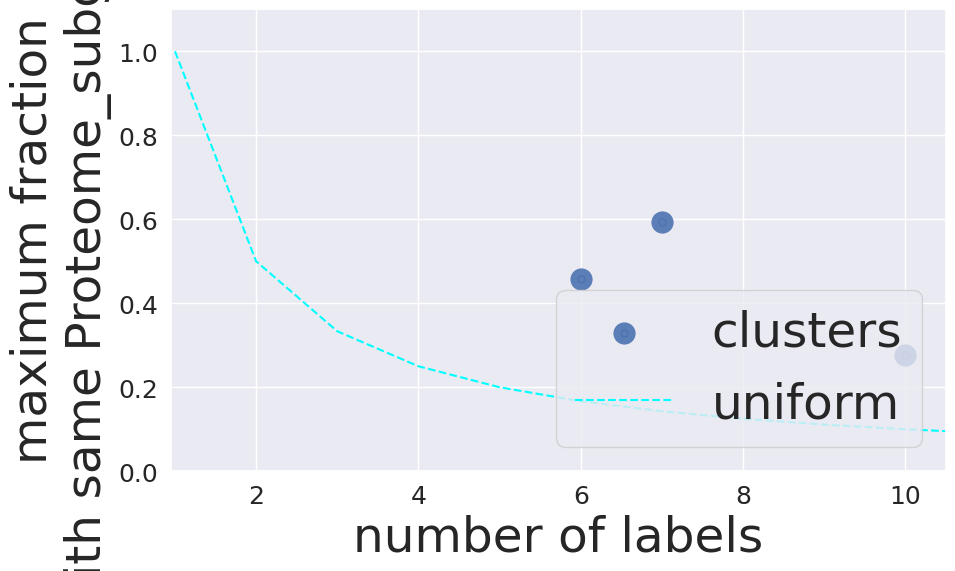

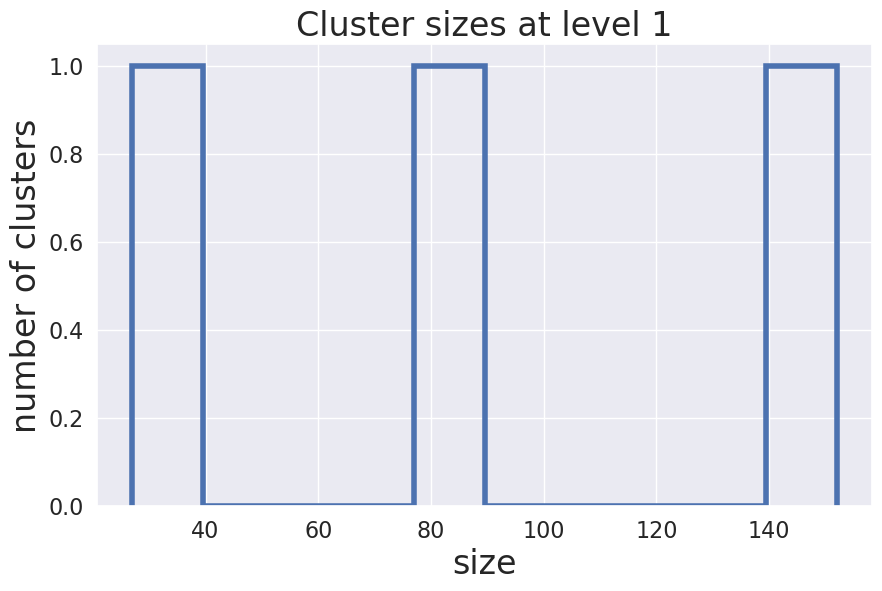

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


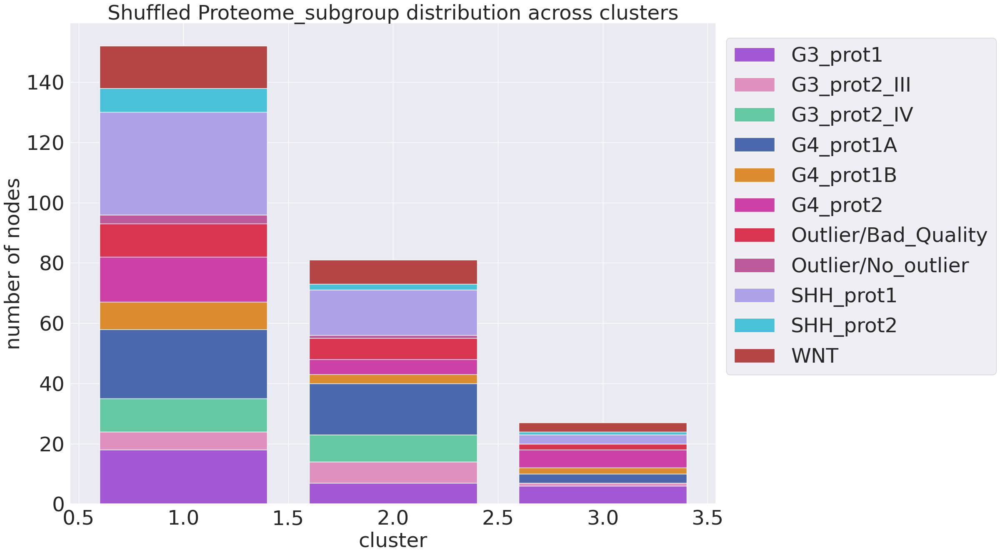

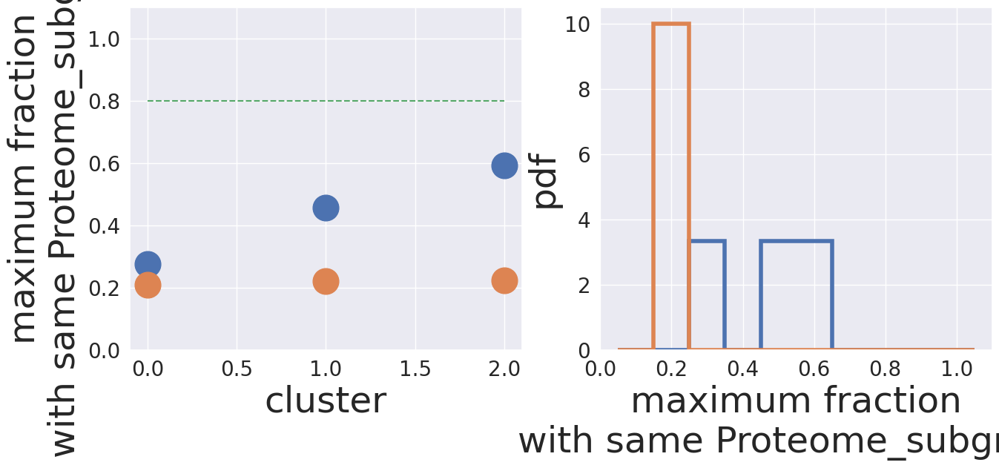

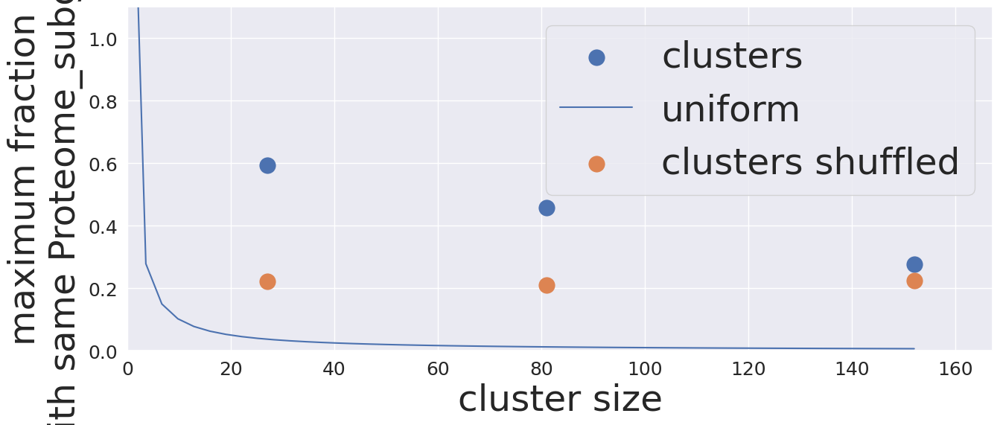

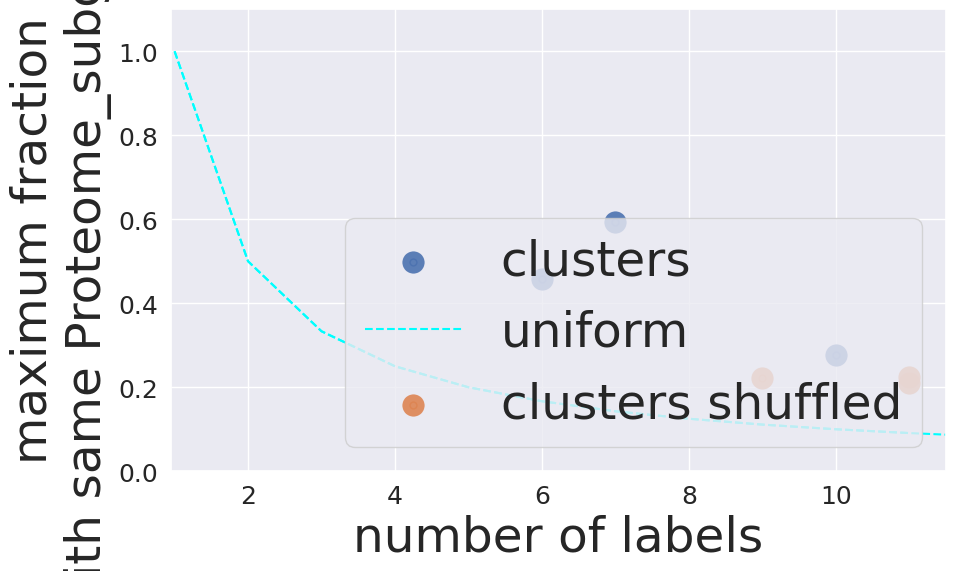

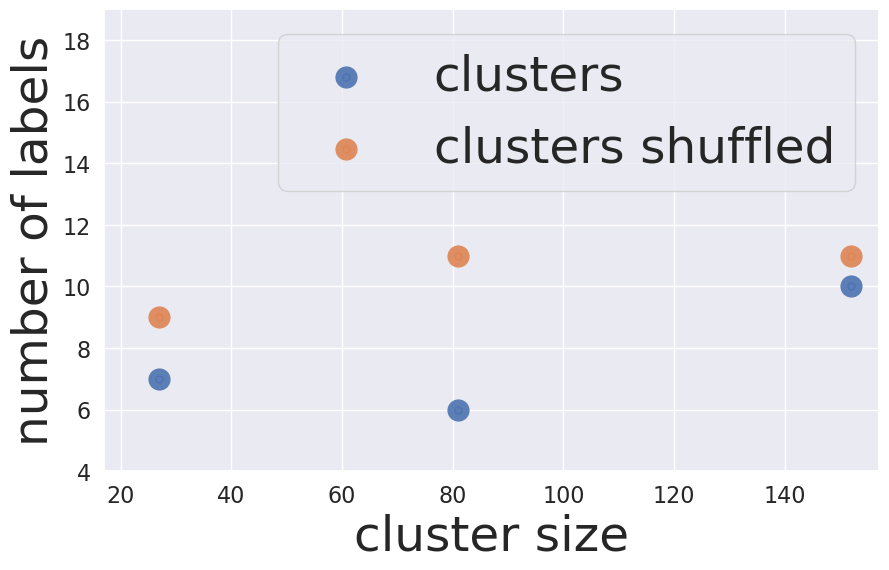

False Proteome_subgroup 0


/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


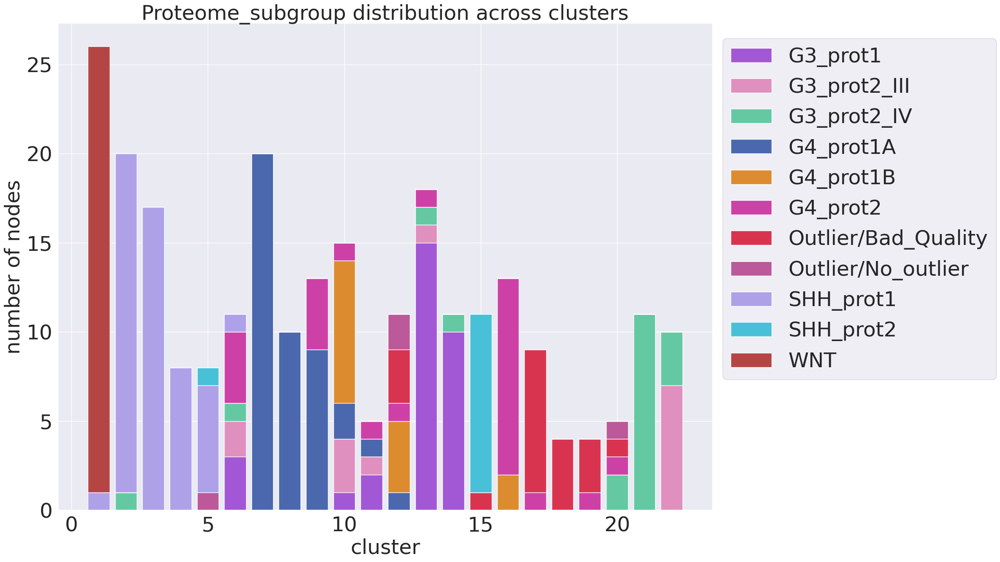

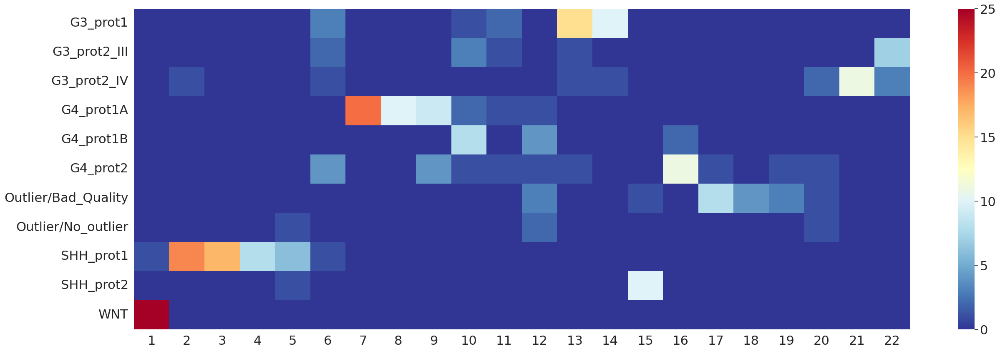

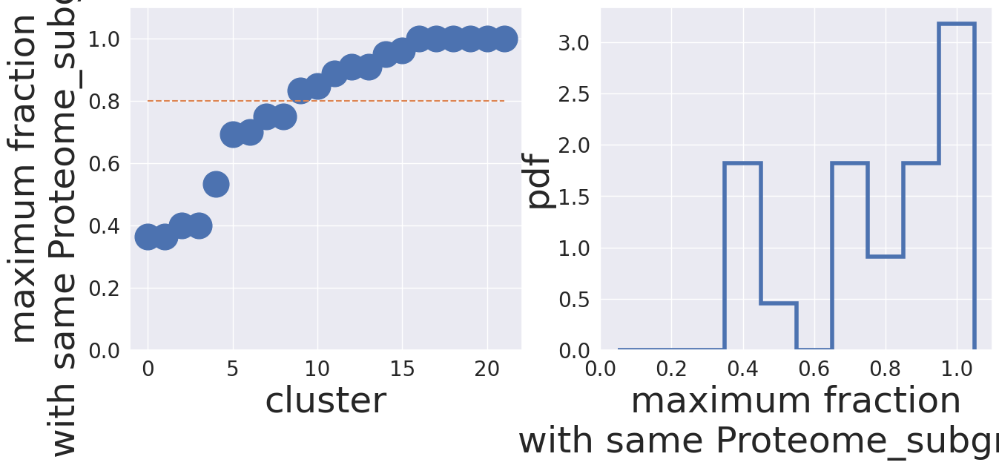

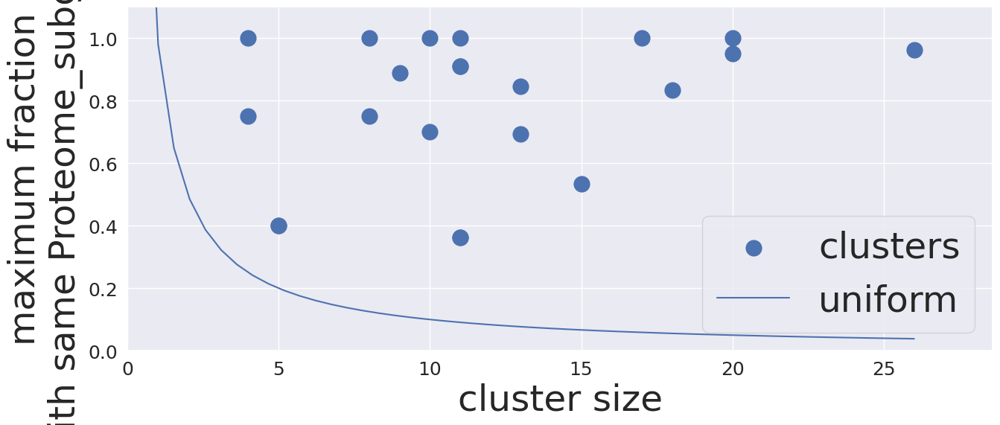

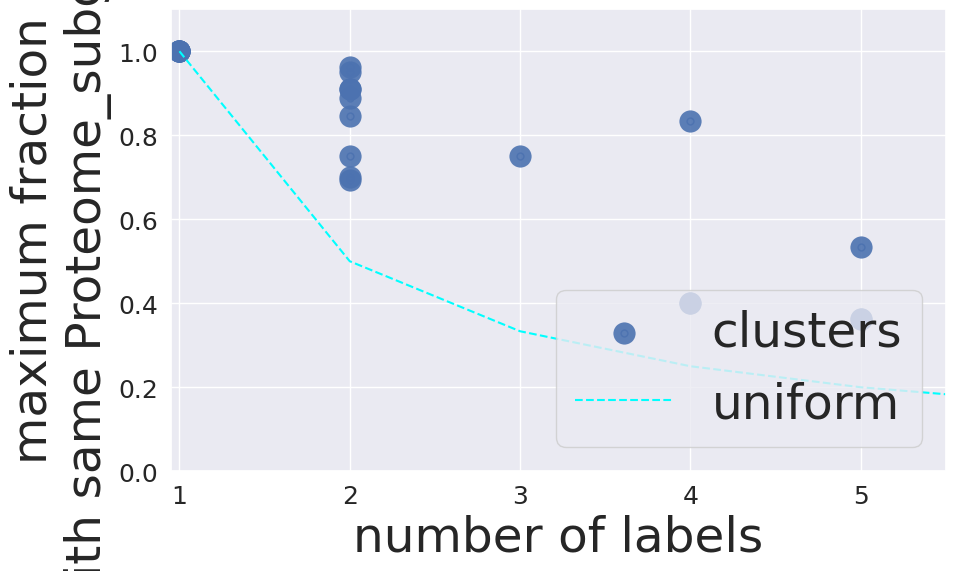

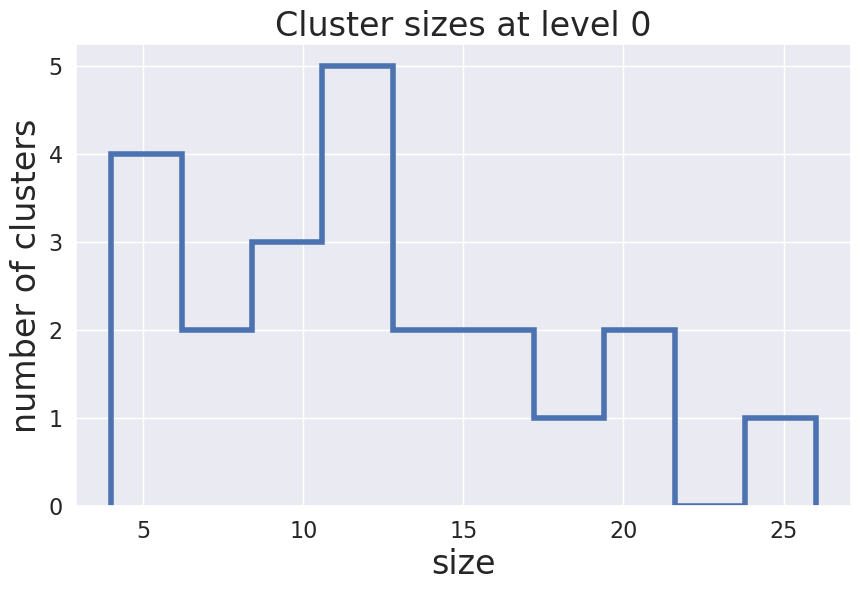

/opt/conda/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/opt/conda/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.9/site-packages/topicpy/hsbmpy/hsbmpy.py:234: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_index will be keyword-only.
  return df.sort_index(1).to_dict(orient='list')


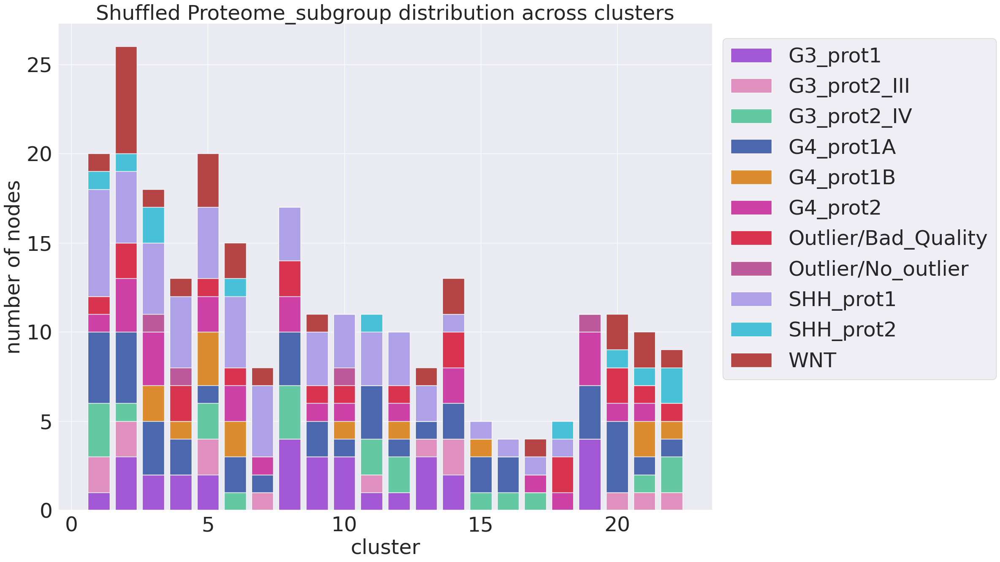

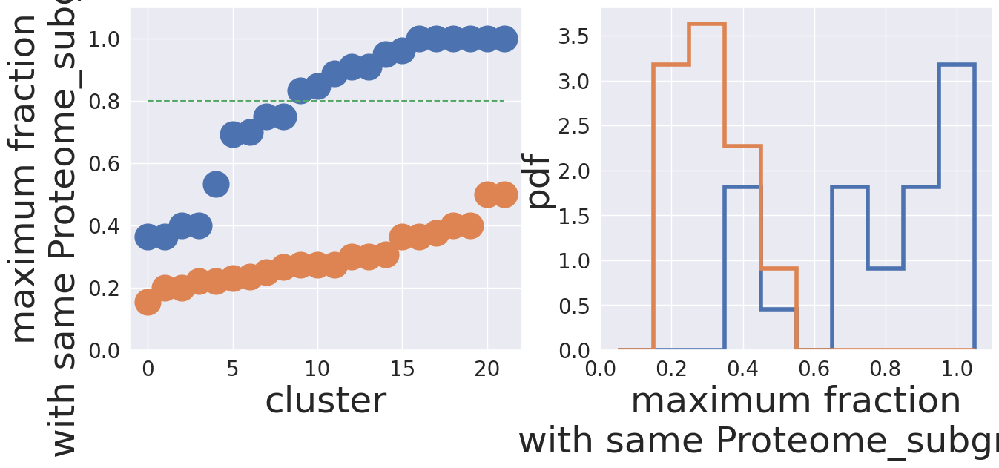

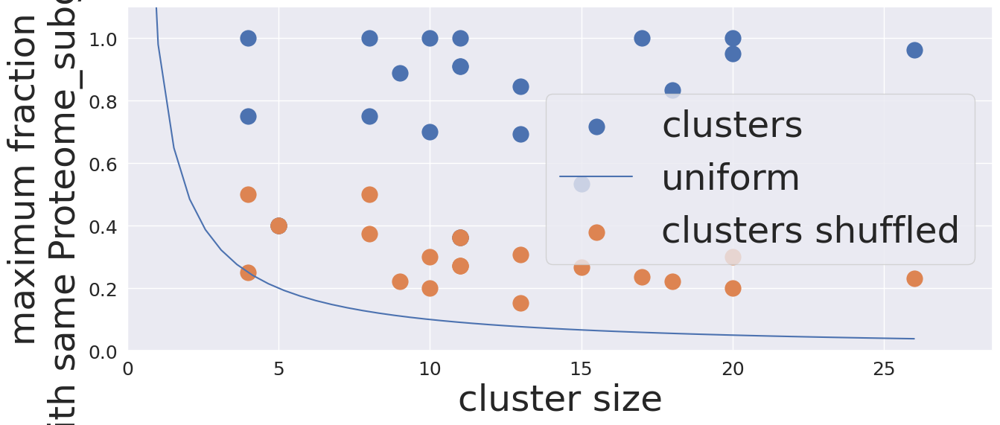

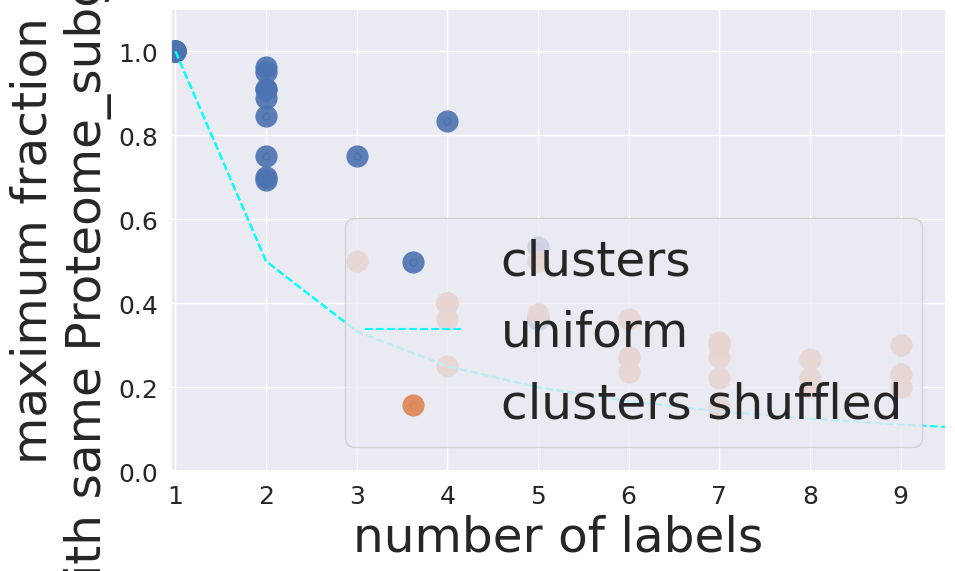

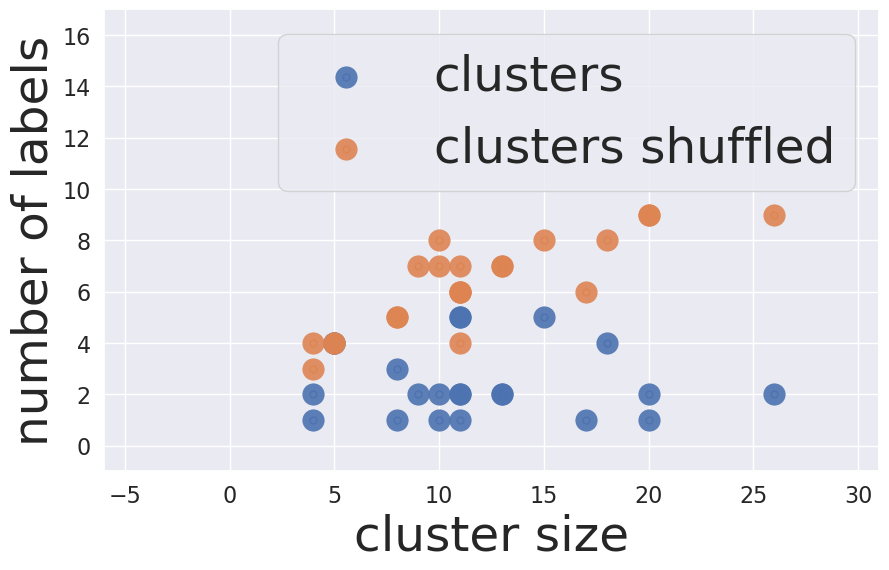

In [18]:
clusteranalysis(directory=directory, labels=labels)